## Load Libraries and Datasets

In [1]:
.libPaths(c("/scratch/samkyy/gete-gbm/renv/library/R-4.0/x86_64-pc-linux-gnu","/tmp/RtmpJsRC8Z/renv-system-library", .libPaths()))
.libPaths()

[1] "/scratch/samkyy/gete-gbm/renv/library/R-4.0/x86_64-pc-linux-gnu"                       
[2] "/home/samkyy/R/x86_64-pc-linux-gnu-library/4.0"                                        
[3] "/cvmfs/soft.computecanada.ca/easybuild/software/2020/avx2/Core/r/4.0.2/lib64/R/library"

In [2]:
resultsPath <- "~/scratch/gete-gbm/results"
getwd()

[1] "/scratch/samkyy/gete-gbm/results"

In [3]:
library(Seurat)
library(Matrix)
library(ggplot2)
library(cowplot)
library(genefilter)
library(tidyverse)
library(RCurl)
library(scales)
# library(SingleCellExperiment)
library(AnnotationHub)
library(ensembldb)
# Packages for figure layout formatting
library(grid)
library(gridExtra)

Attaching SeuratObject

Warning message in system("timedatectl", intern = TRUE):
“running command 'timedatectl' had status 1”
Registered S3 method overwritten by 'cli':
  method     from         
  print.boxx spatstat.geom

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.0 ──

✔ tibble  3.1.3     ✔ dplyr   1.0.7
✔ tidyr   1.1.3     ✔ stringr 1.4.0
✔ readr   2.0.1     ✔ forcats 0.5.1
✔ purrr   0.3.4     

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ tidyr::expand() masks Matrix::expand()
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
✖ tidyr::pack()   masks Matrix::pack()
✖ readr::spec()   masks genefilter::spec()
✖ tidyr::unpack() masks Matrix::unpack()


Attaching package: ‘RCurl’


The following object is masked from ‘package:tidyr’:

    complete



Attaching package: ‘scales’


The following object is masked from ‘package:purrr’:

    discard


The following object is masked from ‘packag

In [4]:
# Packages for Gene Ontology
library(GOstats)
library(org.Hs.eg.db)

Loading required package: Category

Loading required package: graph


Attaching package: 'graph'


The following object is masked from 'package:stringr':

    boundary





Attaching package: 'GOstats'


The following object is masked from 'package:AnnotationDbi':

    makeGOGraph






In [5]:
library(monocle3)

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: 'matrixStats'


The following objects are masked from 'package:Biobase':

    anyMissing, rowMedians


The following object is masked from 'package:dplyr':

    count


The following objects are masked from 'package:genefilter':

    rowSds, rowVars



Attaching package: 'MatrixGenerics'


The following objects are masked from 'package:matrixStats':

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeighted

In [4]:
source("~/scratch/gete-gbm/bin/util.R")
source("~/scratch/gete-gbm/bin/util_go.R")
source("~/scratch/gete-gbm/bin/util_seurat.R")
source("~/scratch/gete-gbm/bin/util_viz.R")

Loading required package: Category

Loading required package: graph


Attaching package: 'graph'


The following object is masked from 'package:stringr':

    boundary





Attaching package: 'GOstats'


The following object is masked from 'package:AnnotationDbi':

    makeGOGraph






In [6]:
load("/home/samkyy/scratch/RetroTransposonAnalysis/code/data/filt_gte_brain.intergrated.RData")
load("/home/samkyy/scratch/RetroTransposonAnalysis/code/data/filt_GE_select.intergrated.RData")

In [ ]:
ge_GO <- read.csv(file = "/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_GOtable.csv", 
         header = TRUE, sep = ",", row.names = FALSE)
gte_GO <- read.csv(file = "/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_GOtable.csv", 
         header = TRUE, sep = ",", row.names = FALSE)

In [ ]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [ ]:
# Load most recent seurat objects (with UMAP resolutions: 0.2-0.7)
ge_umaps <- readRDS("~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")
gte_umaps <- readRDS("~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")

## Load Neuroblastoma Dataset

2021-06-10: 

In [10]:
load("/home/samkyy/scratch/gete-gbm/data/2021-04-01_integrate/filt_gte_brain.intergrated.RData")
load("/home/samkyy/scratch/gete-gbm/data/2021-04-01_integrate/filt_GE_select.intergrated.RData")
ls()

[1] "filt_GE_select.intergrated" "filt_gte_brain.intergrated"
[3] "mkdirToday"                 "resultsPath"               
[5] "setwdToday"

In [11]:
library(Seurat)
library(Matrix)
library(ggplot2)
library(cowplot)
library(genefilter)
library(grid)
library(gridExtra)

Attaching SeuratObject



In [7]:
gbmsc <- Read10X("/home/samkyy/scratch/gete-gbm/data/2021-05-28_GBMSC/aggr_GBMSC/outs/count/filtered_feature_bc_matrix")
gbmscRT <- Read10X("/home/samkyy/scratch/gete-gbm/data/2021-05-28_GBMSC/aggr_GBMSCRT/outs/count/filtered_feature_bc_matrix")

In [8]:
#genes by cells
dim(gbmsc) 
dim(gbmscRT)

[1] 36601 14244

[1]  1180 13593

Create seurat objects:

In [11]:
# find intersecting cell names between genes and retrotransposon datasets
cellnames <- intersect(colnames(gbmsc),colnames(gbmscRT))
length(cellnames) # 37104 cells will be present in the combined sparse matrix

# Merge sparse matrices with intersecting cell names
gbmscInter <- rbind(gbmsc[,cellnames],gbmscRT[,cellnames])

# Create Seurat Object of Neuroblastoma dataset with genes + retrotransposons genes
gte_gbmsc <- CreateSeuratObject(counts=gbmscInter,project="neuroblastoma_GenesRetrotransposons",
                                       names.field = 2,names.delim = "-", min.features = 100, min.cells = 1)
orig_id_gte_gbmsc <- gte_gbmsc@meta.data$orig.ident
names(orig_id_gte_gbmsc) <- rownames(gte_gbmsc@meta.data)

[1] 13518

Warning message:
“Non-unique features (rownames) present in the input matrix, making unique”
Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


In [12]:
# Create Seurat Object of Neuroblastoma dataset with reference genes

ge_gbmsc <- CreateSeuratObject(counts=gbmsc,project="neuroblastoma_Refgenes",
                                       names.field = 2,names.delim = "-", min.features = 100, min.cells = 1)
orig_id_ge_gbmsc <- ge_gbmsc@meta.data$orig.ident
names(orig_id_ge_gbmsc) <- rownames(ge_gbmsc@meta.data)

In [10]:
mkdirToday()

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-06-10"


In [13]:
save.image("/scratch/samkyy/gete-gbm/results/2021-06-10/seurat_neuroblastoma.RData")

In [14]:
head(orig_id_ge_gbmsc)
head(orig_id_gte_gbmsc)

### Order of Samples in aggrGBMSC.csv
# SRR10353960
# SRR10353961
# SRR10353962

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
                 1                  1                  1                  1 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
                 1                  1 
Levels: 1 2 3

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
                 1                  1                  1                  1 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
                 1                  1 
Levels: 1 2 3

In [15]:
barcode <- colnames(gte_gbmsc)
ge_gbmsc <- subset(ge_gbmsc, cells=barcode)

In [17]:
dim(ge_gbmsc) 
dim(gte_gbmsc)
# number of cells should be equal in ge_ and gte_ datasets

[1] 26654 13518

[1] 27711 13518

In [18]:
head(ge_gbmsc@meta.data)
head(gte_gbmsc@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<int>
AAACCTGAGATGTCGG-1,1,4156,1994
AAACCTGAGCCAGTTT-1,1,3567,1714
AAACCTGCATGGAATA-1,1,8498,3130
AAACCTGCATTGGGCC-1,1,5475,2159
AAACCTGGTGCTAGCC-1,1,9645,3087
AAACCTGGTTGGTAAA-1,1,2580,1360


,orig.ident,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<int>
AAACCTGAGATGTCGG-1,1,5422,2157
AAACCTGAGCCAGTTT-1,1,5061,1900
AAACCTGCATGGAATA-1,1,10990,3354
AAACCTGCATTGGGCC-1,1,7078,2359
AAACCTGGTGCTAGCC-1,1,12983,3346
AAACCTGGTTGGTAAA-1,1,3448,1496


Compute Quality Metrics (not saved)

In [19]:
# number of genes per UMI in GE+TE dataset
gte_gbmsc$log10GenesPerUMI <- log10(gte_gbmsc$nFeature_RNA) / log10(gte_gbmsc$nCount_RNA)
head(gte_gbmsc$log10GenesPerUMI)

# do the same for subsetted GE dataset
ge_gbmsc$log10GenesPerUMI <- log10(ge_gbmsc$nFeature_RNA) / log10(ge_gbmsc$nCount_RNA)
head(ge_gbmsc$log10GenesPerUMI)

# mitochondrial ratio
gte_gbmsc$mitoRatio <- PercentageFeatureSet(object = gte_gbmsc, pattern = "^MT-")
gte_gbmsc$mitoRatio <- gte_gbmsc@meta.data$mitoRatio / 100

#do the same for TE dataset
ge_gbmsc$mitoRatio <- PercentageFeatureSet(object = ge_gbmsc, pattern = "^MT-")
ge_gbmsc$mitoRatio <- ge_gbmsc@meta.data$mitoRatio / 100

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
         0.8927980          0.8851362          0.8724487          0.8760536 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
         0.8568453          0.8974901

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
         0.9118599          0.9103983          0.8896062          0.8918967 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
         0.8758213          0.9184901

In [20]:
head(ge_gbmsc@meta.data)
head(gte_gbmsc@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio
,<fct>,<dbl>,<int>,<dbl>,<dbl>
AAACCTGAGATGTCGG-1,1,4156,1994,0.9118599,0.02358037
AAACCTGAGCCAGTTT-1,1,3567,1714,0.9103983,0.07232969
AAACCTGCATGGAATA-1,1,8498,3130,0.8896062,0.04000941
AAACCTGCATTGGGCC-1,1,5475,2159,0.8918967,0.02210046
AAACCTGGTGCTAGCC-1,1,9645,3087,0.8758213,0.05857957
AAACCTGGTTGGTAAA-1,1,2580,1360,0.9184901,0.02441860


,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio
,<fct>,<dbl>,<int>,<dbl>,<dbl>
AAACCTGAGATGTCGG-1,1,5422,2157,0.8927980,0.01807451
AAACCTGAGCCAGTTT-1,1,5061,1900,0.8851362,0.05097807
AAACCTGCATGGAATA-1,1,10990,3354,0.8724487,0.03093722
AAACCTGCATTGGGCC-1,1,7078,2359,0.8760536,0.01709522
AAACCTGGTGCTAGCC-1,1,12983,3346,0.8568453,0.04351845
AAACCTGGTTGGTAAA-1,1,3448,1496,0.8974901,0.01827146


2021-06-11:

In [12]:
load("/scratch/samkyy/gete-gbm/results/2021-06-10/seurat_neuroblastoma.RData")

In [13]:
barcode <- colnames(gte_gbmsc)
ge_gbmsc <- subset(ge_gbmsc, cells=barcode)

In [14]:
dim(ge_gbmsc) 
dim(gte_gbmsc)
# number of cells should be equal in ge_ and gte_ datasets

[1] 26654 13518

[1] 27711 13518

In [15]:
head(ge_gbmsc@meta.data)
head(gte_gbmsc@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<int>
AAACCTGAGATGTCGG-1,1,4156,1994
AAACCTGAGCCAGTTT-1,1,3567,1714
AAACCTGCATGGAATA-1,1,8498,3130
AAACCTGCATTGGGCC-1,1,5475,2159
AAACCTGGTGCTAGCC-1,1,9645,3087
AAACCTGGTTGGTAAA-1,1,2580,1360


,orig.ident,nCount_RNA,nFeature_RNA
,<fct>,<dbl>,<int>
AAACCTGAGATGTCGG-1,1,5422,2157
AAACCTGAGCCAGTTT-1,1,5061,1900
AAACCTGCATGGAATA-1,1,10990,3354
AAACCTGCATTGGGCC-1,1,7078,2359
AAACCTGGTGCTAGCC-1,1,12983,3346
AAACCTGGTTGGTAAA-1,1,3448,1496


## Compute Quality Metrics

In [16]:
# number of genes per UMI in GE+TE dataset
gte_gbmsc$log10GenesPerUMI <- log10(gte_gbmsc$nFeature_RNA) / log10(gte_gbmsc$nCount_RNA)
head(gte_gbmsc$log10GenesPerUMI)

# do the same for subsetted GE dataset
ge_gbmsc$log10GenesPerUMI <- log10(ge_gbmsc$nFeature_RNA) / log10(ge_gbmsc$nCount_RNA)
head(ge_gbmsc$log10GenesPerUMI)

# mitochondrial ratio
gte_gbmsc$mitoRatio <- PercentageFeatureSet(object = gte_gbmsc, pattern = "^MT-")
gte_gbmsc$mitoRatio <- gte_gbmsc@meta.data$mitoRatio / 100

#do the same for retrotransposon dataset
ge_gbmsc$mitoRatio <- PercentageFeatureSet(object = ge_gbmsc, pattern = "^MT-")
ge_gbmsc$mitoRatio <- ge_gbmsc@meta.data$mitoRatio / 100

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
         0.8927980          0.8851362          0.8724487          0.8760536 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
         0.8568453          0.8974901

AAACCTGAGATGTCGG-1 AAACCTGAGCCAGTTT-1 AAACCTGCATGGAATA-1 AAACCTGCATTGGGCC-1 
         0.9118599          0.9103983          0.8896062          0.8918967 
AAACCTGGTGCTAGCC-1 AAACCTGGTTGGTAAA-1 
         0.8758213          0.9184901

In [17]:
head(ge_gbmsc@meta.data)
head(gte_gbmsc@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio
,<fct>,<dbl>,<int>,<dbl>,<dbl>
AAACCTGAGATGTCGG-1,1,4156,1994,0.9118599,0.02358037
AAACCTGAGCCAGTTT-1,1,3567,1714,0.9103983,0.07232969
AAACCTGCATGGAATA-1,1,8498,3130,0.8896062,0.04000941
AAACCTGCATTGGGCC-1,1,5475,2159,0.8918967,0.02210046
AAACCTGGTGCTAGCC-1,1,9645,3087,0.8758213,0.05857957
AAACCTGGTTGGTAAA-1,1,2580,1360,0.9184901,0.02441860


,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio
,<fct>,<dbl>,<int>,<dbl>,<dbl>
AAACCTGAGATGTCGG-1,1,5422,2157,0.8927980,0.01807451
AAACCTGAGCCAGTTT-1,1,5061,1900,0.8851362,0.05097807
AAACCTGCATGGAATA-1,1,10990,3354,0.8724487,0.03093722
AAACCTGCATTGGGCC-1,1,7078,2359,0.8760536,0.01709522
AAACCTGGTGCTAGCC-1,1,12983,3346,0.8568453,0.04351845
AAACCTGGTTGGTAAA-1,1,3448,1496,0.8974901,0.01827146


Create sample column to save the original SRA run IDs. 

In [20]:
### make tmp metadata variables
metadata_gte <- gte_gbmsc@meta.data
metadata_ge <- ge_gbmsc@meta.data

### Add cell IDs (rownames) to metadata
metadata_gte$cells <- rownames(metadata_gte)
metadata_ge$cells <- rownames(metadata_ge)

sampleNames <- list("SRR10353960", "SRR10353961", "SRR10353962")

### Fill "sample" column
metadata_gte$sample <- NA
metadata_ge$sample <- NA

for(i in 1:length(sampleNames)) {
    metadata_gte$sample[which(metadata_gte$orig.ident == i)] <- sampleNames[i]
    metadata_ge$sample[which(metadata_ge$orig.ident == i)] <- sampleNames[i]
}

head(metadata_ge)
head(metadata_gte)

,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio,cells,sample
,<fct>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>
AAACCTGAGATGTCGG-1,1,4156,1994,0.9118599,0.02358037,AAACCTGAGATGTCGG-1,SRR10353960
AAACCTGAGCCAGTTT-1,1,3567,1714,0.9103983,0.07232969,AAACCTGAGCCAGTTT-1,SRR10353960
AAACCTGCATGGAATA-1,1,8498,3130,0.8896062,0.04000941,AAACCTGCATGGAATA-1,SRR10353960
AAACCTGCATTGGGCC-1,1,5475,2159,0.8918967,0.02210046,AAACCTGCATTGGGCC-1,SRR10353960
AAACCTGGTGCTAGCC-1,1,9645,3087,0.8758213,0.05857957,AAACCTGGTGCTAGCC-1,SRR10353960
AAACCTGGTTGGTAAA-1,1,2580,1360,0.9184901,0.02441860,AAACCTGGTTGGTAAA-1,SRR10353960


,orig.ident,nCount_RNA,nFeature_RNA,log10GenesPerUMI,mitoRatio,cells,sample
,<fct>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>
AAACCTGAGATGTCGG-1,1,5422,2157,0.8927980,0.01807451,AAACCTGAGATGTCGG-1,SRR10353960
AAACCTGAGCCAGTTT-1,1,5061,1900,0.8851362,0.05097807,AAACCTGAGCCAGTTT-1,SRR10353960
AAACCTGCATGGAATA-1,1,10990,3354,0.8724487,0.03093722,AAACCTGCATGGAATA-1,SRR10353960
AAACCTGCATTGGGCC-1,1,7078,2359,0.8760536,0.01709522,AAACCTGCATTGGGCC-1,SRR10353960
AAACCTGGTGCTAGCC-1,1,12983,3346,0.8568453,0.04351845,AAACCTGGTGCTAGCC-1,SRR10353960
AAACCTGGTTGGTAAA-1,1,3448,1496,0.8974901,0.01827146,AAACCTGGTTGGTAAA-1,SRR10353960


In [22]:
library(tidyverse)

Warning message in system("timedatectl", intern = TRUE):
“running command 'timedatectl' had status 1”
Registered S3 method overwritten by 'cli':
  method     from         
  print.boxx spatstat.geom

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.0 ──

✔ tibble  3.1.0     ✔ dplyr   1.0.5
✔ tidyr   1.1.3     ✔ stringr 1.4.0
✔ readr   1.4.0     ✔ forcats 0.5.1
✔ purrr   0.3.4     

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::combine() masks gridExtra::combine()
✖ tidyr::expand()  masks Matrix::expand()
✖ dplyr::filter()  masks stats::filter()
✖ dplyr::lag()     masks stats::lag()
✖ tidyr::pack()    masks Matrix::pack()
✖ readr::spec()    masks genefilter::spec()
✖ tidyr::unpack()  masks Matrix::unpack()



In [23]:
### Rename columns
metadata_gte <- metadata_gte %>%
        dplyr::rename(nUMI = nCount_RNA,
                      nGene = nFeature_RNA)
metadata_ge <- metadata_ge %>%
        dplyr::rename(nUMI = nCount_RNA,
                      nGene = nFeature_RNA)

In [25]:
# Add metadata back to Seurat object
gte_gbmsc@meta.data <- metadata_gte
ge_gbmsc@meta.data <- metadata_ge

In [28]:
#save.image('/home/samkyy/scratch/RetroTransposonAnalysis/code/data/2021-03-25.RData')
mkdirToday()

save(gte_gbmsc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/gte_gbmsc.RData")
save(ge_gbmsc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/ge_gbmsc.RData")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-06-11"


## Quality Control 

Cell Counts

In [29]:
cellcount_gte <- gte_gbmsc@meta.data %>%
    ggplot(aes(x=orig.ident, fill=orig.ident)) + 
    labs(fill="samples") + labs(x = "samples", y = "cell count") +
    scale_x_discrete(labels = sampleNames) +
    scale_fill_discrete(labels = sampleNames) +
    geom_bar() +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("Neuroblastoma GRCh38 & Retrotransposon") + theme(plot.title = element_text(hjust=0.5, face="bold"))


cellcount_GEs <- ge_gbmsc@meta.data %>%
    ggplot(aes(x=orig.ident, fill=orig.ident)) + 
    labs(fill="samples") + labs(x = "samples", y = "cell count") +
    scale_x_discrete(labels = sampleNames) +
    scale_fill_discrete(labels = sampleNames) +
    geom_bar() +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("Neuroblastoma GRCh38") + theme(plot.title = element_text(hjust=0.5, face="bold"))

In [30]:
# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_cellcount.pdf", width = size*2, height = size)
grid.arrange(cellcount_GEs, cellcount_gte, nrow = 1, top="Number of Cells per Dataset")
dev.off()

png 
  2

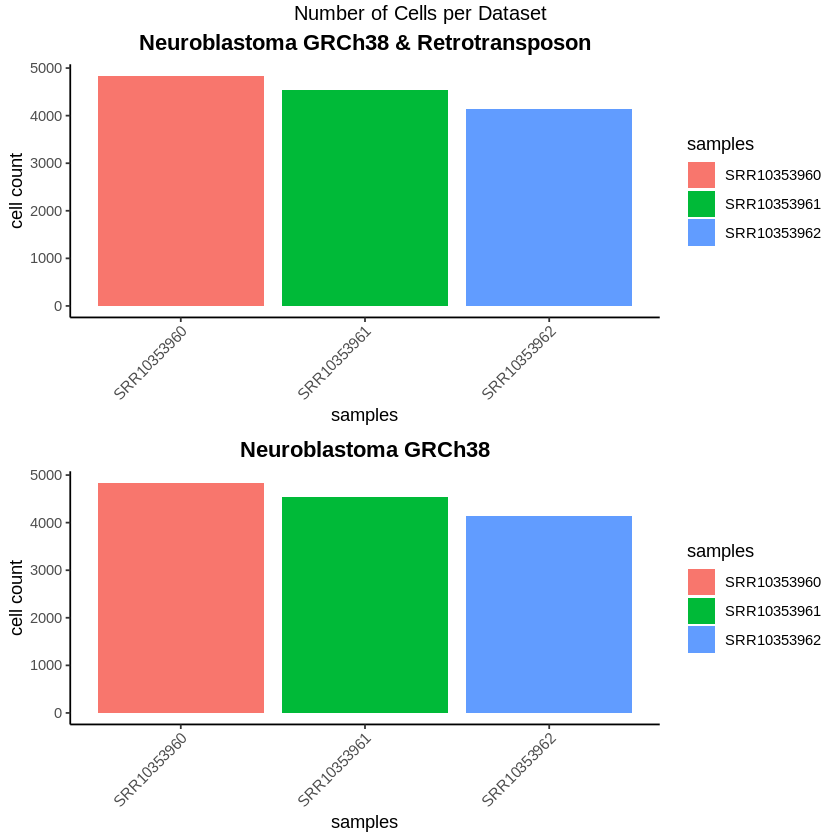

In [31]:
grid.arrange(cellcount_gte, cellcount_GEs, nrow = 2, top="Number of Cells per Dataset")

The cell counts of each sample are quite close together. So there aren't any outliers here. 

UMI per transcript: 
- `nCount_RNA = nUMI`
- On the reference genome mapped samples, 500-1000 transcripts would be considered to shallow. If majority of cells have > 1000 unique transcripts then that would be acceptable.

In [33]:
library(RCurl)
library(scales)


Attaching package: ‘RCurl’


The following object is masked from ‘package:tidyr’:

    complete



Attaching package: ‘scales’


The following object is masked from ‘package:purrr’:

    discard


The following object is masked from ‘package:readr’:

    col_factor




In [44]:
# Visualize the number UMIs/transcripts per cell
umi_gte <- gte_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=nUMI, fill=orig.ident)) + 
    labs(x = "UMI per Transcript (log10)", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    scale_x_log10(labels = comma, limit=c(100, 100000)) + 
    theme_classic() +
    ggtitle("Neuroblastoma GRCh38 & Retrotransposon") + theme(plot.title = element_text(hjust = 0.5)) +
    geom_vline(xintercept = c(500,1000)) + geom_text(aes(x= 500, label="500\n", y = 1), angle=90, colour="black")

umi_TE <- ge_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=nUMI, fill=orig.ident)) + 
    labs(x = "UMI per Transcript (log10)", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    scale_x_log10(labels = comma, limit=c(100, 100000)) + 
    theme_classic() +
    ggtitle("Neuroblastoma GRCh38") + theme(plot.title = element_text(hjust = 0.5)) +
    geom_vline(xintercept = c(500,1000)) + geom_text(aes(x= 500, label="500\n", y = 1), angle=90, colour="black")

In [47]:
# Save figure of UMI per transcript
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_umipertranscript.pdf", width = size*2, height = size)
grid.arrange(umi_TE, umi_gte, nrow = 1, top="Neuroblastoma UMI per Transcript")
dev.off()

png 
  2

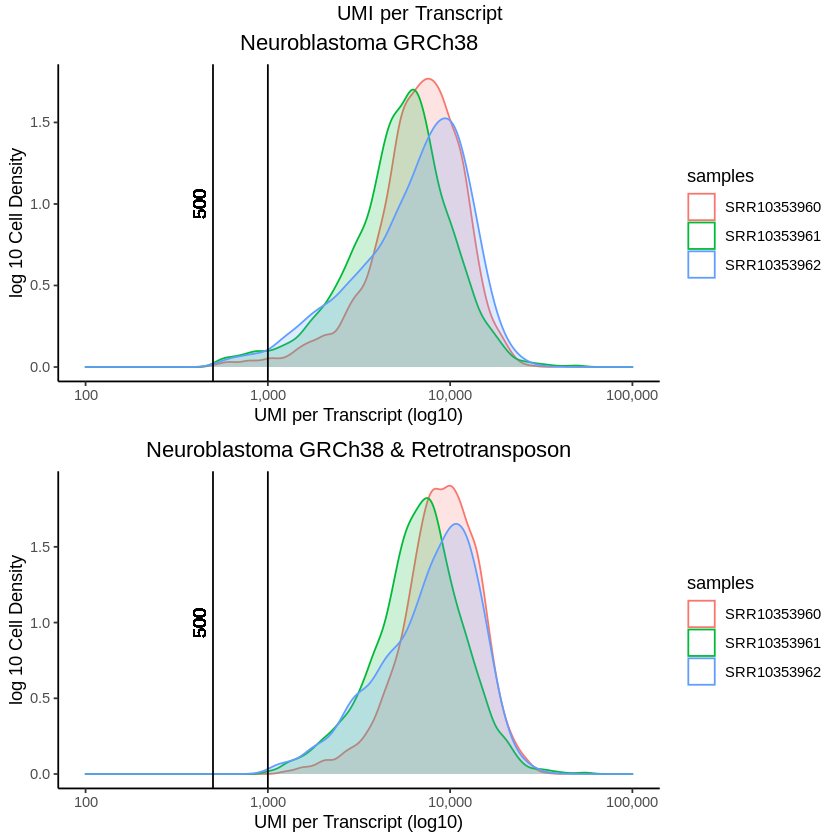

In [45]:
grid.arrange(umi_TE, umi_gte, nrow = 2, top="UMI per Transcript")

Most cells are above the 1000 umi per transcript threshold, so the remaining under 1000 will be filtered out.

Genes Detected per cell
- `nGene = number of features per cell`
- `number of genes detected per UMI`: More genes detected per UMI, the more complex our data

In [48]:
# Visualize the distribution of genes detected per cell
genesh_ge <- ge_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=nGene, fill=orig.ident)) + 
    labs(x = "log 10 Number of Genes Detected per Cell", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    theme_classic() +
    scale_x_log10(labels = comma) + 
    geom_vline(xintercept = 300) +
    ggtitle("Subsetted GrCh38")

# Visualize the distribution of genes detected per cell via violin plot
genesv_ge <- ge_gbmsc@meta.data %>% 
    ggplot(aes(x=orig.ident, y=log10(nGene), fill=orig.ident)) + 
    labs(x = "samples", y = "log 10 Number of Genes Detected per Cell") +
    labs(fill="samples") + scale_fill_discrete(labels = sampleNames) +
    geom_violin() + 
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

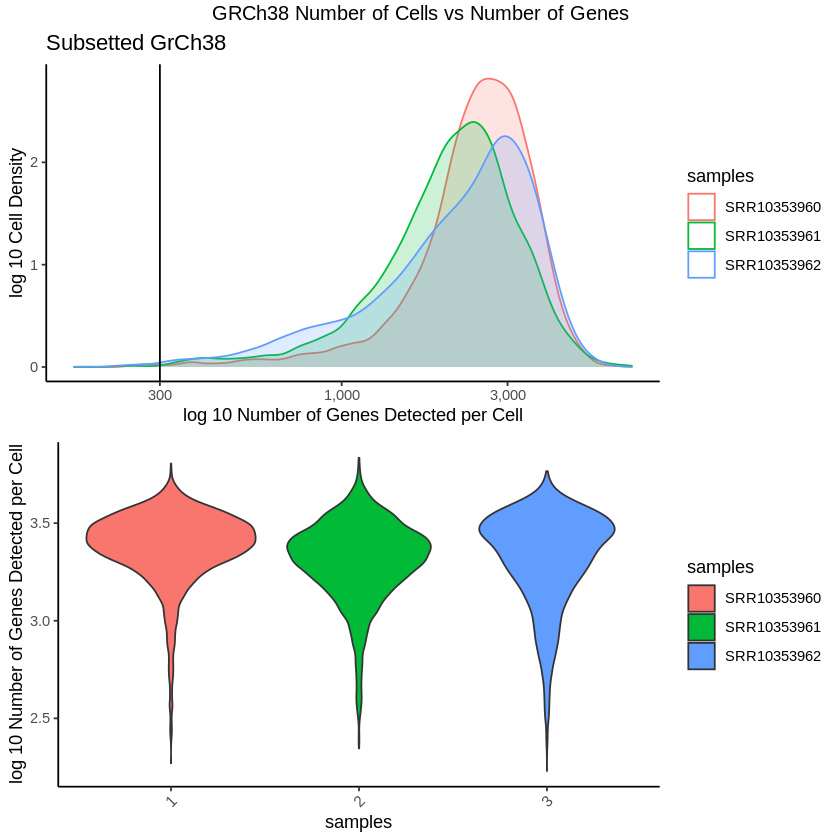

In [50]:
grid.arrange(genesh_ge, genesv_ge, nrow = 2, top = "GRCh38 Number of Cells vs Number of Genes")

In [51]:
# Visualize the distribution of genes detected per cell
genesh_gte <- gte_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=nGene, fill=orig.ident)) + 
    labs(x = "log 10 Number of Genes Detected per Cell", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    theme_classic() +
    scale_x_log10(labels = comma) + 
    geom_vline(xintercept = 300) +
    ggtitle("Subsetted GrCh38")

# Visualize the distribution of genes detected per cell via violin plot
genesv_gte <- gte_gbmsc@meta.data %>% 
    ggplot(aes(x=orig.ident, y=log10(nGene), fill=orig.ident)) + 
    labs(x = "samples", y = "log 10 Number of Genes Detected per Cell") +
    labs(fill="samples") + scale_fill_discrete(labels = sampleNames) +
    geom_violin() + 
    theme_classic() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

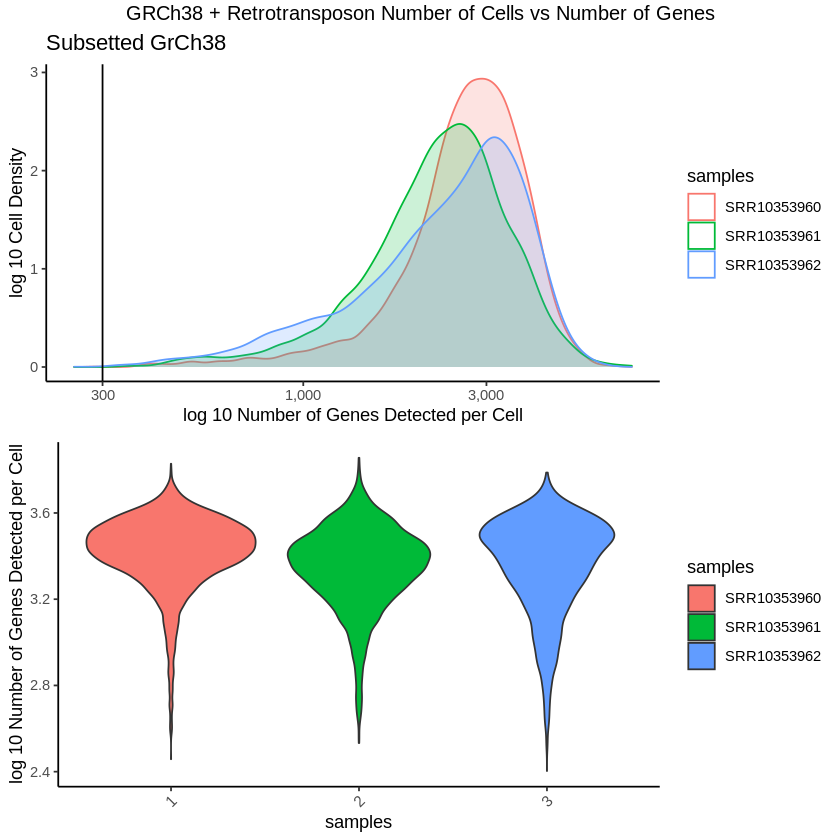

In [54]:
grid.arrange(genesh_gte, genesv_gte, nrow = 2, top = "GRCh38 + Retrotransposon Number of Cells vs Number of Genes")

In [56]:
# Save figure of UMI per transcript
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_genespercell.pdf", width = size*2, height = size)
grid.arrange(genesh_ge, genesv_ge,
             genesh_gte, genesv_gte, 
             nrow = 2, top="Number of Cells vs Number of Genes")
dev.off()

png 
  2

Nothing looks out of the ordinary here, the nGenes per cell is very balanced.

UMI vs Genes detected per cell

In [67]:
# Visualize the correlation between genes detected and number of UMIs 
# and determine whether strong presence of cells with low numbers of genes/UMIs
sampleNames <- list("SRR10353960", "SRR10353961", "SRR10353962")
sampleNames_named <- c(`1` = "SRR10353960", `2` = "SRR10353961", `3` = "SRR10353962")

umigenes_ge <- ge_gbmsc@meta.data %>% 
    ggplot(aes(x=nUMI, y=nGene, color=mitoRatio)) + 
    geom_point() + 
    scale_colour_gradient(low = "gray90", high = "black") +
    stat_smooth(method=lm) +
    scale_x_log10(labels = comma) + 
    scale_y_log10() + 
    labs(x = "log 10 UMI per Transcript", y = "log 10 Genes Detected per Cell") +
    theme_classic() +
    geom_vline(xintercept = 500) +
    geom_hline(yintercept = 250) +
    facet_wrap(~orig.ident, labeller = as_labeller(sampleNames_named)) + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("Neuroblastoma GRCh38") + theme(plot.title = element_text(hjust=0.5, face="bold"))

umigenes_gte <- gte_gbmsc@meta.data %>% 
    ggplot(aes(x=nUMI, y=nGene, color=mitoRatio)) + 
    geom_point() + 
    scale_colour_gradient(low = "gray90", high = "black") +
    stat_smooth(method=lm) +
    scale_x_log10(labels = comma) + 
    scale_y_log10() + 
    labs(x = "log 10 UMI per Transcript", y = "log 10 Genes Detected per Cell") +
    theme_classic() +
    geom_vline(xintercept = 500) + # Threshold for UMI per transcript. 
    geom_hline(yintercept = 250) + # Threshold for Genes detected per cell
    facet_wrap(~orig.ident, labeller = as_labeller(sampleNames_named)) + 
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("Neuroblastoma GRCh38 & Retrotransposon") + theme(plot.title = element_text(hjust=0.5, face="bold"))

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'



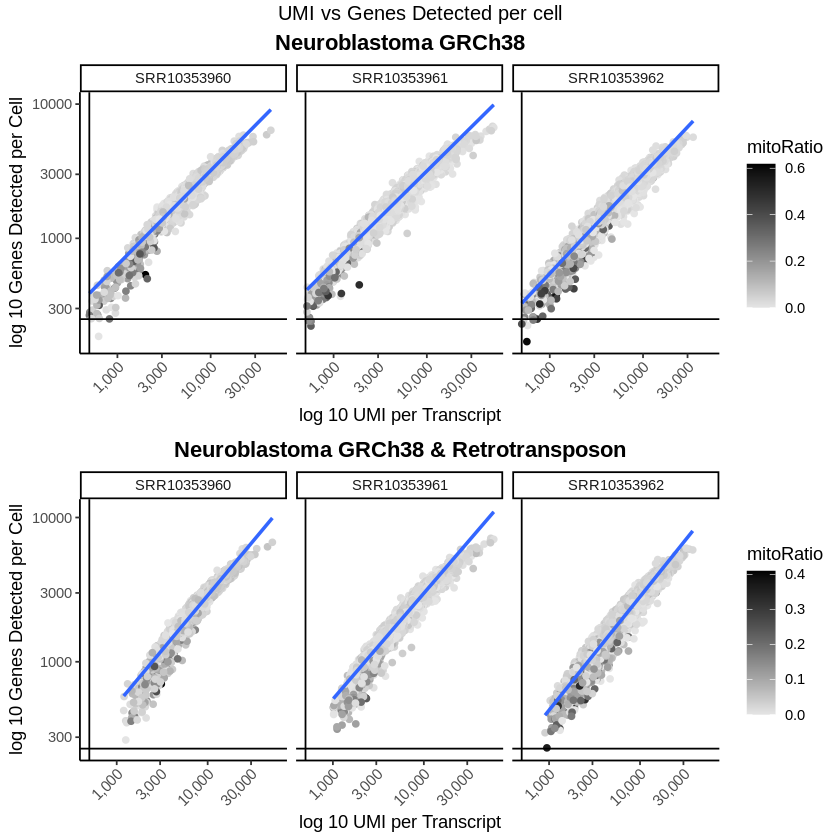

In [68]:
grid.arrange(umigenes_ge, umigenes_gte, nrow = 2, top = "UMI vs Genes Detected per cell")

In [69]:
# Save figure of UMI vs Genes per cell
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_umigenes.pdf", width = size*2, height = size)
grid.arrange(umigenes_ge, umigenes_gte, nrow = 1, top="UMI vs Genes Detected per cell")
dev.off()

`geom_smooth()` using formula 'y ~ x'

`geom_smooth()` using formula 'y ~ x'



png 
  2

For the number of UMI per cell (~2000), there's less genes detected than I expected (<750). There's also a fair amount of cells with high mitochondrial gene ratios, especially in the third sample. The second sample has two visible outliers than can be removed using the mitoRatio threshold (<0.2). 

Let's verify if cells with high mitochondrial ratio is due to cell death with **Mitochondrial Ratio:**
- `mitoRatio = PercentageFeatureSet(object = gte_gbmsc, pattern = "^MT-")`
- `mitochondrial ratio`: Percent of genes originating from the mitochondria
    - The pattern provided (“^MT-“) works for human gene names, so check what the pattern is if working with other organims, depending on the reference genome used, the prefix for mitochondrial genes may be different too: (ie “mt-“, “mt.”, or “MT_”...)

In [72]:
# Visualize the distribution of mitochondrial gene expression detected per cell
mito_ge <- ge_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=mitoRatio, fill=orig.ident)) + 
    labs(x = "Mitochondrial Ratio", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    scale_x_log10() + 
    theme_classic() +
    geom_vline(xintercept = 0.2) + 
    ggtitle("Neuroblastoma GRCh38") + theme(plot.title = element_text(hjust = 0.5))

mito_gte <- gte_gbmsc@meta.data %>% 
    ggplot(aes(color=orig.ident, x=mitoRatio, fill=orig.ident)) + 
    labs(x = "Mitochondrial Ratio", y = "log 10 Cell Density") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) + 
    scale_x_log10() + 
    theme_classic() +
    geom_vline(xintercept = 0.2) + 
    ggtitle("Neuroblastoma GRCh38 & Retrotransposon") + theme(plot.title = element_text(hjust = 0.5))

Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Removed 21 rows containing non-finite values (stat_density).”
Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Removed 21 rows containing non-finite values (stat_density).”


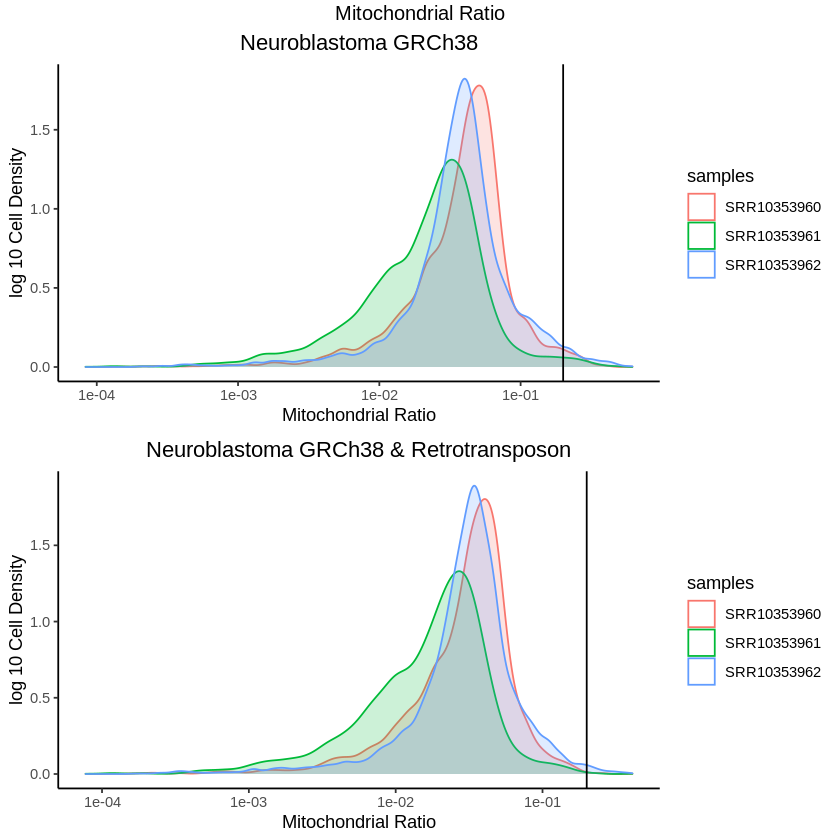

In [73]:
grid.arrange(mito_ge, mito_gte, nrow = 2, top = "Mitochondrial Ratio")

In [74]:
# Save figure of UMI per transcript
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_mitoratio.pdf", width = size*2, height = size)
grid.arrange(mito_ge, mito_gte, nrow = 1, top="Mitochondiral Ratio vs Counts")
dev.off()

Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Removed 21 rows containing non-finite values (stat_density).”
Warning message:
“Transformation introduced infinite values in continuous x-axis”
Warning message:
“Removed 21 rows containing non-finite values (stat_density).”


png 
  2

There's a bit of dead cells as we can see from the top figure (reference genes), so it is a good idea to filter them out and then take the intersect of the two datasets to proceed. 

**Novelty Genes: Complexity** 
- `log10GenesPerUMI = log10(ge_gbmsc$nFeature_RNA) / log10(ge_gbmsc$nCount_RNA)`
- Low complexity cells can indicate contamination in the sample. This is determined by the `log10GenesPerUMI = nGene` value

In [84]:
# Visualize the overall complexity of the gene expression by visualizing the genes detected per UMI
newgenes_ge <- ge_gbmsc@meta.data %>%
    ggplot(aes(x=log10GenesPerUMI, color = orig.ident, fill=orig.ident)) +
    labs(x = "log 10 Genes Detected Per UMI per Transcript", y = "Cell Count") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) +
    theme_classic() +
    geom_vline(xintercept = 0.8) + 
    ggtitle("Neuroblastoma GRCh38") + theme(plot.title = element_text(hjust = 0.5))

newgenes_gte <- gte_gbmsc@meta.data %>%
    ggplot(aes(x=log10GenesPerUMI, color = orig.ident, fill=orig.ident)) +
    labs(x = "log 10 Genes Detected Per UMI per Transcript", y = "Cell Count") +
    labs(color="samples") + scale_color_discrete(labels = sampleNames) +
    guides(fill=FALSE) + 
    geom_density(alpha = 0.2) +
    theme_classic() +
    geom_vline(xintercept = 0.8) + 
    ggtitle("Neuroblastoma GRCh38 + Retrotransposons") + theme(plot.title = element_text(hjust = 0.5))

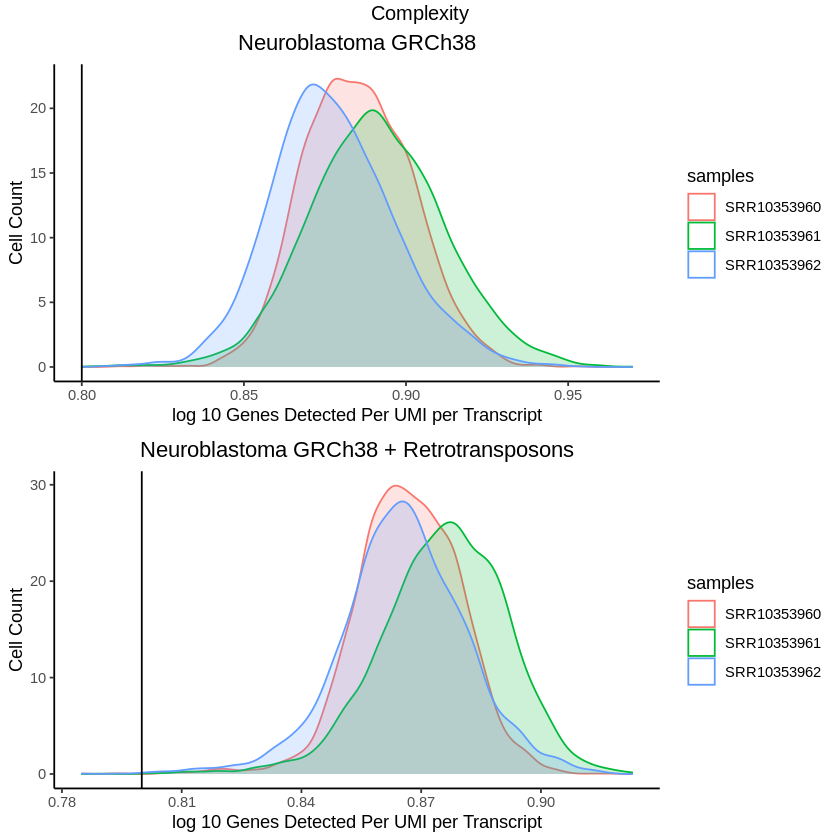

In [85]:
grid.arrange(newgenes_ge, newgenes_gte, nrow = 2, top = "Complexity")

In [82]:
# Save figure of UMI vs Genes per cell
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-11/r_GBMSC_newgenes.pdf", width = size*2, height = size)
grid.arrange(newgenes_ge, newgenes_gte, nrow = 1, top="Gene Complexity")
dev.off()

png 
  2

Nearly all cell are sufficiently complex to continue.

**To summarize,** I will filter out the small population of cells from the reference dataset that had lower than 1000 umi per transcript, less than 300 genes, less than 0.80 log10GenesPerUMI and a mitoRatio > 0.2.

In [86]:
filt_ge_gbmsc <- subset(x = ge_gbmsc, subset= (nUMI >= 1000) & 
                                                (nGene >= 300) & 
                                                (log10GenesPerUMI > 0.80) & 
                                                (mitoRatio < 0.20))

In [87]:
barcode <- colnames(filt_ge_gbmsc)
filt_gte_gbmsc <- subset(gte_gbmsc, cells=barcode)
dim(filt_ge_gbmsc) # 13112 cells
dim(filt_gte_gbmsc) # 13112 cells, around 1000 more genes than filt_ge_gbmsc

dim(ge_gbmsc)[2] - dim(filt_ge_gbmsc)[2] # filtered out 406 cells
dim(gte_gbmsc)[2] - dim(filt_gte_gbmsc)[2] # filtered out 406 cells

[1] 26654 13112

[1] 27711 13112

[1] 406

[1] 406

In [88]:
#save.image('/home/samkyy/scratch/gete-gbm/results/2021-06-11/neuroblastoma.RData')
save(filt_ge_gbmsc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/filt_ge_gbmsc.RData")
save(filt_gte_gbmsc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/filt_gte_gbmsc.RData")

## Merge Datasets (before Normalization)

In [137]:
### load filtered neuroblastoma datasets
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/filt_ge_gbmsc.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/filt_gte_gbmsc.RData")

### load filtered and integrated GBM datasets
load("/home/samkyy/scratch/gete-gbm/data/2021-04-01_integrate/filt_gte_brain.intergrated.RData")
load("/home/samkyy/scratch/gete-gbm/data/2021-04-01_integrate/filt_GE_select.intergrated.RData")

In [138]:
### Rename
filt_GE_select.intergrated@meta.data <- filt_GE_select.intergrated@meta.data %>%
        dplyr::rename(orig.ident = seq_folder,
                     GBM_integrated_snn_res.0.8 = integrated_snn_res.0.8,
                     GBM_seurat_clusters = seurat_clusters)
filt_gte_brain.intergrated@meta.data <- filt_gte_brain.intergrated@meta.data %>%
        dplyr::rename(orig.ident = seq_folder,
                     GBM_integrated_snn_res.0.8 = integrated_snn_res.0.8,
                     GBM_seurat_clusters = seurat_clusters)

colnames(filt_GE_select.intergrated@meta.data)
colnames(filt_gte_brain.intergrated@meta.data)

[1] "orig.ident"                 "nUMI"                      
 [3] "nGene"                      "log10GenesPerUMI"          
 [5] "mitoRatio"                  "cells"                     
 [7] "sample"                     "nCount_RNA"                
 [9] "nFeature_RNA"               "GBM_integrated_snn_res.0.8"
[11] "GBM_seurat_clusters"

[1] "orig.ident"                 "nUMI"                      
 [3] "nGene"                      "log10GenesPerUMI"          
 [5] "mitoRatio"                  "cells"                     
 [7] "sample"                     "nCount_RNA"                
 [9] "nFeature_RNA"               "GBM_integrated_snn_res.0.8"
[11] "GBM_seurat_clusters"

In [139]:
#### Split the dataset into a list of seurat objects by their sample of origin
filt_gte_gbmsc.list <- SplitObject(object=filt_gte_gbmsc, split.by="orig.ident")
filt_ge_gbmsc.list <- SplitObject(object=filt_ge_gbmsc, split.by="orig.ident")

In [140]:
ge_gbm.sc <- merge(filt_GE_select.intergrated, 
                   y = c(filt_ge_gbmsc.list[[1]], filt_ge_gbmsc.list[[2]], filt_ge_gbmsc.list[[3]]), 
                   add.cell.ids = c("GBM", "SC", "SC", "SC"), project = "GE_GBM_GBMSC",
                  merge.data = FALSE) ## do not merge normalized datasets together

In [141]:
gte_gbm.sc <- merge(filt_gte_brain.intergrated, 
                   y = c(filt_gte_gbmsc.list[[1]], filt_gte_gbmsc.list[[2]], filt_gte_gbmsc.list[[3]]), 
                   add.cell.ids = c("GBM", "SC", "SC", "SC"), project = "GE_GBM_GBMSC",
                  merge.data = FALSE) ## do not merge normalized datasets together

In [142]:
head(ge_gbm.sc@meta.data)
head(gte_gbm.sc@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11159_2,16712,4840,3,3
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11159_2,5963,1850,4,4
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11159_2,7866,2355,0,0
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11159_2,14361,3262,0,0
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11159_2,2803,1201,0,0
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11159_2,6865,2756,8,8


In [143]:
dim(ge_gbm.sc@meta.data)
dim(gte_gbm.sc@meta.data)
# total 49670 cells 

[1] 49670    11

[1] 49670    11

### Normalize and Merge Datasets (Ignore)
Find Variable step threw an error, so I need to redo it. 

Normalize Neuroblastoma dataset

In [91]:
#### Split the dataset into a list of seurat objects by their sample of origin
filt_gte_gbmsc.list <- SplitObject(object=filt_gte_gbmsc, split.by="orig.ident")
filt_ge_gbmsc.list <- SplitObject(object=filt_ge_gbmsc, split.by="orig.ident")

#### Normalize and identify variable features for each dataset independently
    # Normalize the RNA reads per tumor sample via Log Normalization method, then remove most variable features (outliers)
for(i in 1:length(filt_ge_gbmsc.list)){
    filt_gte_gbmsc.list[[i]] <- NormalizeData(filt_gte_gbmsc.list[[i]],verbose=TRUE)
#     filt_gte_gbmsc.list[[i]] <- FindVariableFeatures(filt_gte_gbmsc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
    filt_ge_gbmsc.list[[i]] <- NormalizeData(filt_ge_gbmsc.list[[i]],verbose=TRUE)
#     filt_ge_gbmsc.list[[i]] <- FindVariableFeatures(filt_ge_gbmsc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
}

Merge GBM and Neuroblastoma Sparse Matrices and Normalized Matrices

In [112]:
### Rename
filt_GE_select.intergrated@meta.data <- filt_GE_select.intergrated@meta.data %>%
        dplyr::rename(orig.ident = seq_folder,
                     GBM_integrated_snn_res.0.8 = integrated_snn_res.0.8,
                     GBM_seurat_clusters = seurat_clusters)
filt_gte_brain.intergrated@meta.data <- filt_gte_brain.intergrated@meta.data %>%
        dplyr::rename(orig.ident = seq_folder,
                     GBM_integrated_snn_res.0.8 = integrated_snn_res.0.8,
                     GBM_seurat_clusters = seurat_clusters)

colnames(filt_GE_select.intergrated@meta.data)
colnames(filt_gte_brain.intergrated@meta.data)

[1] "orig.ident"                 "nUMI"                      
 [3] "nGene"                      "log10GenesPerUMI"          
 [5] "mitoRatio"                  "cells"                     
 [7] "sample"                     "nCount_RNA"                
 [9] "nFeature_RNA"               "GBM_integrated_snn_res.0.8"
[11] "GBM_seurat_clusters"

[1] "orig.ident"                 "nUMI"                      
 [3] "nGene"                      "log10GenesPerUMI"          
 [5] "mitoRatio"                  "cells"                     
 [7] "sample"                     "nCount_RNA"                
 [9] "nFeature_RNA"               "GBM_integrated_snn_res.0.8"
[11] "GBM_seurat_clusters"

In [113]:
ge_gbm.sc <- merge(filt_GE_select.intergrated, 
                   y = c(filt_ge_gbmsc.list[[1]], filt_ge_gbmsc.list[[2]], filt_ge_gbmsc.list[[3]]), 
                   add.cell.ids = c("GBM", "SC1", "SC2", "SC3"), project = "GE_GBM_GBMSC",
                  merge.data = TRUE) ## merges normalized data and the sparse matrices together

In [114]:
gte_gbm.sc <- merge(filt_gte_brain.intergrated, 
                   y = c(filt_gte_gbmsc.list[[1]], filt_gte_gbmsc.list[[2]], filt_gte_gbmsc.list[[3]]), 
                   add.cell.ids = c("GBM", "SC1", "SC2", "SC3"), project = "GE_GBM_GBMSC",
                  merge.data = TRUE) ## merges normalized data and the sparse matrices together

In [115]:
head(ge_gbm.sc@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14


In [116]:
head(gte_gbm.sc@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11159_2,16712,4840,3,3
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11159_2,5963,1850,4,4
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11159_2,7866,2355,0,0
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11159_2,14361,3262,0,0
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11159_2,2803,1201,0,0
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11159_2,6865,2756,8,8


In [118]:
dim(ge_gbm.sc@meta.data)
dim(gte_gbm.sc@meta.data)
# total 49670 cells 

[1] 49670    11

[1] 49670    11

UMAP and PCA

In [124]:
## create column for 
set <- sapply(X = strsplit(colnames(ge_gbm.sc), split = "_"), FUN = "[", 1)
orig.ident <- ge_gbm.sc@meta.data$orig.ident

ge_gbm.sc@meta.data$neuro.ident <- NA
gte_gbm.sc@meta.data$neuro.ident <- NA

ge_gbm.sc@meta.data$neuro.ident <- paste0(set, orig.ident)
ge_gbm.sc@meta.data$neuro.ident <- paste0(set, orig.ident)

In [126]:
head(ge_gbm.sc@meta.data)
head(gte_gbm.sc@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7,GBM1
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3,GBM1
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0,GBM1
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0,GBM1
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0,GBM1
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14,GBM1


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<list>,<dbl>,<int>,<chr>,<chr>,<lgl>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11159_2,16712,4840,3,3,NA
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11159_2,5963,1850,4,4,NA
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11159_2,7866,2355,0,0,NA
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11159_2,14361,3262,0,0,NA
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11159_2,2803,1201,0,0,NA
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11159_2,6865,2756,8,8,NA


In [129]:
## Split dataset to their samples

groups <- ge_gbm.sc@meta.data$neuro.ident
names(groups) <- colnames(ge_gbm.sc)
ge_gbm.sc <- AddMetaData(object = ge_gbm.sc, metadata = groups, col.name = "neuro.ident")
gte_gbm.sc <- AddMetaData(object = gte_gbm.sc, metadata = groups, col.name = "neuro.ident")

In [135]:
### save merged dataset
save(ge_gbm.sc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_ge_gbmsc.RData")
save(gte_gbm.sc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_gte_gbmsc.RData")

In [130]:
gte_gbm.sc.list <- SplitObject(object=ge_gbm.sc, split.by="neuro.ident")
ge_gbm.sc.list <- SplitObject(object=gte_gbm.sc, split.by="neuro.ident")

#### Normalize and identify variable features for each dataset independently
    # Normalize the RNA reads per tumor sample via Log Normalization method, then remove most variable features (outliers)
for(i in 1:length(ge_gbm.sc.list)){
#     gte_gbm.sc.list[[i]] <- NormalizeData(gte_gbm.sc.list[[i]],verbose=TRUE)
    gte_gbm.sc.list[[i]] <- FindVariableFeatures(gte_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
#     ge_gbm.sc.list[[i]] <- NormalizeData(ge_gbm.sc.list[[i]],verbose=TRUE)
    ge_gbm.sc.list[[i]] <- FindVariableFeatures(ge_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
}

ERROR: Error in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, : invalid 'x'


## Create Unique Identities for each Sample (Metadata)

In [147]:
## create column for 
set <- sapply(X = strsplit(colnames(ge_gbm.sc), split = "_"), FUN = "[", 1)
orig.ident <- ge_gbm.sc@meta.data$orig.ident

ge_gbm.sc@meta.data$neuro.ident <- NA
gte_gbm.sc@meta.data$neuro.ident <- NA

ge_gbm.sc@meta.data$neuro.ident <- paste0(set, orig.ident)
gte_gbm.sc@meta.data$neuro.ident <- paste0(set, orig.ident)

In [149]:
head(ge_gbm.sc@meta.data$neuro.ident)
tail(ge_gbm.sc@meta.data$neuro.ident)

[1] "GBM1" "GBM1" "GBM1" "GBM1" "GBM1" "GBM1"

[1] "SC3" "SC3" "SC3" "SC3" "SC3" "SC3"

In [150]:
## Split dataset to their samples

groups <- ge_gbm.sc@meta.data$neuro.ident
names(groups) <- colnames(ge_gbm.sc)
ge_gbm.sc <- AddMetaData(object = ge_gbm.sc, metadata = groups, col.name = "neuro.ident")
gte_gbm.sc <- AddMetaData(object = gte_gbm.sc, metadata = groups, col.name = "neuro.ident")

In [151]:
### save merged dataset
save(ge_gbm.sc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_ge_gbmsc2.RData")
save(gte_gbm.sc, file="/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_gte_gbmsc2.RData")

## Normalization & Find Variable Features (Ignore)

In [152]:
gte_gbm.sc.list <- SplitObject(object=ge_gbm.sc, split.by="neuro.ident")
ge_gbm.sc.list <- SplitObject(object=gte_gbm.sc, split.by="neuro.ident")

2021-06:
- Fix Normalization and FindVariableFeatures issue

In [151]:
# load merged datasets
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_ge_gbmsc2.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_gte_gbmsc2.RData")

In [152]:
gte_gbm.sc.list <- SplitObject(object=ge_gbm.sc, split.by="neuro.ident")
ge_gbm.sc.list <- SplitObject(object=gte_gbm.sc, split.by="neuro.ident")

In [153]:
#### Normalize and identify variable features for each dataset independently
    # Normalize the RNA reads per tumor sample via Log Normalization method, then remove most variable features (outliers)
for(i in 1:length(ge_gbm.sc.list)){
    gte_gbm.sc.list[[i]] <- NormalizeData(gte_gbm.sc.list[[i]],verbose=TRUE)
    gte_gbm.sc.list[[i]] <- FindVariableFeatures(gte_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
    ge_gbm.sc.list[[i]] <- NormalizeData(ge_gbm.sc.list[[i]],verbose=TRUE)
    ge_gbm.sc.list[[i]] <- FindVariableFeatures(ge_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
}

ERROR: Error in simpleLoess(y, x, w, span, degree = degree, parametric = parametric, : invalid 'x'


## Normalization, FindVariableFeatures

2021-06-15:

Trying to fix the simpleLoess error above by CreateAssayObject() then Normalize Data again. May have been because Normalize Data took too much memory and I didn't have enough to process it? This notebook uses 60Gb instead of 30Gb but just on 1 CPU instead of 2. 

In [5]:
# load merged datasets
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_ge_gbmsc2.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-11/merged_gte_gbmsc2.RData")

In [6]:
ls()

[1] "ge_gbm.sc"   "gte_gbm.sc"  "mkdirToday"  "resultsPath" "setwdToday"

In [7]:
GE_gbm.sc <- CreateAssayObject(counts = ge_gbm.sc@assays[["RNA"]]@counts)
GTE_gbm.sc <- CreateAssayObject(counts = gte_gbm.sc@assays[["RNA"]]@data)

In [11]:
### Normalize Data for Reference Mapped Dataset
GE_gbm.sc <- NormalizeData(GE_gbm.sc, verbose = T, normalization.method = "LogNormalize") %>% FindVariableFeatures(selection.method = "vst", nfeatures = 2500) %>% ScaleData()

###add counts and the scale data to the Old object
ge_gbm.sc@assays[["RNA"]]@counts <- GE_gbm.sc@counts
ge_gbm.sc@assays[["RNA"]]@scale.data <- GE_gbm.sc@scale.data

Centering and scaling data matrix



In [13]:
### Normalize Data for Reference + Retrotransposon Mapped Dataset
GTE_gbm.sc <- NormalizeData(GTE_gbm.sc, verbose = T, normalization.method = "LogNormalize") %>% FindVariableFeatures(selection.method = "vst", nfeatures = 2500) %>% ScaleData()

###add counts and the scale data to the Old object
gte_gbm.sc@assays[["RNA"]]@counts <- GTE_gbm.sc@counts
gte_gbm.sc@assays[["RNA"]]@scale.data <- GTE_gbm.sc@scale.data

Centering and scaling data matrix



In [15]:
### Split by Sample
# GE_gbm.sc.list <- SplitObject(object=GE_gbm.sc, split.by="neuro.ident")
# GTE_gbm.sc.list <- SplitObject(object=GTE_gbm.sc, split.by="neuro.ident")

ge_gbm.sc.list <- SplitObject(object=ge_gbm.sc, split.by="neuro.ident")
gte_gbm.sc.list <- SplitObject(object=gte_gbm.sc, split.by="neuro.ident")

Parameters for Normalization:
- LogNormalization (default) -- Feature counts for each cell are divided by the total counts for that cell and multiplied by the scale.factor. This is then natural-log transformed using log1p.

Parameters for Find Variable Features:
- Selection.method -- vst
- Number of Features -- 2500

In [30]:
for (i in 1:length(ge_gbm.sc.list)) {
    ### Change active.ident as orig.ident for GBM samples
    ge_gbm.sc.list[[i]]@active.ident <- factor(ge_gbm.sc.list[[i]]@meta.data$orig.ident)
    gte_gbm.sc.list[[i]]@active.ident <- factor(gte_gbm.sc.list[[i]]@meta.data$orig.ident)
}

In [31]:
#### Normalize and identify variable features for each dataset independently
    # Normalize the RNA reads per tumor sample via Log Normalization method, then remove most variable features (outliers)
for(i in 1:length(ge_gbm.sc.list)){
    print(paste0("Processing Sample Number: ",i))
    DefaultAssay(gte_gbm.sc.list[[i]]) <- "RNA"
    DefaultAssay(ge_gbm.sc.list[[i]]) <- "RNA"
    gte_gbm.sc.list[[i]] <- NormalizeData(gte_gbm.sc.list[[i]],verbose=TRUE)
    ge_gbm.sc.list[[i]] <- NormalizeData(ge_gbm.sc.list[[i]],verbose=TRUE)
    gte_gbm.sc.list[[i]] <- FindVariableFeatures(gte_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
    ge_gbm.sc.list[[i]] <- FindVariableFeatures(ge_gbm.sc.list[[i]],selection.method="vst",nfeatures=2500,verbose=TRUE)
}

[1] "Processing Sample Number: 1"
[1] "Processing Sample Number: 2"
[1] "Processing Sample Number: 3"
[1] "Processing Sample Number: 4"
[1] "Processing Sample Number: 5"
[1] "Processing Sample Number: 6"
[1] "Processing Sample Number: 7"
[1] "Processing Sample Number: 8"
[1] "Processing Sample Number: 9"
[1] "Processing Sample Number: 10"
[1] "Processing Sample Number: 11"
[1] "Processing Sample Number: 12"
[1] "Processing Sample Number: 13"
[1] "Processing Sample Number: 14"
[1] "Processing Sample Number: 15"


In [32]:
### Find Integration Anchors (memory: 60Gb) ~1h30min
ge_gbm.sc.anchors <- FindIntegrationAnchors(ge_gbm.sc.list,dims=1:20) 
ge_gbm.sc.intergrated <- IntegrateData(anchorset = ge_gbm.sc.anchors,dims=1:20)

### Find Integration Anchors (memory: 60Gb) ~1h30min
gte_gbm.sc.anchors <- FindIntegrationAnchors(gte_gbm.sc.list,dims=1:20)
gte_gbm.sc.intergrated <- IntegrateData(anchorset = gte_gbm.sc.anchors,dims=1:20)

Computing 2000 integration features

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3754 anchors

Filtering anchors

	Retained 2038 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3859 anchors

Filtering anchors

	Retained 2138 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4366 anchors

Filtering anchors

	Retained 3312 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5149 anchors

Filtering anchors

	Retained 1817 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5972 anchors

Filtering anchors

	Retained 2106 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 6073 anchors

Filtering anchors

	Retained 2202 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4939 anchors


Finding anchors

	Found 2492 anchors

Filtering anchors

	Retained 900 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 14151 anchors

Filtering anchors

	Retained 2662 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5900 anchors

Filtering anchors

	Retained 592 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5312 anchors

Filtering anchors

	Retained 1134 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 13611 anchors

Filtering anchors

	Retained 1466 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 2432 anchors

Filtering anchors

	Retained 920 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4870 anchors

Filtering anchors

	Retained 1279 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5959 anchors

Filtering anchors

	Retai

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3799 anchors

Filtering anchors

	Retained 2121 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3764 anchors

Filtering anchors

	Retained 2123 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4439 anchors

Filtering anchors

	Retained 3510 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5093 anchors

Filtering anchors

	Retained 1707 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5932 anchors

Filtering anchors

	Retained 1947 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 6177 anchors

Filtering anchors

	Retained 2044 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4909 anchors

Filtering anchors

	Retained 909 anc

Filtering anchors

	Retained 880 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 14003 anchors

Filtering anchors

	Retained 2635 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5831 anchors

Filtering anchors

	Retained 597 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5250 anchors

Filtering anchors

	Retained 1079 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 13405 anchors

Filtering anchors

	Retained 2689 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 2381 anchors

Filtering anchors

	Retained 860 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 4881 anchors

Filtering anchors

	Retained 1580 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 5976 anchors

Filtering anchors

	Retained 1320 anchors

Running CCA

Merging

In [33]:
# specify that we will perform downstream analysis on the corrected data note that the original
# unmodified data still resides in the 'RNA' assay
DefaultAssay(object = ge_gbm.sc.intergrated) <- "integrated"
DefaultAssay(object = gte_gbm.sc.intergrated) <- "integrated"

In [ ]:
# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(ge_gbm.sc.intergrated), 10)
top10 <- head(VariableFeatures(gte_gbm.sc.intergrated), 10)

# plot variable features with labels
plot1_ge <- VariableFeaturePlot(ge_gbm.sc.intergrated)
plot2_ge <- LabelPoints(plot = plot1_ge, points = top10, repel = TRUE)

plot1_gte <- VariableFeaturePlot(ge_gbm.sc.intergrated)
plot2_gte <- LabelPoints(plot = plot1_gte, points = top10, repel = TRUE)


grid.arrange(plot2_ge, plot2_gte, nrow = 2, top="Top 10 Variable Genes")

In [34]:
mkdirToday()

save(ge_gbm.sc.intergrated, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.intergrated.RData")
save(gte_gbm.sc.intergrated, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.intergrated.RData")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-06-15' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-06-15"


<div class="cite2c-biblio"></div>## PCA

2021-06-16: 

In [5]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.intergrated.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.intergrated.RData")
ls()

[1] "ge_gbm.sc.intergrated"  "gte_gbm.sc.intergrated" "mkdirToday"            
[4] "resultsPath"            "setwdToday"

Next, we apply a linear transformation (‘scaling’) that is a standard pre-processing step prior to dimensional reduction techniques like PCA. The ScaleData() function:
- Shifts the expression of each gene, so that the mean expression across cells is 0
- Scales the expression of each gene, so that the variance across cells is 1
- This step gives equal weight in downstream analyses, so that highly-expressed genes do not dominate
- The results of this are stored in pbmc[["RNA"]]@scale.data

In [6]:
# Run the standard workflow for visualization and clustering (ScaleData, RunPCA, RunUMAP, FindNeighbors, FindClusters)
ge_gbm.sc.intergrated <- ScaleData(object = ge_gbm.sc.intergrated, verbose = FALSE)
gte_gbm.sc.intergrated <- ScaleData(object = gte_gbm.sc.intergrated, verbose = FALSE)

Since we're using 'SCTransform' under the Seurat package. It's not so important to select which principal components to compute the clusters with since it can better take into account more variation from the data.

By default Seurat uses the 'K-nearest Neighbor' method to cluster each cell together.

> For datasets of 3,000 - 5,000 cells, the resolution set between 0.4-1.4 generally yields good clustering. Increased resolution values lead to a greater number of clusters, which is often required for larger datasets.

By default, the resolution is: 0.8

In [20]:
class(ge_gbm.sc.intergrated@meta.data$sample)
class(gte_gbm.sc.intergrated@meta.data$sample)

[1] "list"

[1] "list"

In [21]:
### factor the sample names in the correct order
ge_gbm.sc.intergrated@meta.data$sample <- factor(ge_gbm.sc.intergrated@meta.data$sample, 
                                                          levels = c("SF11159_1", "SF11159_2", 
                                                                     "SF11209_GBM1", "SF11209_GBM2", 
                                                                     "SF22215_GBM1", "SF22215_GBM2", 
                                                                     "SF11232_1", "SF11232_2", 
                                                                     "Tumor2_1", "Tumor2_2", 
                                                                     "TQ1", "TQ4", 
                                                                     "SRR10353960",
                                                                     "SRR10353961", 
                                                                     "SRR10353962"))
### factor the sample names in the correct order
gte_gbm.sc.intergrated@meta.data$sample <- factor(gte_gbm.sc.intergrated@meta.data$sample, 
                                                          levels = c("SF11159_1", "SF11159_2", 
                                                                     "SF11209_GBM1", "SF11209_GBM2", 
                                                                     "SF22215_GBM1", "SF22215_GBM2", 
                                                                     "SF11232_1", "SF11232_2", 
                                                                     "Tumor2_1", "Tumor2_2", 
                                                                     "TQ1", "TQ4", 
                                                                     "SRR10353960",
                                                                     "SRR10353961", 
                                                                     "SRR10353962"))

In [23]:
head(ge_gbm.sc.intergrated@meta.data$sample)
tail(gte_gbm.sc.intergrated@meta.data$sample)

[1] SF11159_2 SF11159_2 SF11159_2 SF11159_2 SF11159_2 SF11159_2
15 Levels: SF11159_1 SF11159_2 SF11209_GBM1 SF11209_GBM2 ... SRR10353962

[1] SRR10353962 SRR10353962 SRR10353962 SRR10353962 SRR10353962 SRR10353962
15 Levels: SF11159_1 SF11159_2 SF11209_GBM1 SF11209_GBM2 ... SRR10353962

In [24]:
save(ge_gbm.sc.intergrated, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.intergrated.RData")
save(gte_gbm.sc.intergrated, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.intergrated.RData")

2021-06-17:
- Redoing PCA and UMAP while also testing the optimum number of PCs for downstream analysis

In [5]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.intergrated.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.intergrated.RData")

In [14]:
# Run PCA and UMAP ~10min 
ge_gbm.sc.int.pca <- RunPCA(object = ge_gbm.sc.intergrated, npcs = 20, verbose = FALSE)

# Run PCA and UMAP ~10min
gte_gbm.sc.int.pca <- RunPCA(object = gte_gbm.sc.intergrated, npcs = 20, verbose = FALSE)

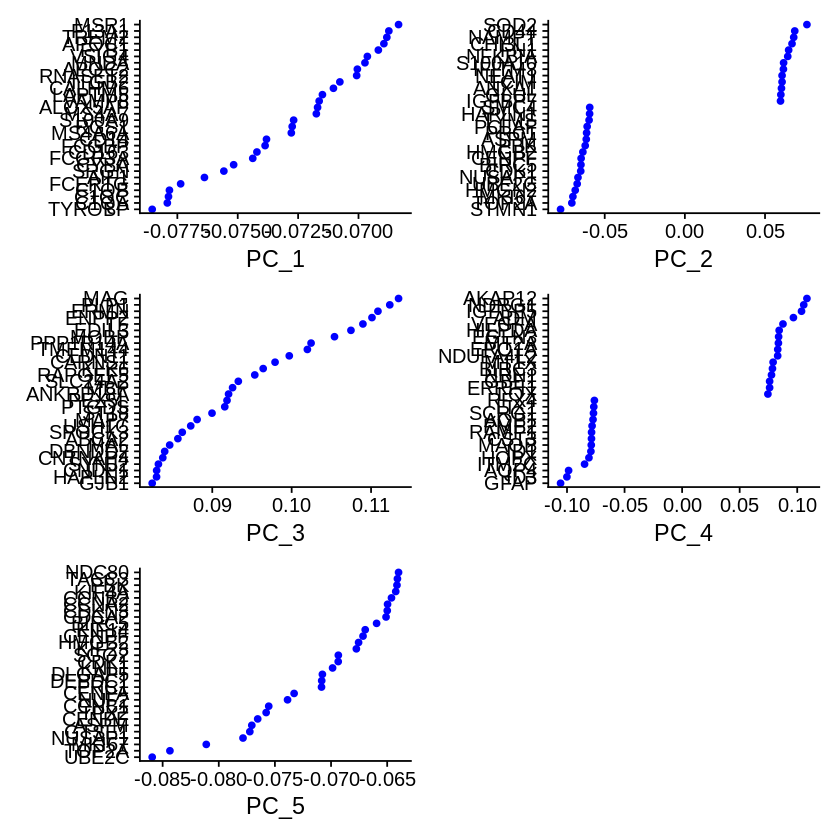

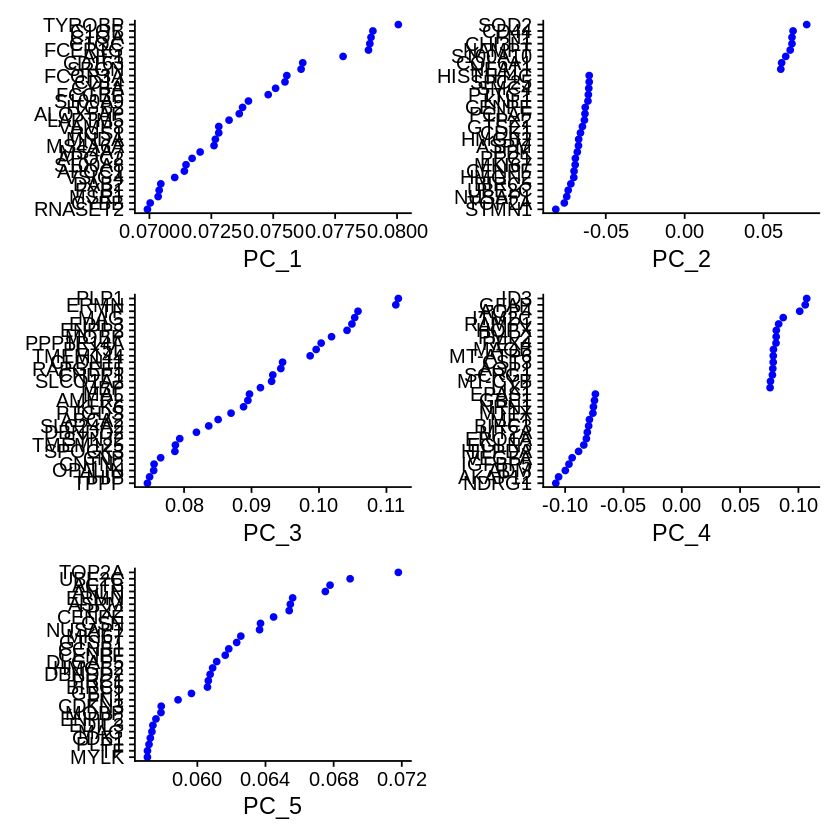

In [15]:
VizDimLoadings(ge_gbm.sc.int.pca, dims = 1:5, reduction = "pca")
VizDimLoadings(gte_gbm.sc.int.pca, dims = 1:5, reduction = "pca")

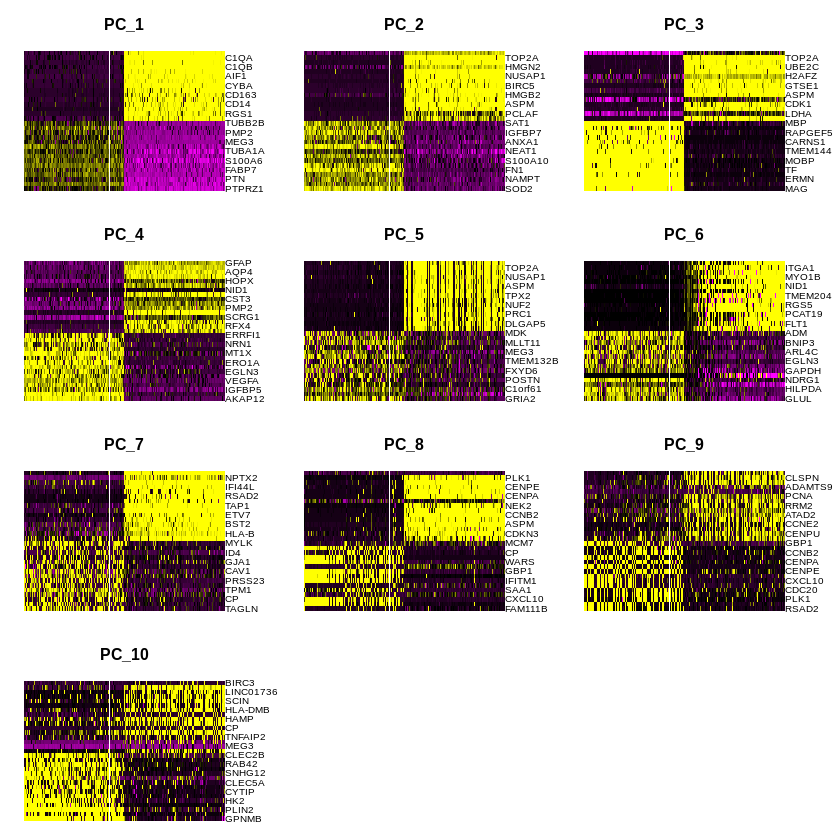

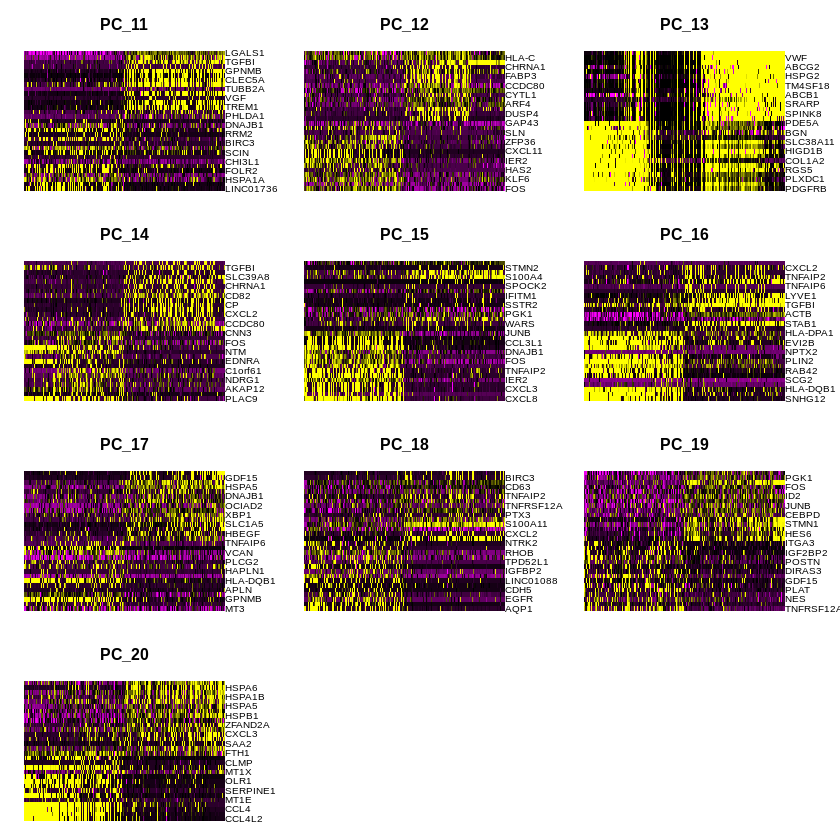

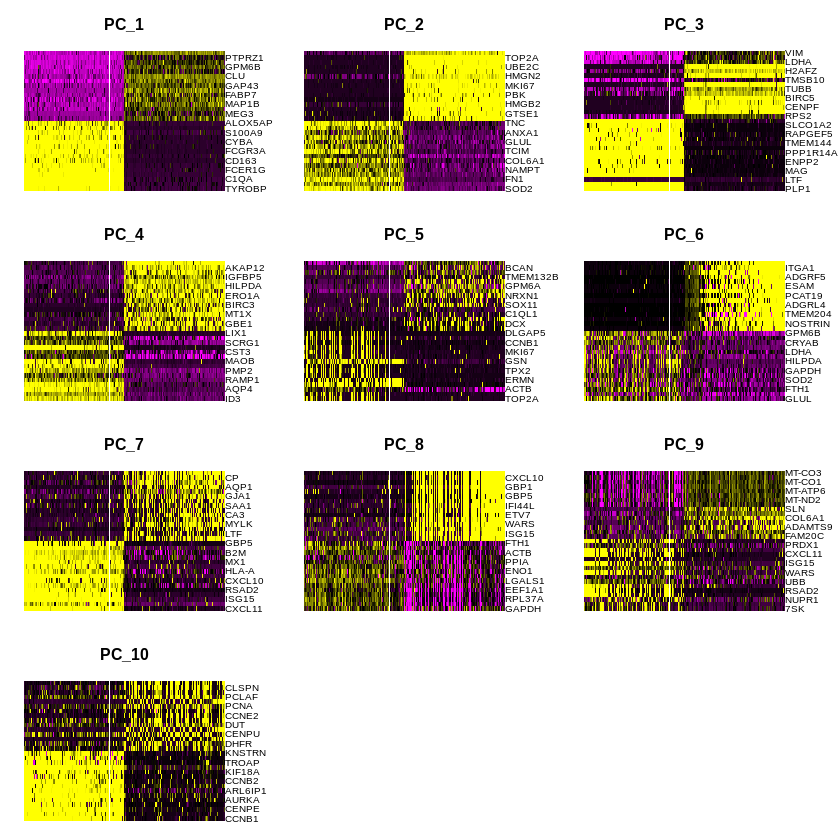

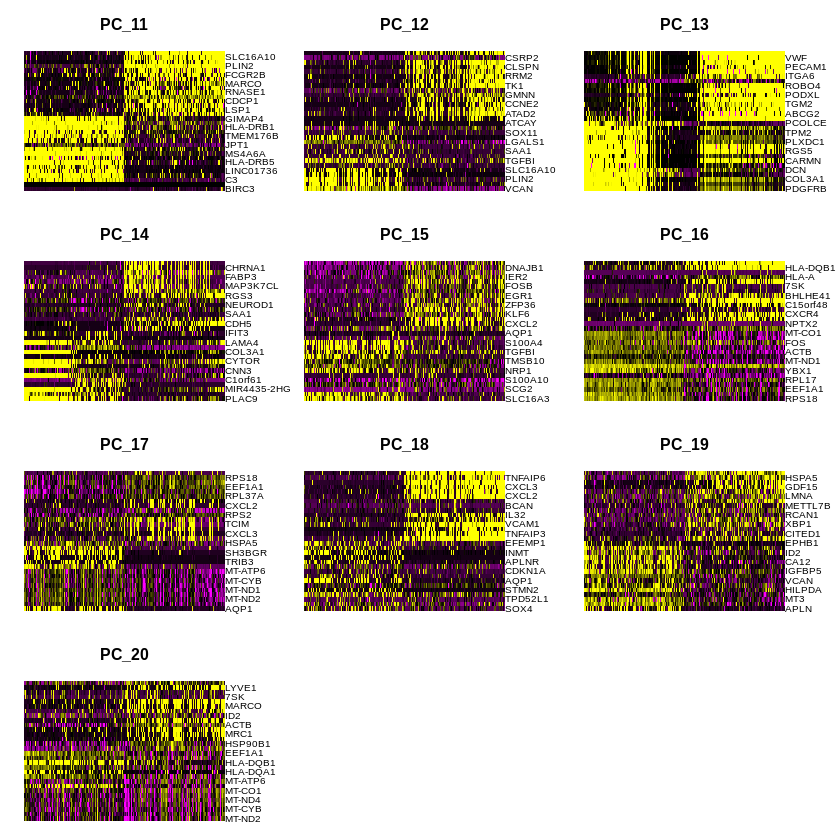

In [16]:
DimHeatmap(ge_gbm.sc.int.pca, dims = 1:10, cells = 1000, balanced = TRUE)
DimHeatmap(ge_gbm.sc.int.pca, dims = 11:20, cells = 500, balanced = TRUE)
DimHeatmap(gte_gbm.sc.int.pca, dims = 1:10, cells = 1000, balanced = TRUE)
DimHeatmap(gte_gbm.sc.int.pca, dims = 11:20, cells = 500, balanced = TRUE)

There is very clear separation between negatively and positively correlation variables in the first 8-9 PCs, and it begins to get fuzzy afterwards. There are some strange cells in PC 10 of the reference gene dataset where some supposedly variably expressed genes are equally expressed. 

The remaining PCs especially after 12 are not well separated. 

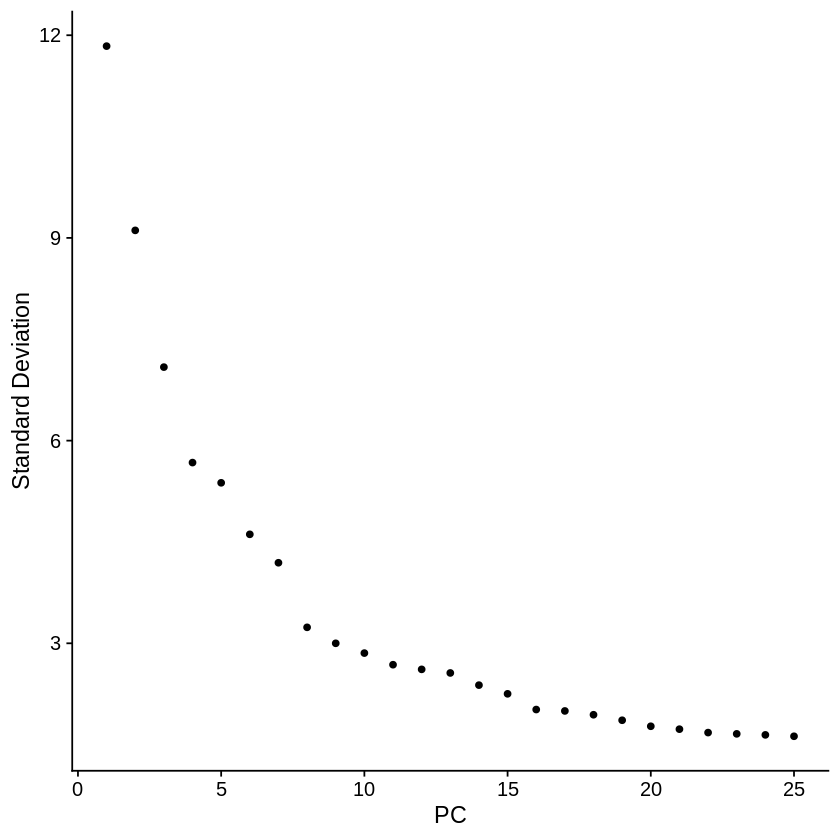

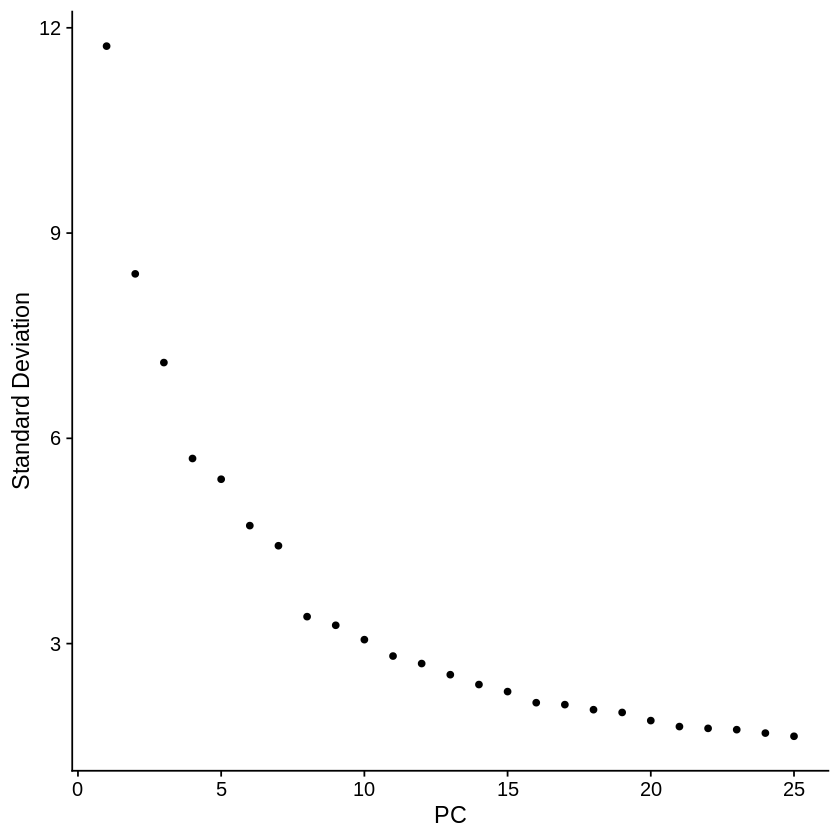

In [13]:
# Which PCAs should we include in our analyses? 
ElbowPlot(object = ge_gbm.sc.int.pca, ndims = 20)
ElbowPlot(object = gte_gbm.sc.int.pca, ndims = 20)

I will test PC 8, 10 and 12 for downstream analysis

Warning message:
"Removed 21000 rows containing missing values (geom_point)."


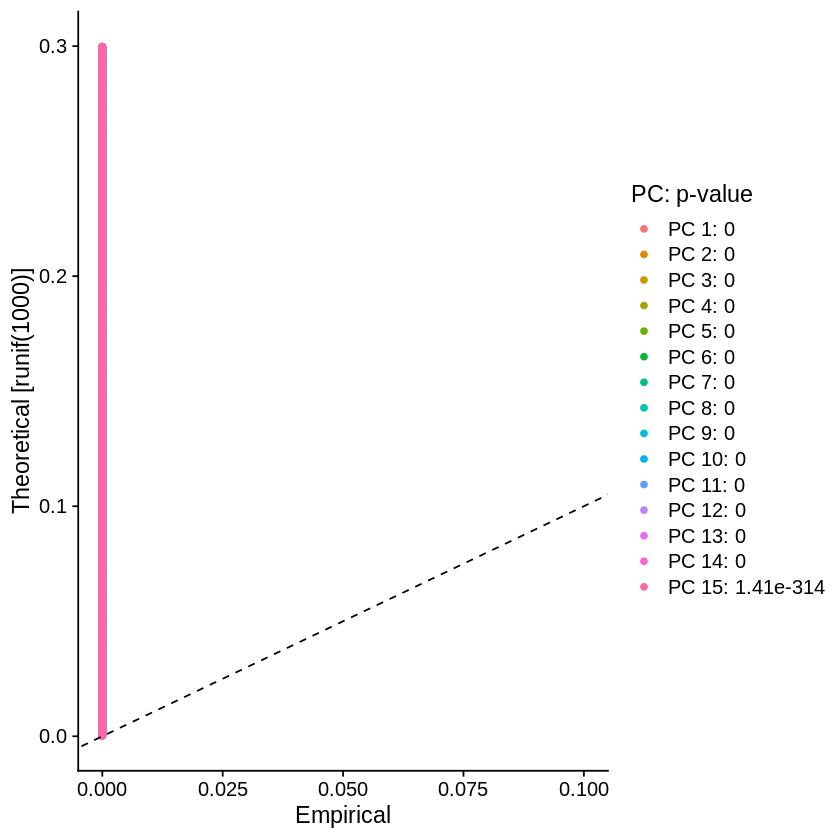

In [17]:
# NOTE: This process can take a long time for big datasets, comment out for expediency. More
# approximate techniques such as those implemented in ElbowPlot() can be used to reduce
# computation time
ge_gbm.sc.int.pca <- JackStraw(ge_gbm.sc.int.pca, num.replicate = 100, dims = 20)
ge_gbm.sc.int.pca <- ScoreJackStraw(ge_gbm.sc.int.pca, dims = 1:20)
JackStrawPlot(ge_gbm.sc.int.pca, dims = 1:15)

Warning message:
"Removed 21000 rows containing missing values (geom_point)."


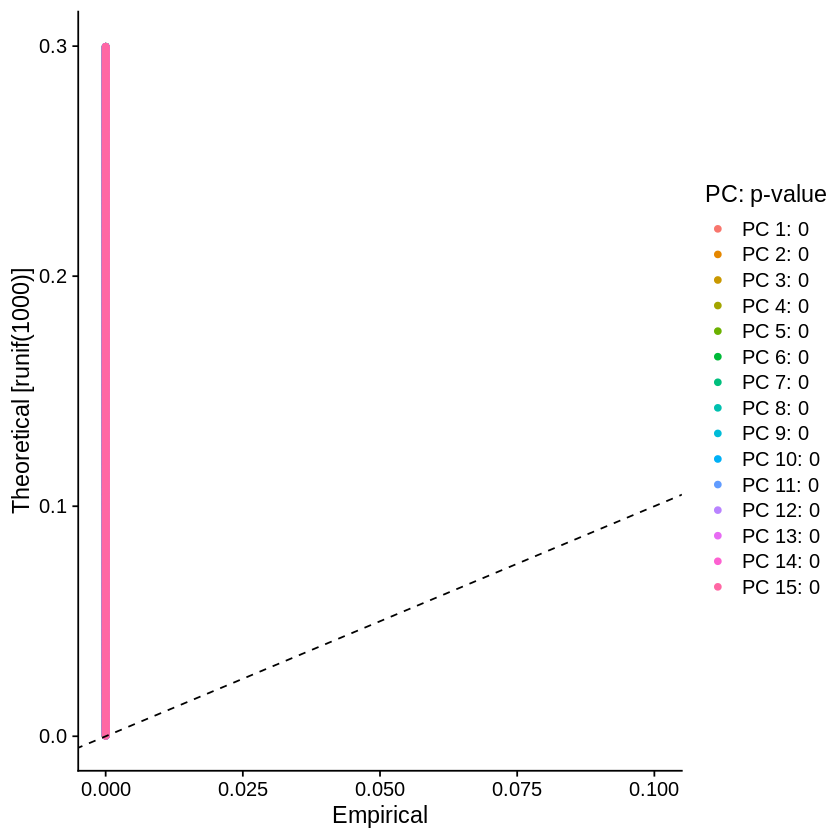

In [18]:
# NOTE: This process can take a long time for big datasets, comment out for expediency. More
# approximate techniques such as those implemented in ElbowPlot() can be used to reduce
# computation time
gte_gbm.sc.int.pca <- JackStraw(gte_gbm.sc.int.pca, num.replicate = 100, dims = 20)
gte_gbm.sc.int.pca <- ScoreJackStraw(gte_gbm.sc.int.pca, dims = 1:20)
JackStrawPlot(gte_gbm.sc.int.pca, dims = 1:15)

In [19]:
save(ge_gbm.sc.int.pca, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.int.pca.RData")
save(gte_gbm.sc.int.pca, file="/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.int.pca.RData")

In [20]:
print("JackStrawPlot complete")

[1] "JackStrawPlot complete"


In [8]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.int.pca.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.int.pca.RData")

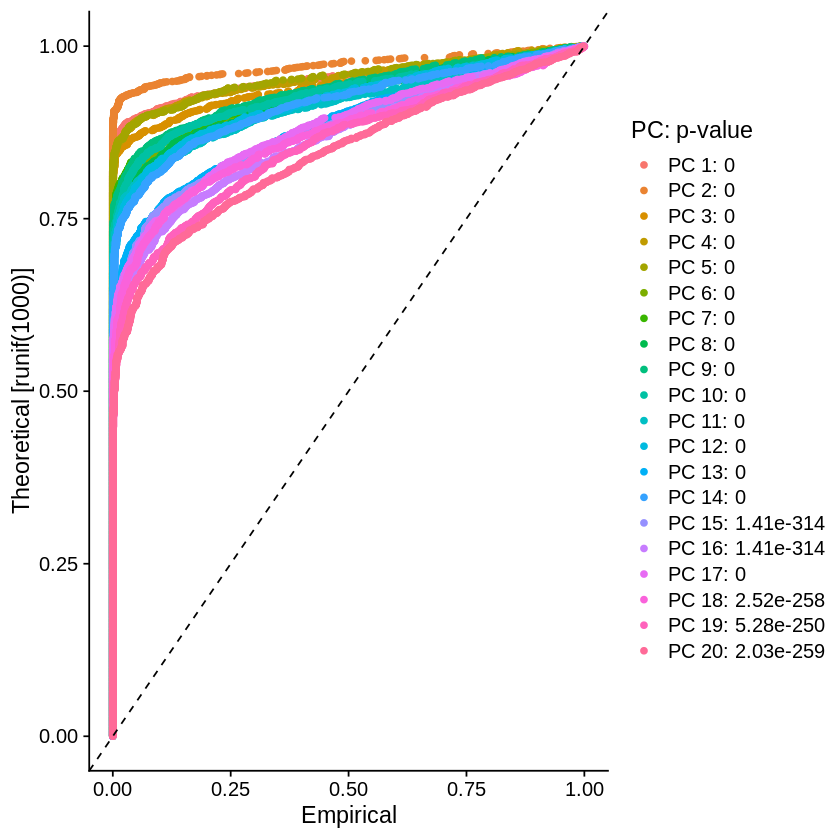

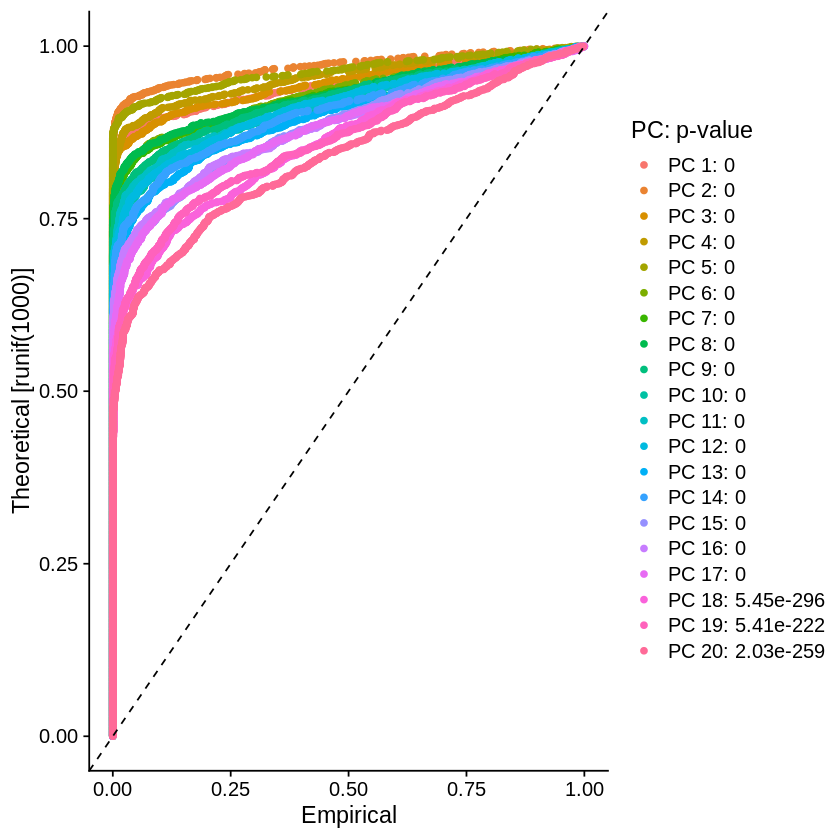

In [27]:
JackStrawPlot(ge_gbm.sc.int.pca, dims = 1:20, xmax = 1.0,ymax = 1.0)
JackStrawPlot(gte_gbm.sc.int.pca, dims = 1:20, xmax = 1.0,ymax = 1.0)

The p-values are quite low, may be an effect of false discovery rate, but not sure how to verify that. So far all PCs significantly represent the variability of the data unlike what I concluded from the elbow plot. Therefore, I would use all the PCs in downstream analysis. 

In [29]:
ge_gbm.sc.int.umap <- RunUMAP(object = ge_gbm.sc.int.pca, 
                                 reduction = "pca", dims = 1:20, umap.method = "uwot", metric = "cosine")
save(ge_gbm.sc.int.umap,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap.RData")
# save(ge_gbm.sc.intergrated,file="/home/samkyy/scratch/RetroTransposonAnalysis/code/data/filt_GE_select.intergrated.dat")

gte_gbm.sc.int.umap <- RunUMAP(object = gte_gbm.sc.int.pca, 
                                 reduction = "pca", dims = 1:20, umap.method = "uwot", metric = "cosine")
save(gte_gbm.sc.int.umap,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap.RData")
# save(ge_gbm.sc.intergrated,file="/home/samkyy/scratch/RetroTransposonAnalysis/code/data/filt_GE_select.intergrated.dat")

Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
11:18:59 UMAP embedding parameters a = 0.9922 b = 1.112

11:18:59 Read 49670 rows and found 20 numeric columns

11:18:59 Using Annoy for neighbor search, n_neighbors = 30

11:19:00 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:19:06 Writing NN index file to temp file /tmp/RtmpK8VRlM/file2f46e2b6574c2

11:19:06 Searching Annoy index using 1 thread, search_k = 3000

11:19:32 Annoy recall = 100%

11:19:33 Commencing smooth kNN distance calibration using 1 thread

11:19:37 Initializing f

In [31]:
# Printing out the most variable genes driving PCs
print(x = ge_gbm.sc.int.umap[["pca"]], dims = 1:10, nfeatures = 10)
print(x = gte_gbm.sc.int.umap[["pca"]], dims = 1:10, nfeatures = 10)

PC_ 1 
Positive:  PTPRZ1, SPARCL1, PTN, CNN3, FABP7, CLU, S100A6, GAP43, TUBA1A, MAP1B 
Negative:  TYROBP, C1QA, C1QC, C1QB, FCER1G, AIF1, SRGN, CYBA, FCGR3A, CD163 
PC_ 2 
Positive:  SOD2, CD44, NAMPT, CHI3L1, FN1, NFKBIA, S100A10, IFITM3, NEAT1, TCIM 
Negative:  STMN1, TOP2A, MKI67, HMGN2, UBE2C, NUSAP1, CDK1, BIRC5, CENPF, HMGB2 
PC_ 3 
Positive:  MAG, PLP1, ERMN, ENPP2, TF, EDIL3, MOBP, PPP1R14A, TMEM144, CLDN11 
Negative:  VIM, TOP2A, MKI67, UBE2C, NUSAP1, H2AFZ, HMGB2, GTSE1, PTTG1, ASPM 
PC_ 4 
Positive:  AKAP12, NDRG1, IGFBP5, ADM, VEGFA, HILPDA, EGLN3, MT2A, ERO1A, NDUFA4L2 
Negative:  GFAP, ID3, AQP4, ITM2C, HOPX, ID1, MAOB, CST3, RAMP1, PMP2 
PC_ 5 
Positive:  GRIA2, PTPRZ1, C1orf61, VGF, POSTN, ASIC4, FXYD6, BCAN, TMEM132B, SOX4 
Negative:  UBE2C, TOP2A, MKI67, NUSAP1, GTSE1, ASPM, CENPE, TPX2, CCNB1, NUF2 
PC_ 6 
Positive:  GLUL, VEGFA, HILPDA, S100A10, NDRG1, FCN3, GAPDH, CD44, EGLN3, ID2 
Negative:  CLDN5, ITGA1, ESAM, MYO1B, VWF, NID1, ADGRL4, TMEM204, ADGRF5, RGS5 
PC_

## UMAP

In [50]:
### Misstyped in one of the sample names (TQ4 should have been TQ2
### That was fixed in the following few code blocks before I performed UMAP analysis 

### factor the sample names in the correct order
ge_gbm.sc.int.umap@meta.data$sample <- factor(ge_gbm.sc.int.umap@meta.data$sample, 
                                                          levels = c("SF11159_1", "SF11159_2", 
                                                                     "SF11209_GBM1", "SF11209_GBM2", 
                                                                     "SF22215_GBM1", "SF22215_GBM2", 
                                                                     "SF11232_1", "SF11232_2", 
                                                                     "Tumor2_1", "Tumor2_2", 
                                                                     "TQ1", "TQ2", 
                                                                     "SRR10353960",
                                                                     "SRR10353961", 
                                                                     "SRR10353962"))
### factor the sample names in the correct order
gte_gbm.sc.int.umap@meta.data$sample <- factor(gte_gbm.sc.int.umap@meta.data$sample, 
                                                          levels = c("SF11159_1", "SF11159_2", 
                                                                     "SF11209_GBM1", "SF11209_GBM2", 
                                                                     "SF22215_GBM1", "SF22215_GBM2", 
                                                                     "SF11232_1", "SF11232_2", 
                                                                     "Tumor2_1", "Tumor2_2", 
                                                                     "TQ1", "TQ2", 
                                                                     "SRR10353960",
                                                                     "SRR10353961", 
                                                                     "SRR10353962"))

In [89]:
ge_gbm.sc.int.umap@meta.data$sample[which(ge_gbm.sc.int.umap[["orig.ident"]] == 4)] <- "TQ2"
gte_gbm.sc.int.umap@meta.data$sample[which(gte_gbm.sc.int.umap[["orig.ident"]] == 4)] <- "TQ2"

In [90]:
unique(ge_gbm.sc.int.umap@meta.data$sample)

[1] SF11159_2    SF11209_GBM1 SF11209_GBM2 TQ2          SF22215_GBM2
 [6] SF11232_2    TQ1          SF22215_GBM1 SF11159_1    Tumor2_2    
[11] SF11232_1    Tumor2_1     SRR10353960  SRR10353961  SRR10353962 
15 Levels: SF11159_1 SF11159_2 SF11209_GBM1 SF11209_GBM2 ... SRR10353962

In [95]:
save(ge_gbm.sc.int.umap,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap.RData")
save(gte_gbm.sc.int.umap,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap.RData")

In [78]:
# Determine the K-nearest neighbor graph (with first 20 PCAs)
ge_gbm.sc.int.umap <- FindNeighbors(ge_gbm.sc.int.umap,dims=1:20,reduction="pca")

# Determine the clusters with default resolution (0.8)
ge_gbm.sc.int.umap0.6 <- FindClusters(ge_gbm.sc.int.umap, resolution = 0.6)
ge_gbm.sc.int.umap0.8 <- FindClusters(ge_gbm.sc.int.umap, resolution = 0.8)
ge_gbm.sc.int.umap1.0 <- FindClusters(ge_gbm.sc.int.umap, resolution = 1.0)
ge_gbm.sc.int.umap1.2 <- FindClusters(ge_gbm.sc.int.umap, resolution = 1.2)

# You can view different resolutions using:
# Idents(object = filt_gte_brain.intergrated) <- "integrated_snn_res.0.8"

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9002
Number of communities: 20
Elapsed time: 18 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8879
Number of communities: 24
Elapsed time: 17 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8777
Number of communities: 26
Elapsed time: 19 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8682
Number of communities: 30
Elapsed time: 19 seconds


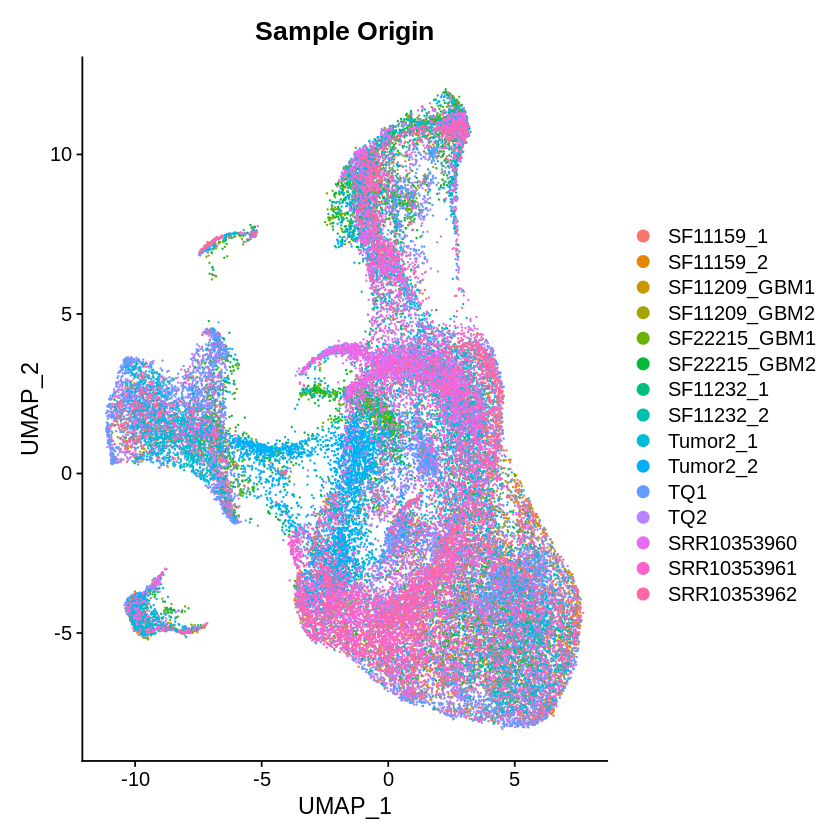

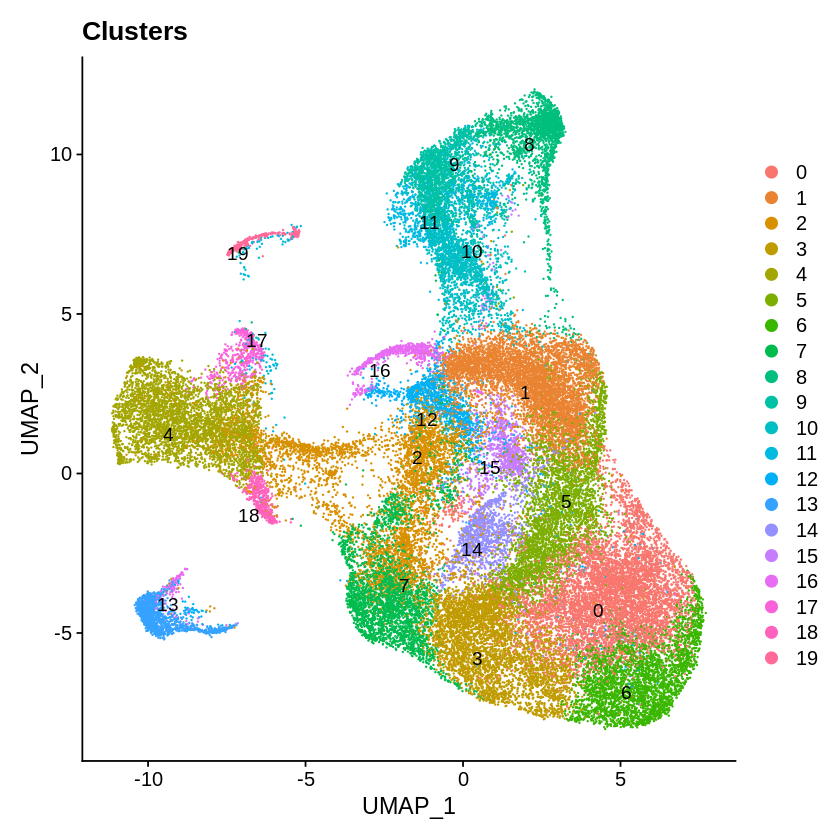

In [79]:
# Visualization of genes at resolution 0.6
# p1 <- DimPlot(ge_gbm.sc.int.umap0.6, reduction = "umap", group.by = "sample") + ggtitle("Sample Origin")
# p2 <- DimPlot(ge_gbm.sc.int.umap0.6, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Clusters")
# p1
# p2

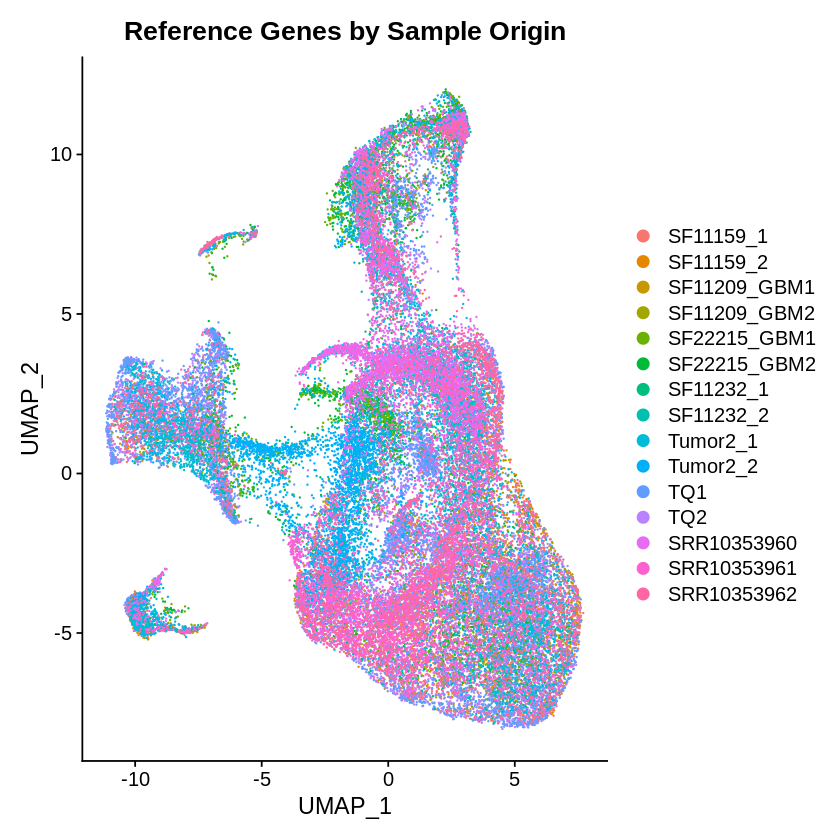

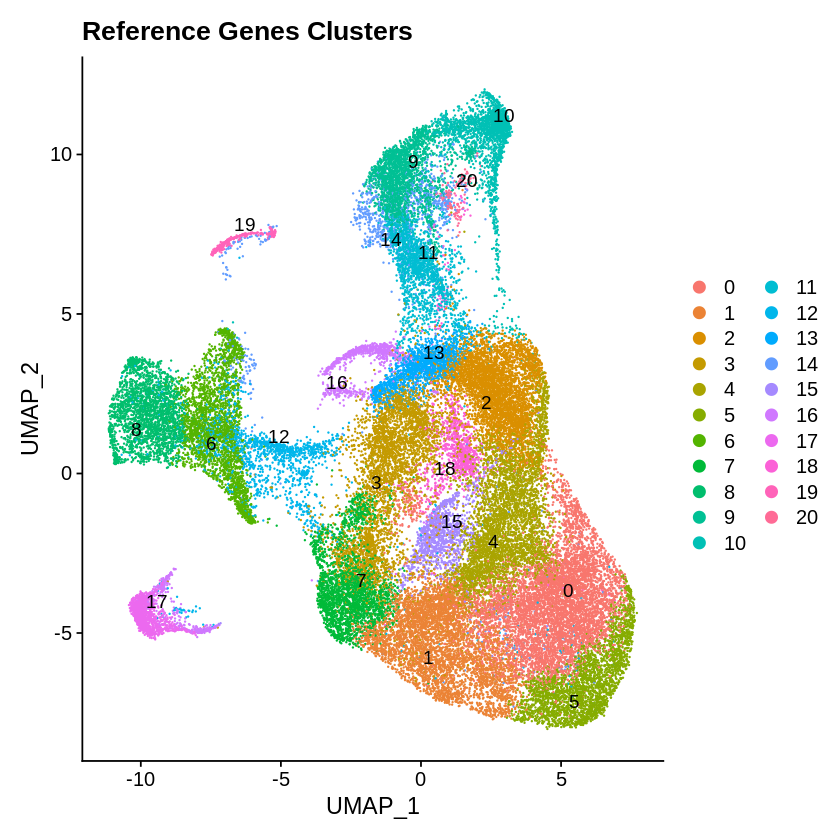

In [87]:
# Visualization of genes at resolution 0.7

ge_gbm.sc.int.umap0.7 <- FindClusters(ge_gbm.sc.int.umap, resolution = 0.7)

p1 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("Reference Genes by Sample Origin")
p2 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Reference Genes Clusters")
p1
p2

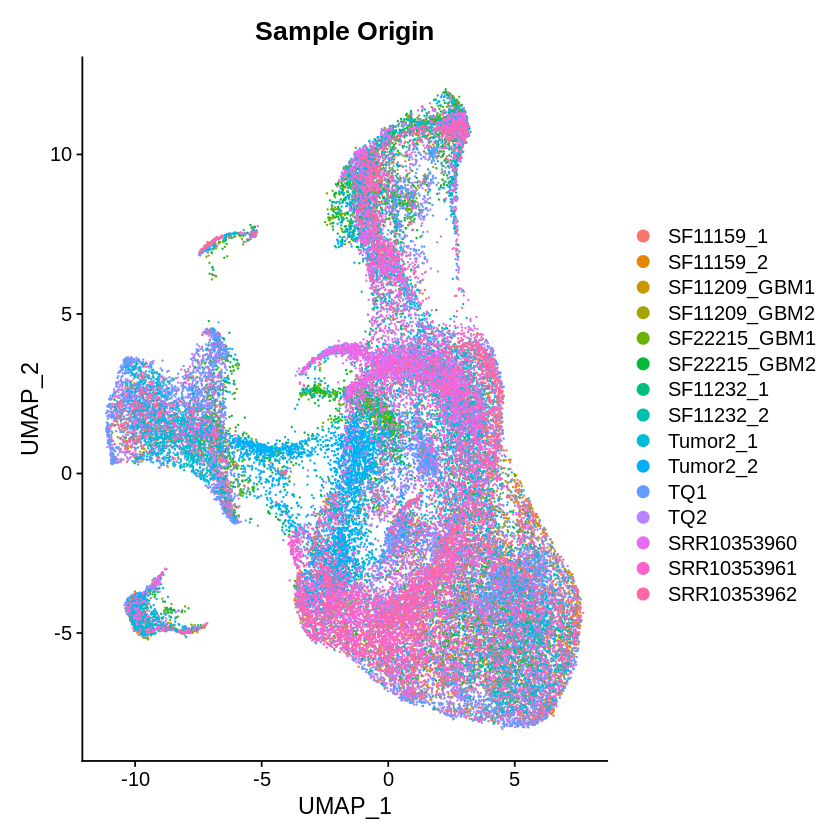

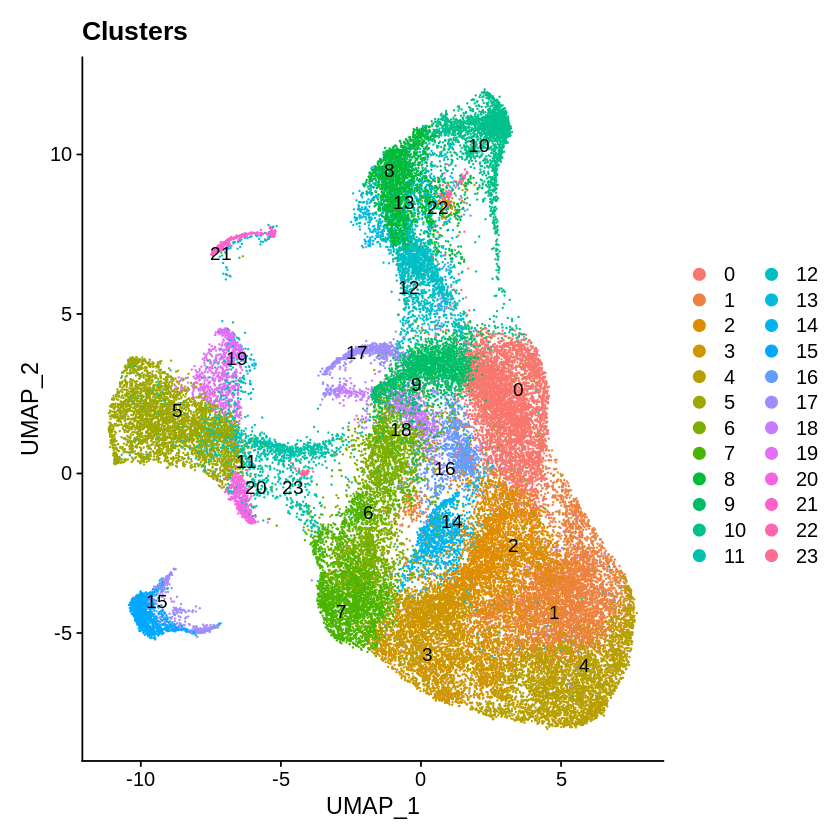

In [80]:
# Visualization of genes at resolution 0.8
# p1 <- DimPlot(ge_gbm.sc.int.umap0.8, reduction = "umap", group.by = "sample") + ggtitle("Sample Origin")
# p2 <- DimPlot(ge_gbm.sc.int.umap0.8, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Clusters")
# p1
# p2

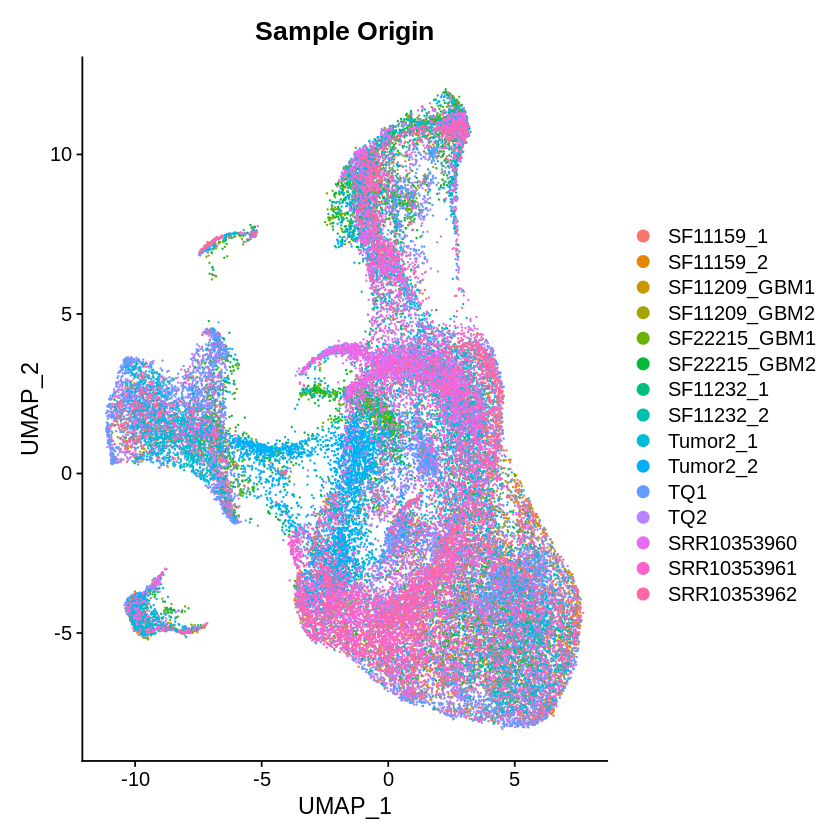

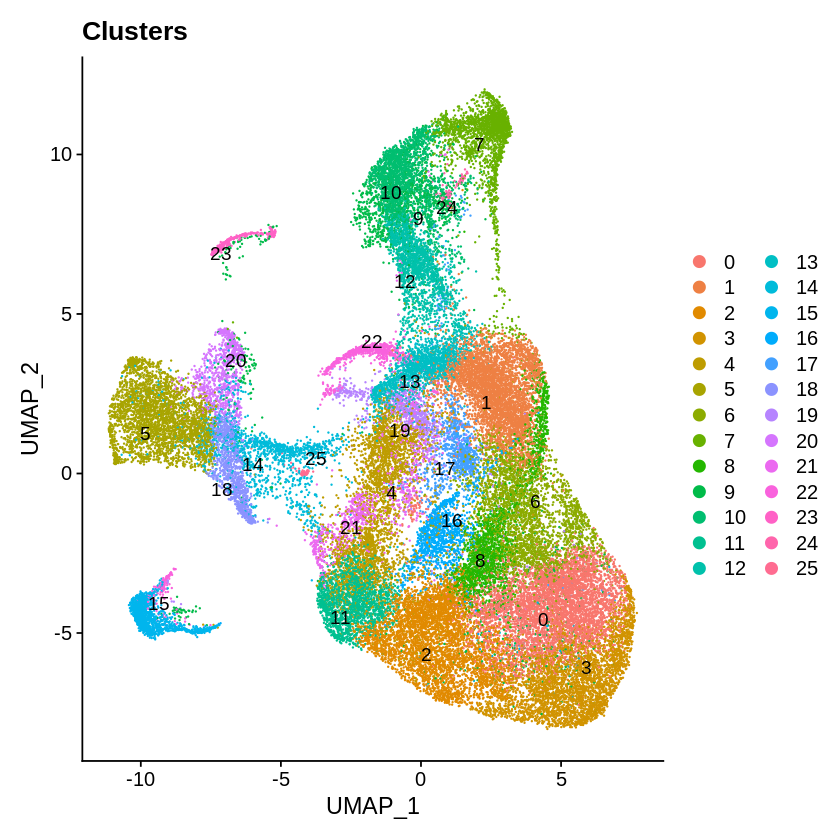

In [81]:
# Visualization of genes at resolution 1.0
# p1 <- DimPlot(ge_gbm.sc.int.umap1.0, reduction = "umap", group.by = "sample") + ggtitle("Sample Origin")
# p2 <- DimPlot(ge_gbm.sc.int.umap1.0, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Clusters")
# p1
# p2

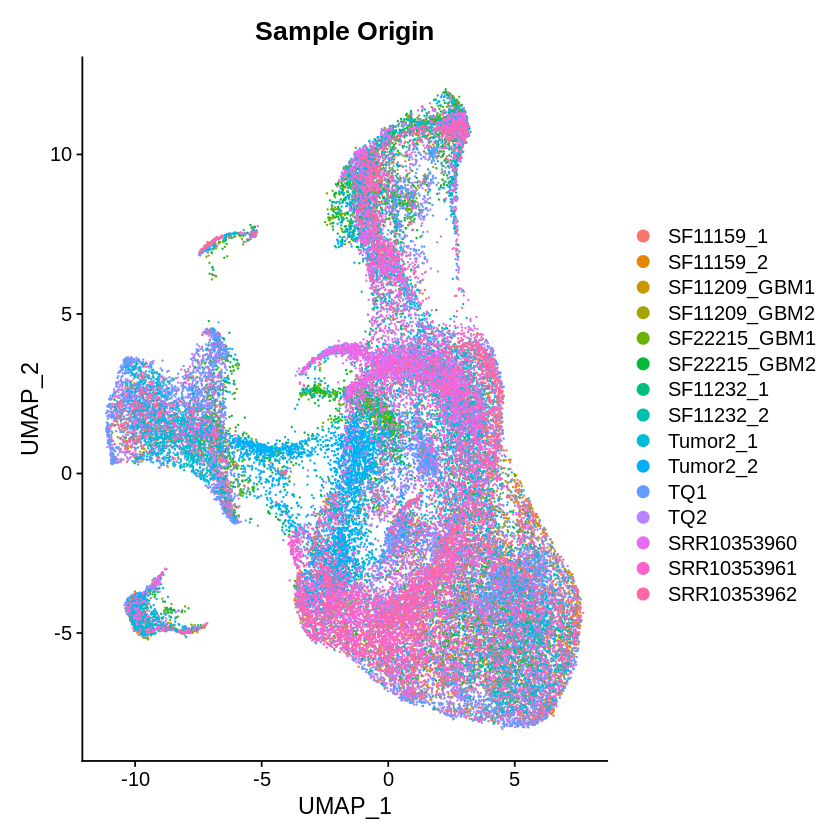

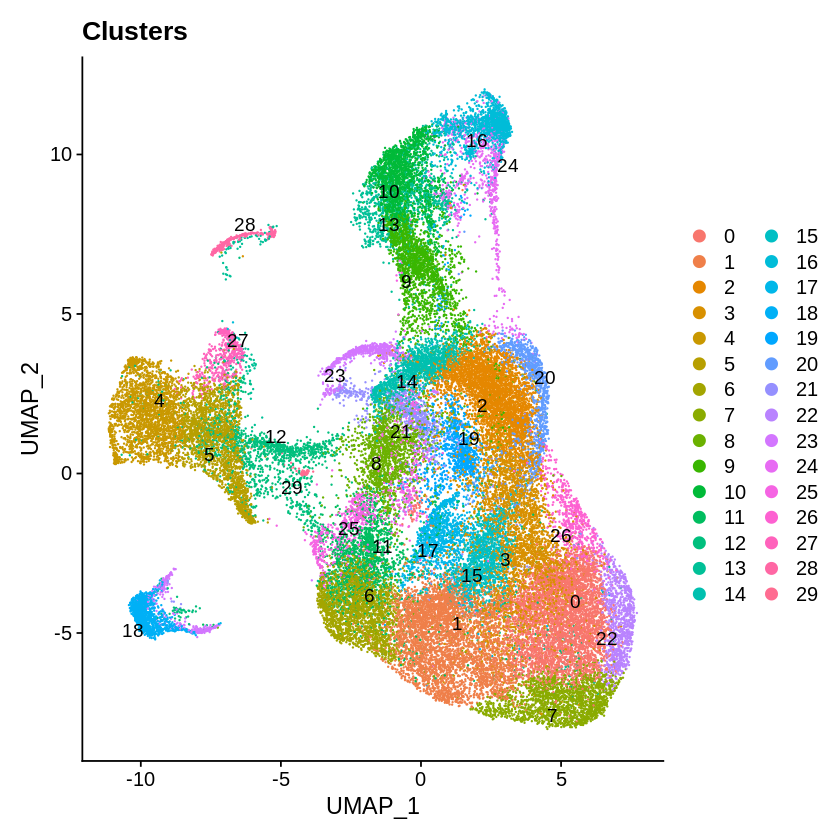

In [82]:
# Visualization of genes at resolution 1.2
# p1 <- DimPlot(ge_gbm.sc.int.umap1.2, reduction = "umap", group.by = "sample") + ggtitle("Sample Origin")
# p2 <- DimPlot(ge_gbm.sc.int.umap1.2, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Clusters")
# p1
# p2

In [91]:
# Determine the K-nearest neighbor graph (with first 20 PCAs)
gte_gbm.sc.int.umap <- FindNeighbors(gte_gbm.sc.int.umap,dims=1:20,reduction="pca")

# Determine the clusters with default resolution (0.7)
gte_gbm.sc.int.umap0.7 <- FindClusters(gte_gbm.sc.int.umap, resolution = 0.7)


# You can view different resolutions using:
# Idents(object = filt_gte_brain.intergrated) <- "integrated_snn_res.0.7"

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1775982

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8883
Number of communities: 20
Elapsed time: 19 seconds


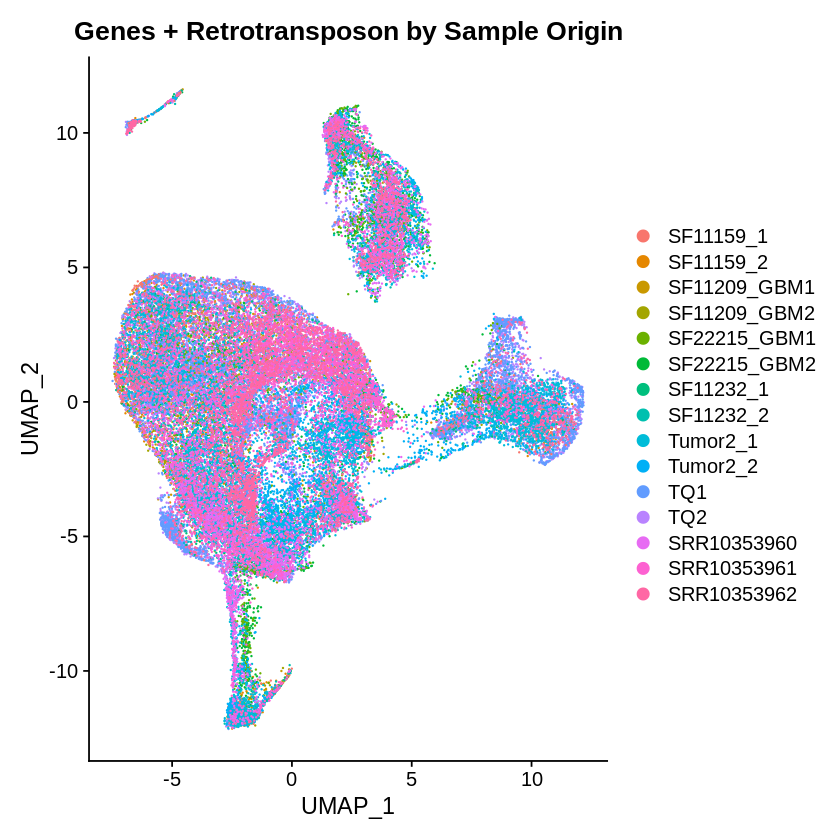

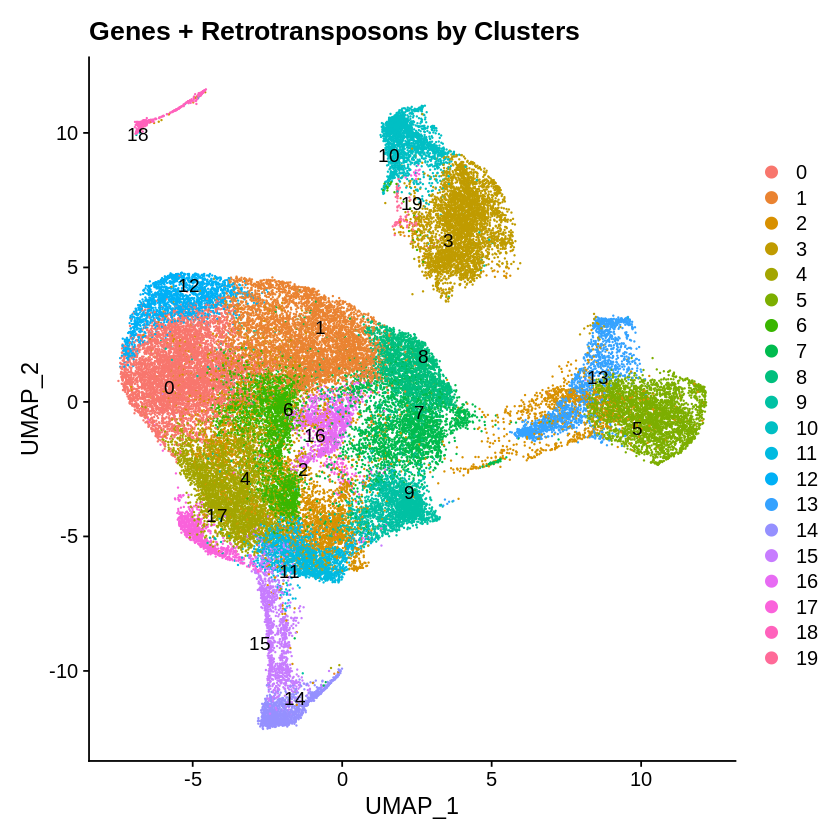

In [92]:
# Visualization of genes at resolution 0.7
p3 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("Genes + Retrotransposon by Sample Origin")
p4 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Genes + Retrotransposons by Clusters")
p3
p4

In [94]:
mkdirToday()

# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_umap0.7.pdf", width = size*2, height = size*2)
grid.arrange(p1, p2, p3, p4, nrow = 2, top="UMAP\nresolution:0.7")
dev.off()

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-06-17"


png 
  2

In [96]:
save(ge_gbm.sc.int.umap0.7,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7.RData")
save(gte_gbm.sc.int.umap0.7,file="/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7.RData")

2021-06-21:
Saving figures for PCA quality control

In [8]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/ge_gbm.sc.int.pca.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-15/gte_gbm.sc.int.pca.RData")

In [42]:
# Visualize top genes associated\nwith Principal components
p1 <- VizDimLoadings(ge_gbm.sc.int.pca, dims = 1:20, reduction = "pca")
p2 <- VizDimLoadings(gte_gbm.sc.int.pca, dims = 1:20, reduction = "pca")

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-15/r_GBMSC_GE_PCA20_vizdimloadings.pdf", width = size*4, height = size*4)
p1
dev.off()

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-15/r_GBMSC_GTE_PCA20_vizdimloadings.pdf", width = size*4, height = size*4)
p2
dev.off()

png 
  2

png 
  2

In [43]:
# Save Heatmaps for all PCs for 1000 cells with the top most variable genes.
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-15/r_GBMSC_GE_PCA20_heatmaps.pdf", width = size*5, height = size*5)
DimHeatmap(ge_gbm.sc.int.pca, dims = 1:20, cells = 1000, balanced = TRUE)
dev.off()

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-15/r_GBMSC_GTE_PCA20_heatmaps.pdf", width = size*5, height = size*5)
DimHeatmap(gte_gbm.sc.int.pca, dims = 1:20, cells = 1000, balanced = TRUE)
dev.off()

png 
  2

png 
  2

In [44]:
# Which PCAs should we include in our analyses? (Elbow Plot)
p1 <- ElbowPlot(object = ge_gbm.sc.int.pca, ndims = 20)
p2 <- ElbowPlot(object = gte_gbm.sc.int.pca, ndims = 20)
p3 <- JackStrawPlot(ge_gbm.sc.int.pca, dims = 1:20, xmax = 1.0,ymax = 1.0)
p4 <- JackStrawPlot(gte_gbm.sc.int.pca, dims = 1:20, xmax = 1.0,ymax = 1.0)

# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-15/r_GBMSC_elbow-jackstraw.pdf", width = size*2, height = size*2)
grid.arrange(p1, p3, p2, p4, nrow = 2, top="Determine the number of PCs to use in downstream analysis")
dev.off()

png 
  2

PDF creation of PC components complete

--> 2021-07-08: Correction of Sample names

In [82]:
case_n <- c("SF11159", "SF11209", "SF11215", "SF11232", "SF11247", "SF11285")
lvl <- c(sort(c(outer(case_n, c("_1", "_2"),FUN=paste,sep=""))), 
         as.character(unique(ge_gbm.sc.int.umap0.7@meta.data[which(grepl("SC", `ge_gbm.sc.int.umap0.7`$`neuro.ident`, fixed=FALSE)),"sample"])))

In [83]:
### Repair the sample names
ge_gbm.sc.int.umap0.7$sample <- as.character(ge_gbm.sc.int.umap0.7$sample)
GBM_meta <- ge_gbm.sc.int.umap0.7@meta.data[which(grepl("GBM", `ge_gbm.sc.int.umap0.7`$`neuro.ident`, fixed=FALSE)),]

GBM_meta$sample[which(GBM_meta$orig.ident == '1')] <- paste0(case_n[1],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '2')] <- paste0(case_n[2],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '3')] <- paste0(case_n[2],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '4')] <- paste0(case_n[5],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '5')] <- paste0(case_n[3],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '6')] <- paste0(case_n[4],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '7')] <- paste0(case_n[5],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '8')] <- paste0(case_n[3],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '9')] <- paste0(case_n[1],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '10')] <- paste0(case_n[6],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '11')] <- paste0(case_n[4],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '12')] <- paste0(case_n[6],"_1")

head(GBM_meta$sample[which(GBM_meta$orig.ident == '1')])
head(GBM_meta$sample[which(GBM_meta$orig.ident == '12')])
ge_gbm.sc.int.umap0.7@meta.data[which(grepl("GBM", `ge_gbm.sc.int.umap0.7`$`neuro.ident`, fixed=FALSE)),]$sample <- GBM_meta$sample
ge_gbm.sc.int.umap0.7$sample <- factor(ge_gbm.sc.int.umap0.7$sample, levels=lvl)

[1] "SF11159_2" "SF11159_2" "SF11159_2" "SF11159_2" "SF11159_2" "SF11159_2"

[1] "SF11285_1" "SF11285_1" "SF11285_1" "SF11285_1" "SF11285_1" "SF11285_1"

In [84]:
### Repair the sample names for Gete object
gte_gbm.sc.int.umap0.7$sample <- as.character(gte_gbm.sc.int.umap0.7$sample)
GBM_meta <- gte_gbm.sc.int.umap0.7@meta.data[which(grepl("GBM", `gte_gbm.sc.int.umap0.7`$`neuro.ident`, fixed=FALSE)),]

GBM_meta$sample[which(GBM_meta$orig.ident == '1')] <- paste0(case_n[4],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '2')] <- paste0(case_n[3],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '3')] <- paste0(case_n[1],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '4')] <- paste0(case_n[6],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '5')] <- paste0(case_n[4],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '6')] <- paste0(case_n[2],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '7')] <- paste0(case_n[2],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '8')] <- paste0(case_n[1],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '9')] <- paste0(case_n[3],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '10')] <- paste0(case_n[5],"_1")
GBM_meta$sample[which(GBM_meta$orig.ident == '11')] <- paste0(case_n[5],"_2")
GBM_meta$sample[which(GBM_meta$orig.ident == '12')] <- paste0(case_n[6],"_2")

head(GBM_meta$sample[which(GBM_meta$orig.ident == '1')])
head(GBM_meta$sample[which(GBM_meta$orig.ident == '12')])
gte_gbm.sc.int.umap0.7@meta.data[which(grepl("GBM", `gte_gbm.sc.int.umap0.7`$`neuro.ident`, fixed=FALSE)),]$sample <- GBM_meta$sample
gte_gbm.sc.int.umap0.7$sample <- factor(gte_gbm.sc.int.umap0.7$sample, levels=lvl)

[1] "SF11232_1" "SF11232_1" "SF11232_1" "SF11232_1" "SF11232_1" "SF11232_1"

[1] "SF11285_2" "SF11285_2" "SF11285_2" "SF11285_2" "SF11285_2" "SF11285_2"

In [86]:
save(ge_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7_update.RData")
save(gte_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7_update.RData")

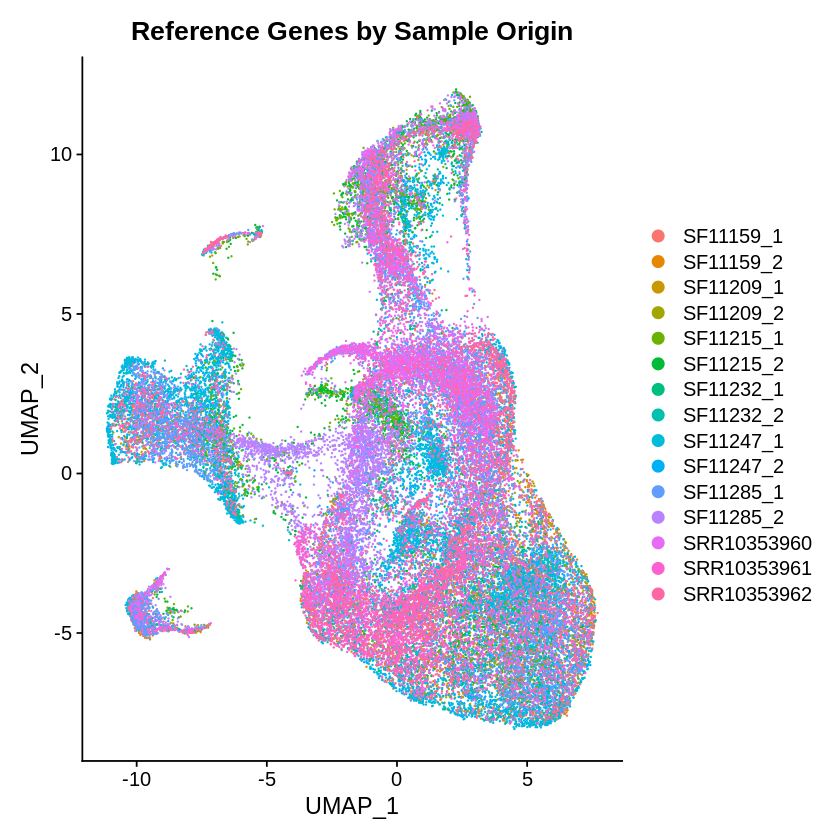

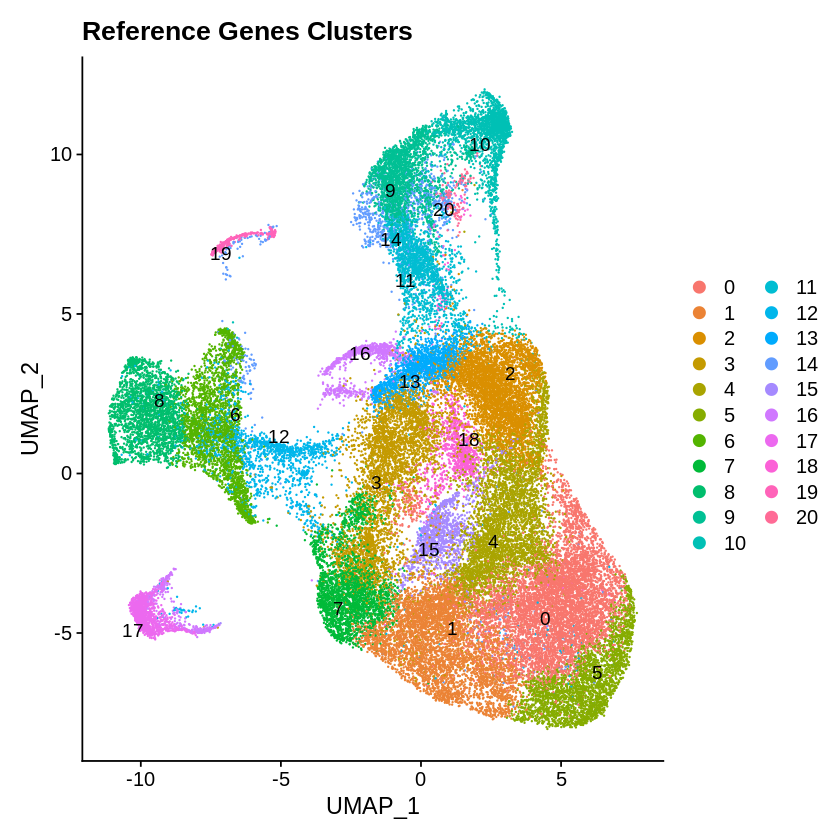

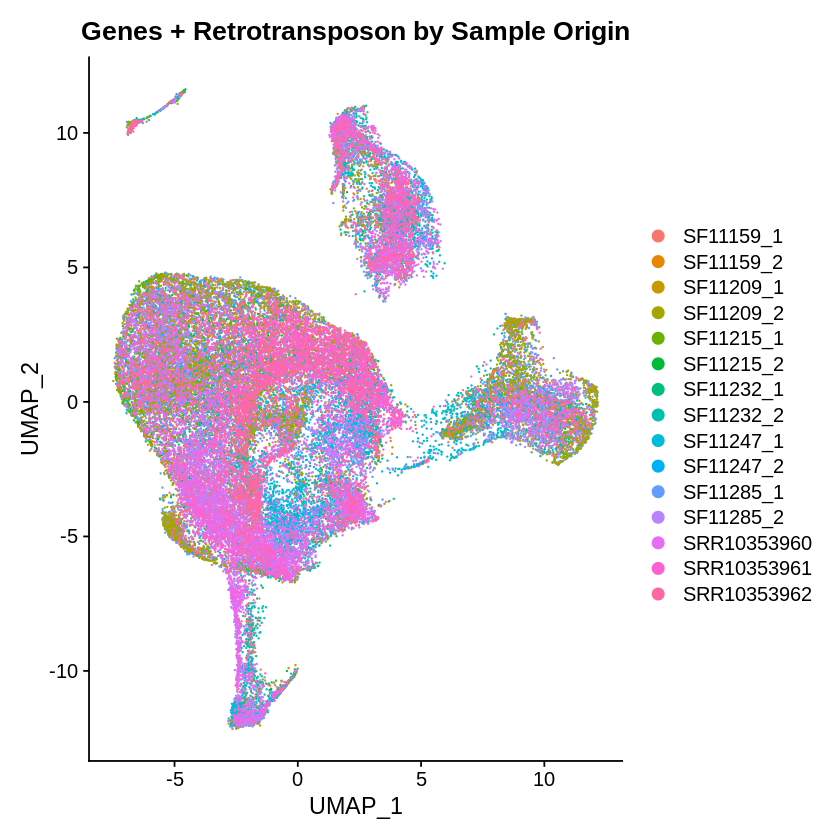

png 
  2

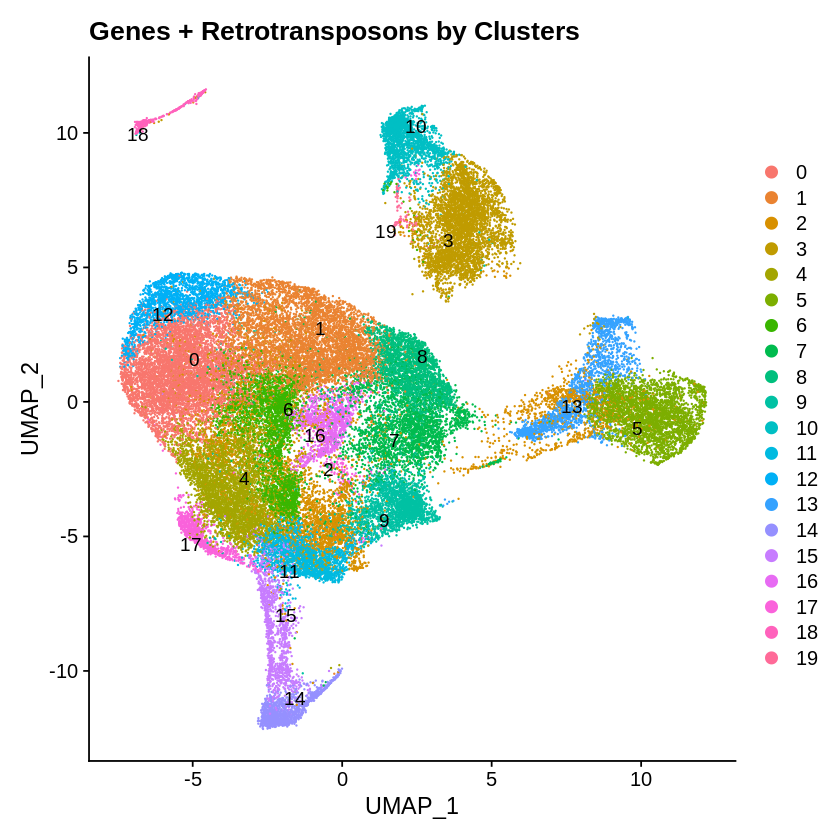

In [85]:
p1 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("Reference Genes by Sample Origin")
p2 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Reference Genes Clusters")
p1
p2

# Visualization of genes at resolution 0.7
p3 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("Genes + Retrotransposon by Sample Origin")
p4 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Genes + Retrotransposons by Clusters")
p3
p4

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-06-17/r_GBMSC_umap0.7_update.pdf", width = size*2, height = size*2)
grid.arrange(p1, p2, p3, p4, nrow = 2, top="UMAP\nresolution:0.7")
dev.off()

## Exploring Known Cell-type Markers
2021-06-21:

In [17]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7.RData")

CD133 (PROM1) marker for neuroblastoma (stem cells)

In [47]:
match(c('PROM1'), rownames(ge_gbm.sc.int.umap0.7))
match(c('PROM1'), rownames(gte_gbm.sc.int.umap0.7))

match(c('PROM1'), rownames(ge_gbm.sc.int.umap0.7@assays$RNA))
match(c('PROM1'), rownames(gte_gbm.sc.int.umap0.7@assays$RNA))

[1] NA

[1] NA

[1] 7036

[1] 6993

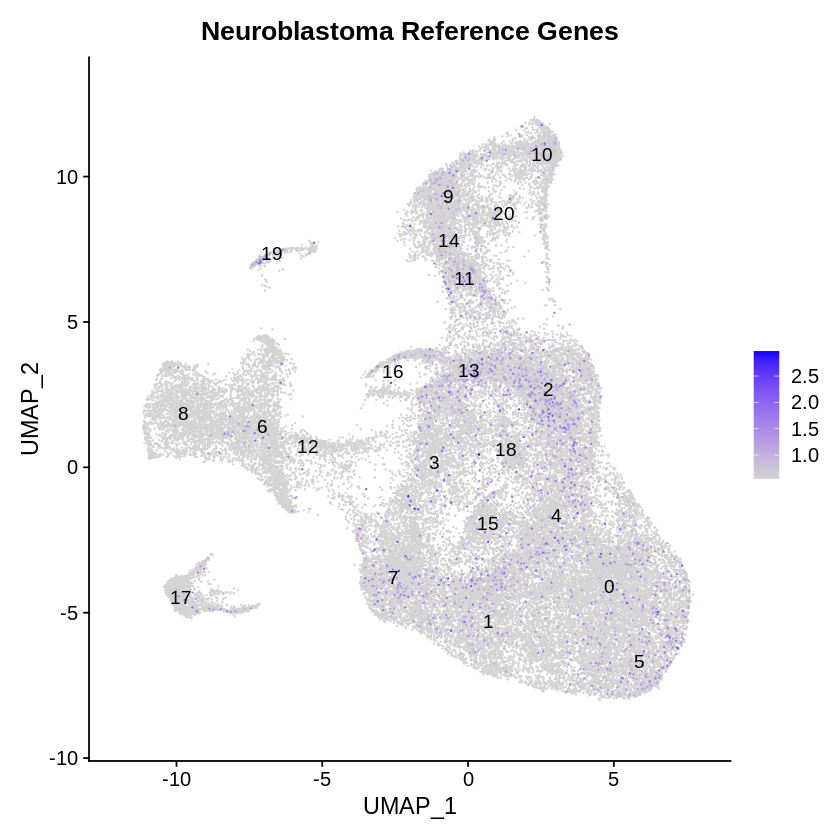

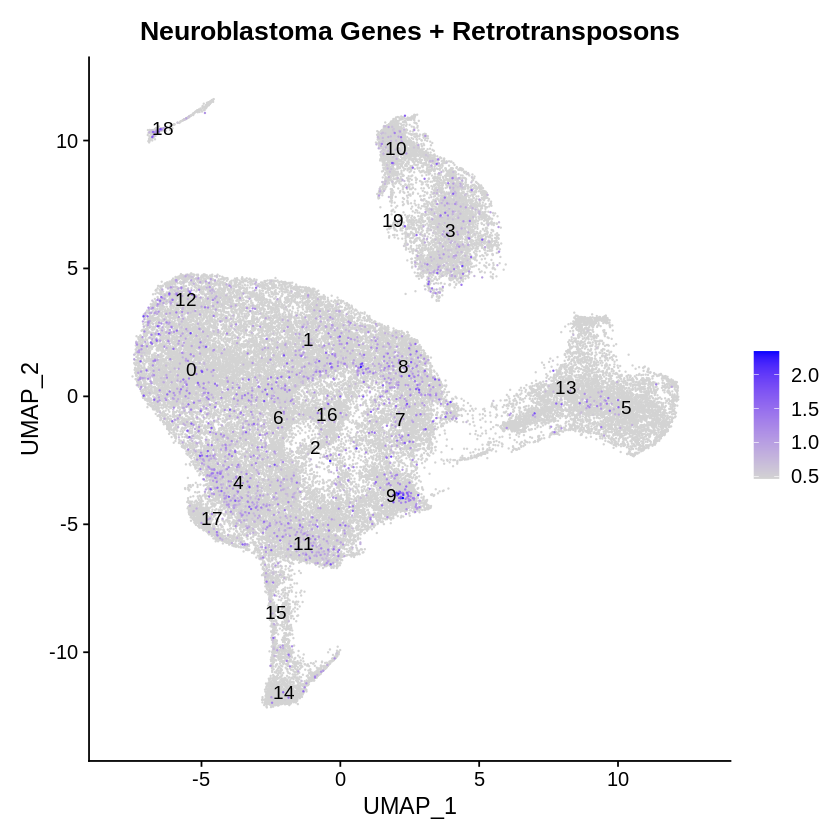

In [71]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

p1 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("Neuroblastoma Reference Genes")
p2 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("Neuroblastoma Genes + Retrotransposons")
p1
p2

In [53]:
# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_CD133-PROM1.pdf", width = size*2, height = size)
grid.arrange(p1, p2, nrow = 1, top="Cancer Stem Cell Marker CD133")
dev.off()

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-06-21"


png 
  2

Seems like these cells cluster less together and are rather integrated well into the dataset (as intended with the dataset integration step).

In [63]:
### Create sample type idents
set <- sapply(X = strsplit(colnames(ge_gbm.sc.int.umap0.7), split = "_"), FUN = "[", 1)

ge_gbm.sc.int.umap0.7@meta.data$sample.type <- NA
gte_gbm.sc.int.umap0.7@meta.data$sample.type <- NA

ge_gbm.sc.int.umap0.7@meta.data$sample.type <- set
gte_gbm.sc.int.umap0.7@meta.data$sample.type <- set

In [64]:
head(ge_gbm.sc.int.umap0.7@meta.data)
tail(ge_gbm.sc.int.umap0.7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,sample.type
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7,GBM1,0,0,1,1,GBM
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3,GBM1,0,0,8,8,GBM
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0,GBM1,0,0,0,0,GBM
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0,GBM1,0,0,0,0,GBM
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0,GBM1,0,0,0,0,GBM
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14,GBM1,0,0,0,0,GBM


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,sample.type
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>
SC_TTTGTCAAGTGAATTG-3,3,12041,3408,0.8656681,0.04883315,TTTGTCAAGTGAATTG-3,SRR10353962,12041,3408,NA,NA,SC3,0,0,4,4,SC
SC_TTTGTCACAGGGATTG-3,3,4256,1552,0.8792754,0.09656955,TTTGTCACAGGGATTG-3,SRR10353962,4256,1552,NA,NA,SC3,0,0,0,0,SC
SC_TTTGTCAGTTACGTCA-3,3,3337,1331,0.8867051,0.04195385,TTTGTCAGTTACGTCA-3,SRR10353962,3337,1331,NA,NA,SC3,0,0,8,8,SC
SC_TTTGTCAGTTCCACTC-3,3,12747,3597,0.8661601,0.02196595,TTTGTCAGTTCCACTC-3,SRR10353962,12747,3597,NA,NA,SC3,0,0,1,1,SC
SC_TTTGTCAGTTCCGGCA-3,3,14313,4089,0.8690691,0.02640956,TTTGTCAGTTCCGGCA-3,SRR10353962,14313,4089,NA,NA,SC3,0,0,9,9,SC
SC_TTTGTCAGTTGCGCAC-3,3,10817,3312,0.8725823,0.02338911,TTTGTCAGTTGCGCAC-3,SRR10353962,10817,3312,NA,NA,SC3,0,0,18,18,SC


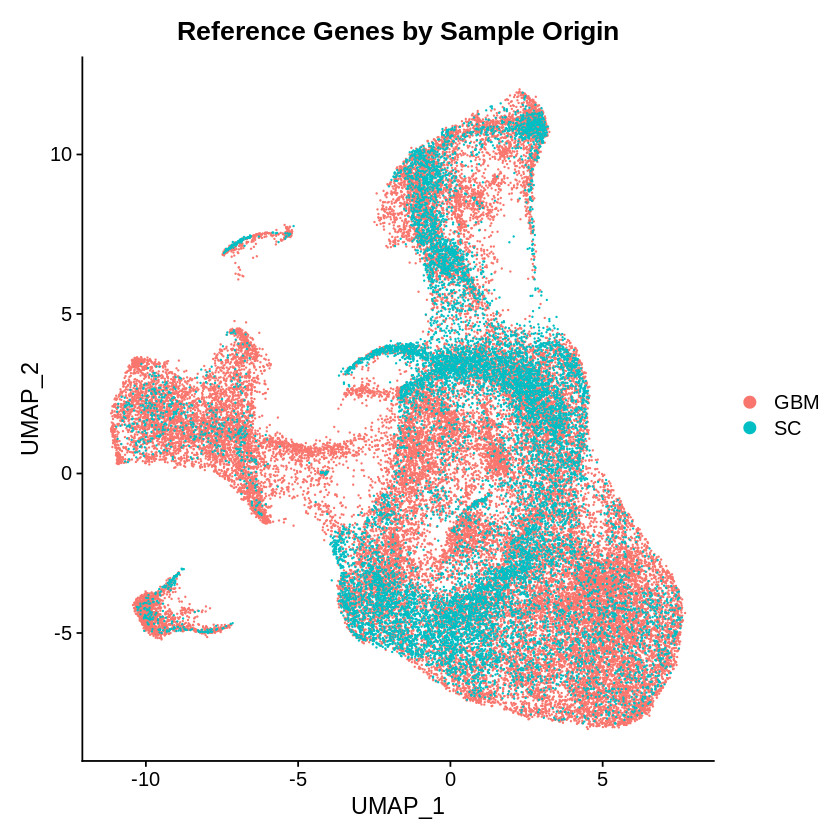

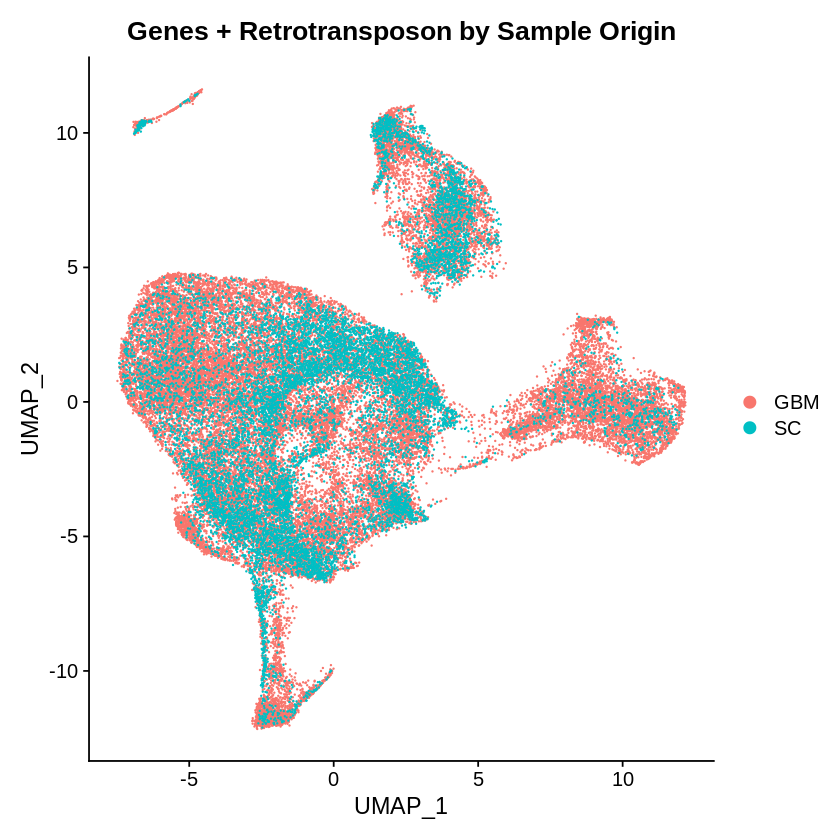

In [72]:
# Visualization of genes at resolution 0.7
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "integrated"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "integrated"

p3 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample.type") + ggtitle("Reference Genes by Sample Origin")
p4 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample.type") + ggtitle("Genes + Retrotransposon by Sample Origin")
p3
p4

In [74]:
# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_CD133-PROM1.pdf", width = size*2, height = size*2)
grid.arrange(p1, p2, p3, p4, nrow = 2, top="Cancer Stem Cell Marker CD133")
dev.off()

png 
  2

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      5                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      2                      4 
Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,sample.type
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11159_2,16712,4840,3,3,GBM1,0,0,1,1,GBM
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11159_2,5963,1850,4,4,GBM1,0,0,5,5,GBM
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11159_2,7866,2355,0,0,GBM1,0,0,0,0,GBM
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11159_2,14361,3262,0,0,GBM1,0,0,0,0,GBM
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11159_2,2803,1201,0,0,GBM1,0,0,2,2,GBM
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11159_2,6865,2756,8,8,GBM1,0,0,4,4,GBM


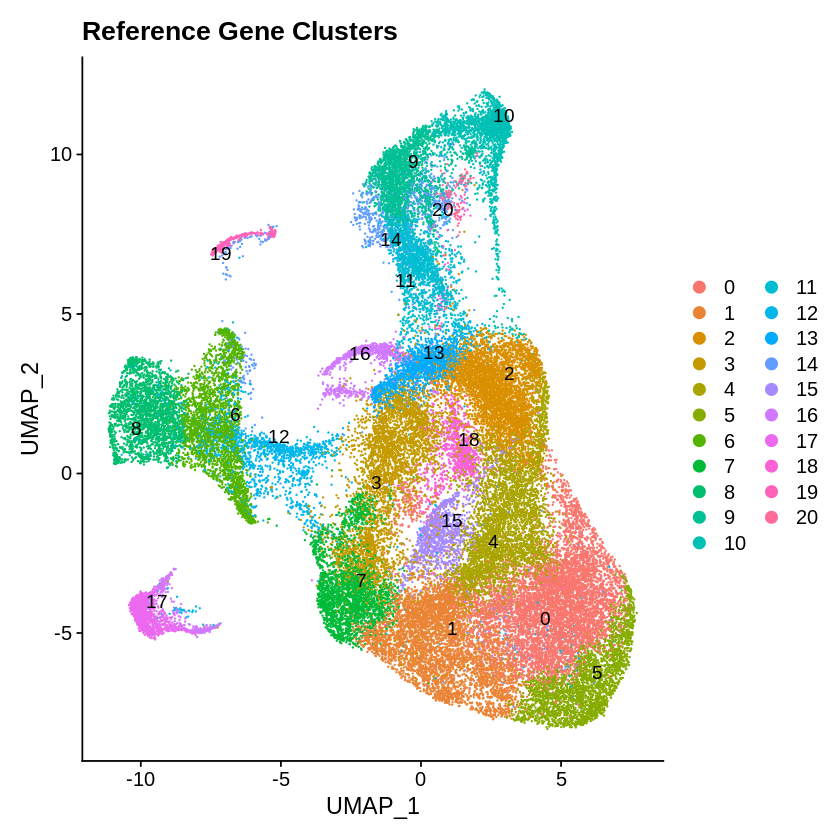

png 
  2

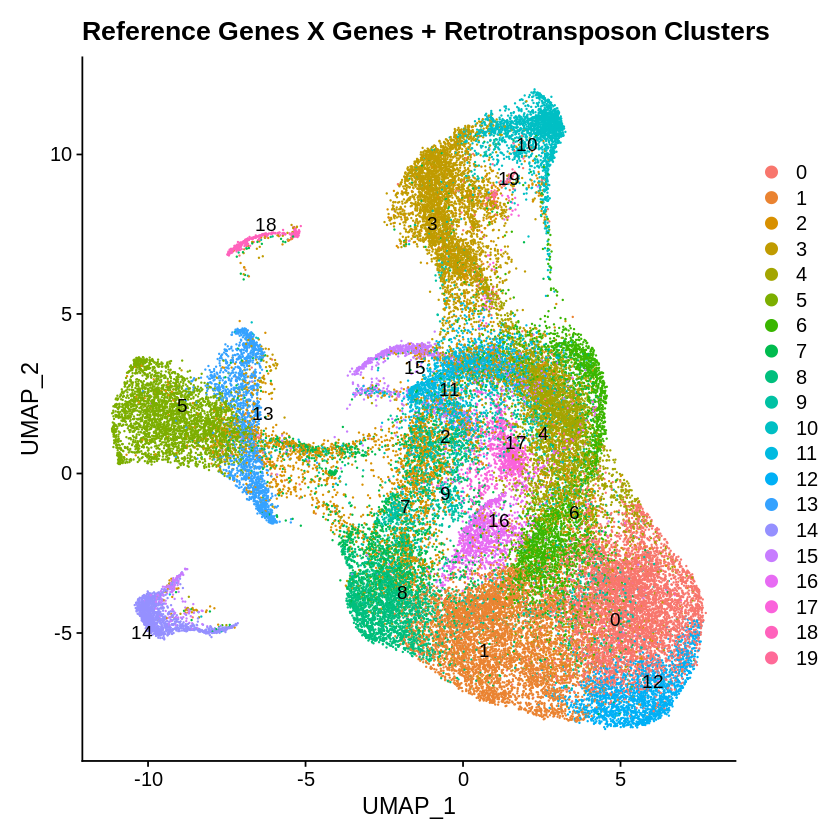

In [80]:
### Plot cluster labels of Genes + Retrotansposons onto Reference Gens UMAP

# Current active idents are the seurat clusters
head(gte_gbm.sc.int.umap0.7@active.ident)
head(gte_gbm.sc.int.umap0.7@meta.data) 

# make a copy of the and change the idents to those of the Genes + Retrotransposon dataset
ge_gbm.sc.int.umap0.7_v2 <- ge_gbm.sc.int.umap0.7 
ge_gbm.sc.int.umap0.7_v2@active.ident <- gte_gbm.sc.int.umap0.7@active.ident

# Create figures
p1 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + 
    ggtitle("Reference Gene Clusters")
p2 <- DimPlot(ge_gbm.sc.int.umap0.7_v2, reduction="umap", label=TRUE, repel = TRUE) + 
    ggtitle("Reference Genes X Genes + Retrotransposon Clusters")
p1
p2

#Save figure to PDF
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_UMAP_MatchingClusters.pdf", width = size*3, height = size)
grid.arrange(p1, p2, nrow = 1, top="Matching Clusters Labels\nresolution:0.7")
dev.off()

GBM Subtype Markers

|     Subtype | Cellular Markers |   
|-------------|------------------|
|   Classical |    EGFR, GFAP    |
| Mesenchymal |   TGFB1. RELB    |
|   Proneural |   ASCL1, OLIG2   |

In [82]:
match(c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', 'TGFB1', 'RELB'), rownames(ge_gbm.sc.int.umap0.7))
match(c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', 'TGFB1', 'RELB'), rownames(gte_gbm.sc.int.umap0.7))

[1]  881 1295  936   70   NA   NA

[1]  885 1336  916   52   NA   NA

In [84]:
DefaultAssay(`ge_gbm.sc.int.umap0.7`) <- "RNA"
DefaultAssay(`gte_gbm.sc.int.umap0.7`) <- "RNA"

In [85]:
match(c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', 'TGFB1', 'RELB'), rownames(ge_gbm.sc.int.umap0.7))
match(c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', 'TGFB1', 'RELB'), rownames(gte_gbm.sc.int.umap0.7))

[1] 19267 29230 11757 24971 27530 27654

[1] 19121 29009 11669 24776 27319 27442

Warning message:
"Could not find TGFB1 in the default search locations, found in RNA assay instead"
Warning message:
"Could not find RELB in the default search locations, found in RNA assay instead"
Warning message:
"Could not find TGFB1 in the default search locations, found in RNA assay instead"
Warning message:
"Could not find RELB in the default search locations, found in RNA assay instead"


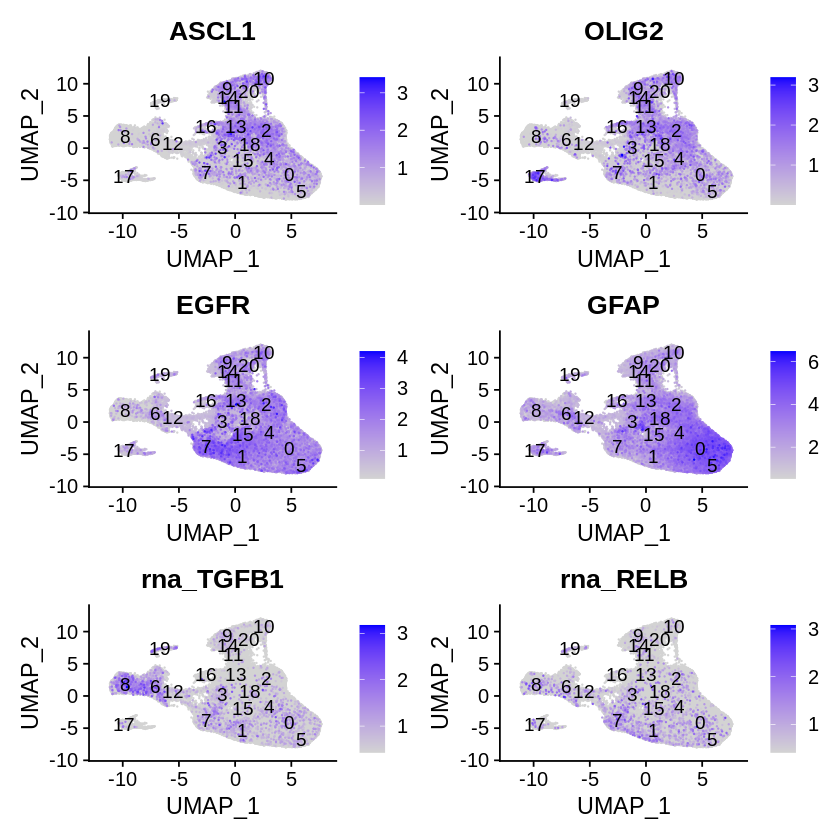

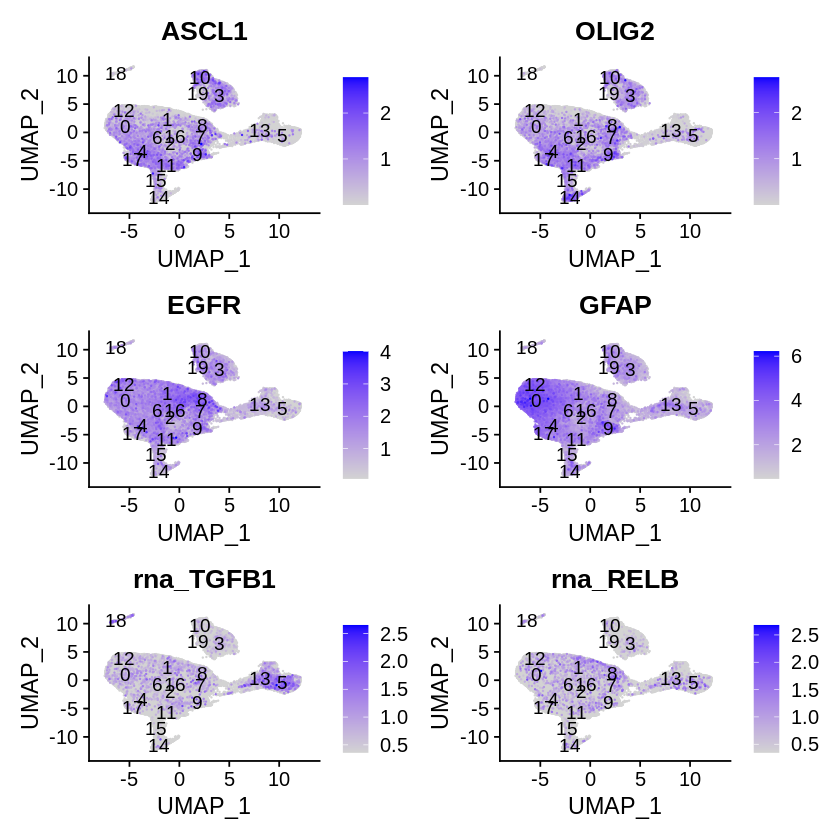

In [18]:
p1 <- FeaturePlot(`ge_gbm.sc.int.umap0.7`, 
            reduction = "umap", 
            features = c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', "TGFB1","RELB"), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', 
            label = TRUE)
p2 <- FeaturePlot(`gte_gbm.sc.int.umap0.7`, 
            reduction = "umap", 
            features = c('ASCL1', 'OLIG2', 'EGFR', 'GFAP', "TGFB1","RELB"), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', 
            label = TRUE)
p1
p2

In [102]:
# Save UMAP for genes
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_GBMsubtypeMarkers.pdf", width = size*2, height = size*3)
p1
p2
dev.off()

png 
  2

Cell Cycle Markers

| Cell Cycle Phase | Markers      |
|------------------|--------------|
| S-Phase          | TOP2A, MKI67 |
| G1 Phase         | PCNA MCM6    |

In [94]:
DefaultAssay(`ge_gbm.sc.int.umap0.7`) <- "integrated"
DefaultAssay(`gte_gbm.sc.int.umap0.7`) <- "integrated"

match(c('TOP2A', 'MKI67', 'PCNA', 'MCM6'), rownames(`ge_gbm.sc.int.umap0.7`))
match(c('TOP2A', 'MKI67', 'PCNA', 'MCM6'), rownames(`gte_gbm.sc.int.umap0.7`))

[1]   18   65  869 1363

[1]   19   75  886 1270

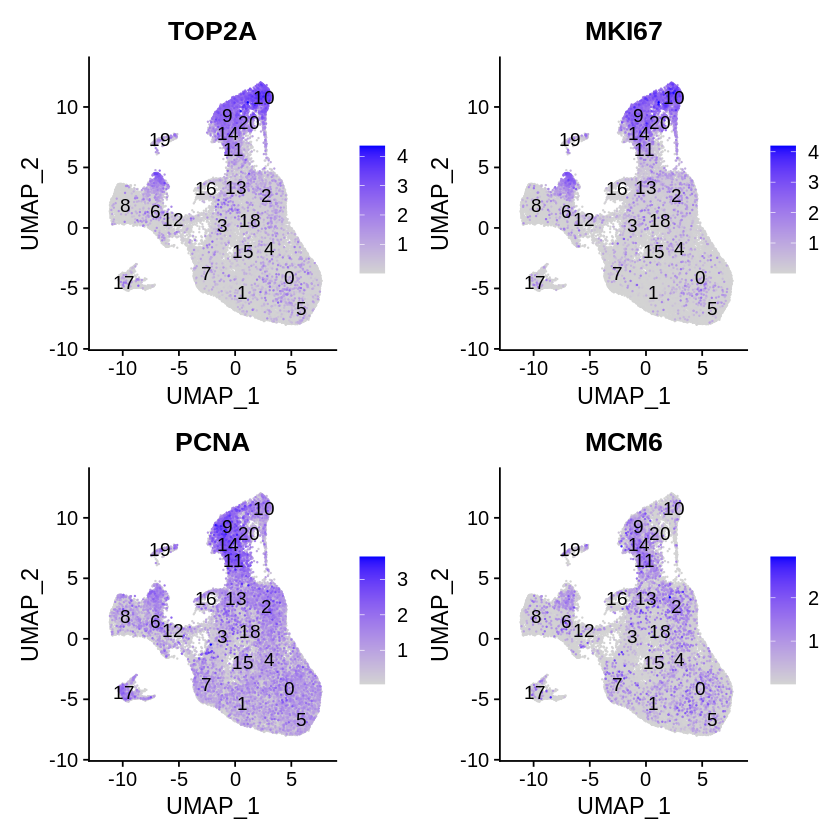

png 
  2

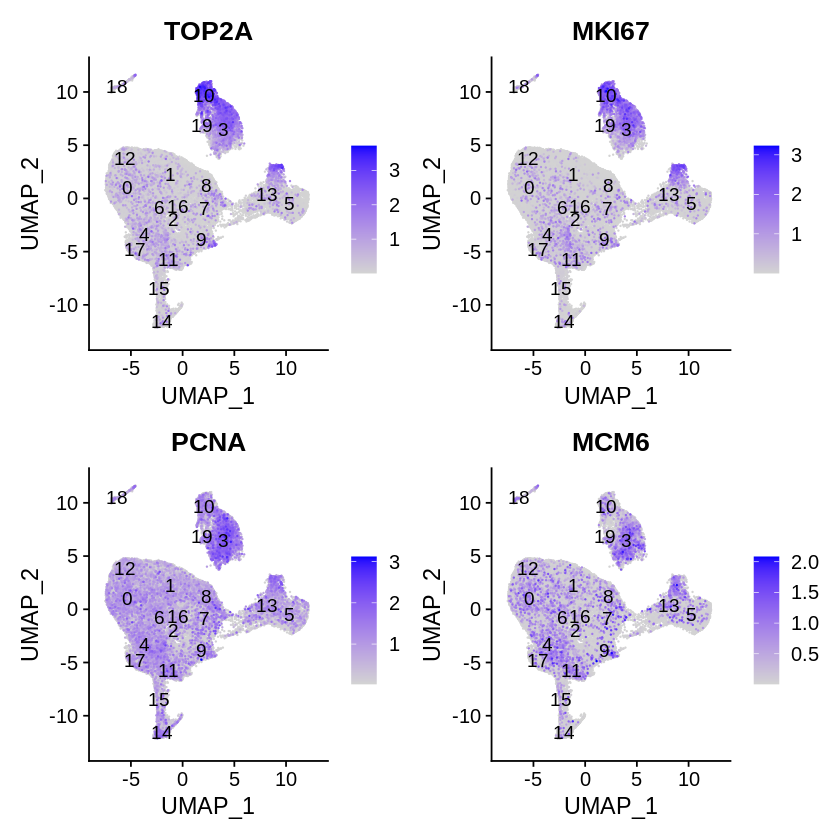

In [104]:
p1 <- FeaturePlot(`ge_gbm.sc.int.umap0.7`, 
            reduction = "umap", 
            features = c('TOP2A', 'MKI67', 'PCNA', 'MCM6'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', 
            label = TRUE)
p2 <- FeaturePlot(`gte_gbm.sc.int.umap0.7`, 
            reduction = "umap", 
            features = c('TOP2A', 'MKI67', 'PCNA', 'MCM6'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', 
            label = TRUE)
p1 
p2

# Save UMAP for genes
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-17/r_GBMSC_CCMarkers.pdf", width = size*2, height = size*2)
p1
p2
dev.off()

## Cluster Markers (Differential Gene Expression Analysis)

In [107]:
# IMPORTANT: make sure to run differential gene expression analysis on raw data
DefaultAssay(`ge_gbm.sc.int.umap0.7`) <- "RNA"
DefaultAssay(`gte_gbm.sc.int.umap0.7`) <- "RNA"

In [109]:
# Default FindAllMarkers() parameters were: 
# test.use = Wlcoxon Rank Sum test min.pct=0.1, min.diff.pct=-Inf, logfc.threshold=0.25
mkdirToday()

# This step takes around 1h20min for each command. 
ge_markers <- FindAllMarkers(`ge_gbm.sc.int.umap0.7`, only.pos = TRUE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)
save(ge_markers, file="/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.RData")

gte_markers <- FindAllMarkers(`gte_gbm.sc.int.umap0.7`, only.pos = TRUE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)
save(gte_markers, file="/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.RData")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Warning message in FindMarkers.default(object = data.use, slot = data.slot, counts = counts, :
"No features pass logfc.threshold threshold; returning empty data.frame"
Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19



Results of FindAllMarkers()
- p_val: p-value not adjusted for multiple test correction for condition
- avg_logFC: average log2 fold change for condition. Positive values indicate that the gene is more highly expressed in the cluster.
- pct.1: percentage of cells where the gene is detected in the cluster for condition
- pct.2: percentage of cells where the gene is detected on average in the other clusters for condition
- p_val_adj: adjusted p-value for condition, based on bonferroni correction using all genes in the dataset, used to determine significance

In [110]:
# Show table with the highest expressed gene from each cluster
ge_markers %>% group_by(cluster) %>% top_n(n = 2, wt = avg_log2FC)
gte_markers %>% group_by(cluster) %>% top_n(n = 2, wt = avg_log2FC)

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,2.352343,0.800,0.406,0.000000e+00,0,GFAP
0.000000e+00,2.222319,0.713,0.280,0.000000e+00,0,ID3
0.000000e+00,2.615079,0.527,0.102,0.000000e+00,1,IGFBP3
0.000000e+00,2.384714,0.903,0.381,0.000000e+00,1,IGFBP5
0.000000e+00,1.994628,0.792,0.219,0.000000e+00,2,OLIG1
0.000000e+00,1.752317,0.867,0.344,0.000000e+00,2,BCAN
0.000000e+00,3.363363,0.546,0.053,0.000000e+00,3,IGKC
0.000000e+00,2.971221,0.536,0.048,0.000000e+00,3,IGHM
0.000000e+00,1.302677,0.599,0.250,0.000000e+00,4,SRPX


p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,2.571716,0.888,0.402,0.000000e+00,0,GFAP
0.000000e+00,2.407882,0.806,0.275,0.000000e+00,0,ID3
0.000000e+00,2.272637,0.873,0.378,0.000000e+00,1,IGFBP5
0.000000e+00,2.204474,0.472,0.102,0.000000e+00,1,IGFBP3
0.000000e+00,1.504744,0.377,0.057,0.000000e+00,2,IGLC1
0.000000e+00,1.479475,0.405,0.122,0.000000e+00,2,CD37
0.000000e+00,3.011104,0.937,0.496,0.000000e+00,3,HIST1H4C
0.000000e+00,1.917073,0.854,0.121,0.000000e+00,3,PCLAF
0.000000e+00,1.618719,0.872,0.351,0.000000e+00,4,BCAN


In [111]:
csv_GE <- ge_markers %>% group_by(cluster) %>% top_n(n = 5, wt = avg_log2FC)
csv_GTE <- gte_markers %>% group_by(cluster) %>% top_n(n = 5, wt = avg_log2FC)  

In [112]:
# Export dataframe of top 5 genes per cluster for each dataframe
write.csv(csv_GE,"/home/samkyy/scratch/gete-gbm/results/2021-06-21/GBMSC_GE_clustermarkers.csv", row.names= TRUE)
write.csv(csv_GTE,"/home/samkyy/scratch/gete-gbm/results/2021-06-21/GBMSC_GTE_clustermarkers.csv", row.names= TRUE)

## GO
2021-06-22:

In [41]:
# load libraries
library(GOstats)
library(org.Hs.eg.db)

# BiocManager::install("biomaRt")
# library(biomaRt) # package containing Ensembl datasets of various organisms 

In [42]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.RData")

We filtering out low complexity cells (<100 genes) and genes with no counts (expressed in <1 cell)and filtered out the cells based on quality control metrics resulting in: 
- GBM samples: 31242 (ge) or 32169(gte) genes and 36558 cells
- Neuroblastoma samples: 26654 (ge) or 27711(gte) genes and 13112 cells
- Combined samples: resulting in 49670 cells

In differential gene analysis, features that are very infrequently detected in either group of cells, or features that are expressed at similar average levels, are unlikely to be differentially expressed. The following parameters were used to narrow down and speed up the computation:  
- `only.pos` = True, `min.pct` = 0.25, `min.diff.pct` = 0.25, `logfc.threshold` = 0.25

Resulting number of DEGs across 2 clusters:  genes

In [16]:
dim(ge_markers)
dim(gte_markers)
length(unique(rownames(ge_markers)))
length(unique(rownames(gte_markers)))

# Reference Genes: 4313 most variable genes
# Genes + Retrotransposons: 4015 most vari

[1] 4313    7

[1] 4015    7

[1] 4313

[1] 4015

In [43]:
### Store Gene Ontology Classes and Entrez ID conversion Database
class <- c("BP","MF","CC")
ann <- "org.Hs.eg.db"

ref2eg <- org.Hs.egSYMBOL2EG # Gene Symbols to Entrez IDs
mapped_seqs <- mappedkeys(ref2eg) # Gene Symbols

universe <- ls(org.Hs.egSYMBOL) # list of all objects names for the human SYMBOL submap

Create an list of clusters and gene symbols found in each cluster

In [51]:
geneontology <- function(cluster.markers){
    
    #### Extract clusters
    cluster_id <- unique(as.character(cluster.markers$cluster))
    print(cluster_id)
    if(length(cluster_id) == 0){
        print("no clusters")
        return()
        gene_id <- unique(as.character(cluster.markers$gene))
        if(length(gene_id) == 0){
            print("no genes")
            return()
    }
    } else { 
        #### Extract genes by cluster and convert to entrez_id's
        print("extracting gene symbols by cluster")
       
        
        id <- vector("list", length = length(cluster_id))
        entrez_id <- vector("list", length = length(cluster_id))
        nonunique_id <- vector("list", length = length(cluster_id))
        
        print(paste0("Length of cluster_id : ", length(cluster_id)))

        for(i in 1:length(cluster_id)){
            n = as.numeric(cluster_id[i])
            id[[i]] <- cluster.markers$gene[which(cluster.markers$cluster == n)] #clusters are labelled 0-21
            id[[i]] <- intersect(id[[i]], mapped_seqs)

            entrez_id[[i]] <- na.omit(unique(as.list(unlist( ref2eg[id[[i]]] ) )))
            nonunique_id[[i]] <- length(id[[i]]) - length(entrez_id[[i]])
            print(paste0("Number of non-unique genes in cluster", n, " = ", nonunique_id[[i]]))
        }
        print("converted gene symbols to entrez ids")
    }
    
    #### Create parameters for each cluster and each GO class ####
    para <- list(NULL)
    result <- vector("list", length = length(cluster_id)) # 22 lists + 4 nested lists (3 GO classes + 1 HyperGOresults object)

    for (i in 1:length(cluster_id)) {
        for (j in 1:length(class)) {
            print(class[j])
            n <- cluster_id[i]
            if (length(entrez_id[[i]]) > 0) {
                para <- new("GOHyperGParams",
                    geneIds=entrez_id[[i]],
                    universeGeneIds=universe, #is it better for this to be all genes from our annotations, or the genes expressed in our experiment only?
                    annotation=ann,
                    ontology=class[j],
                    pvalueCutoff=1, # no cutoff 
                    conditional=F, 
                    testDirection="over")
                #### Perform Hypergeometric tests ####
                rm(data)
                data <- hyperGTest(para)
                result[[i]][[4]][[j]] <- data # save the original file
                data <- summary(data)

                #### Multiple-Test Correction #### 
                if(nrow(data) == 0){
                    # no correction
                    result[[i]][[j]] <- NULL
                } else {
                    # Adjust p-value in the same column
                    data$p.adjusted <- p.adjust(data[,2], "BH") #"fdr"
                    data <- data[1:5,c(1:2, ncol(data), 3:(ncol(data)-1))] #re-arrange p.adjusted column next to pvalue column
                    result[[i]][[j]]<- data
                }
            } else {
                result[[i]][[j]] <- NULL
                print(paste0("No differentially expressed genes in cluster ",n,". no GO computed."))
            }
        }
        print(paste0("Cluster:", n, "gene ontology analysis complete."))
    }
    
    names(result) <- cluster_id
    return(result)

}

In [52]:
### Compute Gene Ontology for Reference Gene Dataset
ge_markers.GO <- geneontology(ge_markers)
saveRDS(ge_markers.GO, file="/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.GO.rds")

 [1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20"
[1] "extracting gene symbols by cluster"
[1] "Length of cluster_id : 21"
[1] "Number of non-unique genes in cluster0 = 0"
[1] "Number of non-unique genes in cluster1 = 0"
[1] "Number of non-unique genes in cluster2 = 0"
[1] "Number of non-unique genes in cluster3 = 0"
[1] "Number of non-unique genes in cluster4 = 0"
[1] "Number of non-unique genes in cluster5 = 0"
[1] "Number of non-unique genes in cluster6 = 0"
[1] "Number of non-unique genes in cluster7 = 0"
[1] "Number of non-unique genes in cluster8 = 0"
[1] "Number of non-unique genes in cluster9 = 0"
[1] "Number of non-unique genes in cluster10 = 0"
[1] "Number of non-unique genes in cluster11 = 0"
[1] "Number of non-unique genes in cluster12 = 0"
[1] "Number of non-unique genes in cluster13 = 0"
[1] "Number of non-unique genes in cluster14 = 0"
[1] "Number of non-unique genes in cluster15 = 0"
[1] "Number of non-uni

Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"
Warning message in rm(data):
"object 'data' not found"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:0gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:1gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:2gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:3gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:4gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:5gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:6gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:7gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:8gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:9gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:10gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:11gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:12gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:13gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:14gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:15gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:16gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:17gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:18gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:19gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:20gene ontology analysis complete."


In [39]:
### Compute Gene Ontology for Reference Gene Dataset
gte_markers.GO <- geneontology(gte_markers)
saveRDS(gte_markers.GO, file="/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.GO.rds")

 [1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "10" "11" "12" "13" "14" "15"
[16] "16" "17" "18" "19"
[1] "extracting gene symbols by cluster"
[1] "Number of non-unique genes in cluster0 = 0"
[1] "Number of non-unique genes in cluster1 = 0"
[1] "Number of non-unique genes in cluster2 = 0"
[1] "Number of non-unique genes in cluster3 = 0"
[1] "Number of non-unique genes in cluster4 = 0"
[1] "Number of non-unique genes in cluster5 = 0"
[1] "Number of non-unique genes in cluster6 = 0"
[1] "Number of non-unique genes in cluster7 = 0"
[1] "Number of non-unique genes in cluster8 = 0"
[1] "Number of non-unique genes in cluster10 = 0"
[1] "Number of non-unique genes in cluster11 = 0"
[1] "Number of non-unique genes in cluster12 = 0"
[1] "Number of non-unique genes in cluster13 = 0"
[1] "Number of non-unique genes in cluster14 = 0"
[1] "Number of non-unique genes in cluster15 = 0"
[1] "Number of non-unique genes in cluster16 = 0"
[1] "Number of non-unique genes in cluster17 = 0"
[1] "Number o

Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"
Warning message in rm(data):
"object 'data' not found"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:0gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:1gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:2gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:3gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:4gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:5gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:6gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:7gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:8gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:10gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:11gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:12gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:13gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:14gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:15gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:16gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:17gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:18gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:19gene ontology analysis complete."


## GO: EntrezID --> Gene Symbols

In [ ]:
# ge_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.GO.rds")
# gte_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.GO.rds")

In [41]:
ge_genSymbols <- allGOgenes(ge_markers.GO)
gte_genSymbols <- allGOgenes(gte_markers.GO)

[1] "Converting cluster 1"
[1] "Number of GO terms in this cluster: 1183"
[1] "completed class: 1"
[1] "Number of GO terms in this cluster: 167"
[1] "completed class: 2"
[1] "Number of GO terms in this cluster: 177"
[1] "completed class: 3"
[1] "Conversion complete"
[1] "Converting cluster 2"
[1] "Number of GO terms in this cluster: 3807"
[1] "completed class: 1"
[1] "Number of GO terms in this cluster: 527"
[1] "completed class: 2"
[1] "Number of GO terms in this cluster: 408"
[1] "completed class: 3"
[1] "Conversion complete"
[1] "Converting cluster 3"
[1] "Number of GO terms in this cluster: 2036"
[1] "completed class: 1"
[1] "Number of GO terms in this cluster: 310"
[1] "completed class: 2"
[1] "Number of GO terms in this cluster: 285"
[1] "completed class: 3"
[1] "Conversion complete"
[1] "Converting cluster 4"
[1] "Number of GO terms in this cluster: 1786"
[1] "completed class: 1"
[1] "Number of GO terms in this cluster: 221"
[1] "completed class: 2"
[1] "Number of GO terms in th

In [42]:
length(ge_genSymbols)
length(ge_genSymbols[[1]])
length(ge_genSymbols[[1]][[1]])

length(gte_genSymbols)
length(gte_genSymbols[[1]])
length(gte_genSymbols[[1]][[1]])

[1] 21

[1] 3

[1] 1183

[1] 19

[1] 3

[1] 1993

In [47]:
save(ge_genSymbols, file = "/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_genSymbols.RData")
save(gte_genSymbols, file = "/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_genSymbols.RData")

## GO: Produce Table of Results
- 2021-06-23: Tried running this on its own and it got stuck at the bottle neck step for over 2h in the first cluster
- 2021-06-25: successfully outputed tables

In [53]:
library(GO.db)

In [39]:
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_genSymbols.RData")
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_genSymbols.RData")

In [54]:
ge_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.GO.rds")
gte_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.GO.rds")

In [55]:
#### Function to create GO Table

makeGOtable <- function(GOresults) {
    
    ## create dataframe of go terms
    terms <- Term(GOTERM)
    terms.df <- data.frame(ID = names(terms), GOname = terms, row.names = NULL)
    
    ## store metadata of GOresults
    numclusters <- length(GOresults)
    cat("Number of clusters: ", numclusters, "\n")
    cluster_names <- names(GOresults)
    cat("Cluster names: ", cluster_names, "\n")
    
    ## create dataframe to store results and temporary vector variable
    GOtable <- data.frame(ID = character())
    x <- vector()
    
    ## perform multiple-test correction on all 3 GO categories and add to results data.frame
    start.time <- Sys.time()
    for (cluster_id in 1:numclusters) {
        x <- pvalues(GOresults[[ cluster_names[cluster_id] ]][[4]][[1]])
        x <- append(x, pvalues(GOresults[[cluster_names[cluster_id]]][[4]][[2]]), after = length(x))
        x <- append(x, pvalues(GOresults[[cluster_names[cluster_id]]][[4]][[3]]), after = length(x))
        cat("Number of GO IDs in cluster ", cluster_names[cluster_id], " : ", length(x), "\n")
        x <- -log10(p.adjust(x, "BH")) 
GOtable
        cat("Completed multiple test correction", "\n")
        df <- setNames(data.frame(names(x), x), c('ID', cluster_names[cluster_id]))

        GOtable <- merge(GOtable, df, by = 'ID', all=TRUE)
        cat("GO results for cluster", cluster_names[cluster_id], "complete\n")
    }
    end.time <- Sys.time()
    cat("Time elapsed in for loop: ", end.time - start.time, "\n")
    
    GOtable[is.na(GOtable)] <- 0                                        # replace NA with 0  
    GOtable <- merge(GOtable, terms.df, by = 'ID', all.x = TRUE)        # left merge GO table with terms.df (all GO terms), results of GOtable are kept even if there are no matching descriptions in terms.df
    GOtable <- GOtable[,c(1,length(GOtable), 2:(length(GOtable)-1))]    # move adjusted GO description next to the GO.ID.
    
    return(GOtable)
}

In [56]:
ge_GOtable <- makeGOtable(ge_markers.GO)
head(ge_GOtable)
write.csv(ge_GOtable, "/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_GOtable.csv")
cat("GO table created")

Number of clusters:  21 
Cluster names:  0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Number of GO IDs in cluster  0  :  1527 
Completed multiple test correction 
GO results for cluster 0 complete
Number of GO IDs in cluster  1  :  4742 
Completed multiple test correction 
GO results for cluster 1 complete
Number of GO IDs in cluster  2  :  2631 
Completed multiple test correction 
GO results for cluster 2 complete
Number of GO IDs in cluster  3  :  2181 
Completed multiple test correction 
GO results for cluster 3 complete
Number of GO IDs in cluster  4  :  2690 
Completed multiple test correction 
GO results for cluster 4 complete
Number of GO IDs in cluster  5  :  5597 
Completed multiple test correction 
GO results for cluster 5 complete
Number of GO IDs in cluster  6  :  6562 
Completed multiple test correction 
GO results for cluster 6 complete
Number of GO IDs in cluster  7  :  2238 
Completed multiple test correction 
GO results for cluster 7 complete
Number of GO IDs 

,ID,GOname,0,1,2,3,4,5,6,7,⋯,11,12,13,14,15,16,17,18,19,20
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,GO:0000002,mitochondrial genome maintenance,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,0.0000000,0.9474111,0.000000,⋯,0.2842533,0.00000000,0.00000000,0.000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.0000000
2,GO:0000003,reproduction,0.1972339,1.334382,0.1119246,0.3225792,0.7309045,0.7229101,0.1384547,1.705372,⋯,0.3451211,0.09917897,0.06752289,1.175273,0.1024895,0.05084353,0.2084153,0.3438886,1.030823,2.1293882
3,GO:0000012,single strand break repair,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.000000,⋯,0.4115641,0.00000000,0.00000000,0.000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.0000000
4,GO:0000014,single-stranded DNA endodeoxyribonuclease activity,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.000000,⋯,0.0000000,0.00000000,0.00000000,0.000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.2502858
5,GO:0000015,phosphopyruvate hydratase complex,0.0000000,1.077432,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.572865,⋯,0.0000000,0.00000000,0.00000000,0.000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.0000000
6,GO:0000018,regulation of DNA recombination,0.0000000,0.000000,0.0000000,0.0000000,0.0000000,0.1300594,0.8031409,0.000000,⋯,2.4136381,0.41056519,0.00000000,0.000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.9310639


GO table created

In [15]:
gte_GOtable <- makeGOtable(gte_markers.GO)
write.csv(gte_GOtable, "/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_GOtable.csv")
head(gte_GOtable)
cat("GO table created")

Number of clusters:  19 
Cluster names:  0 1 2 3 4 5 6 7 8 10 11 12 13 14 15 16 17 18 19 
Number of GO IDs in cluster  0  :  2518 
Completed multiple test correction 
GO results for cluster 0 complete
Number of GO IDs in cluster  1  :  4538 
Completed multiple test correction 
GO results for cluster 1 complete
Number of GO IDs in cluster  2  :  910 
Completed multiple test correction 
GO results for cluster 2 complete
Number of GO IDs in cluster  3  :  3765 
Completed multiple test correction 
GO results for cluster 3 complete
Number of GO IDs in cluster  4  :  2794 
Completed multiple test correction 
GO results for cluster 4 complete
Number of GO IDs in cluster  5  :  6354 
Completed multiple test correction 
GO results for cluster 5 complete
Number of GO IDs in cluster  6  :  4306 
Completed multiple test correction 
GO results for cluster 6 complete
Number of GO IDs in cluster  7  :  385 
Completed multiple test correction 
GO results for cluster 7 complete
Number of GO IDs in clus

,ID,GOname,0,1,2,3,4,5,6,7,⋯,10,11,12,13,14,15,16,17,18,19
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,GO:0000002,mitochondrial genome maintenance,0.0000000,0.000000,0,0.0000000,0.00000000,0.9316436,0.0000000,0,⋯,0.4071136,0.00000000,0.0000000,0.9115039,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.0000000
2,GO:0000003,reproduction,0.4166801,1.676628,0,4.7099940,0.07042723,0.1866490,0.8416099,0,⋯,6.7768544,0.01930574,1.6256712,0.0368835,0.2132616,0.01089958,0.1246238,0.2718428,1.050423,2.5710069
3,GO:0000014,single-stranded DNA endodeoxyribonuclease activity,0.0000000,0.000000,0,0.6298165,0.00000000,0.0000000,0.0000000,0,⋯,0.0000000,0.00000000,0.0000000,0.0000000,0.0000000,0.00000000,0.4232135,0.0000000,0.000000,0.2629654
4,GO:0000015,phosphopyruvate hydratase complex,0.0000000,1.126101,0,0.0000000,0.00000000,0.0000000,0.0000000,0,⋯,0.0000000,0.00000000,0.0000000,0.0000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.0000000
5,GO:0000018,regulation of DNA recombination,0.0000000,0.000000,0,2.9710513,0.00000000,0.4828211,0.0000000,0,⋯,0.6903828,0.00000000,0.0616495,0.4704840,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,0.9302743
6,GO:0000022,mitotic spindle elongation,0.0000000,0.000000,0,1.6720585,0.00000000,0.0000000,0.0000000,0,⋯,7.0262712,0.00000000,0.0000000,0.0000000,0.0000000,0.00000000,0.0000000,0.0000000,0.000000,2.2444755


GO table created

## DEG: Cluster 18/19, 14/17
2021-07-02:

In [6]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7.RData")

In [10]:
### Using Seurat cluster IDs (integrated_snn_res.0.7)
head(ge_gbm.sc.int.umap0.7@active.ident) 
head(gte_gbm.sc.int.umap0.7@active.ident) 

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      8                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      0                      0 
Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      5                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      2                      4 
Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19

In [34]:
ge_gbm.sc.int.umap0.7@active.assay <- "RNA"
gte_gbm.sc.int.umap0.7@active.assay <- "RNA"

Find Markers for Cluster 18 (GTE) and 19 (GE)

In [12]:
mkdirToday()

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-02"


In [35]:
## Comparing a single cluster to all other cells 
## Using default min.pct, min.diff.pct, and logfcthreshold parameters (may take longer)
cluster18.markers <- FindMarkers(gte_gbm.sc.int.umap0.7, ident.1 = 18, only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
save(cluster18.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-07-02/cluster18.markers.RData")

cluster19.markers <- FindMarkers(ge_gbm.sc.int.umap0.7, ident.1 = 19, only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
save(cluster19.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-07-02/cluster19.markers.RData")

In [36]:
# Show table with the highest expressed gene from each cluster
dim(cluster18.markers)[1] # 809 top 
dim(cluster19.markers)[1]

cluster18.markers %>% top_n(n = 10, wt = avg_log2FC)
cluster18.markers %>% top_n(n = -10, wt = avg_log2FC)

cluster19.markers %>% top_n(n = 10, wt = avg_log2FC)
cluster19.markers %>% top_n(n = -10, wt = avg_log2FC)

[1] 1960

[1] 2483

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RGS5,0.000000e+00,3.367219,0.560,0.012,0.000000e+00
IGFBP7,0.000000e+00,3.858391,0.961,0.221,0.000000e+00
CCN2,0.000000e+00,3.253351,0.671,0.031,0.000000e+00
GNG11,0.000000e+00,2.839909,0.899,0.116,0.000000e+00
ANGPT2,0.000000e+00,3.217326,0.715,0.056,0.000000e+00
IFI27,0.000000e+00,3.749162,0.773,0.119,0.000000e+00
CLDN5,0.000000e+00,5.026371,0.679,0.018,0.000000e+00
ITM2A,0.000000e+00,3.122608,0.643,0.102,0.000000e+00
COL4A1,1.347504e-198,2.943633,0.575,0.128,4.379522e-194


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PTPRZ1,8.887331e-100,-2.677110,0.181,0.683,2.888471e-95
TUBA1A,7.068977e-94,-2.444470,0.655,0.852,2.297488e-89
FABP7,2.446036e-80,-2.649689,0.196,0.629,7.949861e-76
C1orf61,4.129544e-77,-2.457850,0.128,0.600,1.342143e-72
CLU,2.891967e-42,-2.945058,0.500,0.665,9.399183e-38
SEC61G,1.224895e-25,-2.693480,0.715,0.808,3.981032e-21
CRYAB,3.156593e-22,-2.456004,0.391,0.551,1.025924e-17
IGFBP2,3.991213e-21,-2.325462,0.258,0.451,1.297184e-16
CHI3L1,2.351802e-14,-2.743685,0.210,0.352,7.643593e-10


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RGS5,0.000000e+00,3.779165,0.559,0.012,0.000000e+00
IGFBP7,0.000000e+00,3.956376,0.964,0.221,0.000000e+00
CCN2,0.000000e+00,3.601843,0.676,0.031,0.000000e+00
GNG11,0.000000e+00,3.133110,0.906,0.116,0.000000e+00
ANGPT2,0.000000e+00,3.558636,0.724,0.056,0.000000e+00
VWF,0.000000e+00,3.127572,0.644,0.003,0.000000e+00
IFI27,0.000000e+00,4.048714,0.777,0.119,0.000000e+00
CLDN5,0.000000e+00,5.449139,0.685,0.018,0.000000e+00
ITM2A,0.000000e+00,3.365855,0.649,0.102,0.000000e+00


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PTPRZ1,3.491875e-98,-2.967866,0.186,0.683,1.100883e-93
TUBA1A,1.069814e-96,-2.670929,0.649,0.852,3.372804e-92
FABP7,6.742042e-79,-2.856304,0.199,0.629,2.125564e-74
SCRG1,3.781252e-78,-2.677647,0.116,0.583,1.192115e-73
C1orf61,4.128967e-77,-2.715664,0.123,0.600,1.301740e-72
GAP43,9.358750e-75,-2.517013,0.186,0.614,2.950533e-70
CLU,4.031377e-42,-3.051452,0.499,0.665,1.270972e-37
SEC61G,2.846429e-27,-2.627963,0.717,0.808,8.973935e-23
GFAP,1.981310e-22,-2.534971,0.288,0.460,6.246477e-18


In [37]:
csv18_top <- cluster18.markers %>% top_n(n = 10, wt = avg_log2FC)
csv18_bttm <- cluster18.markers %>% top_n(n = -10, wt = avg_log2FC)
csv18 <- rbind(csv18_top, csv18_bttm)

csv19_top <- cluster19.markers %>% top_n(n = 10, wt = avg_log2FC)  
csv19_bttm <- cluster19.markers %>% top_n(n = -10, wt = avg_log2FC)  
csv19 <- rbind(csv19_top, csv19_bttm)

Find markers for cluster 14 (GTE) and 17 (GE)

In [39]:
## Using default min.pct, min.diff.pct, and logfcthreshold parameters (may take longer)
cluster14.markers <- FindMarkers(gte_gbm.sc.int.umap0.7, ident.1 = 14, only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
save(cluster14.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-07-02/cluster14.markers.RData")

cluster17.markers <- FindMarkers(ge_gbm.sc.int.umap0.7, ident.1 = 17, only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
save(cluster17.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-07-02/cluster17.markers.RData")

In [40]:
# Show table with the highest expressed gene from each cluster
dim(cluster14.markers)[1] # 809 top 
dim(cluster17.markers)[1]

cluster14.markers %>% top_n(n = 10, wt = avg_log2FC)
cluster14.markers %>% top_n(n = -10, wt = avg_log2FC)

cluster17.markers %>% top_n(n = 10, wt = avg_log2FC)
cluster17.markers %>% top_n(n = -10, wt = avg_log2FC)

[1] 2562

[1] 3084

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TF,0,3.889307,0.944,0.068,0
CLDN11,0,3.449838,0.909,0.042,0
QDPR,0,3.558697,0.918,0.319,0
SELENOP,0,3.790426,0.917,0.201,0
PTGDS,0,4.587561,0.974,0.170,0
CNP,0,3.490871,0.946,0.334,0
MBP,0,4.318084,0.976,0.295,0
PPP1R14A,0,3.997733,0.899,0.110,0
DBNDD2,0,3.980579,0.960,0.301,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
VIM,4.794351e-306,-2.674580,0.297,0.782,1.558212e-301
PTPRZ1,1.904256e-301,-2.563716,0.164,0.693,6.189023e-297
CST3,3.444182e-283,-2.463482,0.333,0.782,1.119393e-278
FABP7,3.916549e-270,-2.650368,0.129,0.639,1.272918e-265
SPARCL1,3.907238e-241,-3.047467,0.107,0.595,1.269891e-236
SEC61G,6.554053e-183,-3.134158,0.484,0.816,2.130133e-178
IGFBP2,8.649024e-164,-2.904631,0.063,0.459,2.811019e-159
IGFBP5,9.519547e-152,-2.846072,0.062,0.439,3.093948e-147
CHI3L1,3.017696e-97,-3.316006,0.082,0.358,9.807814e-93


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ERMN,0,3.918528,0.894,0.046,0
TF,0,4.351626,0.961,0.070,0
CLDN11,0,3.882937,0.928,0.044,0
SELENOP,0,4.147964,0.920,0.203,0
PTGDS,0,4.929378,0.993,0.172,0
CNP,0,3.914374,0.982,0.336,0
MBP,0,4.618219,0.992,0.297,0
PPP1R14A,0,4.494119,0.947,0.112,0
DBNDD2,0,4.394626,0.978,0.303,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
VIM,1.027641e-298,-3.171812,0.267,0.781,3.239844e-294
CST3,2.821501e-253,-2.613403,0.327,0.781,8.895345e-249
PTPRZ1,5.923337e-249,-2.702450,0.186,0.690,1.867450e-244
FABP7,5.531417e-226,-2.710881,0.142,0.637,1.743890e-221
SPARCL1,1.284083e-209,-3.304253,0.112,0.593,4.048327e-205
SEC61G,3.962396e-155,-3.159774,0.495,0.815,1.249225e-150
IGFBP2,6.111173e-139,-2.995396,0.072,0.458,1.926669e-134
IGFBP5,1.017131e-128,-3.043114,0.069,0.437,3.206709e-124
CHI3L1,4.731976e-86,-3.609028,0.081,0.357,1.491850e-81


In [41]:
csv14_top <- cluster14.markers %>% top_n(n = 10, wt = avg_log2FC)
csv14_bttm <- cluster14.markers %>% top_n(n = -10, wt = avg_log2FC)
csv14 <- rbind(csv14_top, csv14_bttm)

csv17_top <- cluster17.markers %>% top_n(n = 10, wt = avg_log2FC)  
csv17_bttm <- cluster17.markers %>% top_n(n = -10, wt = avg_log2FC)  
csv17 <- rbind(csv17_top, csv17_bttm)

Merge all tables together by adding a unique cluster ID column.

In [42]:
csv18$cluster <- "18"
csv19$cluster <- "19"
csv14$cluster <- "14"
csv17$cluster <- "17"

csv <- rbind(csv18, csv19, csv14, csv17)
head(csv)
tail(csv)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
RGS5,0,3.367219,0.560,0.012,0,18
IGFBP7,0,3.858391,0.961,0.221,0,18
CCN2,0,3.253351,0.671,0.031,0,18
GNG11,0,2.839909,0.899,0.116,0,18
ANGPT2,0,3.217326,0.715,0.056,0,18
IFI27,0,3.749162,0.773,0.119,0,18


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
SPARCL11,1.284083e-209,-3.304253,0.112,0.593,4.048327e-205,17
SEC61G3,3.962396e-155,-3.159774,0.495,0.815,1.249225e-150,17
IGFBP22,6.111173e-139,-2.995396,0.072,0.458,1.926669e-134,17
IGFBP51,1.017131e-128,-3.043114,0.069,0.437,3.206709e-124,17
CHI3L13,4.731976e-86,-3.609028,0.081,0.357,1.491850e-81,17
CLINT11,3.139936e-78,-3.093665,0.120,0.392,9.899277e-74,17


In [43]:
write.csv(csv, "/home/samkyy/scratch/gete-gbm/results/2021-07-02/GBMSC_cluster18-19-14-17topmarkers.csv", row.names = TRUE)

In [65]:
cluster18.markers$cluster <- "18"
cluster19.markers$cluster <- "19"
cluster14.markers$cluster <- "14"
cluster17.markers$cluster <- "17"

csv <- rbind(cluster18.markers, cluster19.markers, cluster14.markers, cluster17.markers)
csv$gene <- row.names(csv)
write.csv(csv, "~/scratch/gete-gbm/results/2021-07-02/GBMSC_cluster18-19-14-17markers.csv", row.names = TRUE)

In [6]:
csv <- read.csv("~/scratch/gete-gbm/results/2021-07-02/GBMSC_cluster18-19-14-17markers.csv")

In [11]:
head(csv[which(csv$cluster == 18),],10)
tail(csv[which(csv$cluster == 18),],10)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1,TNFRSF4,0,0.4765792,0.188,0.004,0,18,TNFRSF4
2,SRARP,0,1.7331073,0.524,0.001,0,18,SRARP
3,CDA,0,0.7706603,0.302,0.001,0,18,CDA
4,HSPG2,0,1.2105836,0.365,0.017,0,18,HSPG2
5,TINAGL1,0,0.9707790,0.350,0.000,0,18,TINAGL1
6,GJA4,0,0.7782254,0.234,0.000,0,18,GJA4
7,HEYL,0,0.4696003,0.193,0.004,0,18,HEYL
8,TIE1,0,0.8091938,0.379,0.004,0,18,TIE1
9,ADGRL4,0,1.6869133,0.534,0.001,0,18,ADGRL4


,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1951,RPL28,0.5461479,-0.3825087,0.976,0.967,1,18,RPL28
1952,IGLC1,0.6354521,-0.7005127,0.101,0.087,1,18,IGLC1
1953,HLA-DPB1,0.7400355,-0.6450182,0.244,0.217,1,18,HLA-DPB1
1954,RPL17,0.7975963,-0.3274668,0.971,0.962,1,18,RPL17
1955,GNAS,0.8622145,-0.3176003,0.751,0.710,1,18,GNAS
1956,OS9,0.8953635,-0.3397221,0.423,0.394,1,18,OS9
1957,CNN3,0.9198524,-0.4608919,0.616,0.534,1,18,CNN3
1958,CD99,0.9398319,-0.3255755,0.688,0.610,1,18,CD99
1959,CD63,0.9802420,-0.2801713,0.942,0.891,1,18,CD63


In [12]:
head(csv[which(csv$cluster == 19),],10)
tail(csv[which(csv$cluster == 19),],10)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
1961,TNFRSF41,0,0.6163743,0.189,0.004,0,19,TNFRSF41
1962,SRARP1,0,2.0717655,0.525,0.001,0,19,SRARP1
1963,CDA1,0,0.9947174,0.308,0.001,0,19,CDA1
1964,HSPG21,0,1.4814105,0.370,0.017,0,19,HSPG21
1965,TINAGL11,0,1.2461398,0.351,0.000,0,19,TINAGL11
1966,GJA41,0,0.9973304,0.235,0.000,0,19,GJA41
1967,HEYL1,0,0.6133873,0.196,0.004,0,19,HEYL1
1968,TIE11,0,1.0543437,0.385,0.004,0,19,TIE11
1969,ADGRL41,0,1.9885382,0.533,0.001,0,19,ADGRL41


,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
4434,CD631,0.7101155,-0.2794378,0.944,0.891,1,19,CD631
4435,RPL171,0.8035934,-0.3361098,0.973,0.962,1,19,RPL171
4436,HLA-DPB11,0.8384432,-0.7485632,0.240,0.217,1,19,HLA-DPB11
4437,RPL281,0.8796024,-0.3905752,0.978,0.967,1,19,RPL281
4438,GNAS1,0.8852963,-0.3341846,0.751,0.710,1,19,GNAS1
4439,NAMPT1,0.9483773,-0.5135526,0.506,0.451,1,19,NAMPT1
4440,GBP2,0.9589835,-0.2819759,0.191,0.175,1,19,GBP2
4441,OS91,0.9833378,-0.4007834,0.424,0.394,1,19,OS91
4442,CNN31,0.9837478,-0.4841374,0.615,0.534,1,19,CNN31


In [13]:
head(csv[which(csv$cluster == 14),],10)
tail(csv[which(csv$cluster == 14),],10)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
4444,ANKRD65,0,0.5933073,0.211,0.023,0,14,ANKRD65
4445,VWA12,0,1.3729011,0.472,0.078,0,14,VWA12
4446,PLCH2,0,0.4107182,0.152,0.004,0,14,PLCH2
4447,RBP7,0,1.0183355,0.305,0.010,0,14,RBP7
4448,PADI2,0,0.8444153,0.339,0.062,0,14,PADI2
4449,CAMK2N12,0,1.5779442,0.752,0.309,0,14,CAMK2N12
4450,NIPAL3,0,0.9826136,0.357,0.052,0,14,NIPAL3
4451,LDLRAP1,0,0.5577762,0.204,0.018,0,14,LDLRAP1
4452,TMEM125,0,1.4579192,0.459,0.005,0,14,TMEM125


,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
6996,INTS62,0.02070734,0.2743791,0.192,0.186,1,14,INTS62
6997,DDX3X2,0.02611979,0.2791962,0.348,0.373,1,14,DDX3X2
6998,L1ME3C,0.03060787,0.2621134,0.387,0.417,1,14,L1ME3C
6999,SF1,0.03315236,0.2564786,0.403,0.447,1,14,SF1
7000,MLT1K1,0.09736196,-0.4071003,0.510,0.587,1,14,MLT1K1
7001,PUF601,0.10684620,0.2659834,0.354,0.393,1,14,PUF601
7002,SCCPDH,0.38836612,0.2833656,0.250,0.277,1,14,SCCPDH
7003,MT32,0.45164875,-0.5327167,0.692,0.685,1,14,MT32
7004,7SK,0.85236075,-0.5100929,0.336,0.362,1,14,7SK


In [14]:
head(csv[which(csv$cluster == 17),],10)
tail(csv[which(csv$cluster == 17),],10)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
7006,ANKRD651,0,0.7897586,0.214,0.023,0,17,ANKRD651
7007,VWA13,0,1.6954736,0.484,0.079,0,17,VWA13
7008,PLCH21,0,0.5922364,0.154,0.005,0,17,PLCH21
7009,RBP71,0,1.3826901,0.325,0.010,0,17,RBP71
7010,PADI21,0,1.1485371,0.360,0.062,0,17,PADI21
7011,CAMK2N13,0,1.8465099,0.760,0.310,0,17,CAMK2N13
7012,NIPAL31,0,1.3449971,0.371,0.053,0,17,NIPAL31
7013,LDLRAP11,0,0.8210951,0.216,0.018,0,17,LDLRAP11
7014,MARCKSL13,0,1.7134297,0.915,0.607,0,17,MARCKSL13


,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
10080,MRPL19,0.8158388,0.2661520,0.242,0.275,1,17,MRPL19
10081,CCDC91,0.8245871,0.2849508,0.181,0.204,1,17,CCDC91
10082,JKAMP,0.8371472,0.2503995,0.173,0.187,1,17,JKAMP
10083,AK31,0.8386345,0.2561286,0.236,0.259,1,17,AK31
10084,YY1,0.8456596,0.2586953,0.322,0.381,1,17,YY1
10085,CGGBP1,0.8643070,0.2582449,0.219,0.240,1,17,CGGBP1
10086,SEMA6D,0.8786842,0.2739387,0.137,0.146,1,17,SEMA6D
10087,CLPTM1,0.9094069,0.2767708,0.227,0.253,1,17,CLPTM1
10088,TMF1,0.9420301,0.2596467,0.209,0.229,1,17,TMF1


## GO: Cluster 18/19 and 14/17

In [45]:
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.RData")
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.RData")

In [60]:
if(!exists("geneontology", mode="function") || !exists("makeGOtable", mode="function") ) source("~/scratch/gete-gbm/bin/go_util.R")

In [68]:
### Compute Gene Ontology for Reference Gene Dataset
csv.GO <- geneontology(csv)
saveRDS(csv.GO, file="~/scratch/gete-gbm/results/2021-07-02/GBMSC_cluster18-19-14-17markers.rds")

[1] "18" "19" "14" "17"
[1] "extracting gene symbols by cluster"
[1] "Length of cluster_id : 4"
[1] "Number of non-unique genes in cluster18 = 0"
[1] "Number of non-unique genes in cluster19 = 0"
[1] "Number of non-unique genes in cluster14 = 0"
[1] "Number of non-unique genes in cluster17 = 0"
[1] "converted gene symbols to entrez ids"
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"
Warning message in rm(data):
"object 'data' not found"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:18gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:19gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:14gene ontology analysis complete."
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:17gene ontology analysis complete."


In [69]:
### Produce GOtable containing -log10 on p.adjusted p-values using BH method 
csv.GOtable <- makeGOtable(csv.GO)
head(csv.GOtable)
cat("GO table created")

Number of clusters:  4 
Cluster names:  18 19 14 17 
Number of GO IDs in cluster  18  :  12985 
Completed multiple test correction 
GO results for cluster 18 complete
Number of GO IDs in cluster  19  :  7925 
Completed multiple test correction 
GO results for cluster 19 complete
Number of GO IDs in cluster  14  :  10501 
Completed multiple test correction 
GO results for cluster 14 complete
Number of GO IDs in cluster  17  :  6953 
Completed multiple test correction 
GO results for cluster 17 complete
Time elapsed in for loop:  0.5217414 


,ID,GOname,18,19,14,17
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,GO:0000002,mitochondrial genome maintenance,0.4818631,0.0000000,0.04851538,0.157821955
2,GO:0000003,reproduction,0.6957658,0.1139767,0.00000000,0.004080857
3,GO:0000012,single strand break repair,0.1120906,0.0000000,0.00000000,0.000000000
4,GO:0000014,single-stranded DNA endodeoxyribonuclease activity,0.0000000,0.2850994,0.00000000,0.000000000
5,GO:0000015,phosphopyruvate hydratase complex,0.8215000,0.0000000,0.00000000,0.000000000
6,GO:0000018,regulation of DNA recombination,0.1818461,0.1312851,0.03757852,0.000000000


GO table created

In [70]:
write.csv(csv.GOtable, "~/scratch/gete-gbm/results/2021-07-02/GBSMC_cluster18-19-14-17_GOtable.csv", row.names=FALSE)

In [83]:
## Show top GO terms in cluster 18/19
tail(csv.GOtable[order(csv.GOtable$`18`),1:3],20)
tail(csv.GOtable[order(csv.GOtable$`19`),c(1,2,4)],20)

,ID,GOname,18
,<chr>,<chr>,<dbl>
7773,GO:0040011,locomotion,43.83259
9846,GO:0048856,anatomical structure development,43.97566
2624,GO:0007155,cell adhesion,44.10757
5166,GO:0022610,biological adhesion,44.10757
10208,GO:0051179,localization,44.45707
9693,GO:0048522,positive regulation of cellular process,45.28533
9689,GO:0048518,positive regulation of biological process,45.32504
3335,GO:0009653,anatomical structure morphogenesis,46.21530
6284,GO:0032502,developmental process,46.42736


,ID,GOname,19
,<chr>,<chr>,<dbl>
8256,GO:0043233,organelle lumen,2.891746
11523,GO:0070013,intracellular organelle lumen,2.891746
1971,GO:0005925,focal adhesion,2.920035
2568,GO:0007010,cytoskeleton organization,2.920035
5210,GO:0023051,regulation of signaling,2.920035
5250,GO:0030054,cell junction,3.005428
3393,GO:0009966,regulation of signal transduction,3.027805
3566,GO:0010646,regulation of cell communication,3.313606
3335,GO:0009653,anatomical structure morphogenesis,3.816281


In [84]:
## Show top GO terms in cluster 14/17
tail(csv.GOtable[order(csv.GOtable$`14`),c(1,2,5)],20)
tail(csv.GOtable[order(csv.GOtable$`17`),c(1,2,6)],20)

,ID,GOname,14
,<chr>,<chr>,<dbl>
10228,GO:0051234,establishment of localization,17.08317
8746,GO:0045047,protein targeting to ER,17.10687
12543,GO:0072599,establishment of protein localization to endoplasmic reticulum,17.36107
8582,GO:0044267,cellular protein metabolic process,17.55532
5176,GO:0022626,cytosolic ribosome,17.83835
2332,GO:0006613,cotranslational protein targeting to membrane,17.90929
7021,GO:0034613,cellular protein localization,17.99587
11811,GO:0070727,cellular macromolecule localization,18.04445
2449,GO:0006810,transport,18.17136


,ID,GOname,17
,<chr>,<chr>,<dbl>
11479,GO:0061919,process utilizing autophagic mechanism,3.794834
1898,GO:0005789,endoplasmic reticulum membrane,3.884801
3781,GO:0012505,endomembrane system,3.973367
11785,GO:0070647,protein modification by small protein conjugation or removal,3.973367
1772,GO:0005515,protein binding,4.050240
3131,GO:0009057,macromolecule catabolic process,4.497944
5304,GO:0030163,protein catabolic process,4.497944
8254,GO:0043231,intracellular membrane-bounded organelle,4.741330
14209,GO:1901575,organic substance catabolic process,4.798465


## DEG + GO: Highly Proliferating Clusters (GETE UMAP)
2021-07-06: Cluster 3, 10, 19

In [5]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7.RData")

In [78]:
if (!exists("mkdirToday", mode="function")) source("~/scratch/gete-gbm/bin/util.R")
if(!exists("geneontology", mode="function") || !exists("makeGOtable", mode="function") ) source("~/scratch/gete-gbm/bin/go_util.R")

In [12]:
## Comparing a single cluster to all other cells 
## Using default min.pct, min.diff.pct, and logfcthreshold parameters (may take longer)
DefaultAssay(`gte_gbm.sc.int.umap0.7`) <- "RNA"
head(gte_gbm.sc.int.umap0.7@active.ident) ## Using integrated_snn_res.0.7 cluster ids
mkdirToday()

clusterCC.markers <- FindMarkers(gte_gbm.sc.int.umap0.7, ident.1 = c(3,10,19), only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
save(clusterCC.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-07-06/clusterCC.markers.RData")

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      5                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      2                      4 
Levels: 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-06"


In [14]:
# Show table with the highest expressed gene from each cluster
dim(clusterCC.markers)[1] # 1325 

csvCC_top <- clusterCC.markers %>% top_n(n = 10, wt = avg_log2FC)
csvCC_bttm <- clusterCC.markers %>% top_n(n = -10, wt = avg_log2FC)
csvCC <- rbind(csvCC_top, csvCC_bttm)

csvCC

[1] 1325

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CENPF,0.000000e+00,2.617029,0.793,0.101,0.000000e+00
H2AFZ,0.000000e+00,1.969116,0.993,0.762,0.000000e+00
HMGB2,0.000000e+00,2.816796,0.958,0.353,0.000000e+00
PTTG1,0.000000e+00,2.242926,0.765,0.189,0.000000e+00
HIST1H4C,0.000000e+00,3.171722,0.913,0.479,0.000000e+00
TUBA1B,0.000000e+00,2.028301,0.996,0.835,0.000000e+00
HMGB1,0.000000e+00,1.849190,0.997,0.898,0.000000e+00
NUSAP1,0.000000e+00,2.097178,0.756,0.076,0.000000e+00
TOP2A,0.000000e+00,2.512734,0.760,0.065,0.000000e+00


In [17]:
clusterCC.markers$cluster <- "3" #3, 10, 19 are included, labels for the geneontology function must be integers. 

clusterCC.markers$gene <- row.names(clusterCC.markers)
write.csv(clusterCC.markers, "~/scratch/gete-gbm/results/2021-07-06/GBMSC_gte_cluster3-10-19markers.csv", row.names = TRUE)

In [16]:
csv <- read.csv("~/scratch/gete-gbm/results/2021-07-06/GBMSC_gte_cluster3-10-19markers.csv")
head(csv[order(csv$avg_log2FC,decreasing = TRUE),], 20)

,X,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<chr>
133,HIST1H4C,0.000000e+00,3.171722,0.913,0.479,0.000000e+00,3,HIST1H4C
108,HMGB2,0.000000e+00,2.816796,0.958,0.353,0.000000e+00,3,HMGB2
42,CENPF,0.000000e+00,2.617029,0.793,0.101,0.000000e+00,3,CENPF
357,TOP2A,0.000000e+00,2.512734,0.760,0.065,0.000000e+00,3,TOP2A
123,PTTG1,0.000000e+00,2.242926,0.765,0.189,0.000000e+00,3,PTTG1
310,NUSAP1,0.000000e+00,2.097178,0.756,0.076,0.000000e+00,3,NUSAP1
259,TUBA1B,0.000000e+00,2.028301,0.996,0.835,0.000000e+00,3,TUBA1B
101,H2AFZ,0.000000e+00,1.969116,0.993,0.762,0.000000e+00,3,H2AFZ
410,UBE2C,0.000000e+00,1.898141,0.597,0.051,0.000000e+00,3,UBE2C


GO analysis + table


In [18]:
### Compute Gene Ontology for Reference Gene Dataset
csv.GO <- geneontology(clusterCC.markers)
saveRDS(csv.GO, file="~/scratch/gete-gbm/results/2021-07-06/GBMSC_gte_cluster3-10-19markers.rds")

[1] "3"
[1] "extracting gene symbols by cluster"
[1] "Length of cluster_id : 1"
[1] "Number of non-unique genes in cluster3 = 0"
[1] "converted gene symbols to entrez ids"
[1] "BP"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"
Warning message in rm(data):
"object 'data' not found"


[1] "MF"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "CC"


Warning message in makeValidParams(.Object):
"converting geneIds from list to atomic vector via unlist"


[1] "Cluster:3gene ontology analysis complete."


In [19]:
### Produce GOtable containing -log10 on p.adjusted p-values using BH method 
csv.GOtable <- makeGOtable(csv.GO)
head(csv.GOtable)
write.csv(csv.GOtable, "~/scratch/gete-gbm/results/2021-07-06/GBSMC_gte_cluster3-10-19_GOtable.csv", row.names=FALSE)

Number of clusters:  1 
Cluster names:  3 
Number of GO IDs in cluster  3  :  11366 
Completed multiple test correction 
GO results for cluster 3 complete
Time elapsed in for loop:  0.1167946 


,ID,GOname,3
,<chr>,<chr>,<dbl>
1,GO:0000002,mitochondrial genome maintenance,1.1860598
2,GO:0000003,reproduction,4.4950169
3,GO:0000012,single strand break repair,0.1742580
4,GO:0000014,single-stranded DNA endodeoxyribonuclease activity,0.2010131
5,GO:0000015,phosphopyruvate hydratase complex,0.4042910
6,GO:0000018,regulation of DNA recombination,1.0522449


In [20]:
## Show top GO terms in cluster 18/19
tail(csv.GOtable[order(csv.GOtable$`3`),1:3],20)

,ID,GOname,3
,<chr>,<chr>,<dbl>
8820,GO:0071840,cellular component organization or biogenesis,42.96919
1826,GO:0006996,organelle organization,43.22407
1344,GO:0005829,cytosol,46.11307
4725,GO:0032991,protein-containing complex,46.41642
5948,GO:0043227,membrane-bounded organelle,47.97124
5947,GO:0043226,organelle,48.04463
1244,GO:0005634,nucleus,48.68327
5952,GO:0043231,intracellular membrane-bounded organelle,49.67905
1243,GO:0005622,intracellular,51.72602


Create summary table for visualization

In [80]:
results <- makeGOsummary(csv.GO) # function created: 2021-07-06
write.csv(results, "~/scratch/gete-gbm/results/2021-07-06/GBSMC_gte_cluster3-10-19_GOsummary.csv", row.names=FALSE)
head(results)
tail(results)

Number of clusters:  1 
Cluster names:  3 
Beginning summary of cluster  3 
BP computed 
MF computed 
CC computed 


,GOID,Term,Class,Pvalue,p.adj,nlog10p.adj,OddsRatio,ExpCount,Count,Size,cluster
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>
1,GO:0000278,mitotic cell cycle,BP,2.129171e-70,9.527947e-67,66.02100,4.994391,68.20555,238,1053,3
2,GO:0007049,cell cycle,BP,2.201721e-70,9.527947e-67,66.02100,3.854566,121.90205,331,1882,3
3,GO:1903047,mitotic cell cycle process,BP,4.695293e-68,1.354592e-64,63.86819,5.283654,58.61921,216,905,3
4,GO:0022402,cell cycle process,BP,2.575642e-66,5.573044e-63,62.25391,4.176613,92.10665,275,1422,3
5,GO:0006996,organelle organization,BP,9.978666e-47,1.727307e-43,42.76263,2.504177,262.19951,475,4048,3
6,GO:0071840,cellular component organization or biogenesis,BP,1.888994e-46,2.724874e-43,42.56465,2.344395,435.07760,672,6717,3


,GOID,Term,Class,Pvalue,p.adj,nlog10p.adj,OddsRatio,ExpCount,Count,Size,cluster
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>
11357,GO:0098802,plasma membrane signaling receptor complex,CC,0.9997578,1,1.928655e-16,0.34010787,19.51025,7,307,3
11358,GO:0005887,integral component of plasma membrane,CC,0.9998269,1,1.928655e-16,0.66181036,104.92321,73,1651,3
11359,GO:0034702,ion channel complex,CC,0.9999011,1,1.928655e-16,0.29836028,19.00184,6,299,3
11360,GO:0019814,immunoglobulin complex,CC,0.9999785,1,1.928655e-16,0.09022683,10.35886,1,163,3
11361,GO:0016021,integral component of membrane,CC,1.0000000,1,1.928655e-16,0.57289835,339.68173,226,5345,3
11362,GO:0031224,intrinsic component of membrane,CC,1.0000000,1,1.928655e-16,0.56671255,350.23125,232,5511,3


## Cluster Analysis
2021-07-07:

In [6]:
ge_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.GO.rds")
gte_markers.GO <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.GO.rds")
cluster18.19.14.17 <- readRDS("~/scratch/gete-gbm/results/2021-07-02/GBMSC_cluster18-19-14-17markers.rds")
clusterCC <- readRDS("~/scratch/gete-gbm/results/2021-07-06/GBMSC_gte_cluster3-10-19markers.rds")
clusterCC.summary <- read.csv("~/scratch/gete-gbm/results/2021-07-06/GBSMC_gte_cluster3-10-19_GOsummary.csv")

In [7]:
ge.GOsummary <- makeGOsummary(ge_markers.GO)
gte.GOsummary <- makeGOsummary(gte_markers.GO)
cluster18.19.14.17.summary <- makeGOsummary(cluster18.19.14.17)

Number of clusters:  21 
Cluster names:  0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Beginning summary of cluster  0 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  1 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  2 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  3 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  4 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  5 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  6 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  7 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  8 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  9 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  10 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  11 
BP computed 
MF computed 
CC computed 
Beginning summary of cluster  12 
BP co

In [17]:
head(ge.GOsummary)
head(gte.GOsummary)
head(cluster18.19.14.17.summary)

,GOID,Term,Class,Pvalue,p.adj,nlog10p.adj,OddsRatio,ExpCount,Count,Size,cluster
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>
1,GO:0051961,negative regulation of nervous system development,BP,2.321404e-06,0.002743899,2.561632,19.732694,0.405809393,6,319,0
2,GO:1905907,negative regulation of amyloid fibril formation,BP,1.547352e-05,0.008515305,2.069800,570.878788,0.006360649,2,5,0
3,GO:0050768,negative regulation of neurogenesis,BP,3.009415e-05,0.008515305,2.069800,16.834846,0.375278278,5,295,0
4,GO:0045596,negative regulation of cell differentiation,BP,3.456115e-05,0.008515305,2.069800,9.756611,0.979539913,7,770,0
5,GO:0051093,negative regulation of developmental process,BP,3.673963e-05,0.008515305,2.069800,8.271881,1.376444397,8,1082,0
6,GO:1905906,regulation of amyloid fibril formation,BP,4.322490e-05,0.008515305,2.069800,285.393939,0.010177038,2,8,0


,GOID,Term,Class,Pvalue,p.adj,nlog10p.adj,OddsRatio,ExpCount,Count,Size,cluster
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>
1,GO:0051961,negative regulation of nervous system development,BP,2.799119e-06,0.005575844,2.253689,10.576349,0.8961624,8,319,0
2,GO:0051093,negative regulation of developmental process,BP,6.634303e-06,0.006329476,2.198632,5.394574,3.0396480,13,1082,0
3,GO:0009653,anatomical structure morphogenesis,BP,1.020203e-05,0.006329476,2.198632,3.767265,7.8997138,21,2812,0
4,GO:0050768,negative regulation of neurogenesis,BP,1.772491e-05,0.006329476,2.198632,9.788270,0.8287395,7,295,0
5,GO:0007399,nervous system development,BP,1.926002e-05,0.006329476,2.198632,3.767574,6.8799428,19,2449,0
6,GO:0042063,gliogenesis,BP,2.290106e-05,0.006329476,2.198632,9.390652,0.8624510,7,307,0


,GOID,Term,Class,Pvalue,p.adj,nlog10p.adj,OddsRatio,ExpCount,Count,Size,cluster
,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<chr>
1,GO:0016477,cell migration,BP,2.255073e-50,1.703206e-46,45.76873,2.928278,153.8402,343,1650,18
2,GO:0032502,developmental process,BP,3.454428e-50,1.703206e-46,45.76873,2.123154,619.9296,910,6649,18
3,GO:0009653,anatomical structure morphogenesis,BP,6.098231e-50,2.004489e-46,45.69800,2.466822,262.1811,491,2812,18
4,GO:0048518,positive regulation of biological process,BP,5.100931e-49,1.181062e-45,44.92773,2.110557,591.6789,876,6346,18
5,GO:0048522,positive regulation of cellular process,BP,5.988551e-49,1.181062e-45,44.92773,2.129990,533.4993,812,5722,18
6,GO:0051179,localization,BP,4.301394e-48,7.069341e-45,44.15062,2.085095,640.0686,925,6865,18


In [36]:
summary(ge.GOsummary[which(ge.GOsummary$cluster == 0),]$p.adj >0.05)

   Mode   FALSE    TRUE 
logical      79    1445 

In [9]:
ge.GOsummary$cluster <- factor(ge.GOsummary$cluster, levels=unique(ge.GOsummary$cluster))
p <- ggplot(subset(ge.GOsummary, p.adj < 0.01 & Class == "CC"), aes(x=cluster, y = Term, color = nlog10p.adj, size = Count)) + geom_point() 

In [10]:
# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-21/r_GBMSC_dotplot.pdf", width = size*2, height = size*10)
p
dev.off()

png 
  2

In [11]:
plots <- GOBarPlots(ge.GOsummary, 0.05)

Threshold for p.adj:  0.05 
Number of Top GO terms: 10 
Number of clusters:  21 
Cluster names:  0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Plots created

In [1]:
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7.RData")
# load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7.RData")

In [12]:
# gte_umap <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Genes + Retrotransposons by Clusters")
# ge_umap <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("Reference Genes Clusters")

In [15]:
# Save figure of GO Barplots
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-21/r_GBMSC_ge_barplot.pdf", width = size*7, height = size*4)
grid.arrange(grobs = plots, ncol = 5, top="GO Results") ## display plot
dev.off()

png 
  2

In [16]:
plots <- GOBarPlots(gte.GOsummary, 0.05)

# Save figure of GO Barplots
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-06-21/r_GBMSC_gte_barplot.pdf", width = size*7, height = size*4)
grid.arrange(grobs = plots, ncol = 5, top="GO Results") ## display plot
dev.off()

Threshold for p.adj:  0.05 
Number of Top GO terms: 10 
Number of clusters:  19 
Cluster names:  0 1 2 3 4 5 6 7 8 10 11 12 13 14 15 16 17 18 19 
Plots created

png 
  2

In [20]:
plots <- GOBarPlots(cluster18.19.14.17.summary, 0.05)

# Save figure of GO Barplots
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-02/r_GBMSC_cluter18.19.14.17_barplot.pdf", width = size*2, height = size*2)
grid.arrange(grobs = plots, ncol = 2, top="GO Results") ## display plot
dev.off()

Threshold for p.adj:  0.05 
Number of Top GO terms: 10 
Number of clusters:  4 
Cluster names:  18 19 14 17 
Plots created

png 
  2

2021-07-08:

In [6]:
clusterCC <- readRDS("~/scratch/gete-gbm/results/2021-07-06/GBMSC_gte_cluster3-10-19markers.rds")
clusterCC.summary <- read.csv("~/scratch/gete-gbm/results/2021-07-06/GBSMC_gte_cluster3-10-19_GOsummary.csv")

Threshold for p.adj:  0.05 
Number of Top GO terms: 10 
Number of clusters:  1 
Cluster names:  3 
Plots created

$`3`


png 
  2

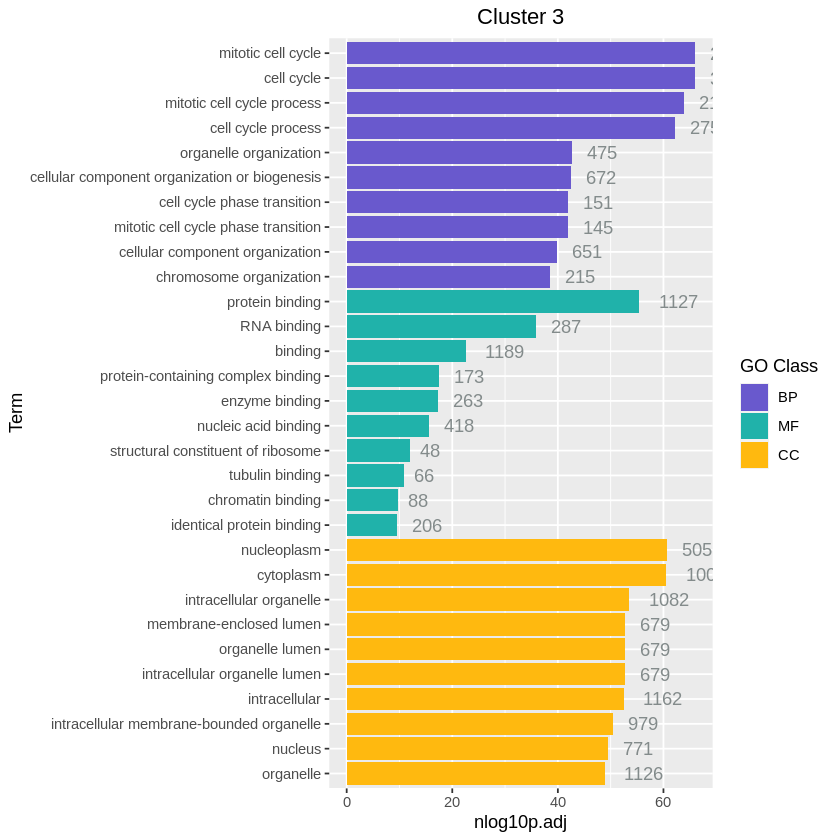

In [25]:
plots <- GOBarPlots(clusterCC.summary, 0.05)
plots
# Save figure of GO Barplots
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-06/r_gte_cluterCC_barplot.pdf", width = size*2, height = size)
grid.arrange(grobs = plots, top="GO Results") ## display plot
dev.off()

Mitotic cell cycle and cell cycle are top ontologies for clusters 3, 10, and 19. I will take a look at both those GOIDs to see which genes they correspond to. If there are differences between the two and save a list of all, and top 10 genes we could look at that contributed to this categorization. 

In [7]:
clusterCC.genes <- genesbyGO(clusterCC[[1]][[4]]) 
#returns a list with the following structure:
# Level 1: BP, MF, CC
# Level 2: GO IDs associated with with Go Class
# Level 3: genes associated with each Go ID

[1] "Number of GO terms in this cluster: 8656"
[1] "completed class: 1"
[1] "Number of GO terms in this cluster: 1588"
[1] "completed class: 2"
[1] "Number of GO terms in this cluster: 1122"
[1] "completed class: 3"
[1] "Conversion complete"


In [8]:
## Find GO ID associated with mitotic cell cycle and cell cycle in Biological Processes
clusterCC.summary[which(clusterCC.summary$Term == "mitotic cell cycle"),1]
clusterCC.summary[which(clusterCC.summary$Term == "cell cycle"),1]

[1] "GO:0000278"

[1] "GO:0007049"

In [9]:
genes.278 <- clusterCC.genes[[1]]$`GO:0000278`
genes.7049 <- clusterCC.genes[[1]]$`GO:0007049`

length(genes.278)
length(genes.7049)
# Size of vector matches with the values in the barplot. 

[1] 238

[1] 331

In [10]:
## What are the unique genes from each GO term?
### In 278 but not 7049
genes.278.unique <- setdiff(genes.278, genes.7049)
length(genes.278.unique)

### In 7049 but not 279
genes.7049.unique <- setdiff(genes.7049, genes.278)
length(genes.7049.unique)

## What are the common genes between go terms 278 and 7049?
genes.278.7049 <- intersect(genes.278, genes.7049)
length(genes.278.7049)

[1] 0

[1] 93

[1] 238

In [14]:
unlist(head(genes.7049.unique, 50))

[1] "CHAF1A"   "CITED2"   "TXNIP"    "POLD3"    "NUDC"     "PLAAT3"  
 [7] "PMF1"     "CBX3"     "SPC24"    "CDCA2"    "ESCO2"    "CYP27B1" 
[13] "CENPV"    "CENPX"    "ERH"      "FANCA"    "HEPACAM"  "FEN1"    
[19] "ITGB3BP"  "CBX5"     "SUZ12"    "PPP1R15A" "ASPM"     "PHGDH"   
[25] "NUPR1"    "BIN1"     "UHRF1"    "PSMC3IP"  "SAC3D1"   "HELLS"   
[31] "HSPA8"    "HSP90AB1" "ID3"      "SEPTIN14" "CXCL8"    "IRF1"    
[37] "JUN"      "JUNB"     "JUND"     "CENPS"    "MIF"      "GADD45B" 
[43] "NPM1"     "SH3GLB1"  "MIS18A"   "SEPTIN4"  "PIMREG"   "PPM1G"   
[49] "CENPQ"    "FANCI"

In [15]:
unlist(head(genes.278.7049, 50))

[1] "SMC4"    "KIF20A"  "CDK4"    "CDK6"    "PSMD14"  "CDKN2A"  "CDKN2C" 
 [8] "CDKN3"   "TUBA1B"  "TUBB4B"  "NDC80"   "MAD2L2"  "TACC3"   "CIB1"   
[15] "CENPA"   "SMC2"    "SPAG5"   "CENPE"   "CENPF"   "KHDRBS1" "CFL1"   
[22] "NES"     "DBF4"    "BTG3"    "KIF2C"   "RCC1"    "UBE2C"   "TOPBP1" 
[29] "CHEK1"   "ZWINT"   "FAM107A" "DCTN3"   "CDCA5"   "HAUS1"   "CKS1B"  
[36] "CKS2"    "SGO2"    "SGO1"    "GADD45A" "DHFR"    "DUSP1"   "E2F1"   
[43] "ECT2"    "EGFR"    "AIF1"    "TUBB"    "EZH2"    "FANCD2"  "SKA1"   
[50] "SKA3"

## MGMT Promoter Methylation of GBM samples

2021-07-08:

In [87]:
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/ge_gbm.sc.int.umap0.7_update.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-17/gte_gbm.sc.int.umap0.7_update.RData")

In [88]:
case_n <- c("SF11159", "SF11209", "SF11215", "SF11232", "SF11247", "SF11285")
MGMT <- c(TRUE, FALSE, FALSE, TRUE, TRUE, FALSE)

Clusters Associated with: 

| SF Case # | MGMT promoter methylation |
| --------- | ------------------------- |
| SF11159   | Positive                  |
| SF11209   | Negative                  |
| SF11215   | Negative                  |
| SF11232   | Positive                  |
| SF11247   | Positive                  |
| SF11285   | Negative                  |

In [89]:
## Add metadata
ge_gbm.sc.int.umap0.7$MGMTme <- NA
gte_gbm.sc.int.umap0.7$MGMTme <- NA

for (i in 1: length(case_n)) {
    ge_gbm.sc.int.umap0.7$MGMTme[which(grepl(case_n[i], ge_gbm.sc.int.umap0.7$sample, fixed=FALSE))] <- MGMT[i]
    gte_gbm.sc.int.umap0.7$MGMTme[which(grepl(case_n[i], gte_gbm.sc.int.umap0.7$sample, fixed=FALSE))] <- MGMT[i]
}

In [92]:
mkdirToday()
save(ge_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
save(gte_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-08"


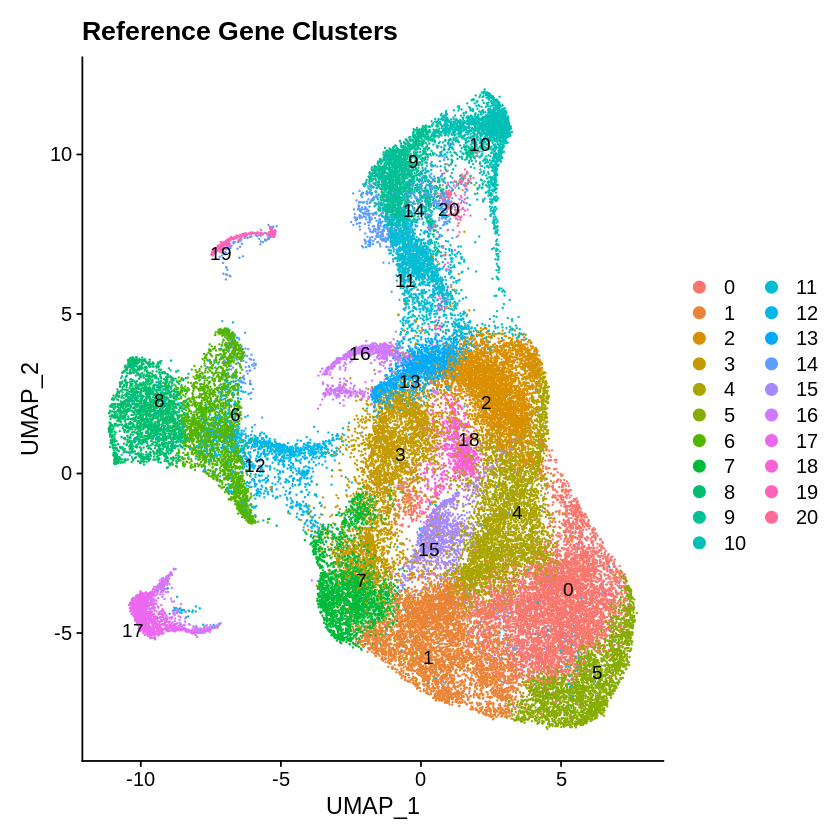

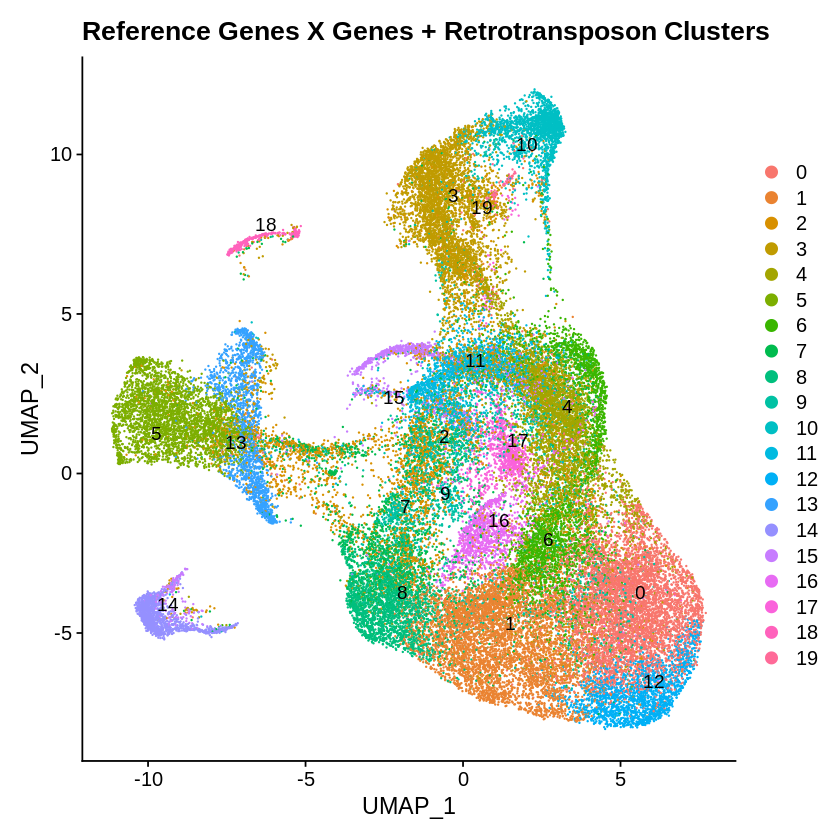

In [201]:
# make a copy of the and change the idents to those of the Genes + Retrotransposon dataset
ge_gbm.sc.int.umap0.7_v2 <- ge_gbm.sc.int.umap0.7 
ge_gbm.sc.int.umap0.7_v2@active.ident <- gte_gbm.sc.int.umap0.7@active.ident

# Create figures
p1 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + 
    ggtitle("Reference Gene Clusters")
p2 <- DimPlot(ge_gbm.sc.int.umap0.7_v2, reduction="umap", label=TRUE, repel = TRUE) + 
    ggtitle("Reference Genes X Genes + Retrotransposon Clusters")
p1
p2

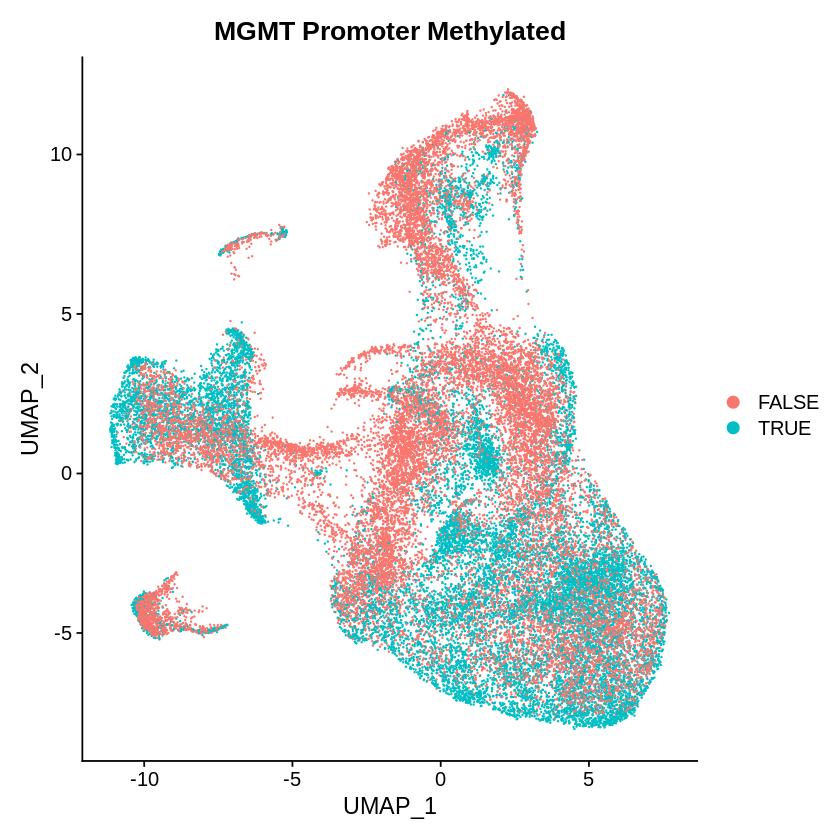

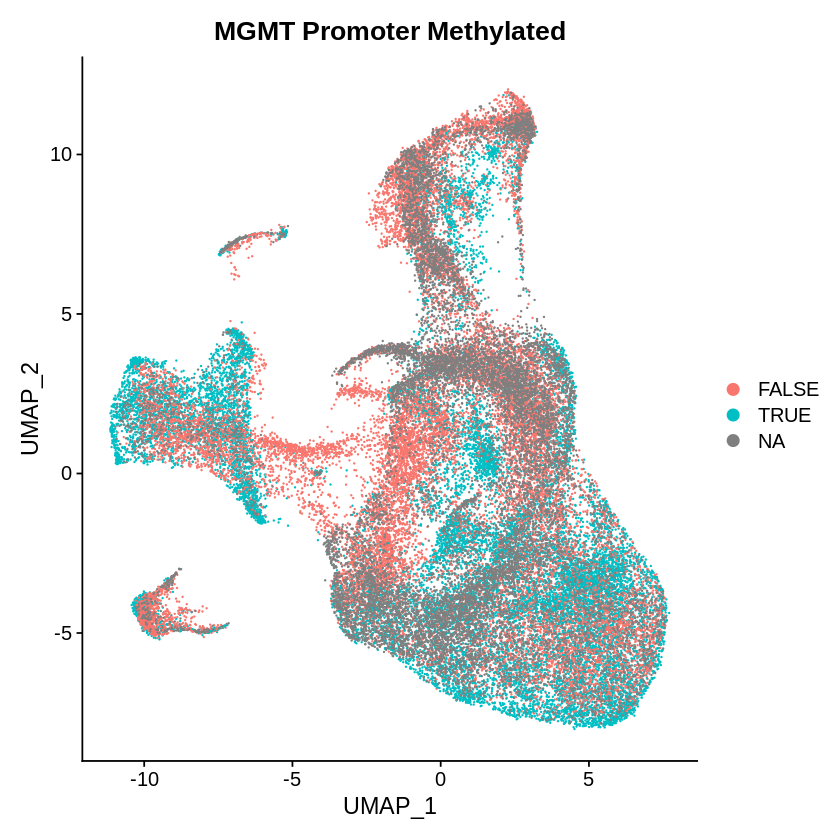

In [197]:
p1 <- subset(ge_gbm.sc.int.umap0.7, MGMTme == TRUE | MGMTme == FALSE) %>%
    DimPlot(reduction = "umap", group.by = "MGMTme") + ggtitle("MGMT Promoter Methylated")

p2 <- ge_gbm.sc.int.umap0.7 %>%
    DimPlot(reduction = "umap", group.by = "MGMTme") + ggtitle("MGMT Promoter Methylated")
p1 
p2

In [196]:
# Save figures
mkdirToday()

size = 7
pdf("~/scratch/gete-gbm/results/2021-07-08/r_GBMSC_umap0.7_MGMTme.pdf", width = size*2, height = size)
grid.arrange(p1, p2, nrow = 1, top="UMAP\nresolution:0.7")
dev.off()

[1] "Current working directory: /scratch/samkyy/gete-gbm/results/2021-07-08"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-07-08' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-08"


png 
  2

In [121]:
## Create df of each sample and their corresponding clusters
# case_n <- c("SF11159", "SF11209", "SF11215", "SF11232", "SF11247", "SF11285")

l_ge <- vector(mode="list", length = length(case_n))
names(l_ge) <- case_n

l_gte <- vector(mode="list", length = length(case_n))
names(l_gte) <- case_n


for (i in 1:length(case_n)) {
    l_ge[[i]] <- sort(as.integer(as.character(unique(ge_gbm.sc.int.umap0.7$seurat_clusters[which(grepl(case_n[i], ge_gbm.sc.int.umap0.7$sample, fixed=FALSE))]))))
    l_gte[[i]] <- sort(as.integer(as.character(unique(gte_gbm.sc.int.umap0.7$seurat_clusters[which(grepl(case_n[i], gte_gbm.sc.int.umap0.7$sample, fixed=FALSE))]))))
}
l_ge
l_gte

$SF11159
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

$SF11209
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

$SF11215
 [1]  0  1  2  3  4  5  7  8  9 10 11 12 13 14 15 16 19

$SF11232
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

$SF11247
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

$SF11285
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

$SF11159
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

$SF11209
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

$SF11215
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

$SF11232
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

$SF11247
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

$SF11285
 [1]  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

In [187]:
clusters_ge <- c(0:20)
clusters_gte <- c(0:19)

df <- data.frame(Map = rep(c("GE", "GTE"), each = 6*21),
                Sample = rep(case_n, each = 21, time = 2),
                MGMT = rep(MGMT, each = 21, time =2),
                Cluster = rep(c(0:20), time = 6*2),
                Present = rep(NA, time = 6*21*2))

m <- matrix(ncol=length(unique(ge_gbm.sc.int.umap0.7$seurat_clusters)) , nrow=12)

for (i in 1:length(case_n)) {
    m[i,] <- clusters_ge %in% l_ge[[i]]
    m[(i+6),1:length(clusters_gte)] <- clusters_gte %in% l_gte[[i]]
}

for (i in 1:nrow(m)) {
#     cat(length(m[i,]), "\n")
#     cat(length(df$Present[((i*21-21)+1):(i*21)]), "\n")
    df$Present[((i*21-21)+1):(i*21)] <- m[i,]
}

df$Map <- factor(df$Map, levels=c("GE", "GTE"))
df$Sample <- factor(df$Sample, levels=unique(df$Sample))
df$Cluster <- factor(df$Cluster, levels=unique(df$Cluster))
df$Present <- factor(df$Present, levels=c(TRUE, FALSE, NA))

head(df)
tail(df)

,Map,Sample,MGMT,Cluster,Present
,<fct>,<fct>,<lgl>,<fct>,<fct>
1,GE,SF11159,TRUE,0,TRUE
2,GE,SF11159,TRUE,1,TRUE
3,GE,SF11159,TRUE,2,TRUE
4,GE,SF11159,TRUE,3,TRUE
5,GE,SF11159,TRUE,4,TRUE
6,GE,SF11159,TRUE,5,TRUE


,Map,Sample,MGMT,Cluster,Present
,<fct>,<fct>,<lgl>,<fct>,<fct>
247,GTE,SF11285,FALSE,15,TRUE
248,GTE,SF11285,FALSE,16,TRUE
249,GTE,SF11285,FALSE,17,TRUE
250,GTE,SF11285,FALSE,18,TRUE
251,GTE,SF11285,FALSE,19,TRUE
252,GTE,SF11285,FALSE,20,NA


In [188]:
write.csv(df, file = "~/scratch/gete-gbm/results/2021-07-08/clusterCompositionPerGBMSample.csv", row.names = FALSE)

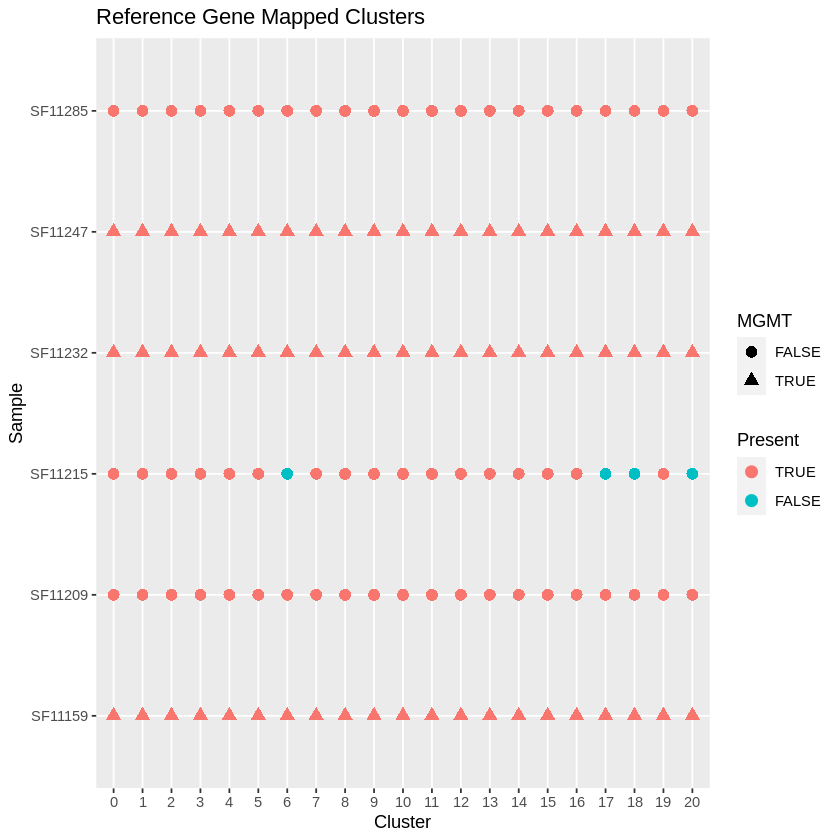

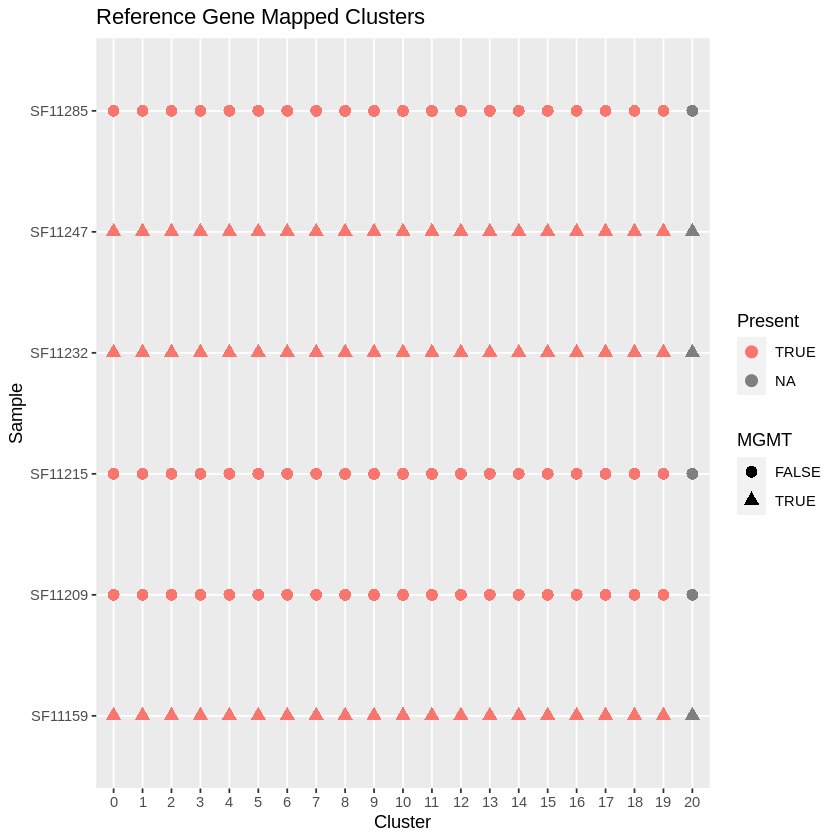

In [199]:
p3 <- subset(df, Map == "GE") %>%
    ggplot(aes(x = Cluster, y = Sample, col = Present, shape = MGMT)) + geom_point(size=3) + ggtitle("Reference Gene Mapped Clusters")
p4 <- subset(df, Map == "GTE") %>%
    ggplot(aes(x = Cluster, y = Sample, col = Present, shape = MGMT)) + geom_point(size=3) + ggtitle("Reference Gene Mapped Clusters")
p3
p4

In [202]:
## Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-07-08/r_GBMSC_dotplot_ClusterComposition.pdf", width = size*2, height = size*2)
grid.arrange(p1, p3, p2, p4, nrow = 2, top="Cluster Composition")
dev.off()

png 
  2

## Exploring Neuronal Stem Cell Marker Expression
2021-07-13, 14, 15, 16:
- [x] Create Bar plot showing cluster composition of CD133 positive cells
- [x] Create Pie chart showing sample composition of CD133 positive cells
- [x] Show expression of GLAST gene (similar to what I did with CD133)
- [x] Create Bar plot showing cluster composition of GLAST positive cells
- [x] Create Pie chart showing sample composition of GLAST positive cells

Which clusters are MGMT+ versus negative?
- [x] Create Bar plot for each individual cluster where it shows percentage of cells that are MGMT positive and negative
- [x] Create Pie chart showing cluster composition of MGMT + versus negative cells

In [4]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [5]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

ERROR: Error in DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA": could not find function "DefaultAssay<-"


In [8]:
## Show expression of GLAST gene (similar to what I did with CD133

ge_gbm.sc.int.umap0.7@assays$RNA@data['SLC1A3',c(1:2)] #hg38 GLAST gene symbol 

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
              1.257786               0.000000

In [20]:
match(c('PROM1', 'SLC1A3'), rownames(ge_gbm.sc.int.umap0.7@assays$integrated@data))
match(c('PROM1', 'SLC1A3'), rownames(gte_gbm.sc.int.umap0.7@assays$integrated@data))

match(c('PROM1', 'SLC1A3'), rownames(ge_gbm.sc.int.umap0.7@assays$RNA@data))
match(c('PROM1', 'SLC1A3'), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))

match(c('MGMT'), rownames(ge_gbm.sc.int.umap0.7@assays$integrated@data))
match(c('MGMT'), rownames(gte_gbm.sc.int.umap0.7@assays$integrated@data))

match(c('MGMT'), rownames(ge_gbm.sc.int.umap0.7@assays$RNA@data))
match(c('MGMT'), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))

[1] NA NA

[1] NA NA

[1] 7036 8331

[1] 6993 8269

[1] NA

[1] NA

[1] 16251

[1] 16130

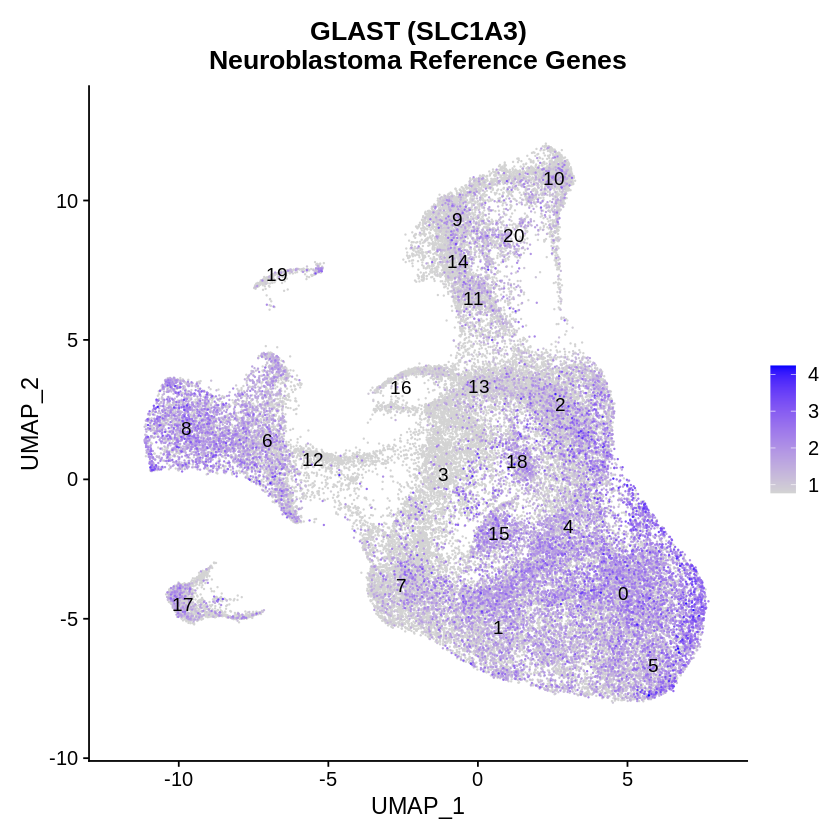

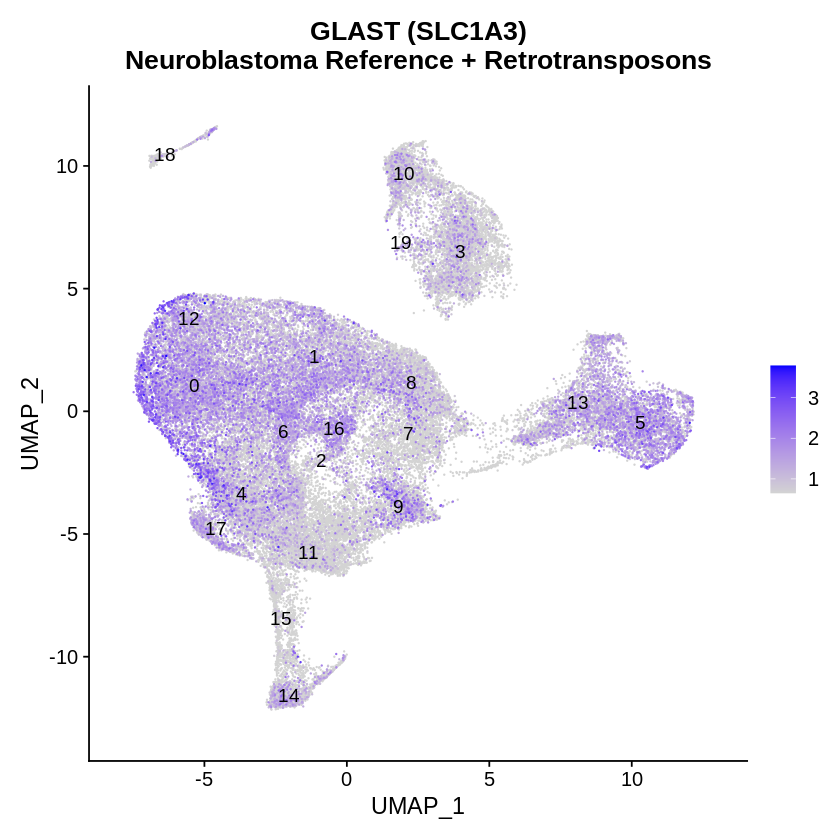

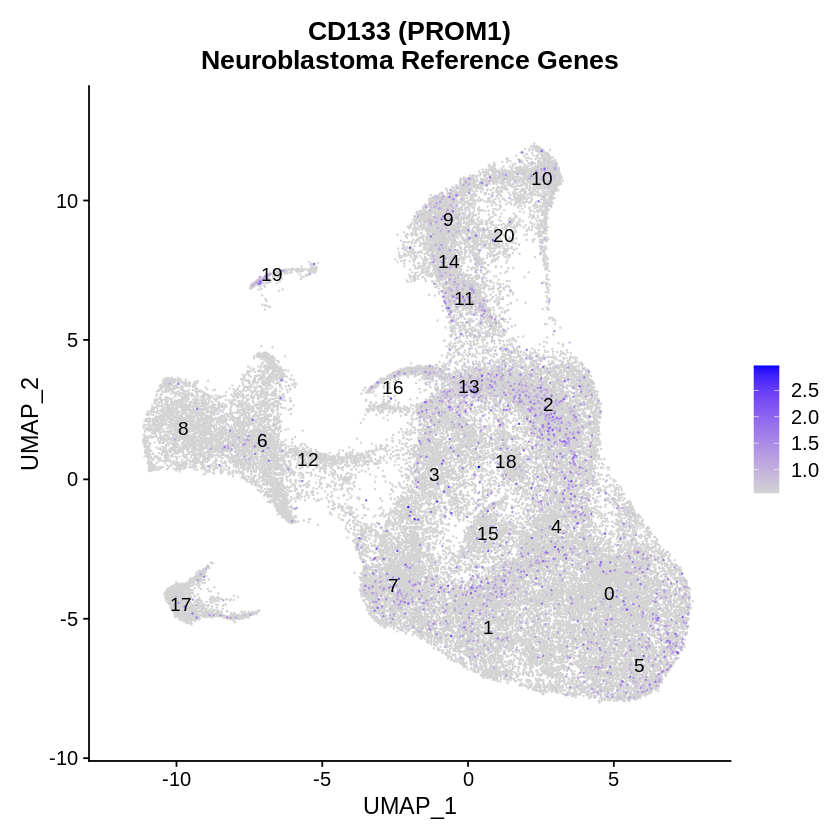

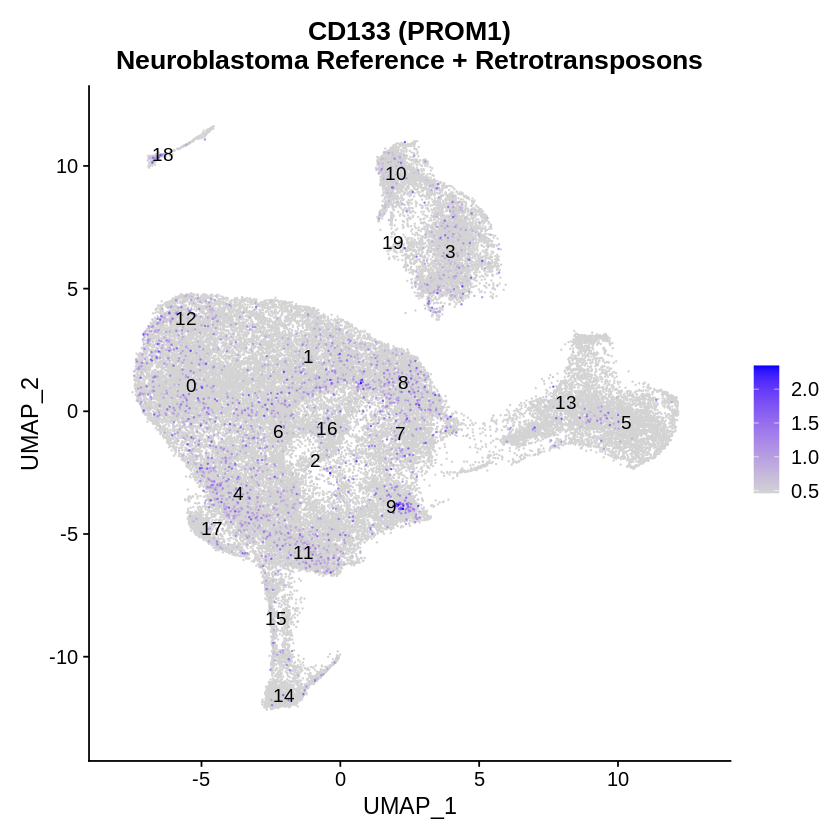

In [26]:
p1 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('SLC1A3'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("GLAST (SLC1A3)\nNeuroblastoma Reference Genes")
p2 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('SLC1A3'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("GLAST (SLC1A3)\nNeuroblastoma Reference + Retrotransposons")
p1
p2

p3 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("CD133 (PROM1)\nNeuroblastoma Reference Genes")
p4 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("CD133 (PROM1)\nNeuroblastoma Reference + Retrotransposons")
p3
p4

In [29]:
# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_CD133-GLAST.pdf", width = size*2, height = size*2)
grid.arrange(p1, p3, p2, p4, nrow = 2, top="Expression of Cancer Stem Cell Markers")
dev.off()

png 
  2

### Create Bar Plots for CD133, GLAST and MGMT by cluster

In [10]:
dim(ge_gbm.sc.int.umap0.7) #genes by cells

[1] 31527 49670

In [107]:
## Create bar plot for CD133 : What percentage of cells in each cluster express CD133?
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

numclusters <- c(length(unique(ge_gbm.sc.int.umap0.7$seurat_clusters)),
                 length(unique(gte_gbm.sc.int.umap0.7$seurat_clusters)))
cat("Number of clusters: ", numclusters, "\n")
cluster_names <- list(as.character(sort(unique(ge_gbm.sc.int.umap0.7$seurat_clusters))),
                      as.character(sort(unique(gte_gbm.sc.int.umap0.7$seurat_clusters))))
cat("Cluster names: \n", cluster_names[[1]], "\n", cluster_names[[2]], "\n")

## Extract cell_IDs in each cluster
cellsbycluster <- NA
cellsbycluster <- list("GE", "GTE")
cellsbycluster[[1]] <- vector(mode="list", length = numclusters[1])
cellsbycluster[[2]] <- vector(mode="list", length = numclusters[2])

for (i in 1:length(cluster_names[[1]])) {
    cellsbycluster[[1]][[i]] <- rownames(ge_gbm.sc.int.umap0.7@meta.data[which(ge_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[1]][i]),])
    if (i < 21) {
        cellsbycluster[[2]][[i]] <- rownames(gte_gbm.sc.int.umap0.7@meta.data[which(gte_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[2]][i]),])
    }
}
names(cellsbycluster[[1]])<- cluster_names[[1]]
names(cellsbycluster[[2]])<- cluster_names[[2]]
head(cellsbycluster[[1]][[1]])

## Create dataframe with columns 
## (map=c(GE, GTE)),(cluster_IDs=c(0:20)), (nCells=total number of cells in this cluster), (nCD133 = number of CD133 expressing cells), (pctCD133=nCD133/nCells*100)
df <- data.frame(map = c(rep("GE", each=numclusters[1]), rep("GTE", each=numclusters[2])), 
                 cluster_IDs= c(cluster_names[[1]],cluster_names[[2]]))

df$nCells <- c(unlist(lapply(cellsbycluster[[1]],length)), unlist(lapply(cellsbycluster[[2]],length)))

## Number of cells that are CD133 (PROM1) positive
nCD133 <- c()
for (i in 1:length(cellsbycluster[[1]])) {
    nCD133 <- c(nCD133, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['PROM1',cellsbycluster[[1]][[i]]]>0))
}
for (i in 1:length(cellsbycluster[[2]])) {
    nCD133 <- c(nCD133, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['PROM1',cellsbycluster[[2]][[i]]]>0))
}
head(nCD133)
tail(nCD133)

df$nCD133 <- nCD133

## Number of cells that are GLAST (SLC1A3) positive
GLAST <- c()
for (i in 1:length(cellsbycluster[[1]])) {
    GLAST <- c(GLAST, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['SLC1A3',cellsbycluster[[1]][[i]]]>0))
}
for (i in 1:length(cellsbycluster[[2]])) {
    GLAST <- c(GLAST, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['SLC1A3',cellsbycluster[[2]][[i]]]>0))
}
head(GLAST)
tail(GLAST)

df$nGLAST <- GLAST

head(df)
tail(df)

Number of clusters:  21 20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 


[1] "GBM_AAACCTGGTGTGGCTC-1" "GBM_AAACGGGGTCCGAATT-1" "GBM_AAACGGGTCGAATGGG-1"
[4] "GBM_AAAGATGGTCTCAACA-1" "GBM_AAAGATGTCAGCAACT-1" "GBM_AAAGCAACACTACAGT-1"

[1] 298 273 459 122 299 277

[1]  19 100  44  43  35   2

[1] 4204 2771 1851  361 2610 2014

[1] 352 248 929 571 123  61

,map,cluster_IDs,nCells,nCD133,nGLAST
,<chr>,<chr>,<int>,<int>,<int>
1,GE,0,6638,298,4204
2,GE,1,4551,273,2771
3,GE,2,4436,459,1851
4,GE,3,4329,122,361
5,GE,4,4129,299,2610
6,GE,5,2695,277,2014


,map,cluster_IDs,nCells,nCD133,nGLAST
,<chr>,<chr>,<int>,<int>,<int>
36,GTE,14,1284,19,352
37,GTE,15,1173,100,248
38,GTE,16,1170,44,929
39,GTE,17,1022,43,571
40,GTE,18,414,35,123
41,GTE,19,73,2,61


In [108]:
## Compute the percentage of cells that are CD133 positive
df$pctCD133 <- df$nCD133/df$nCells*100
## Compute the percentage of cells that are GLAST positive
df$pctGLAST <- df$nGLAST/df$nCells*100

head(df)

,map,cluster_IDs,nCells,nCD133,nGLAST,pctCD133,pctGLAST
,<chr>,<chr>,<int>,<int>,<int>,<dbl>,<dbl>
1,GE,0,6638,298,4204,4.489304,63.332329
2,GE,1,4551,273,2771,5.998682,60.887717
3,GE,2,4436,459,1851,10.347160,41.726781
4,GE,3,4329,122,361,2.818203,8.339108
5,GE,4,4129,299,2610,7.241463,63.211431
6,GE,5,2695,277,2014,10.278293,74.730983


2021-07-14

In [109]:
## Number of cells that are MGMT positive
MGMT <- c()
for (i in 1:length(cellsbycluster[[1]])) {
    MGMT <- c(MGMT, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['MGMT',cellsbycluster[[1]][[i]]]>0))
}
for (i in 1:length(cellsbycluster[[2]])) {
    MGMT <- c(MGMT, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['MGMT',cellsbycluster[[2]][[i]]]>0))
}
head(MGMT)
tail(MGMT)

df$nMGMT <- MGMT

## Compute the percentage of cells that are CD133 positive
df$pctMGMT <- df$nMGMT/df$nCells*100

head(df)

[1] 416 196 408 472 289 170

[1] 186  89  34  28 107   5

,map,cluster_IDs,nCells,nCD133,nGLAST,pctCD133,pctGLAST,nMGMT,pctMGMT
,<chr>,<chr>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>
1,GE,0,6638,298,4204,4.489304,63.332329,416,6.266948
2,GE,1,4551,273,2771,5.998682,60.887717,196,4.306746
3,GE,2,4436,459,1851,10.347160,41.726781,408,9.197475
4,GE,3,4329,122,361,2.818203,8.339108,472,10.903211
5,GE,4,4129,299,2610,7.241463,63.211431,289,6.999273
6,GE,5,2695,277,2014,10.278293,74.730983,170,6.307978


In [22]:
## Number of cells that are MGMT methylation positive
## Extract cell_IDs in each cluster
MGMTcells <- NA
MGMTcells <- list("GE", "GTE")
MGMTcells[[1]] <- vector(mode="list", length = numclusters[1])
MGMTcells[[2]] <- vector(mode="list", length = numclusters[2])

for (i in 1:length(cluster_names[[1]])) {
    MGMTcells[[1]][[i]] <- rownames(ge_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, ge_gbm.sc.int.umap0.7$neuro.ident)) & 
              ((ge_gbm.sc.int.umap0.7$MGMTme == TRUE) | 
              (ge_gbm.sc.int.umap0.7$MGMTme == FALSE)) &
              (ge_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[1]][i])),])
    if (i < 21) {
        MGMTcells[[2]][[i]] <- rownames(gte_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, gte_gbm.sc.int.umap0.7$neuro.ident)) & 
              ((gte_gbm.sc.int.umap0.7$MGMTme == TRUE) | 
              (gte_gbm.sc.int.umap0.7$MGMTme == FALSE)) &
              (gte_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[2]][i])),])
    }
}
names(MGMTcells[[1]])<- cluster_names[[1]]
names(MGMTcells[[2]])<- cluster_names[[2]]
head(MGMTcells[[1]][[1]])

df$nMGMTcells <- c(unlist(lapply(MGMTcells[[1]],length)), unlist(lapply(MGMTcells[[2]],length)))

## Compute percentage of cells that are MGMTme positive (chemosensitive) 
MGMTme <- c()
for (i in 1:length(MGMTcells[[1]])) {
    MGMTme <- c(MGMTme, nrow(ge_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, ge_gbm.sc.int.umap0.7$neuro.ident)) & 
              (ge_gbm.sc.int.umap0.7$MGMTme == TRUE) & 
              (ge_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[1]][i])),]))
}
for (i in 1:length(MGMTcells[[2]])) {
    MGMTme <- c(MGMTme, nrow(gte_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, gte_gbm.sc.int.umap0.7$neuro.ident)) & 
              (gte_gbm.sc.int.umap0.7$MGMTme == TRUE) & 
              (gte_gbm.sc.int.umap0.7$seurat_clusters == cluster_names[[2]][i])),]))
}
head(MGMTme)
tail(MGMTme)

df$nMGMTme <- MGMTme

## Compute the percentage of cells that are MGMT promoter methylated
df$pctMGMTme <- df$nMGMTme/df$nMGMTcells*100

head(df)
tail(df)

[1] "GBM_AAACCTGGTGTGGCTC-1" "GBM_AAACGGGGTCCGAATT-1" "GBM_AAACGGGTCGAATGGG-1"
[4] "GBM_AAAGATGGTCTCAACA-1" "GBM_AAAGATGTCAGCAACT-1" "GBM_AAAGCAACACTACAGT-1"

[1] 3439 1985  514  213 1392 1612

[1] 516 412  43  19 119   7

,map,cluster_IDs,nCells,nCD133,nGLAST,pctCD133,pctGLAST,nMGMT,pctMGMT,nMGMTcells,nMGMTme,pctMGMTme
,<chr>,<chr>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<int>,<int>,<dbl>
1,GE,0,6638,298,4204,4.489304,63.332329,416,6.266948,5562,3439,61.830277
2,GE,1,4551,273,2771,5.998682,60.887717,196,4.306746,2663,1985,74.539992
3,GE,2,4436,459,1851,10.347160,41.726781,408,9.197475,2591,514,19.837900
4,GE,3,4329,122,361,2.818203,8.339108,472,10.903211,3854,213,5.526725
5,GE,4,4129,299,2610,7.241463,63.211431,289,6.999273,2636,1392,52.807284
6,GE,5,2695,277,2014,10.278293,74.730983,170,6.307978,2288,1612,70.454545


,map,cluster_IDs,nCells,nCD133,nGLAST,pctCD133,pctGLAST,nMGMT,pctMGMT,nMGMTcells,nMGMTme,pctMGMTme
,<chr>,<chr>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<int>,<int>,<dbl>
36,GTE,14,1284,19,352,1.479751,27.41433,186,14.485981,1153,516,44.752819
37,GTE,15,1173,100,248,8.525149,21.14237,89,7.587383,706,412,58.356941
38,GTE,16,1170,44,929,3.760684,79.40171,34,2.905983,920,43,4.673913
39,GTE,17,1022,43,571,4.207436,55.87084,28,2.739726,964,19,1.970954
40,GTE,18,414,35,123,8.454106,29.71014,107,25.845411,311,119,38.263666
41,GTE,19,73,2,61,2.739726,83.56164,5,6.849315,63,7,11.111111


In [23]:
## factor columns: map & cluster_IDs
df$cluster_IDs <- factor(df$cluster_IDs, levels = as.character(c(0:20)))
df$map <- factor(df$map, levels = c("GE", "GTE"))

In [24]:
## save df 
write.csv(df, file = "~/scratch/gete-gbm/results/2021-07-08/cellCompositionPerClusterCD133-GLAST-MGMT.csv", row.names = FALSE)

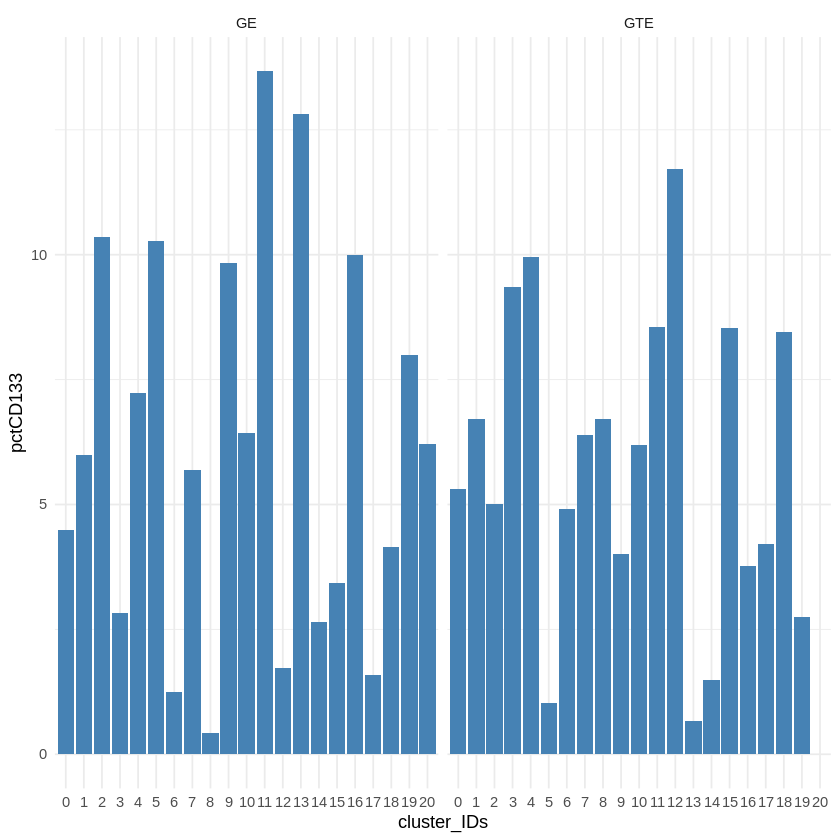

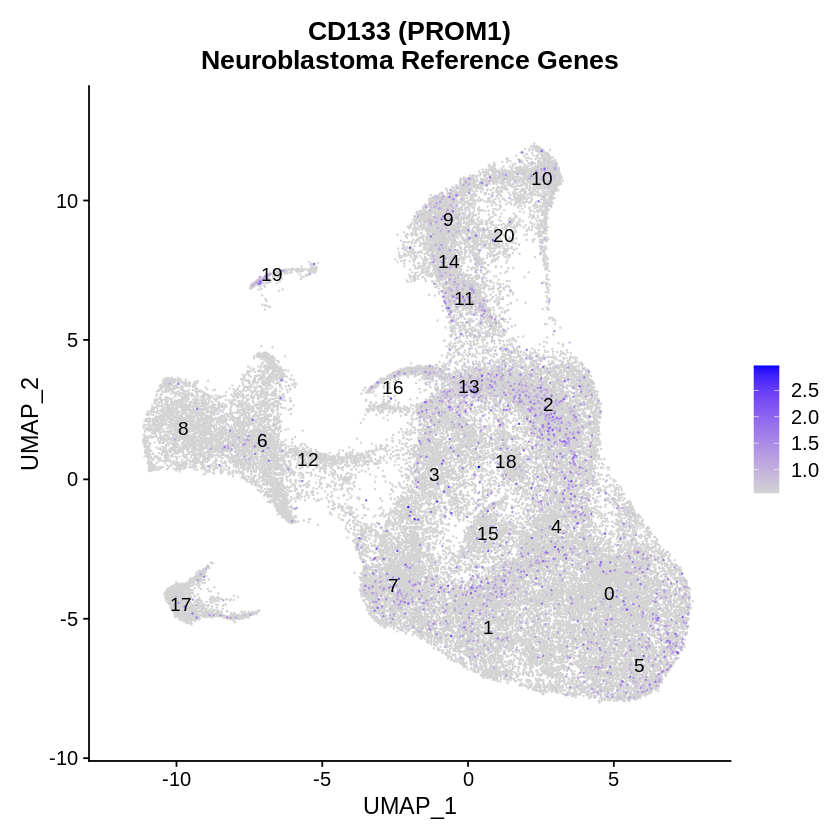

png 
  2

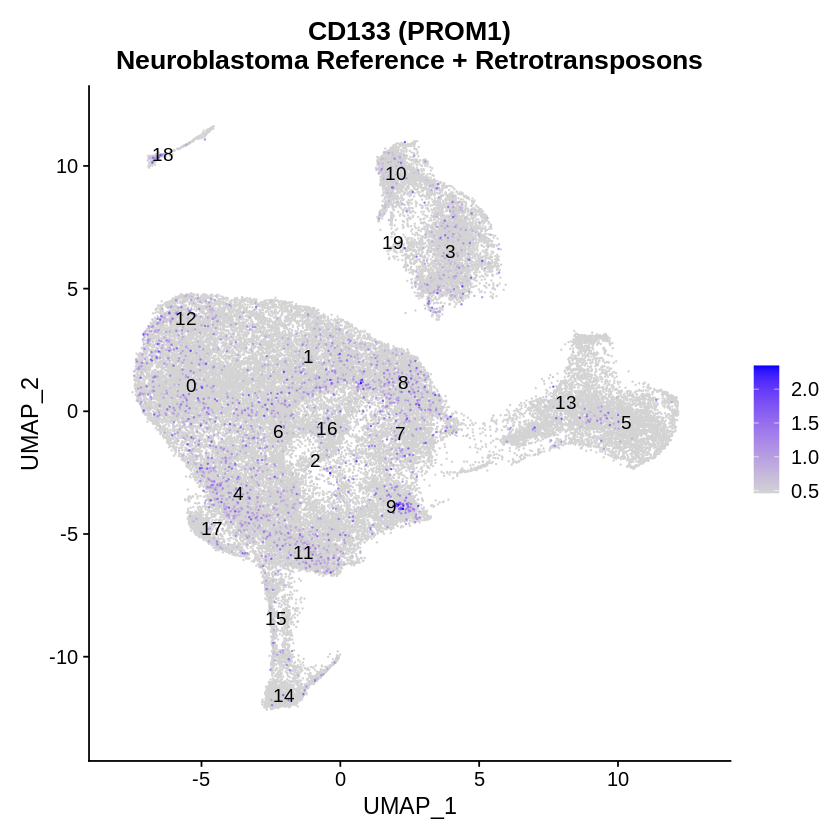

In [32]:
p1 <- ggplot(data = df, aes(x = cluster_IDs, y = pctCD133)) + geom_col(fill = "steelblue") + 
theme_minimal() + facet_wrap(vars(map))

p1

p2 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("CD133 (PROM1)\nNeuroblastoma Reference Genes")
p3 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('PROM1'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("CD133 (PROM1)\nNeuroblastoma Reference + Retrotransposons")
p2
p3

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_CD133-clustercomposition.pdf", width = size*2, height = size*2)
grid.arrange(
  p1, p2, p3,
  layout_matrix = rbind(c(1, 1),
                        c(2, 3))
)
dev.off()

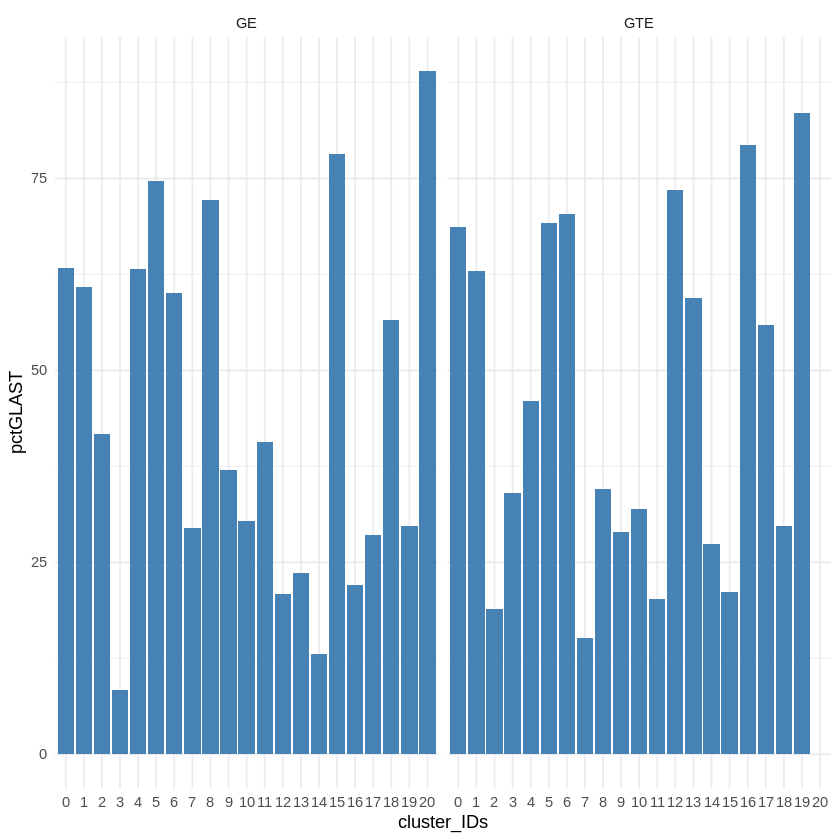

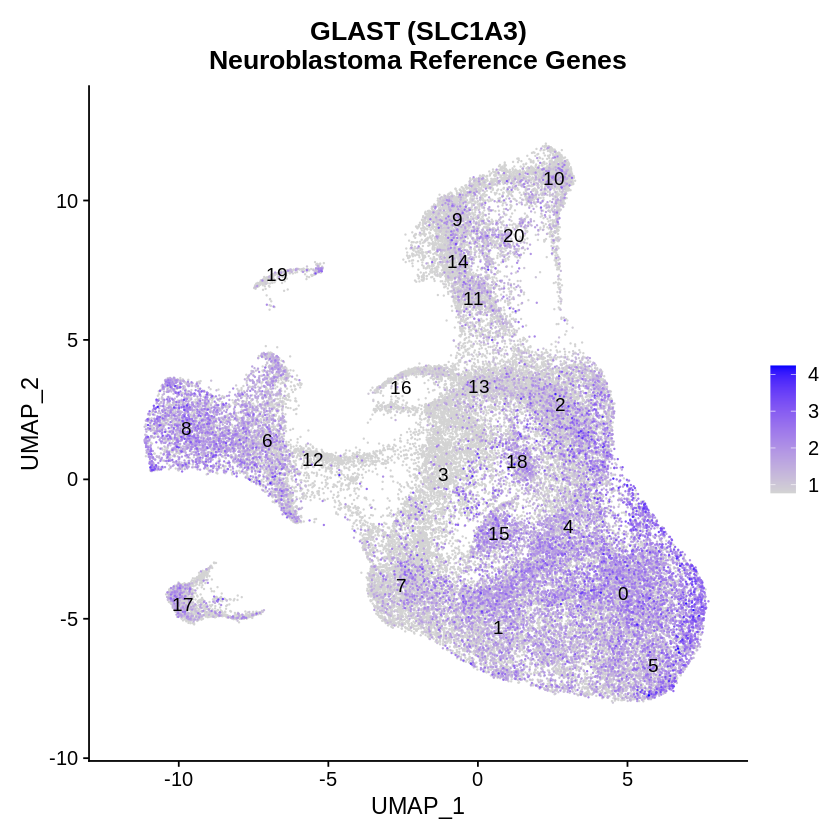

png 
  2

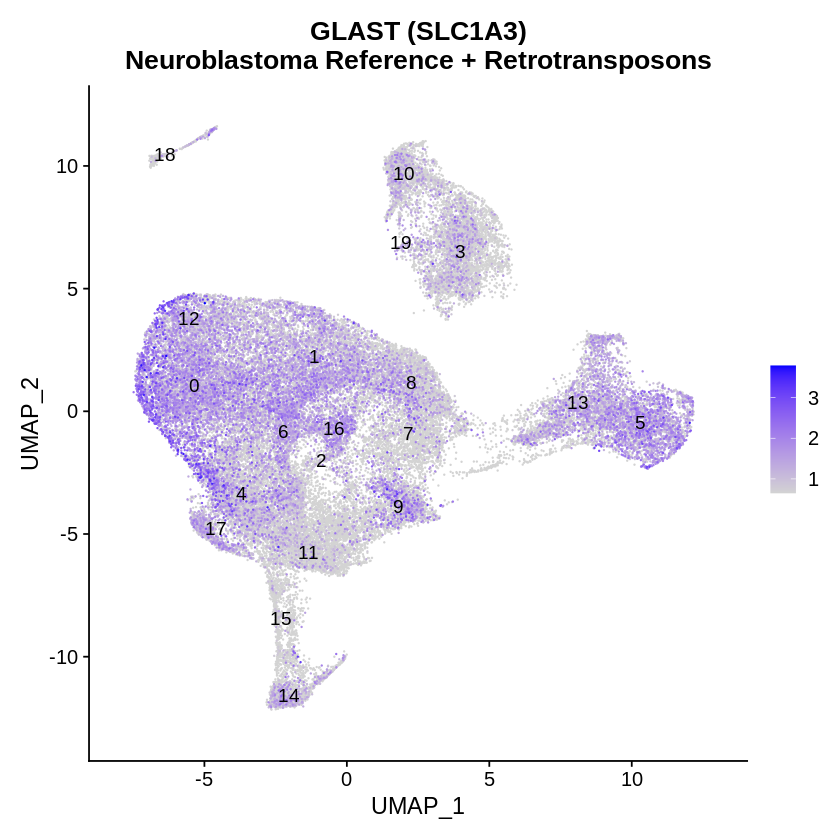

In [13]:
p1 <- ggplot(data = df, aes(x = cluster_IDs, y = pctGLAST)) + geom_col(fill = "steelblue") + 
theme_minimal() + facet_wrap(vars(map))

p2 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('SLC1A3'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("GLAST (SLC1A3)\nNeuroblastoma Reference Genes")
p3 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('SLC1A3'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("GLAST (SLC1A3)\nNeuroblastoma Reference + Retrotransposons")
p1
p2
p3

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_GLAST-clustercomposition.pdf", width = size*2, height = size*2)
grid.arrange(
  p1, p2, p3,
  layout_matrix = rbind(c(1, 1),
                        c(2, 3))
)
dev.off()

In [23]:
df_MGMT <- df[,c("map", "cluster_IDs", "pctMGMT")]
df_MGMT$type <- "pctMGMT"
colnames(df_MGMT) <- c("map", "cluster_IDs", "percentage", "type")
df_MGMTme <- df[,c("map", "cluster_IDs", "pctMGMTme")]
df_MGMTme$type <- "pctMGMTme"
colnames(df_MGMTme) <- c("map", "cluster_IDs", "percentage", "type")

df_2 <- rbind(df_MGMT, df_MGMTme)
head(df_2)

,map,cluster_IDs,percentage,type
,<fct>,<fct>,<dbl>,<chr>
1,GE,0,6.266948,pctMGMT
2,GE,1,4.306746,pctMGMT
3,GE,2,9.197475,pctMGMT
4,GE,3,10.903211,pctMGMT
5,GE,4,6.999273,pctMGMT
6,GE,5,6.307978,pctMGMT


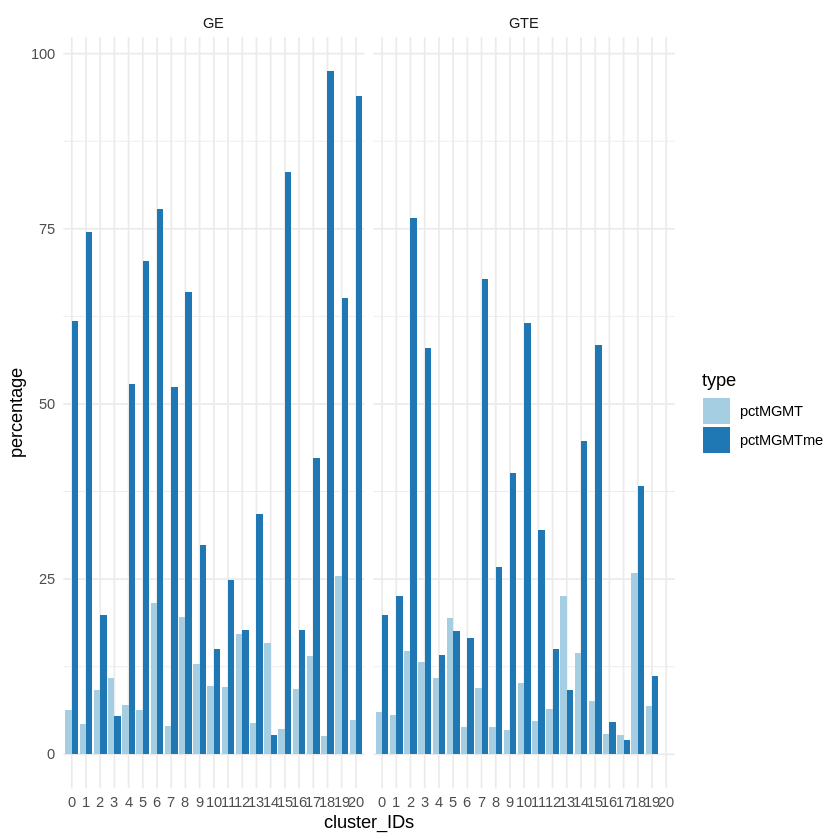

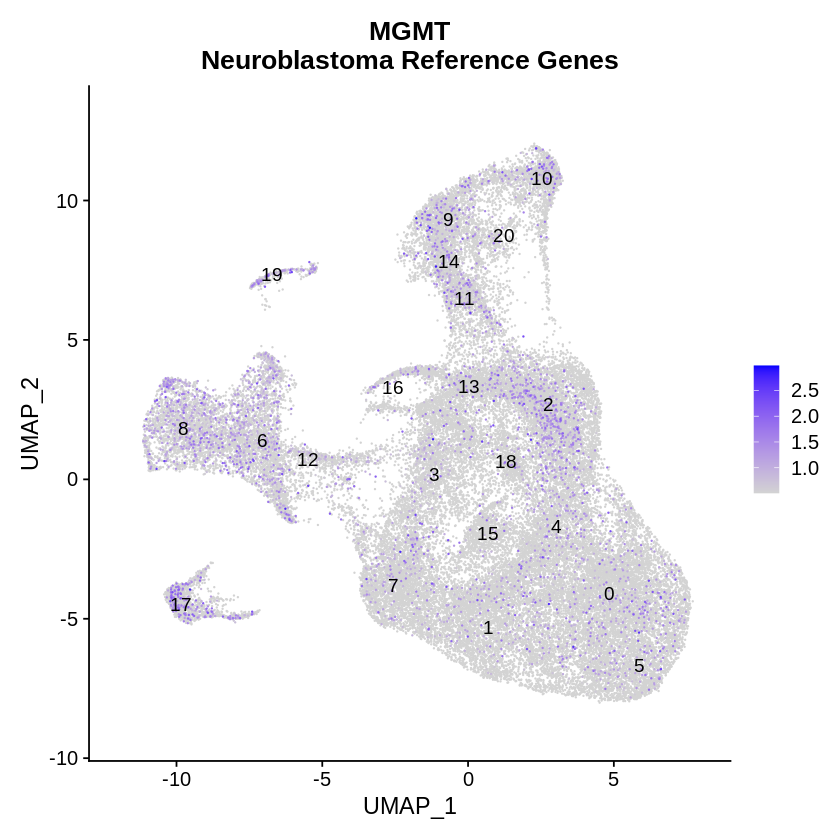

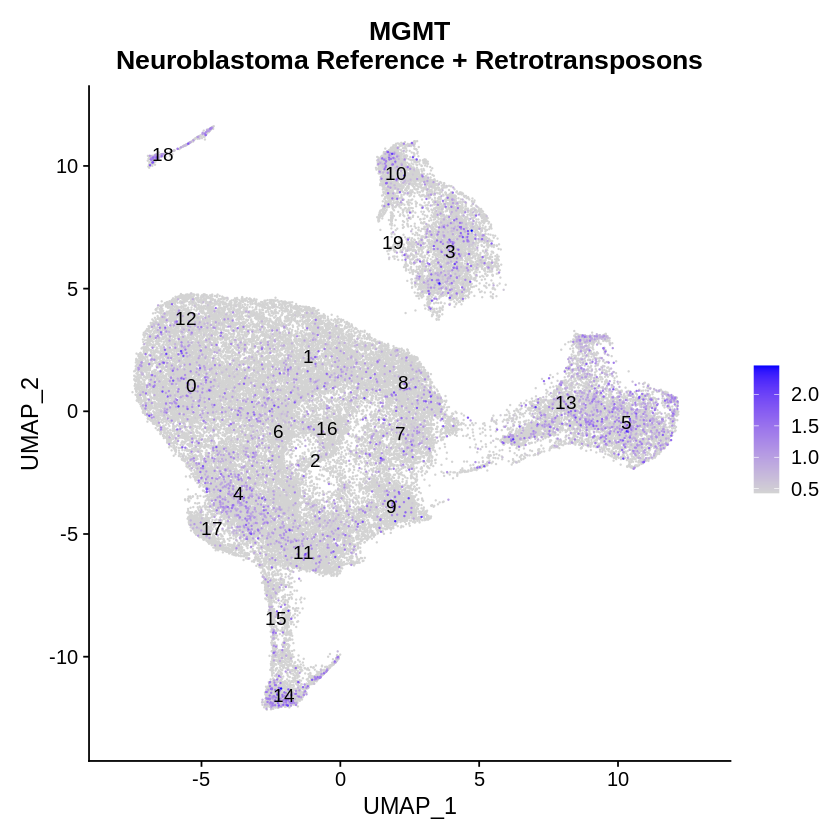

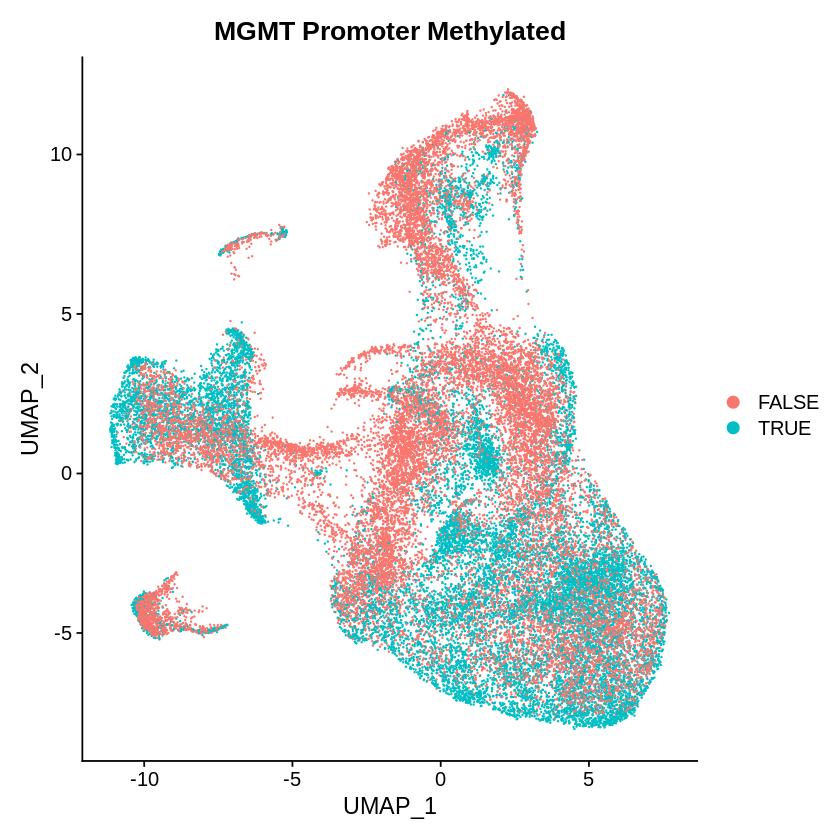

png 
  2

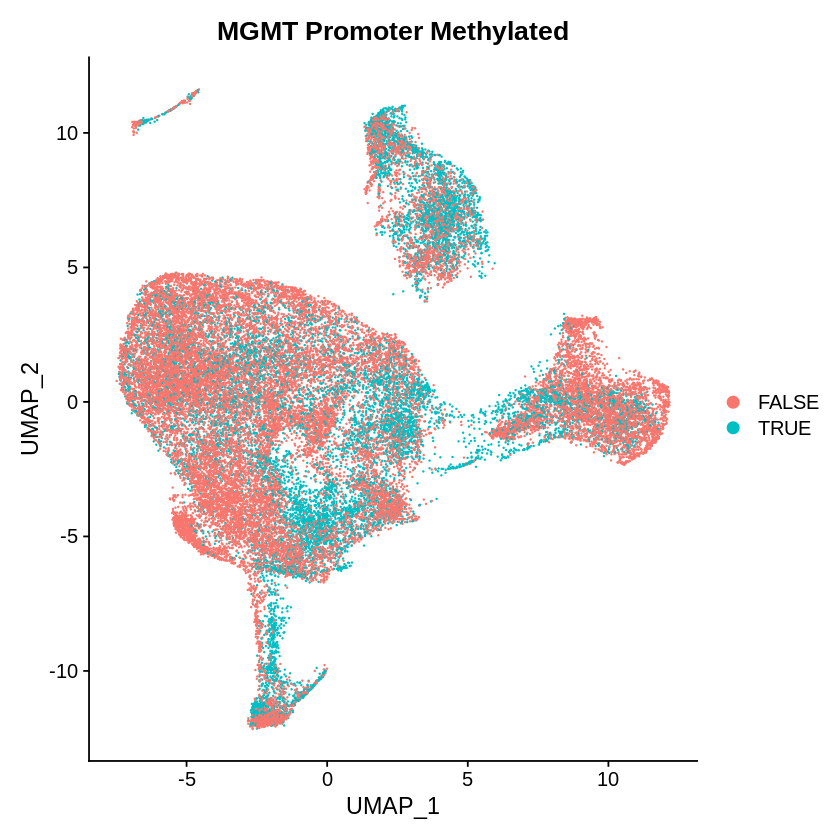

In [25]:
## Bar plots for MGMT expression and promoter methylation status
p1 <- ggplot(data = df_2, aes(x = cluster_IDs, y = percentage, fill=type)) + 
        geom_bar(stat="identity", position=position_dodge())+
        scale_fill_brewer(palette="Paired")+
        theme_minimal() + facet_wrap(vars(map))

p2 <- FeaturePlot(ge_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('MGMT'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantil
            label = TRUE) + ggtitle("MGMT\nNeuroblastoma Reference Genes")
p3 <- FeaturePlot(gte_gbm.sc.int.umap0.7, 
            reduction = "umap", 
            features = c('MGMT'), 
            order = TRUE, #replaces sort.cell = TRUE
            min.cutoff = 'q10', #quantile
            label = TRUE) + ggtitle("MGMT\nNeuroblastoma Reference + Retrotransposons")

p4 <- subset(ge_gbm.sc.int.umap0.7, MGMTme == TRUE | MGMTme == FALSE) %>%
    DimPlot(reduction = "umap", group.by = "MGMTme") + ggtitle("MGMT Promoter Methylated")
p5 <- subset(gte_gbm.sc.int.umap0.7, MGMTme == TRUE | MGMTme == FALSE) %>%
    DimPlot(reduction = "umap", group.by = "MGMTme") + ggtitle("MGMT Promoter Methylated")

p1
p2
p3
p4
p5

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_MGMT-clustercomposition.pdf", width = size*2, height = size*3)
grid.arrange(
  p1, p2, p3, p4,p5,
  layout_matrix = rbind(c(1, 1),
                        c(2, 3),
                        c(4, 5))
)
dev.off()

### Create Pie Charts about sample composition of CD133, GLAST and MGMT
- 2021-07-15: Created the bulk of the pie chart script. Added extra metadata column with combined sample name (GBM samples are note separated by _1 or _2)

In [14]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [15]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

In [55]:
## metadata column with combined sample names
sampleNames_raw_ge <- c("SF11159_2", "SF11209_1", "SF11209_2", "SF11247_2", "SF11215_2", "SF11232_2", "SF11247_1","SF11215_1",
                "SF11159_1", "SF11285_2", "SF11232_1", "SF11285_1", "SRR10353960", "SRR10353961", "SRR10353962")
sampleNames_comb_ge <- c("SF11159", "SF11209", "SF11209", "SF11247", "SF11215", "SF11232", "SF11247","SF11215",
                "SF11159", "SF11285", "SF11232", "SF11285", "SRR10353960", "SRR10353961", "SRR10353962")
sampleNames_raw_gte <- c('SF11232_1','SF11215_2','SF11159_2','SF11285_1','SF11232_2','SF11209_1','SF11209_2','SF11159_1',
                        'SF11215_1','SF11247_1','SF11247_2','SF11285_2','SRR10353960','SRR10353961','SRR10353962')
sampleNames_comb_gte <- c('SF11232','SF11215','SF11159','SF11285','SF11232','SF11209','SF11209','SF11159',
                        'SF11215','SF11247','SF11247','SF11285','SRR10353960','SRR10353961','SRR10353962')
sampleLevels <- c('SF11159','SF11209','SF11215','SF11232','SF11247','SF11285','SRR10353960','SRR10353961','SRR10353962')

ge_gbm.sc.int.umap0.7$sampleCombined <- NA
gte_gbm.sc.int.umap0.7$sampleCombined <- NA

for (i in 1: length(sampleNames_raw_ge)) {
    ge_gbm.sc.int.umap0.7$sampleCombined[which(ge_gbm.sc.int.umap0.7$sample == sampleNames_raw_ge[i])] <- sampleNames_comb_ge[i]
    ge_gbm.sc.int.umap0.7$sampleCombined <- factor(ge_gbm.sc.int.umap0.7$sampleCombined, levels = sampleLevels)
    gte_gbm.sc.int.umap0.7$sampleCombined[which(gte_gbm.sc.int.umap0.7$sample == sampleNames_raw_gte[i])] <- sampleNames_comb_gte[i]
    gte_gbm.sc.int.umap0.7$sampleCombined <- factor(gte_gbm.sc.int.umap0.7$sampleCombined, levels = sampleLevels)
}

head(ge_gbm.sc.int.umap0.7@meta.data)
head(gte_gbm.sc.int.umap0.7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7,GBM1,0,0,1,1,TRUE,SF11159
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3,GBM1,0,0,8,8,TRUE,SF11159
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0,GBM1,0,0,0,0,TRUE,SF11159
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0,GBM1,0,0,0,0,TRUE,SF11159
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0,GBM1,0,0,0,0,TRUE,SF11159
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14,GBM1,0,0,0,0,TRUE,SF11159


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,3,GBM1,0,0,1,1,TRUE,SF11232
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,4,GBM1,0,0,5,5,TRUE,SF11232
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,0,GBM1,0,0,0,0,TRUE,SF11232
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,0,GBM1,0,0,0,0,TRUE,SF11232
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,0,GBM1,0,0,2,2,TRUE,SF11232
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,8,GBM1,0,0,4,4,TRUE,SF11232


In [56]:
save(ge_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
save(gte_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [99]:
### Cell IDs by sample
numsamples <- c(length(unique(ge_gbm.sc.int.umap0.7$sampleCombined)),
                 length(unique(gte_gbm.sc.int.umap0.7$sampleCombined)))
cat("Number of samples: ", numsamples, "\n")
sample_names <- list(as.character(sort(unique(ge_gbm.sc.int.umap0.7$sampleCombined))),
                      as.character(sort(unique(gte_gbm.sc.int.umap0.7$sampleCombined))))
cat("Sample names: \n", sample_names[[1]], "\n", sample_names[[2]], "\n")

## Extract cell_IDs in each sample
cellsbysample <- NA
cellsbysample <- list("GE", "GTE")
cellsbysample[[1]] <- vector(mode="list", length = numsamples[1])
cellsbysample[[2]] <- vector(mode="list", length = numsamples[2])

for (i in 1:length(cellsbysample[[1]])) {
    cellsbysample[[1]][[i]] <- rownames(ge_gbm.sc.int.umap0.7@meta.data[which(ge_gbm.sc.int.umap0.7$sampleCombined == sample_names[[1]][i]),])
    if (i < 21) {
        cellsbysample[[2]][[i]] <- rownames(gte_gbm.sc.int.umap0.7@meta.data[which(gte_gbm.sc.int.umap0.7$sampleCombined == sample_names[[2]][i]),])
    }
}
names(cellsbysample[[1]])<- sample_names[[1]]
names(cellsbysample[[2]])<- sample_names[[2]]
head(cellsbysample[[1]][[1]])

## Create dataframe with columns 
## (map=c(GE, GTE)),(cluster_IDs=c(0:20)), (nCells=total number of cells in this cluster), (nCD133 = number of CD133 expressing cells), (pctCD133=nCD133/nCells*100)
df <- data.frame(map = c(rep("GE", each=numsamples[1]), rep("GTE", each=numsamples[2])), 
                 sample_IDs= c(sample_names[[1]],sample_names[[2]]))

df$nCells <- c(unlist(lapply(cellsbysample[[1]],length)), unlist(lapply(cellsbysample[[2]],length)))

## Number of cells that are CD133 (PROM1) positive
nCD133 <- c()
for (i in 1:length(cellsbysample[[1]])) {
    nCD133 <- c(nCD133, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['PROM1',cellsbysample[[1]][[i]]]>0))
}
for (i in 1:length(cellsbysample[[2]])) {
    nCD133 <- c(nCD133, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['PROM1',cellsbysample[[2]][[i]]]>0))
}
head(nCD133)
tail(nCD133)

df$nCD133 <- nCD133

## Number of cells that are GLAST (SLC1A3) positive
GLAST <- c()
for (i in 1:length(cellsbysample[[1]])) {
    GLAST <- c(GLAST, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['SLC1A3',cellsbysample[[1]][[i]]]>0))
}
for (i in 1:length(cellsbysample[[2]])) {
    GLAST <- c(GLAST, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['SLC1A3',cellsbysample[[2]][[i]]]>0))
}
head(GLAST)
tail(GLAST)

df$nGLAST <- GLAST

## Number of cells that are MGMT positive
MGMT <- c()
for (i in 1:length(cellsbysample[[1]])) {
    MGMT <- c(MGMT, sum(ge_gbm.sc.int.umap0.7@assays$RNA@data['MGMT',cellsbysample[[1]][[i]]]>0))
}
for (i in 1:length(cellsbysample[[2]])) {
    MGMT <- c(MGMT, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data['MGMT',cellsbysample[[2]][[i]]]>0))
}

df$nMGMT <- MGMT

## Compute the percentage of cells that are CD133 positive
df$pctCD133 <- df$nCD133/df$nCells*100
## Compute the percentage of cells that are GLAST positive
df$pctGLAST <- df$nGLAST/df$nCells*100
## Compute the percentage of cells that are CD133 positive
df$pctMGMT <- df$nMGMT/df$nCells*100

head(df)
tail(df)

### Number of Cells expressing CD133, GLAST, MGMT
### Percentage of cells expressing CD133, GLAST, MGMT

Number of samples:  9 9 
Sample names: 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 


[1] "GBM_AAACCTGCAATTCCTT-1" "GBM_AAACCTGCACAGAGGT-1" "GBM_AAACCTGGTGTGGCTC-1"
[4] "GBM_AAACGGGGTCCGAATT-1" "GBM_AAACGGGTCGAATGGG-1" "GBM_AAAGATGGTCTCAACA-1"

[1]  10  22 110 118 506 260

[1]   68   78  479 1366  509  110

[1] 2129 1882  378  498 8855 2489

[1] 1342  743 6205 2420 2194 2345

,map,sample_IDs,nCells,nCD133,nGLAST,nMGMT,pctCD133,pctGLAST,pctMGMT
,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
1,GE,SF11159,2826,10,2129,129,0.3538570,75.336164,4.564756
2,GE,SF11209,3178,22,1882,140,0.6922593,59.219635,4.405286
3,GE,SF11215,4295,110,378,392,2.5611176,8.800931,9.126892
4,GE,SF11232,1070,118,498,71,11.0280374,46.542056,6.635514
5,GE,SF11247,13209,506,8855,850,3.8307215,67.037626,6.435006
6,GE,SF11285,11980,260,2489,2376,2.1702838,20.776294,19.833055


,map,sample_IDs,nCells,nCD133,nGLAST,nMGMT,pctCD133,pctGLAST,pctMGMT
,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>
13,GTE,SF11232,4444,68,1342,295,1.530153,30.19802,6.6381638
14,GTE,SF11247,5279,78,743,1045,1.477553,14.07464,19.7954158
15,GTE,SF11285,13617,479,6205,1727,3.517662,45.56804,12.6826761
16,GTE,SRR10353960,4719,1366,2420,17,28.946811,51.28205,0.3602458
17,GTE,SRR10353961,4404,509,2194,628,11.557675,49.81835,14.2597639
18,GTE,SRR10353962,3989,110,2345,116,2.757583,58.78666,2.9079970


In [100]:
## Number of cells that are MGMT methylation positive
## Extract cell_IDs in each cluster
MGMTcells <- NA
MGMTcells <- list("GE", "GTE")
MGMTcells[[1]] <- vector(mode="list", length = numsamples[1])
MGMTcells[[2]] <- vector(mode="list", length = numsamples[2])

for (i in 1:length(sample_names[[1]])) {
    MGMTcells[[1]][[i]] <- rownames(ge_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, ge_gbm.sc.int.umap0.7$neuro.ident)) & 
              ((ge_gbm.sc.int.umap0.7$MGMTme == TRUE) | (ge_gbm.sc.int.umap0.7$MGMTme == FALSE)) &
              (ge_gbm.sc.int.umap0.7$sampleCombined == sample_names[[1]][i])),])
    if (i < 21) {
        MGMTcells[[2]][[i]] <- rownames(gte_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, gte_gbm.sc.int.umap0.7$neuro.ident)) & 
              ((gte_gbm.sc.int.umap0.7$MGMTme == TRUE) | (gte_gbm.sc.int.umap0.7$MGMTme == FALSE)) &
              (gte_gbm.sc.int.umap0.7$sampleCombined == sample_names[[2]][i])),])
    }
}
names(MGMTcells[[1]])<- sample_names[[1]]
names(MGMTcells[[2]])<- sample_names[[2]]
head(MGMTcells[[1]][[1]])

df$nMGMTcells <- c(unlist(lapply(MGMTcells[[1]],length)), unlist(lapply(MGMTcells[[2]],length)))

## Compute percentage of cells that are MGMTme positive (chemosensitive) 
MGMTme <- c()
for (i in 1:length(MGMTcells[[1]])) {
    MGMTme <- c(MGMTme, nrow(ge_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, ge_gbm.sc.int.umap0.7$neuro.ident)) & 
              (ge_gbm.sc.int.umap0.7$MGMTme == TRUE) & 
              (ge_gbm.sc.int.umap0.7$sampleCombined == sample_names[[1]][i])),]))
}
for (i in 1:length(MGMTcells[[2]])) {
    MGMTme <- c(MGMTme, nrow(gte_gbm.sc.int.umap0.7@meta.data[
        which(as.vector(sapply("GBM", grepl, gte_gbm.sc.int.umap0.7$neuro.ident)) & 
              (gte_gbm.sc.int.umap0.7$MGMTme == TRUE) & 
              (gte_gbm.sc.int.umap0.7$sampleCombined == sample_names[[2]][i])),]))
}
head(MGMTme)
tail(MGMTme)

df$nMGMTme <- MGMTme

## Compute the percentage of cells that are MGMT promoter methylated
df$pctMGMTme <- df$nMGMTme/df$nMGMTcells*100

head(df)
tail(df)

[1] "GBM_AAACCTGCAATTCCTT-1" "GBM_AAACCTGCACAGAGGT-1" "GBM_AAACCTGGTGTGGCTC-1"
[4] "GBM_AAACGGGGTCCGAATT-1" "GBM_AAACGGGTCGAATGGG-1" "GBM_AAAGATGGTCTCAACA-1"

[1]  2826     0     0  1070 13209     0

[1] 4444 5279    0    0    0    0

,map,sample_IDs,nCells,nCD133,nGLAST,nMGMT,pctCD133,pctGLAST,pctMGMT,nMGMTcells,nMGMTme,pctMGMTme
,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>
1,GE,SF11159,2826,10,2129,129,0.3538570,75.336164,4.564756,2826,2826,100
2,GE,SF11209,3178,22,1882,140,0.6922593,59.219635,4.405286,3178,0,0
3,GE,SF11215,4295,110,378,392,2.5611176,8.800931,9.126892,4295,0,0
4,GE,SF11232,1070,118,498,71,11.0280374,46.542056,6.635514,1070,1070,100
5,GE,SF11247,13209,506,8855,850,3.8307215,67.037626,6.435006,13209,13209,100
6,GE,SF11285,11980,260,2489,2376,2.1702838,20.776294,19.833055,11980,0,0


,map,sample_IDs,nCells,nCD133,nGLAST,nMGMT,pctCD133,pctGLAST,pctMGMT,nMGMTcells,nMGMTme,pctMGMTme
,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>
13,GTE,SF11232,4444,68,1342,295,1.530153,30.19802,6.6381638,4444,4444,100
14,GTE,SF11247,5279,78,743,1045,1.477553,14.07464,19.7954158,5279,5279,100
15,GTE,SF11285,13617,479,6205,1727,3.517662,45.56804,12.6826761,13617,0,0
16,GTE,SRR10353960,4719,1366,2420,17,28.946811,51.28205,0.3602458,0,0,NaN
17,GTE,SRR10353961,4404,509,2194,628,11.557675,49.81835,14.2597639,0,0,NaN
18,GTE,SRR10353962,3989,110,2345,116,2.757583,58.78666,2.9079970,0,0,NaN


In [44]:
### Save df
write.csv(df, file = "~/scratch/gete-gbm/results/2021-07-08/cellCompositionPerSampleCD133-GLAST-MGMT.csv", row.names = FALSE)

In [36]:
## Factorize columns
df <- read.csv("~/scratch/gete-gbm/results/2021-07-08/cellCompositionPerSampleCD133-GLAST-MGMT.csv")

df$map <- factor(df$map, levels=c("GE", "GTE"), label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
# df$sample_IDs <- factor(df$sample_IDs, levels = sort(unique(df$sample_IDs)))

In [37]:
# library(ggforce)
# Compute the position of labels
# calculate the start and end angles for each pie
# [Code referenced](https://stackoverflow.com/a/47645727)

rpie = 1 # pie radius
# rlabel = 0.7 * rpie # radius of the labels; a number slightly larger than 0.5 seems to work better,
                    # but 0.5 would place it exactly in the middle as the question asks for.
rlabel = 1.05 * rpie # now we place labels outside of the pies

#### CD133 ####

df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctCD133_total = sum(pctCD133))) %>%
        arrange(desc(pctCD133)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctCD133)/pctCD133_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctCD133)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p1 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0, y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = sample_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = round(pctCD133),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "CD133", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_fill_brewer(palette="Spectral") + theme_minimal() + facet_wrap(vars(map))

#### GLAST ####
df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctGLAST_total = sum(pctGLAST))) %>%
        arrange(desc(pctGLAST)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctGLAST)/pctGLAST_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctGLAST)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p2 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0, y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = sample_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = round(pctGLAST),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "GLAST", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_fill_brewer(palette="Spectral") + theme_minimal() + facet_wrap(vars(map))

#### MGMT ####
df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctMGMT_total = sum(pctMGMT))) %>%
        arrange(desc(pctMGMT)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctMGMT)/pctMGMT_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctMGMT)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p3 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0, y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = sample_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = round(pctMGMT),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "MGMT", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_fill_brewer(palette="Spectral") + theme_minimal() + facet_wrap(vars(map))

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_sampleCompositionPieCD133-GLAST-MGMT.pdf", width = size*2, height = size*3)
grid.arrange(
  p1, p2, p3,
  layout_matrix = rbind(c(1, 1),
                        c(2, 2),
                        c(3, 3))
)
dev.off()

Joining, by = "map"

Joining, by = "map"

Joining, by = "map"



png 
  2

### Create Pie Charts by cluster composition of CD133, GLAST and MGMT
- 2021-07-16: Adjusted the colours of the Pie Chart. Created Pie charts grouped by cluster

In [6]:
## save df 
df <- read.csv("~/scratch/gete-gbm/results/2021-07-08/cellCompositionPerClusterCD133-GLAST-MGMT.csv")
head(df)

,map,cluster_IDs,nCells,nCD133,nGLAST,pctCD133,pctGLAST,nMGMT,pctMGMT,nMGMTcells,nMGMTme,pctMGMTme
,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<int>,<dbl>,<int>,<int>,<dbl>
1,GE,0,6638,298,4204,4.489304,63.332329,416,6.266948,5562,3439,61.830277
2,GE,1,4551,273,2771,5.998682,60.887717,196,4.306746,2663,1985,74.539992
3,GE,2,4436,459,1851,10.347160,41.726781,408,9.197475,2591,514,19.837900
4,GE,3,4329,122,361,2.818203,8.339108,472,10.903211,3854,213,5.526725
5,GE,4,4129,299,2610,7.241463,63.211431,289,6.999273,2636,1392,52.807284
6,GE,5,2695,277,2014,10.278293,74.730983,170,6.307978,2288,1612,70.454545


In [7]:
## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

In [40]:
# library(ggforce)
# Compute the position of labels
# calculate the start and end angles for each pie
# [Code referenced](https://stackoverflow.com/a/47645727)

rpie = 1 # pie radius
# rlabel = 0.7 * rpie # radius of the labels; a number slightly larger than 0.5 seems to work better,
                    # but 0.5 would place it exactly in the middle as the question asks for.
rlabel = 1.05 * rpie # now we place labels outside of the pies

#### CD133 ####

df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctCD133_total = sum(pctCD133))) %>%
        arrange(desc(pctCD133)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctCD133)/pctCD133_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctCD133)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p1 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0, y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = cluster_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = round(pctCD133),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "CD133", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_colour_gradientn(colours=rainbow(21)) + 
      theme_minimal() + facet_wrap(vars(map))

#### GLAST ####
df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctGLAST_total = sum(pctGLAST))) %>%
        arrange(desc(pctGLAST)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctGLAST)/pctGLAST_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctGLAST)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p2 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0,sample y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = cluster_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = paste0(round(pctGLAST)),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "GLAST", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_colour_gradientn(colours=rainbow(21)) + 
      theme_minimal() + facet_wrap(vars(map))

#### MGMT ####
df_pie <- left_join(df, df %>% group_by(map) %>% summarize(pctMGMT_total = sum(pctMGMT))) %>%
        arrange(desc(pctMGMT)) %>%
        group_by(map) %>%
        mutate(end_angle = (2*pi*cumsum(pctMGMT)/pctMGMT_total),
                start_angle = lag(end_angle, default = 0),   # starting angle for each pie slice
                mid_angle = 0.5*(start_angle + end_angle)) %>%  # middle of each pie slice, for the text label
    # generate hjust and vjust settings depending on the quadrant into which each
    # label falls
    arrange(desc(pctMGMT)) %>%
    group_by(map) %>%
    mutate(hjust = ifelse(mid_angle>pi, 1, 0),
           vjust = ifelse(mid_angle<pi/2 | mid_angle>3*pi/2, 0, 1))

# draw the pies
p3 <- df_pie %>%
    ggplot() + 
      geom_arc_bar(aes(x0 = 0, y0 = 0, r0 = 0, r = rpie,
                       start = start_angle, end = end_angle, fill = cluster_IDs)) +
      geom_text(aes(x = rlabel*sin(mid_angle), y = rlabel*cos(mid_angle), label = round(pctMGMT),
                hjust = hjust, vjust = vjust)) +
      coord_fixed() +
#       scale_x_continuous(limits = c(-1, 1), name = "CD133(%)", breaks = NULL, labels = NULL) +
#       scale_y_continuous(limits = c(-1, 1), name = "", breaks = NULL, labels = NULL) +
#       facet_wrap(vars(map),)
      scale_x_continuous(limits = c(-1.5, 1.4), name = "MGMT", breaks = NULL, labels = NULL) +
      scale_y_continuous(limits = c(-1.2, 1.2), name = "", breaks = NULL, labels = NULL) +
      scale_colour_gradientn(colours=rainbow(21)) + 
      theme_minimal() + facet_wrap(vars(map))

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-08/r_GBMSC_clusterCompositionPieCD133-GLAST-MGMT.pdf", width = size*2, height = size*3)
grid.arrange(
  p1, p2, p3,
  layout_matrix = rbind(c(1, 1),
                        c(2, 2),
                        c(3, 3))
)
dev.off()

Joining, by = "map"

Joining, by = "map"

Joining, by = "map"



png 
  2

### Create Figures for cells expressing VEGFA TET1 ESRRB XRN2 or SOD1 by cluster & sample
2021-07-16
- [x] UMAPs with expression levels: 2021-07-16
- [x] BarPlots
- [x] Pie Charts: 2021-07-21

In [54]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [55]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

In [43]:
ge_gbm.sc.int.umap0.7@assays$RNA@data['VEGFA',c(1:2)] 
ge_gbm.sc.int.umap0.7@assays$RNA@data['TET1',c(1:2)] 
ge_gbm.sc.int.umap0.7@assays$RNA@data['ESRRB',c(1:2)] 
ge_gbm.sc.int.umap0.7@assays$RNA@data['XRN2',c(1:2)] 
ge_gbm.sc.int.umap0.7@assays$RNA@data['SOD1',c(1:2)] 

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
              1.927812               1.241976

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
             0.6093349              0.0000000

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
                     0                      0

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
             0.9852254              1.2419758

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
              0.000000               1.241976

In [44]:
## Are any of these genes within the top 2000 genes used to integrate the samples? 
match(c('VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1'), rownames(ge_gbm.sc.int.umap0.7@assays$integrated@data))
match(c('VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1'), rownames(gte_gbm.sc.int.umap0.7@assays$integrated@data))
        # no

## How many cells express each of these genes in the normalized expression matrix?
match(c('VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1'), rownames(ge_gbm.sc.int.umap0.7@assays$RNA@data))
match(c('VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1'), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))

[1] 489  NA  NA  NA  NA

[1] 495  NA  NA  NA  NA

[1] 10357 15601 21040 28471 29206

[1] 10281 15487 20877 28255 28985

In [111]:
source("~/scratch/gete-gbm/bin/util_viz.R")

In [88]:
genes <- c('VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1')
titles <- c("Neuroblastoma mapped to hg38", "Neuroblastoma mapped to hg38 + Retrotransposons")

# p <- umapExpLvls(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), genes, titles )

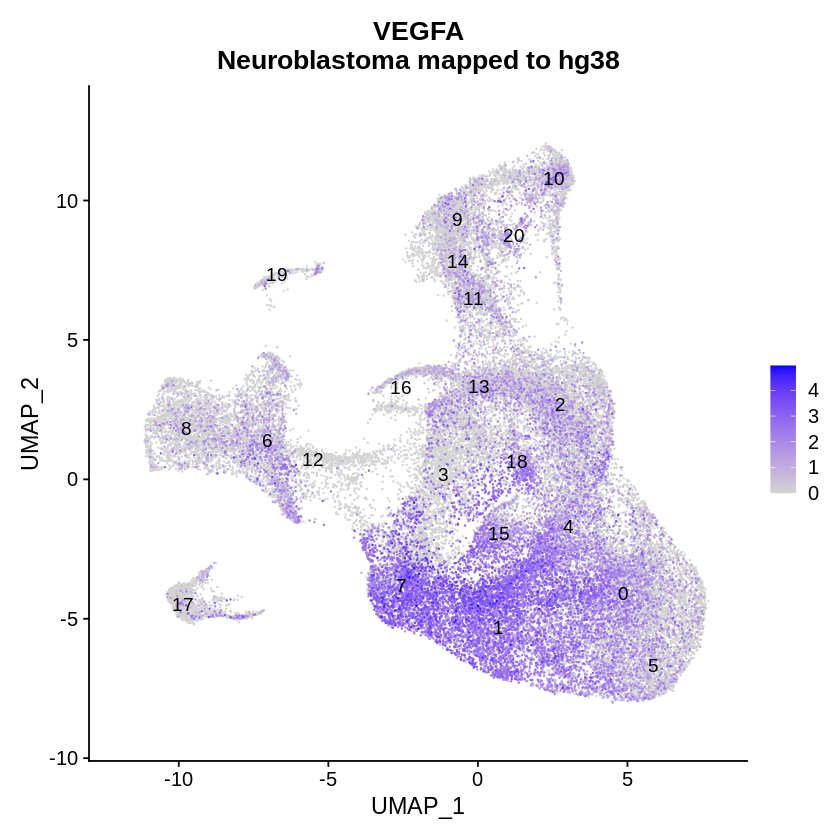

[1] "Current working directory: /scratch/samkyy/gete-gbm/results/2021-07-16"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-07-16' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-16"


png 
  2

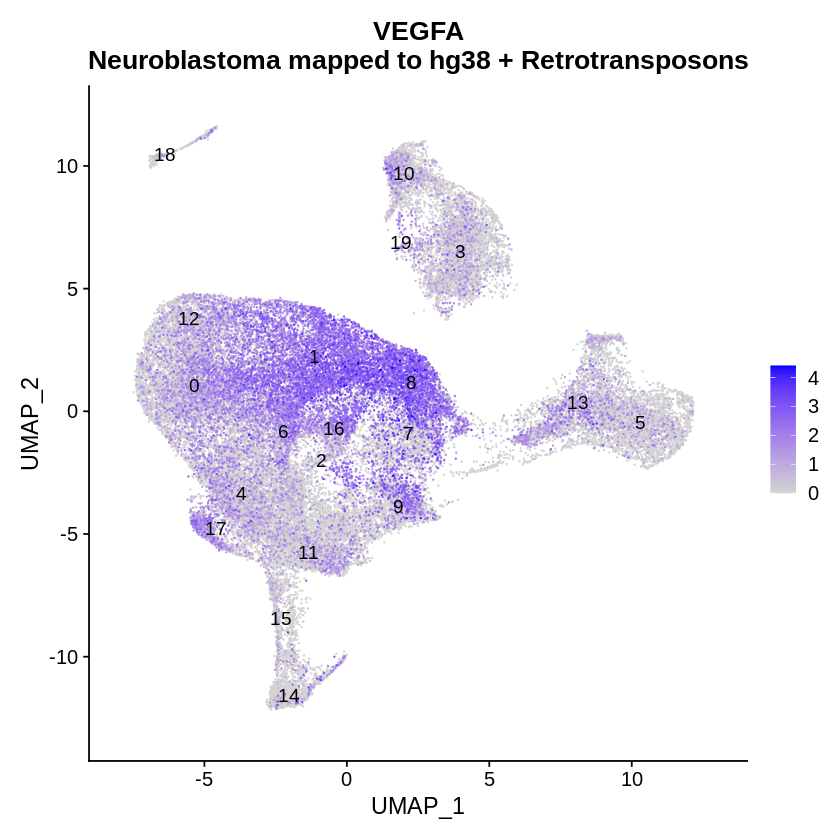

In [68]:
# Create UMAP with expression levels of genes: 'VEGFA', 'TET1', 'ESRRB', 'XRN2', 'SOD1'
p <- umapExpLvls(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), genes, titles )
p[[1]][[1]]
p[[1]][[2]]

# Save figures
mkdirToday()

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_umapVEGFA-TET1-ESRRB-XRN2-SOD1.pdf", width = size*2, height = size*5)
grid.arrange(
    p[[1]][[1]],p[[1]][[2]], p[[2]][[1]],p[[2]][[2]],  p[[3]][[1]],p[[3]][[2]],  
    p[[4]][[1]],p[[4]][[2]], p[[5]][[1]],p[[5]][[2]],
    layout_matrix = rbind(c(1, 2), c(3, 4), c(5, 6), c(7, 8), c(9, 10))
)
dev.off()

In [39]:
## Testing createDf function 
# c <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = TRUE)

Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of clusters:  21 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
GBM_ACCGTAATCACCTCGT-1 GBM_CAGATCATCCAGAAGG-1 GBM_GCGGGTTGTGTCGCTG-1 GBM_GGACAAGTCCTCAACC-1 GBM_AGTGTCAGTGAGTATA-2 GBM_GTATTCTGTATTACCG-2 
Number of clusters:  20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 
GBM_ACCGTAATCACCTCGT-1 GBM_CAGATCATCCAGAAGG-1 GBM_CAACCAACATGGTTGT-2 GBM_CACATTTTCTGAAAGA-3 GBM_CTTTGCGTCGAATGCT-3 GBM_TAGGCATCACACCGAC-3 
Genes:  VEGFA TET1 ESRRB XRN2 SOD1 


In [15]:
## Create dataframe with percentage of cells expressing grouped by cluster
df <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = TRUE)

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/expressionByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv", row.names=FALSE)

Genes:  VEGFA TET1 ESRRB XRN2 SOD1 
Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of clusters:  21 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Number of clusters:  20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 


Joining, by = c("map", "geneNames")



png 
  2

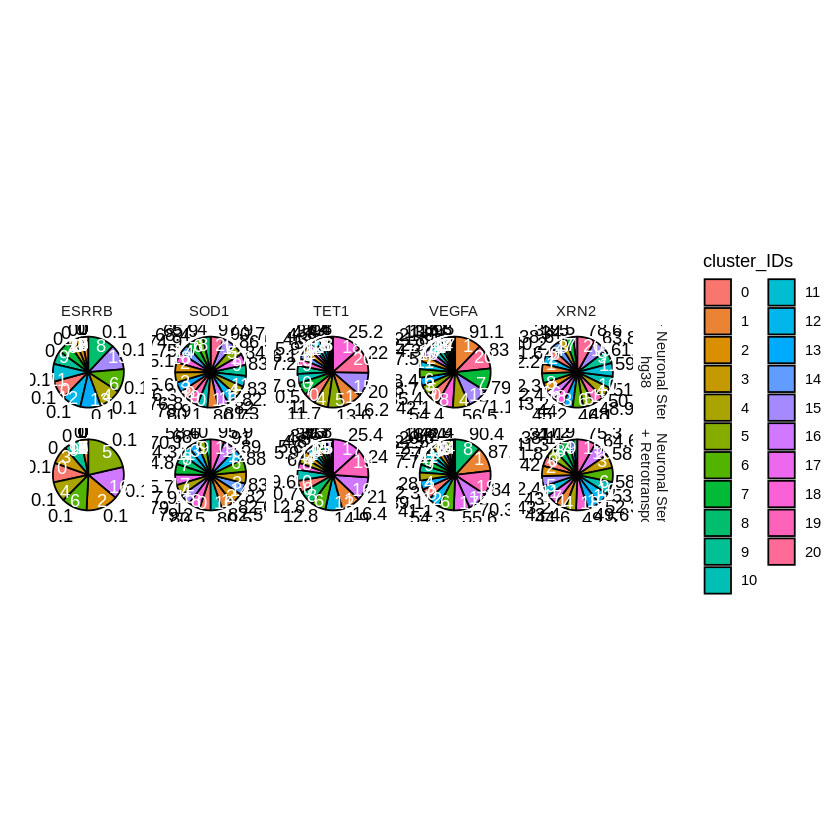

In [47]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

p <- pieByGene(df, by.cluster = TRUE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_clusterCompositionPIEVEGFA-TET1-ESRRB-XRN2-SOD1.pdf", width = size*4, height = size*1.5)
p
dev.off()

png 
  2

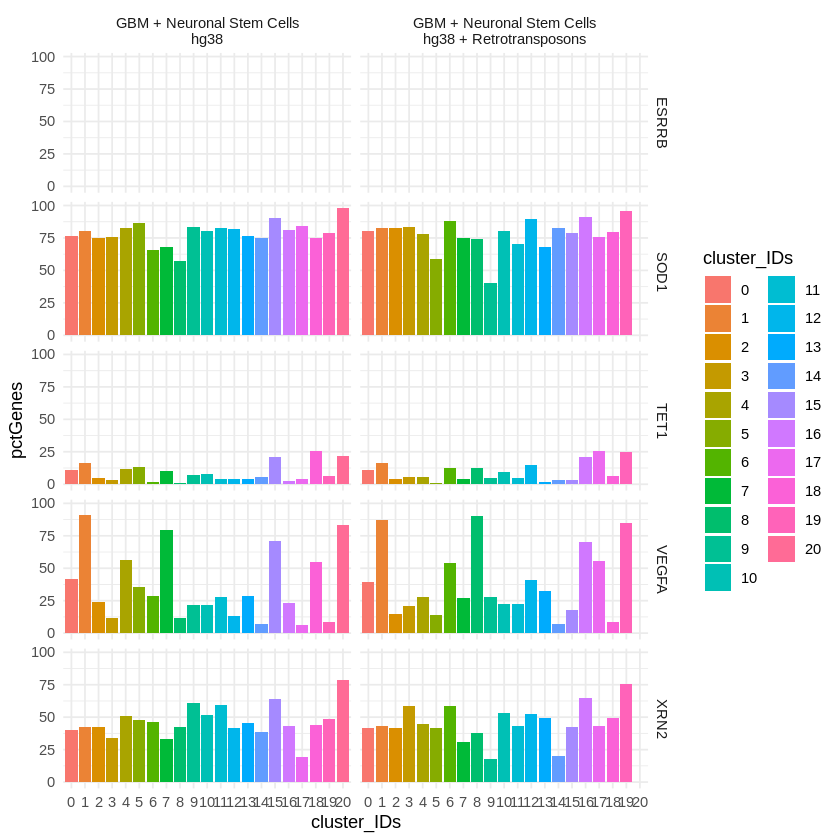

In [107]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

p <- barplotByGene(df, TRUE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_clusterCompositionBARVEGFA-TET1-ESRRB-XRN2-SOD1.pdf", 
    width = size*1.5, height = size*1.2)
p
dev.off()

In [68]:
## Create dataframe with percentage of cells expressing grouped by cluster
df <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = FALSE)

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/expressionBySampleVEGFA-TET1-ESRRB-XRN2-SOD1.csv", row.names=FALSE)

Genes:  VEGFA TET1 ESRRB XRN2 SOD1 
Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of samples:  9 
Sample names: 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 
Number of samples:  9 
Sample names: 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 


Joining, by = c("map", "geneNames")



png 
  2

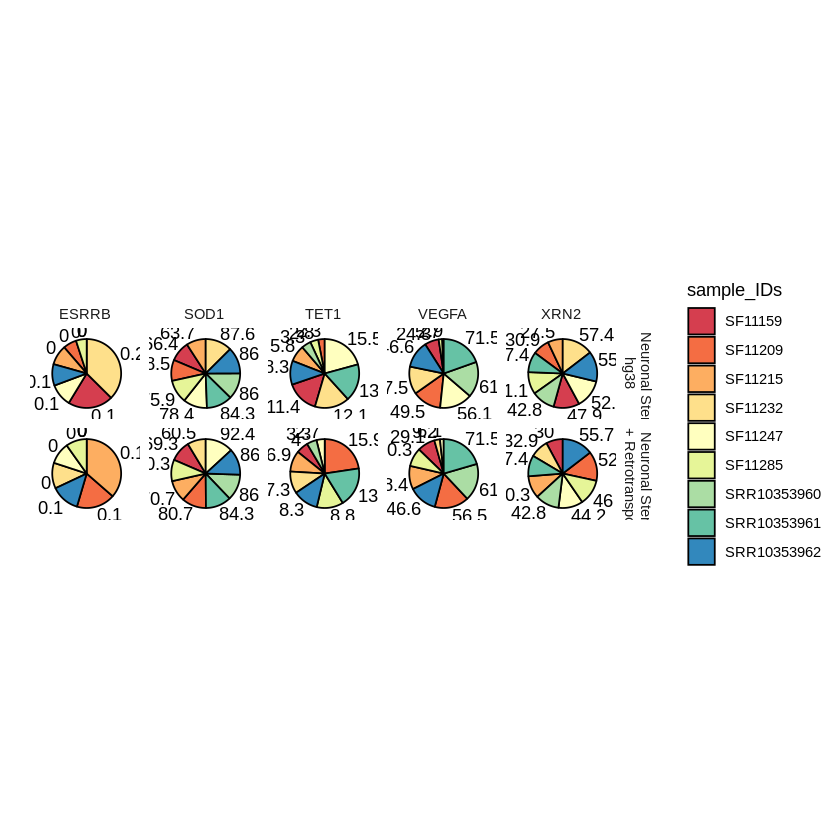

In [69]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionBySampleVEGFA-TET1-ESRRB-XRN2-SOD1.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$sample_IDs <- factor(df$sample_IDs, levels = sort(unique(df$sample_IDs)))

p <- pieByGene(df, by.cluster = FALSE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_sampleCompositionPIEVEGFA-TET1-ESRRB-XRN2-SOD1.pdf", width = size*4, height = size*1.5)
p
dev.off()

png 
  2

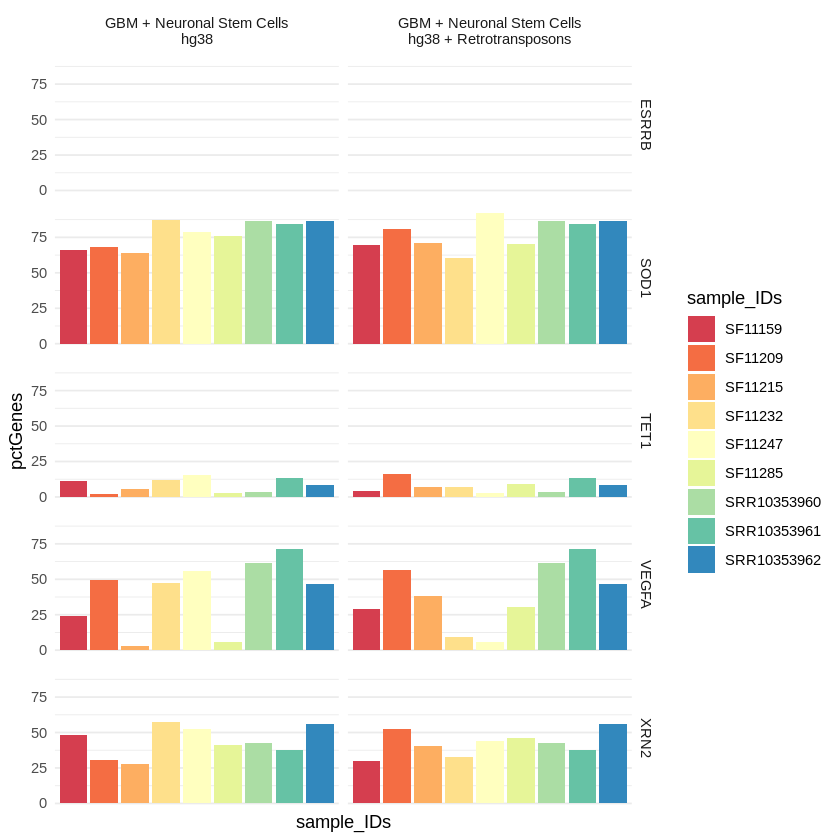

In [114]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionBySampleVEGFA-TET1-ESRRB-XRN2-SOD1.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$sample_IDs <- factor(df$sample_IDs, levels = sort(unique(df$sample_IDs)))

p <- barplotByGene(df, by.cluster = FALSE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_sampleCompositionBARVEGFA-TET1-ESRRB-XRN2-SOD1.pdf", 
    width = size*1.5, height = size*1.2)
p
dev.off()

### Redo Figures for CD133, MGMT, and GLAST 
2021-07-21:
- Pie Charts by cluster

In [54]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [55]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

In [67]:
source("~/scratch/gete-gbm/bin/util_viz.R")

In [70]:
genes <- c('PROM1', 'SLC1A3', 'MGMT') ## CD133, GLAST, MGMT
titles <- c("Neuroblastoma mapped to hg38", "Neuroblastoma mapped to hg38 + Retrotransposons")

In [71]:
## Create dataframe with percentage of cells expressing grouped by cluster
df <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = TRUE)

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/expressionByClusterCD133-GLAST-MGMT.csv", row.names=FALSE)

Genes:  PROM1 SLC1A3 MGMT 
Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of clusters:  21 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Number of clusters:  20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 


Joining, by = c("map", "geneNames")



png 
  2

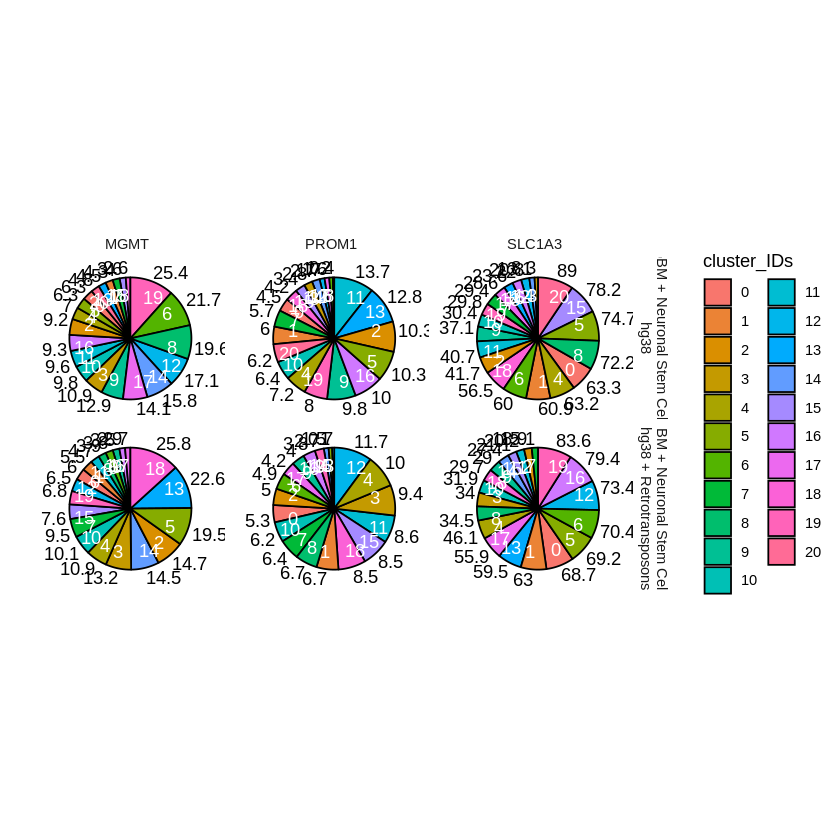

In [81]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionByClusterCD133-GLAST-MGMT.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

p <- pieByGene(df, by.cluster = TRUE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_clusterCompositionPIECD133-GLAST-MGMT.pdf", width = size*3, height = size*1.5)
p
dev.off()

### Create Figures for TUBB2B, HMGN2, NNAT, SLC25A6, NBEAL1, PLCG2, COX14 and CALCB by cluster & sample
2021-07-21:
- [x] Pie Charts by cluster and by sample
- [x] Bar Plots by cluster and by sample

In [54]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [55]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

In [75]:
## Are any of these genes within the top 2000 genes used to integrate the samples? 
match(c('TUBB2B', 'HMGN2', 'NNAT', 'SLC25A6', 'NBEAL1', 'PLCG2', 'COX14','CALCB'), 
      rownames(ge_gbm.sc.int.umap0.7@assays$integrated@data))
match(c('TUBB2B', 'HMGN2', 'NNAT', 'SLC25A6', 'NBEAL1', 'PLCG2', 'COX14','CALCB'), 
      rownames(gte_gbm.sc.int.umap0.7@assays$integrated@data))
        # no

## How many cells express each of these genes in the normalized expression matrix?
match(c('TUBB2B', 'HMGN2', 'NNAT', 'SLC25A6', 'NBEAL1', 'PLCG2', 'COX14','CALCB'), 
      rownames(ge_gbm.sc.int.umap0.7@assays$RNA@data))
match(c('TUBB2B', 'HMGN2', 'NNAT', 'SLC25A6', 'NBEAL1', 'PLCG2', 'COX14','CALCB'), 
      rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))

[1]  731  268  702   NA   NA  175   NA 1440

[1]  898  240  746   NA   NA  185   NA 1502

[1]  9675   511 28674 30230  4710 23788 18660 16616

[1]  9603   508 28458 30001  4687 23606 18518 16492

In [115]:
source("~/scratch/gete-gbm/bin/util_viz.R")

In [116]:
genes <- c('TUBB2B', 'HMGN2', 'NNAT', 'SLC25A6', 'NBEAL1', 'PLCG2', 'COX14','CALCB') ## CD133, GLAST, MGMT
titles <- c("Neuroblastoma mapped to hg38", "Neuroblastoma mapped to hg38 + Retrotransposons")

In [78]:
## Create dataframe with percentage of cells expressing grouped by cluster
df <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = TRUE)

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/expressionByClusterUniqueHumanOrganoidGenes.csv", row.names=FALSE)

Genes:  TUBB2B HMGN2 NNAT SLC25A6 NBEAL1 PLCG2 COX14 CALCB 
Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of clusters:  21 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 
Number of clusters:  20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 


Joining, by = c("map", "geneNames")



png 
  2

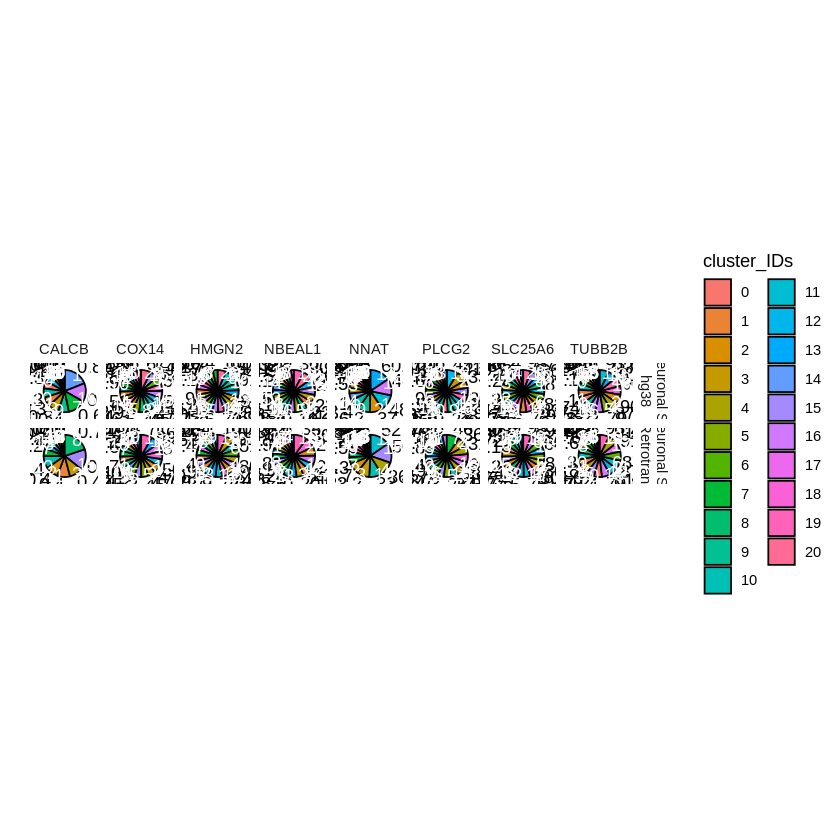

In [80]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionByClusterUniqueHumanOrganoidGenes.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

p <- pieByGene(df, by.cluster = TRUE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_clusterCompositionPIEUniqueHumanOrganoidGenes.pdf", 
    width = size*6, height = size*1.5)
p
dev.off()

png 
  2

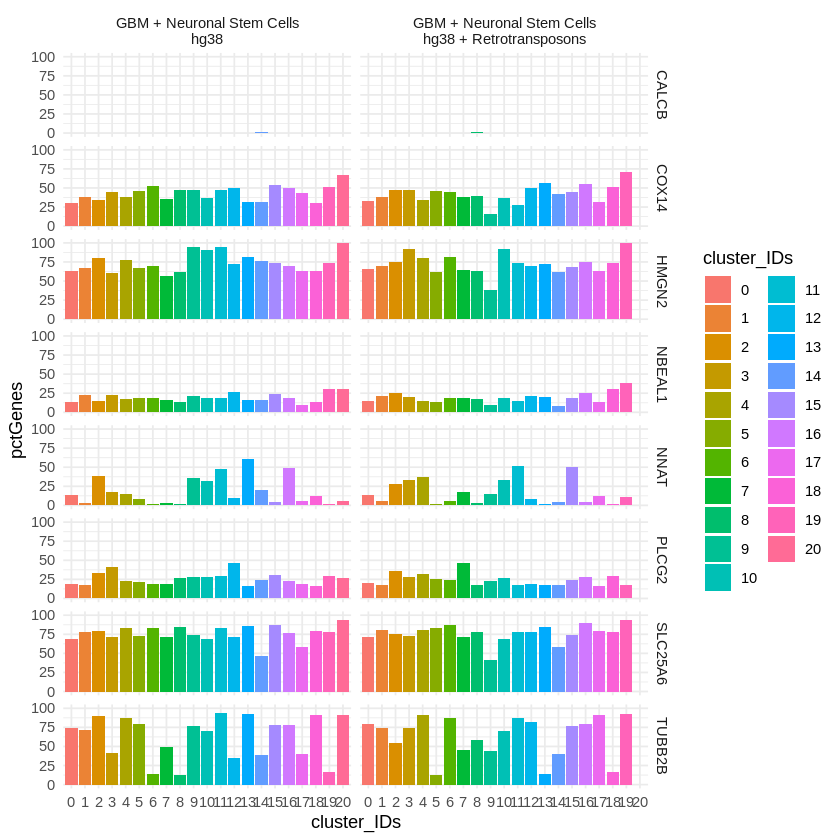

In [118]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionByClusterUniqueHumanOrganoidGenes.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

p <- barplotByGene(df, by.cluster = TRUE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_clusterCompositionBARUniqueHumanOrganoidGenes.pdf", 
    width = size*1.5, height = size*1.5)
p
dev.off()

In [82]:
## Create dataframe with percentage of cells expressing grouped by cluster
df <- createDF(list(ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7), c("GE", "GTE"), genes, by.cluster = FALSE)

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/expressionBySampleUniqueHumanOrganoidGenes.csv", row.names=FALSE)

Genes:  TUBB2B HMGN2 NNAT SLC25A6 NBEAL1 PLCG2 COX14 CALCB 
Number of seurat objects:  2 
Seurat Object names:  GE GTE 
Number of samples:  9 
Sample names: 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 
Number of samples:  9 
Sample names: 
 SF11159 SF11209 SF11215 SF11232 SF11247 SF11285 SRR10353960 SRR10353961 SRR10353962 


Joining, by = c("map", "geneNames")



png 
  2

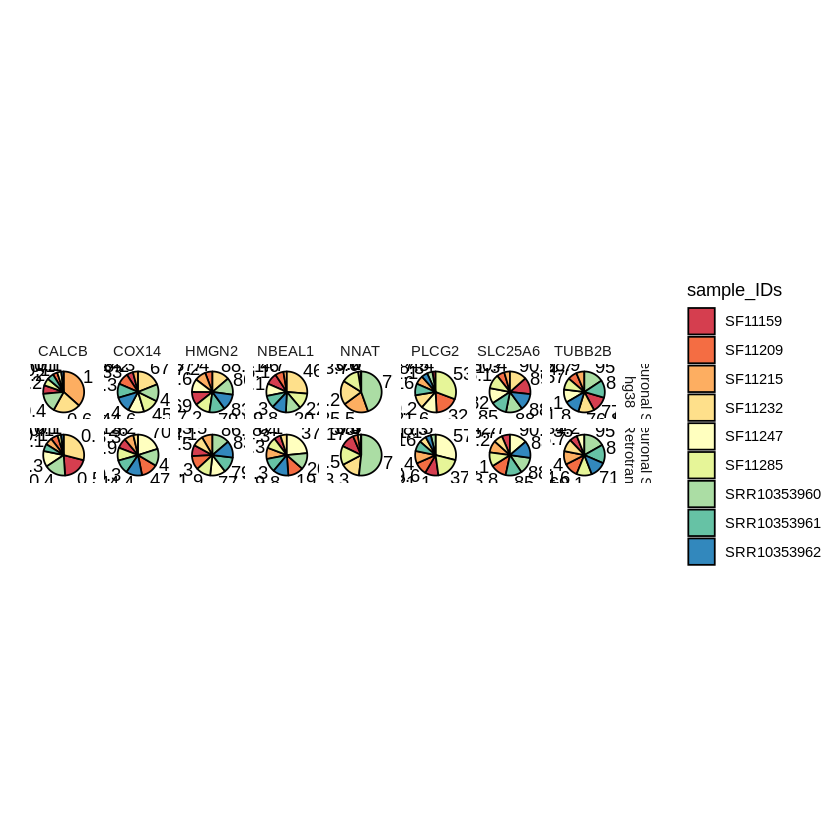

In [85]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionBySampleUniqueHumanOrganoidGenes.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$sample_IDs <- factor(df$sample_IDs, levels = sort(unique(df$sample_IDs)))

p <- pieByGene(df, by.cluster = FALSE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_sampleCompositionPIEUniqueHumanOrganoidGenes.pdf", 
    width = size*6, height = size*1.5)
p
dev.off()

png 
  2

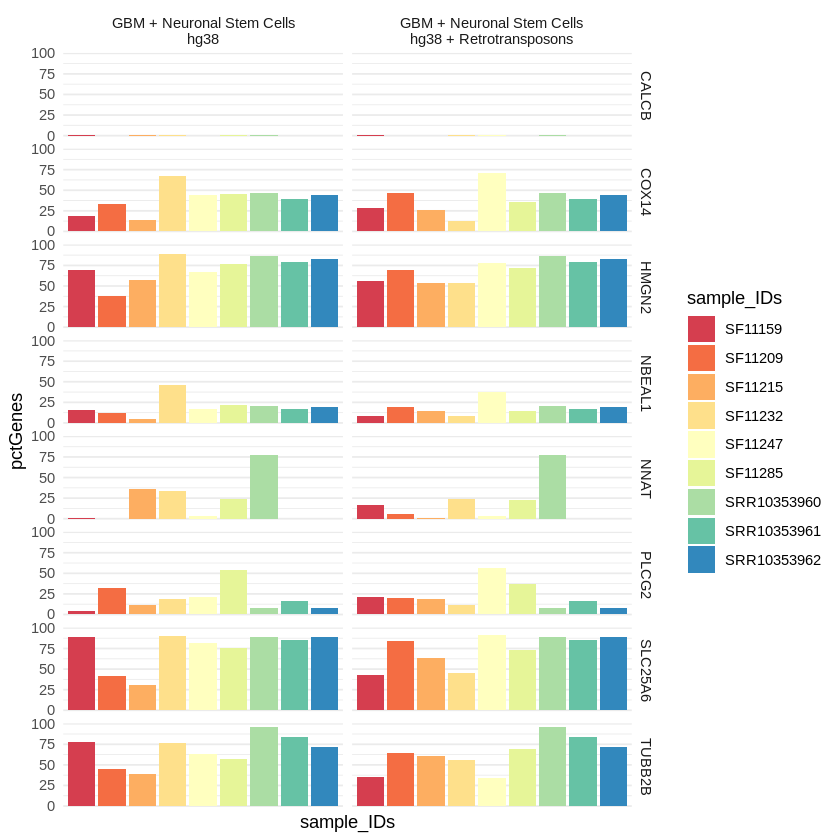

In [120]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/expressionBySampleUniqueHumanOrganoidGenes.csv")

## Factorize columns
df$map <- factor(df$map, levels=c("GE", "GTE"), 
                 label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$sample_IDs <- factor(df$sample_IDs, levels = sort(unique(df$sample_IDs)))

p <- barplotByGene(df, by.cluster = FALSE)
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-07-16/r_GBMSC_sampleCompositionBARUniqueHumanOrganoidGenes.pdf", 
    width = size*1.5, height = size*1.5)
p
dev.off()

## Percentage of Retrotransposons UMIs per cluster (Bar Plot) for Master Cancer Stem Cell enriched clusters
2021-07-21

In [127]:
## Obtain list of Retrotransposon genes and save as text file
library(rtracklayer)
gtf.file <- "~/projects/def-ytanaka/common/GRCh38_Ensembl_rmsk_TE_v23.gtf"
gtf.gr <- rtracklayer::import(gtf.file) # creates a GRanges object
gtf.df <- as.data.frame(gtf.gr)
genes <- unique(gtf.df[ ,c("gene_id", "class_id")])

library(data.table)
fwrite(genes, file="~/scratch/gete-gbm/data/geneName_TE_v23gtf.txt", sep=",")


Attaching package: 'data.table'


The following object is masked from 'package:SummarizedExperiment':

    shift


The following object is masked from 'package:GenomicRanges':

    shift


The following object is masked from 'package:IRanges':

    shift


The following objects are masked from 'package:S4Vectors':

    first, second


The following objects are masked from 'package:dplyr':

    between, first, last


The following object is masked from 'package:purrr':

    transpose




In [13]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [14]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

In [15]:
gte_gbm.sc.int.umap0.7@assays$RNA@data[
    which(as.vector(sapply("Plat", grepl, rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data)))),c(1:3)]
c <- as.vector(sapply("Plat", grepl, rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data)))
names(c)<- c(1:length(c))
c[which(c == TRUE)]
gte_gbm.sc.int.umap0.7@assays$RNA@data[c(31014, 31015),c(1:3)]

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
             0.4689859              1.4710987              0.0000000

31014 
 TRUE

2 x 3 sparse Matrix of class "dgCMatrix"
        GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1
Plat-L3              0.4689859               1.471099               .       
MLT1K                .                       .                      1.264858

Errors will be thrown if gene names do not match the row names of the count matrices, so replace underscores with dashes to match the names

In [17]:
te_genes <- read.table("~/scratch/gete-gbm/data/geneName_TE_v23gtf.txt", 
               sep=",", header = TRUE,
               col.names=c("gene_id", "TE_class"), 
               fill=FALSE, 
               strip.white=TRUE)

te_genes$gene_id <- sub("_", "-", te_genes$gene_id)
rownames(te_genes) <- te_genes$gene_id

dim(te_genes)
head(te_genes,10)

[1] 1180    2

,gene_id,TE_class
,<chr>,<chr>
TAR1,TAR1,Satellite
L1MC5a,L1MC5a,LINE
MER5B,MER5B,DNA
MIR3,MIR3,SINE
L2a,L2a,LINE
L3,L3,LINE
Plat-L3,Plat-L3,LINE
MLT1K,MLT1K,LTR
MIR,MIR,SINE


In [42]:
## TE genes not in Seurat object must be removed 

matched <- match(unique(te_genes$gene_id), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))
matched <- intersect(unique(te_genes$gene_id), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))
non.matched <- unique(te_genes$gene_id)[!unique(te_genes$gene_id) %in% matched]
non.matched
length(non.matched)

[1] "L4-B_Mam"      "L4-A_Mam"      "L4-C_Mam"      "UCON88"       
 [5] "UCON57"        "UCON85"        "MER133A"       "UCON41"       
 [9] "UCON59"        "L2-3-AMi"      "UCON71"        "Chompy-7-Croc"
[13] "Chompy-6-Croc" "UCON100"       "HERV-Fc2-int"  "UCON56"       
[17] "UCON87"        "UCON68"        "UCON92"        "HSAT6"

[1] 20

In [43]:
dim(te_genes[!rownames(te_genes) %in% (non.matched),])
te_genes <- te_genes[!rownames(te_genes) %in% (non.matched),]

[1] 1160    2

In [140]:
gte_gbm.sc.int.umap0.7@assays$RNA@data['TAR1',c(1:2)] 
gte_gbm.sc.int.umap0.7@assays$RNA@data['SAR',c(1:2)] 

match(c('TAR1', 'SAR'), rownames(gte_gbm.sc.int.umap0.7@assays$RNA@data))
match(c('TAR1', 'SAR'), rownames(gte_gbm.sc.int.umap0.7@assays$integrated@data))

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
             0.4689859              0.0000000

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 
                     0                      0

[1] 31008 32165

[1] NA NA

In [45]:
cellsbycluster <- extractCellsbyCluster(list(gte_gbm.sc.int.umap0.7), "GTE")

Number of seurat objects:  1 
Seurat Object names:  GTE 
Number of clusters:  20 
Cluster names: 
 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 


In [53]:
## Create dataframe of pctTEGeness & pctTEUMIs expressed in each cluster

for(i in 1:length(cellsbycluster)) { ## rbind df for each seurat object

    df <- data.frame( map = rep( names(cellsbycluster)[i], each = length(cellsbycluster[[i]]) ),
                          cluster_IDs = names( cellsbycluster[[i]] ))

    nGenes <- c()
    nUMI <- c()
    nTEGenes <- c()
    nTEUMI <- c()
    

    for (j in 1:length(cellsbycluster[[i]]) ) { ## extract num cells expressing given gene

        nGenes <- c(nGenes, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ ,cellsbycluster[[i]][[j]] ]>0))
        nUMI <- c(nUMI, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ ,cellsbycluster[[i]][[j]] ]))
        nTEGenes <- c(nTEGenes, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ te_genes$gene_id, cellsbycluster[[i]][[j]] ]>0))
        nTEUMI <- c(nTEUMI, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ te_genes$gene_id, cellsbycluster[[i]][[j]] ]))

    } ## End of loop for each each cluster/sample
    df$nGenes <- nGenes
    df$nUMI <- nUMI
    df$nTEGenes <- nTEGenes
    df$nTEUMI <- nTEUMI
    
    df$pctTEGenes <- df$nTEGenes/df$nGenes*100
    df$pctTEUMI <- df$nTEUMI/df$nUMI*100

} ## End loop for each seurat object
df

write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/TEexprByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv", row.names=FALSE)

map,cluster_IDs,nGenes,nUMI,nTEGenes,nTEUMI,pctTEGenes,pctTEUMI
<chr>,<chr>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>
GTE,0,13117849,15709033,1264055,2146986.49,9.636145,13.66721
GTE,1,13114293,14186570,1099736,1667954.83,8.385782,11.75728
GTE,2,9856637,10940370,989012,1533032.71,10.033970,14.01262
GTE,3,11478841,11724297,930733,1384112.14,8.108249,11.80550
GTE,4,9173324,10781825,823392,1373787.96,8.975939,12.74170
GTE,5,5645847,7535899,582856,1028440.20,10.323624,13.64721
GTE,6,8236072,8752079,661561,988243.84,8.032482,11.29153
GTE,7,4766720,6162416,532953,941219.76,11.180707,15.27355
GTE,8,4715582,5831881,417762,696226.47,8.859182,11.93828


In [10]:
df <- read.csv("~/scratch/gete-gbm/results/2021-07-16/TEexprByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv")
df$map <- factor(df$map, levels=c("GE", "GTE"), label=c("GBM + Neuronal Stem Cells\nhg38", "GBM + Neuronal Stem Cells\nhg38 + Retrotransposons"))
df$cluster_IDs <- factor(df$cluster_IDs, levels = sort(c(0:20)))

png 
  2

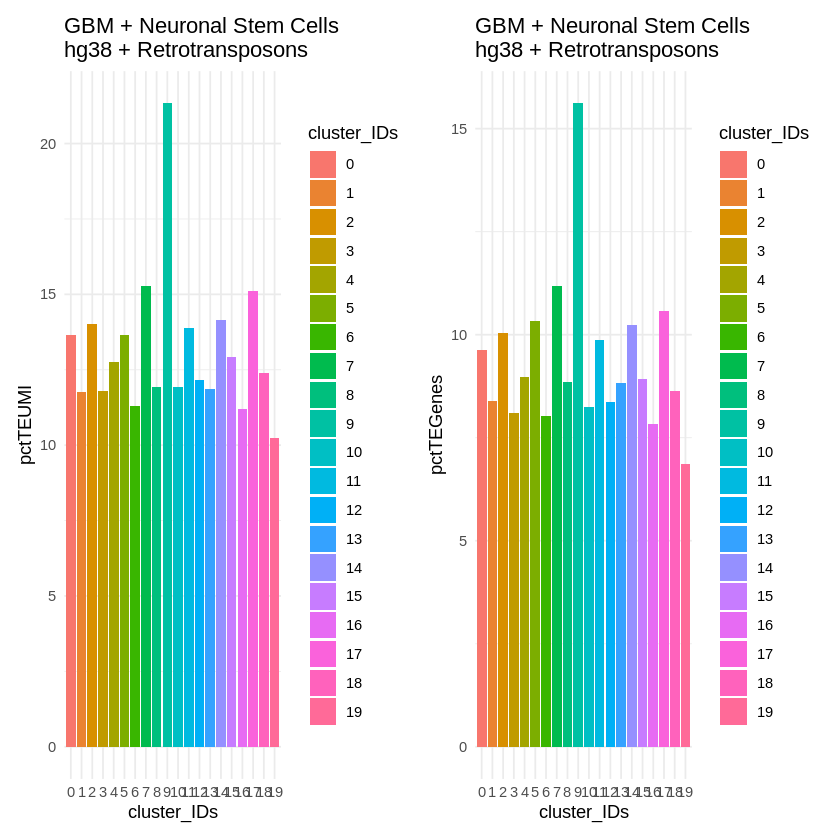

In [16]:
## Create Bar Plot
p <- ggplot(data = df, aes(x = cluster_IDs, y = pctTEUMI, fill = cluster_IDs)) + geom_col() +
    scale_colour_gradientn(colours=rainbow(21)) + 
    theme_minimal() + ggtitle("GBM + Neuronal Stem Cells\nhg38 + Retrotransposons")
p2 <- ggplot(data = df, aes(x = cluster_IDs, y = pctTEGenes, fill = cluster_IDs)) + geom_col() +
    scale_colour_gradientn(colours=rainbow(21)) + 
    theme_minimal() + ggtitle("GBM + Neuronal Stem Cells\nhg38 + Retrotransposons")
p+p2
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-07-22/r_GBMSC_clusterCompositionBAR_TEgenes.pdf", 
    width = size*2, height = size)
grid.arrange(p, p2, nrow = 1)
dev.off()

### (Need to Optimize) % of Retrotransposon UMI per Retrotransposon Gene

In [56]:
TE_df <- data.frame(matrix(,nrow=0,ncol=7))
colnames(TE_df) <- c("map","cluster_IDs", "geneNames", "nCells", "nGenes", "nUMI", "nTEUMI")

for(gene in 1:length(te_genes$gene_id)) { ## loop for each gene passed into the function
    for(i in 1:length(cellsbycluster)) { ## rbind df for each seurat object

        cat("Computing Cluster: ", i-1, "\n")
        
        df <- data.frame( map = rep( names(cellsbycluster)[i], each = length(cellsbycluster[[i]]) ),
                              cluster_IDs = names( cellsbycluster[[i]] ),
                              geneNames = rep( te_genes$gene_id[gene], each=length( cellsbycluster[[i]] ) ),
                              nCells = unlist(lapply(cellsbycluster[[i]],length)) )  # num Cells expressing given gene
        nGene <- c()
        nUMI <- c()
        nTEUMI <- c()

        for (j in 1:length(cellsbycluster[[i]]) ) { 
            
            ## extract num cells expressing given gene in a given cluster
            nGene <- c(nGene, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ te_genes$gene_id[gene],
                                                                         cellsbycluster[[i]][[j]] ]>0))
            
            ## extract total UMI in all genes in a given cluster
            nUMI <- c(nUMI, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ ,cellsbycluster[[i]][[j]] ]))
            
            ## extract num UMI for a given gene in a given cluster 
            nTEUMI <- c(nTEUMI, sum(gte_gbm.sc.int.umap0.7@assays$RNA@data[ te_genes$gene_id[gene], 
                                                                           cellsbycluster[[i]][[j]] ]))

        } ## End of loop for each each cluster/sample
        df$nGenes <- nGene
        df$nUMI <- nUMI
        df$nTEUMI <- nTEUMI
        
        TE_df <- rbind (TE_df, df) #store in results object

    } ## End loop for each seurat object
} ## End loop for each gene

TE_df$pctTE <- TE_df$nGenes/TE_df$nCells*100 ## percentage of cells expressing TE gene
TE_df$pctTEUMI <- TE_df$nTEUMI/TE_df$nUMI*100 ## percentage of UMI that are TE genes

cat("TE_df complete\n")

In [57]:
rm(TE_df)
rm(nGene)
rm(nUMI)
rm(nTEUMI)

In [ ]:
df
write.csv(df, file="~/scratch/gete-gbm/results/2021-07-16/TEexprUMI-ByClusterVEGFA-TET1-ESRRB-XRN2-SOD1.csv", row.names=FALSE)

## GSEA (test code)
see gete-gbm/data/2021-07-09_gsea/README.md

2021-07-08:

In [17]:
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [21]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "RNA"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "RNA"

ge_gbm.sc.int.umap0.7@assays$RNA[5,5]
gte_gbm.sc.int.umap0.7@assays$RNA[5,5]

dim(ge_gbm.sc.int.umap0.7)
dim(gte_gbm.sc.int.umap0.7)

1 x 1 sparse Matrix of class "dgCMatrix"
           GBM_AAACGGGTCGAATGGG-1
AP006222.2                      .

1 x 1 sparse Matrix of class "dgCMatrix"
           GBM_AAACGGGTCGAATGGG-1
AP006222.2                      .

[1] 31527 49670

[1] 32501 49670

In [23]:
ge_gbm.sc.int.umap0.7@assays$RNA@data[5,5]

[1] 0

In [28]:
as.character(sort(unique(ge_gbm.sc.int.umap0.7$seurat_clusters)))

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20"

In [40]:
summary(colnames(ge_gbm.sc.int.umap0.7@assays$RNA@data) == rownames(ge_gbm.sc.int.umap0.7@meta.data))

   Mode    TRUE 
logical   49670 

In [42]:
ge_gbm.sc.int.umap0.7@assays$RNA@data@Dim[1]
length(rownames(ge_gbm.sc.int.umap0.7@assays$RNA@data))

[1] 31527

[1] 31527

## GSEA (Analysis)
2021-07-27:

In [35]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [138]:
df <- read.table(file = "~/scratch/gete-gbm/results/GBMSC_GSEA-jul09/gseaResults.tsv", 
                 header = TRUE, sep = "\t")
df <- df[,1:(length(df)-2)]
head(df)

,map,cluster,NAME,SIZE,ES,NES,NOM.p.val,FDR.q.val,FWER.p.val,RANK.AT.MAX
,<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,GE,cluster0,WANG_GLIOBLASTOMA_CLASSICAL,46,0.6932787,2.0068355,0.0000000,0.000000000,0.000,6121
2,GE,cluster0,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.5877531,1.9479040,0.0000000,0.000000000,0.000,7920
3,GE,cluster10,WANG_GLIOBLASTOMA_PRONEURAL,46,0.5811046,1.5459605,0.0136646,0.009916666,0.035,7010
4,GE,cluster11,WANG_GLIOBLASTOMA_PRONEURAL,46,0.6804321,1.5923240,0.0000000,0.000000000,0.000,6833
5,GE,cluster11,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.2303068,0.5762713,0.9990000,0.992250000,1.000,10271
6,GE,cluster12,WANG_GLIOBLASTOMA_MESENCHYMAL,50,0.3805243,1.1611934,0.2160494,0.176169620,0.207,3505


In [139]:
# factor columns
df$map <- factor(df$map, levels=c("GE", "GTE"), labels = c("hg38", "hg38+Retrotransposon"))
df$cluster <- factor(df$cluster, levels=paste0("cluster",c(0:20)))
df$NAME <- factor(df$NAME, levels=sort(unique(df$NAME)))
head(df)

,map,cluster,NAME,SIZE,ES,NES,NOM.p.val,FDR.q.val,FWER.p.val,RANK.AT.MAX
,<fct>,<fct>,<fct>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,hg38,cluster0,WANG_GLIOBLASTOMA_CLASSICAL,46,0.6932787,2.0068355,0.0000000,0.000000000,0.000,6121
2,hg38,cluster0,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.5877531,1.9479040,0.0000000,0.000000000,0.000,7920
3,hg38,cluster10,WANG_GLIOBLASTOMA_PRONEURAL,46,0.5811046,1.5459605,0.0136646,0.009916666,0.035,7010
4,hg38,cluster11,WANG_GLIOBLASTOMA_PRONEURAL,46,0.6804321,1.5923240,0.0000000,0.000000000,0.000,6833
5,hg38,cluster11,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.2303068,0.5762713,0.9990000,0.992250000,1.000,10271
6,hg38,cluster12,WANG_GLIOBLASTOMA_MESENCHYMAL,50,0.3805243,1.1611934,0.2160494,0.176169620,0.207,3505


In [140]:
p <- df %>% 
    ggplot(aes(x = cluster, y = ES, fill = FDR.q.val)) + geom_bar(stat="identity",color="black") +
    scale_fill_gradient(low="black", high="white") + theme_minimal() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) + facet_grid(map ~ NAME)

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-jul09/GBMSC_gsea_BARplot.pdf", 
    width = size*2, height = size*1)
grid.arrange(p, nrow = 1, top="GSEA Results")
dev.off()

png 
  2

In [150]:
p <- df %>% dplyr::filter(FDR.q.val <= 0.05 ) %>%
    ggplot(aes(x = cluster, y = ES, fill = map)) + geom_col() +
    theme_minimal() + facet_grid(~ NAME) +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-jul09/GBMSC_gsea_BARcolbyMap.pdf", 
    width = size*2, height = size*1)
grid.arrange(p, nrow = 1, top="GSEA Results")
dev.off()

png 
  2

In [131]:
## Initial Interpretation of GSEA results
ge_gsea <- c('0'="Classical", ## Verhaak, Wang
             '1'="Classical-Mesenchymal", ## Verhaak, Wang
             '2'="Proneural", ## Verhaak Classical lower FDR.q.val, 
             '3'="Proneural", ## Wang (ES score is low, but p.adj is appropriate)
             '4'="Classical", ## Verhaak, Wang
             '5'="Classical", ## Verhaak, Wang, Mesenchymal(p.adj=1.00)
             '6'="Mesenchymal", ## Wang
             '7'="NA", ## Wang-Mesenchymal (p.adj>0.05)
             '8'="Mesenchymal", ## Wang
             '9'="Proneural", ## Wang
             '10'="Proneural", ## Wang
             '11'="Proneural", ## Wang
             '12'="NA", ## Wang-Mesenchymal (p.adj > 0.05)
             '13'="Proneural", ## Wang
             '14'="NA", ## 
             '15'="Classical-Mesenchymal", ## Verhaak, Wang (Wang-Mesenchymal p.adj<0.05)
             '16'="Proneural", ## Wang
             '17'="NA", ## Wang-Proneural (p.adj>0.05)
             '18'="NA", ## Verhaak,Wang (p.adj>0.05)
             '19'="Mesenchymal", ## Wang
             '20'="Classical" ## Verhaak, Wang
            )

gte_gsea <- c('0'="Classical", ## Verhaak, Wang
             '1'="Classical-Mesenchymal", ## Verhaak, Wang (Wang-Mesenchymal p.adj<0.05) 
             '2'="Proneural", ## Wang
             '3'="Proneural", ## Wang
             '4'="Proneural", ## Wang, (Verhaaak-Wang-Classical p.adj>0.05)
             '5'="Mesenchymal", ## Wang
             '6'="Classical", ## Verhaak, Wang
             '7'="NA", ## Wang-Proneural (p.adj>0.05)
             '8'="NA", ## Verhaak-Classical p.adj>0.05, Wang-Mesenchymal p.adj>0.05
             '9'="NA", ## Wang-Proneural p.adj>0.05
             '10'="Proneural", ## Wang
             '11'="Proneural", ## Wang
             '12'="Classical", ## Wang, Verhaak-Classical p.adj >0.05, Mesenchymal p.adj>0.05
             '13'="Mesenchymal", ## Wang
             '14'="NA", ## Wang-Proneural (p.adj>0.05)
             '15'="Proneural", ## Wang
             '16'="Classical", ## Verhaak,Wang, Wang-Mesenchymal p.adj>0.05
             '17'="NA", ## Verhaak-Wang-Classical p.adj>0.05, Wang-Proneural p.adj>0.05
             '18'="NA", ## Wang-Mesenchymal p.adj >0.05
             '19'="Mesenchymal" ## Wang, Verhaak-Wang-Classical p.adj>0.05
            )

In [136]:
## add metadata to seurat object
ge_gbm.sc.int.umap0.7$gbm_subtype <- NA
gte_gbm.sc.int.umap0.7$gbm_subtype <- NA

for (i in 1:length(ge_gsea)) {
    ge_gbm.sc.int.umap0.7$gbm_subtype[
        which(as.character(ge_gbm.sc.int.umap0.7$seurat_clusters) == names(ge_gsea[i]))]  <- ge_gsea[i]
}
head(ge_gbm.sc.int.umap0.7@meta.data)

for (i in 1:length(gte_gsea)) {
    gte_gbm.sc.int.umap0.7$gbm_subtype[
        which(as.character(gte_gbm.sc.int.umap0.7$seurat_clusters) == names(gte_gsea[i]))]  <- gte_gsea[i]
}
head(gte_gbm.sc.int.umap0.7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7,GBM1,0,0,1,1,TRUE,SF11159,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3,GBM1,0,0,8,8,TRUE,SF11159,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14,GBM1,0,0,0,0,TRUE,SF11159,Classical


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,3,GBM1,0,0,1,1,TRUE,SF11232,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,4,GBM1,0,0,5,5,TRUE,SF11232,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,0,GBM1,0,0,0,0,TRUE,SF11232,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,0,GBM1,0,0,0,0,TRUE,SF11232,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,0,GBM1,0,0,2,2,TRUE,SF11232,Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,8,GBM1,0,0,4,4,TRUE,SF11232,Proneural


In [155]:
p <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("GSEA Results\nhg38")
p2 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("GSEA Results\nhg38+Retrotransposon")
p+p2

p3 <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE)
p4 <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) 
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-jul09/GBMSC_gsea_UMAP.pdf", 
    width = size*2, height = size*1.5)
grid.arrange(p,p2,p3,p4, nrow = 2, top="GSEA Results")
dev.off()

png 
  2

In [156]:
## save seurat_objets
mkdirToday()
save(ge_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-27/ge_gbm.sc.int.umap0.7_gsea.RData")
save(gte_gbm.sc.int.umap0.7, file="~/scratch/gete-gbm/results/2021-07-27/gte_gbm.sc.int.umap0.7_gsea.RData")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-27"


## Trajectory Analysis (ignore)

In [13]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [26]:
##Call the commands below with the following structure whenever I want to auto-select a funtion from a specific package:
library(conflicted)
conflict_prefer("select", "dplyr") ## required in %>% dplyr
# conflict_prefer("rowRanges", "matrixStats")
conflict_prefer("rowRanges", "MatrixGenerics") ## required in new_cell_data_set()

[conflicted] Removing existing preference

[conflicted] Will prefer dplyr::select over any other package

[conflicted] Removing existing preference

[conflicted] Will prefer MatrixGenerics::rowRanges over any other package



In [40]:
ge_data <- as(as.matrix(GetAssayData(ge_gbm.sc.int.umap0.7, 
                                  assay = "integrated", slot = "scale.data")), 'sparseMatrix')
gte_data <- as(as.matrix(GetAssayData(gte_gbm.sc.int.umap0.7, 
                                  assay = "integrated", slot = "scale.data")), 'sparseMatrix')

In [41]:
ge_meta <- data.frame(ge_gbm.sc.int.umap0.7@meta.data)
gte_meta <- data.frame(gte_gbm.sc.int.umap0.7@meta.data)

In [42]:
#keep only the columns that are relevant  
ge_pData <- ge_meta %>% select(orig.ident, nCount_RNA, nFeature_RNA, sampleCombined, seurat_clusters)  
ge_fData <- data.frame(gene_short_name = row.names(ge_data), row.names = row.names(ge_data))

gte_pData <- gte_meta %>% select(orig.ident, nCount_RNA, nFeature_RNA, sampleCombined, seurat_clusters)  
gte_fData <- data.frame(gene_short_name = row.names(gte_data), row.names = row.names(gte_data))

In [43]:
#Construct monocle cds  
ge_monocle <- new_cell_data_set(expression_data = ge_data, cell_metadata = ge_pData, gene_metadata = ge_fData)  
gte_monocle <- new_cell_data_set(expression_data = gte_data, cell_metadata = gte_pData, gene_metadata = gte_fData) 

Warning message in log(cell_total):
"NaNs produced"
Warning message in log(cell_total):
"NaNs produced"


In [44]:
#preprocess (normalize)
ge_monocle = preprocess_cds(ge_monocle, num_dim = 100, norm_method = "size_only", pseudo_count = 0)  
gte_monocle = preprocess_cds(gte_monocle, num_dim = 100, norm_method = "size_only", pseudo_count = 0)  

#skip batch effect removal because it is already complete via Seurat

In [45]:
#Reduce dimensions using UMAP 
ge_monocle = reduce_dimension(ge_monocle) 
gte_monocle = reduce_dimension(gte_monocle) 
#skip cell clustering because labels are maintained. 

No preprocess_method specified, using preprocess_method = 'PCA'

No preprocess_method specified, using preprocess_method = 'PCA'



In [46]:
#cell clustering is required
## Step 4: Cluster the cells
ge_monocle <- cluster_cells(ge_monocle)
gte_monocle <- cluster_cells(gte_monocle)

No trajectory to plot. Has learn_graph() been called yet?



[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-07-23"


png 
  2

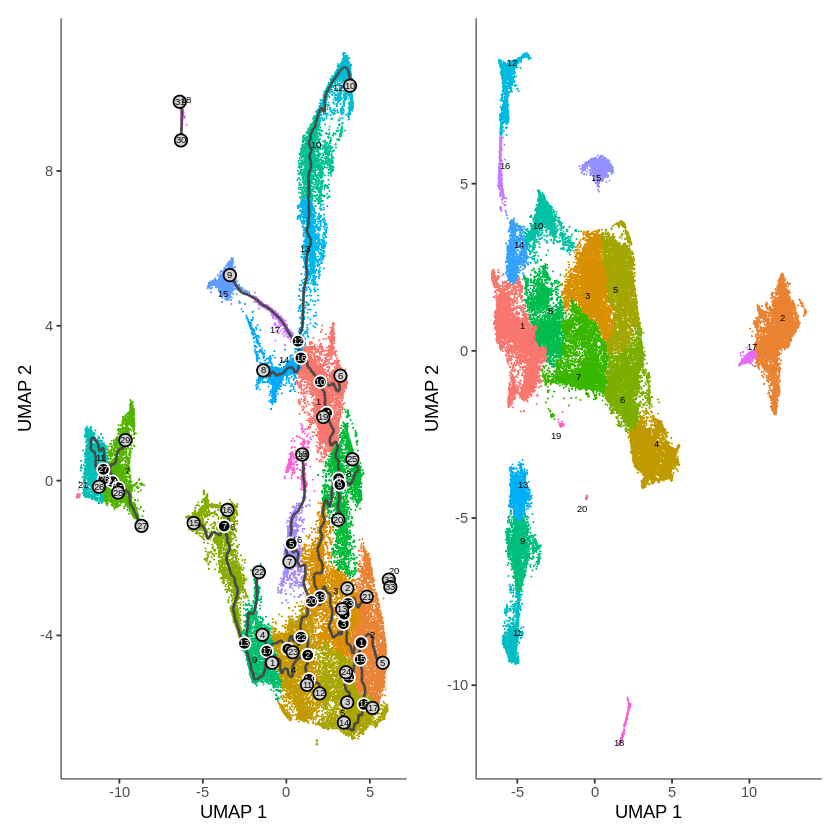

In [54]:
p <- plot_cells(ge_monocle)
p2 <- plot_cells(gte_monocle)
p + p2
# Save figures

mkdirToday()
size = 7
pdf("~/scratch/gete-gbm/results/2021-07-23/r_GBMSC_MonocleUMAPs.pdf", 
    width = size*2, height = size)
grid.arrange(p, p2, nrow = 1)
dev.off()

In [47]:
#map pseudotime  
ge_monocle = learn_graph(ge_monocle)
ge_monocle = order_cells(ge_monocle, reduction_method = "UMAP")  
plot_cells(ge_monocle, color_cells_by = "pseudotime")

gte_monocle = learn_graph(gte_monocle)  
gte_monocle = order_cells(gte_monocle, reduction_method = "UMAP")  
plot_cells(gte_monocle, color_cells_by = "pseudotime")

  |======================================================================| 100%
  |======================================================================| 100%


ERROR: Error: When not in interactive mode, either root_pr_nodes or root_cells must be provided.


In [ ]:
mkdirToday()
save(ge_monocle, file="~/scratch/gete-gbm/results/2021-07-23/ge_monocle.RData")
save(ge_monocle, file="~/scratch/gete-gbm/results/2021-07-23/gte_monocle.RData")

## Trajectory Analysis 
2021-08-04:

In [8]:
source("~/scratch/gete-gbm/bin/util_monocle3.R") 
# don't load the libraries in the first section until this is run first, because the libraries will conflict. 

In [4]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [11]:
### Use Seurat Wrapper
DefaultAssay(ge_gbm.sc.int.umap0.7)
DefaultAssay(gte_gbm.sc.int.umap0.7)

[1] "RNA"

[1] "RNA"

In [12]:
DefaultAssay(ge_gbm.sc.int.umap0.7) <- "integrated"
DefaultAssay(gte_gbm.sc.int.umap0.7) <- "integrated"

cds_ge <- as.cell_data_set(ge_gbm.sc.int.umap0.7)
cds_gte <- as.cell_data_set(gte_gbm.sc.int.umap0.7)

## Group cells into clusters
cds_ge <- cluster_cells(cds_ge)
cds_gte <- cluster_cells(cds_gte)

Warning message:
"Monocle 3 trajectories require cluster partitions, which Seurat does not calculate. Please run 'cluster_cells' on your cell_data_set object"
Warning message:
"Monocle 3 trajectories require cluster partitions, which Seurat does not calculate. Please run 'cluster_cells' on your cell_data_set object"


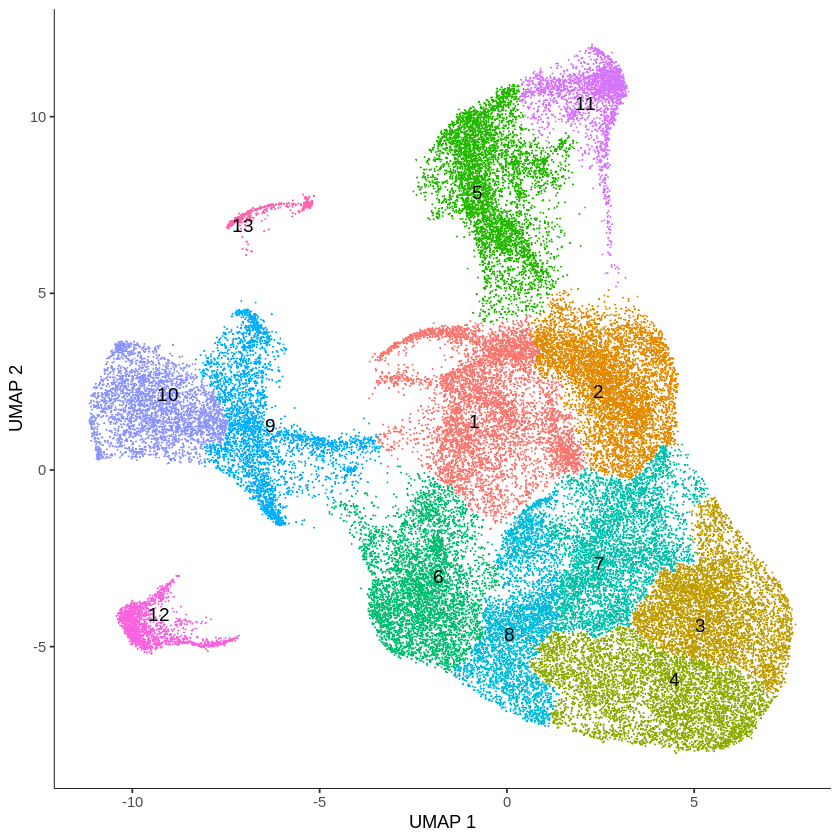

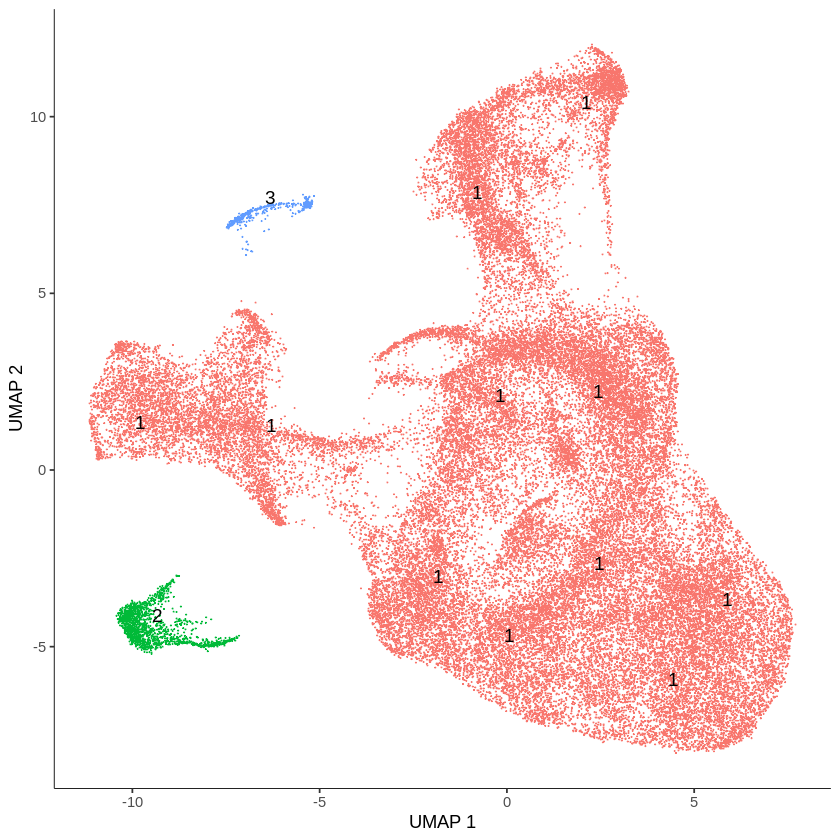

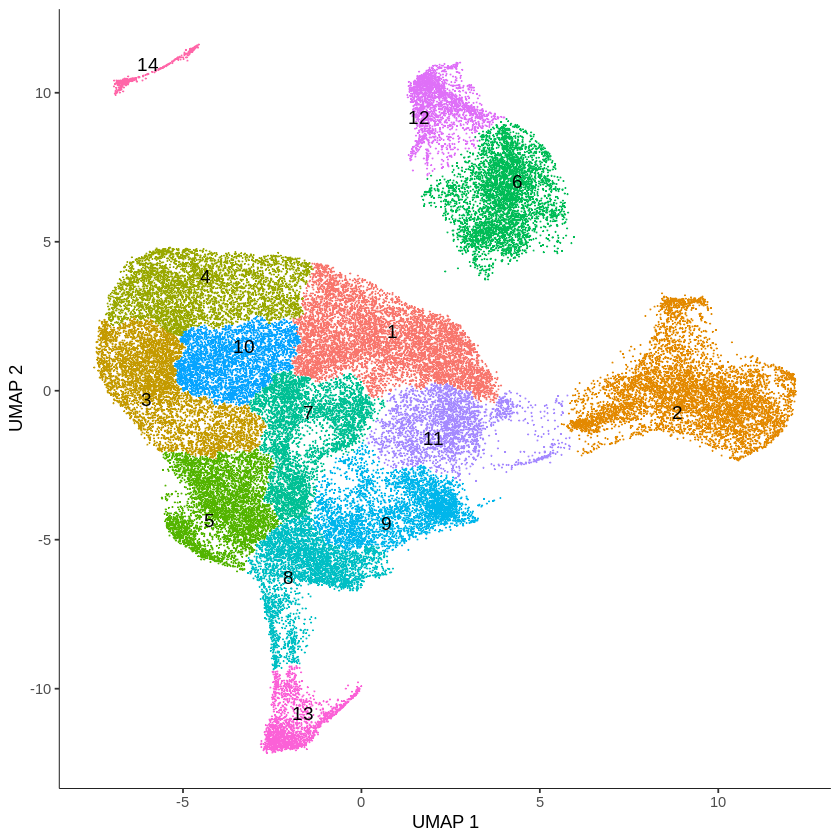

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-08-04"


png 
  2

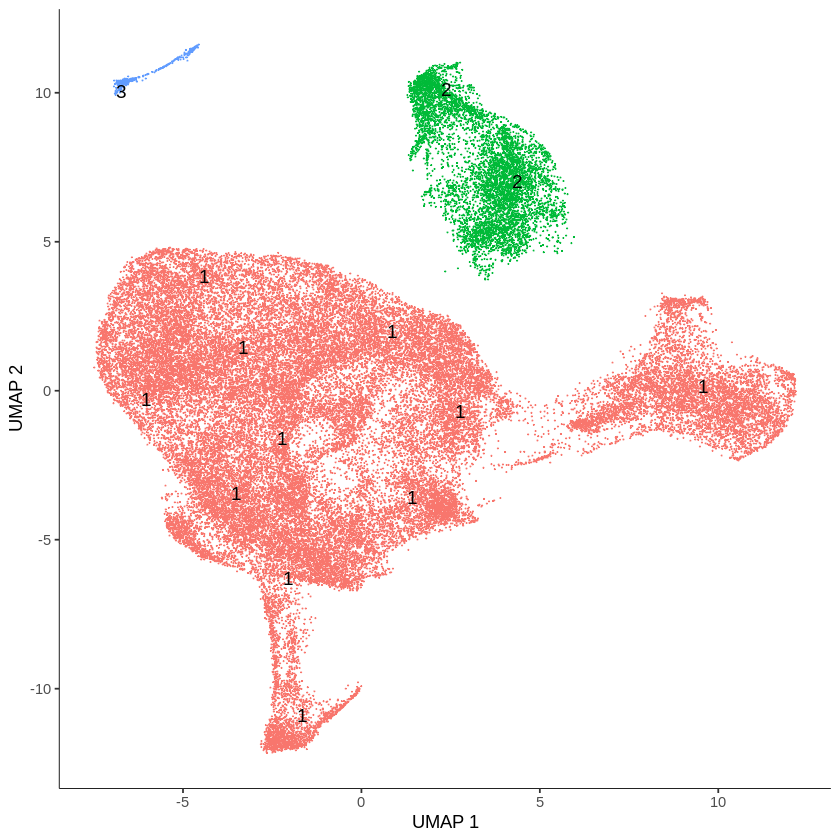

In [13]:
p1 <- plot_cells(cds_ge, show_trajectory_graph = FALSE, group_label_size = 4)
p2 <- plot_cells(cds_ge, color_cells_by = "partition", show_trajectory_graph = FALSE, group_label_size = 4)

p3 <- plot_cells(cds_gte, show_trajectory_graph = FALSE, group_label_size = 4)
p4 <- plot_cells(cds_gte, color_cells_by = "partition", show_trajectory_graph = FALSE, group_label_size = 4)

p1
p2
p3
p4

# Save figures
mkdirToday()

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_monocleUMAPs.pdf", width = size*2, height = size*2)
grid.arrange(p1, p3, p2, p4, nrow = 2, top="Trajectory Analysis: Monocle Clusters vs Partitions")
dev.off()

In [14]:
saveRDS(cds_ge, file="~/scratch/gete-gbm/results/2021-08-04/cds_ge-v1.rds")
saveRDS(cds_gte, file="~/scratch/gete-gbm/results/2021-08-04/cds_gte-v1.rds")

In [15]:
## Select Island to study the trajectory on:
integrated.sub_ge <- subset(as.Seurat(cds_ge), monocle3_partitions == 1)
integrated.sub_gte <- subset(as.Seurat(cds_gte), monocle3_partitions == 1)

In [16]:
## Convert back to monocle object and learn the graph
cds_ge2 <- as.cell_data_set(integrated.sub_ge)
cds_ge2 <- learn_graph(cds_ge2)

cds_gte2 <- as.cell_data_set(integrated.sub_gte)
cds_gte2 <- learn_graph(cds_gte2)

Using existing Monocle 3 cluster membership and partitions



  |======================================================================| 100%


Using existing Monocle 3 cluster membership and partitions



  |======================================================================| 100%


Warning message:
"`select_()` was deprecated in dplyr 0.7.0.
Please use `select()` instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_warnings()` to see where this warning was generated."


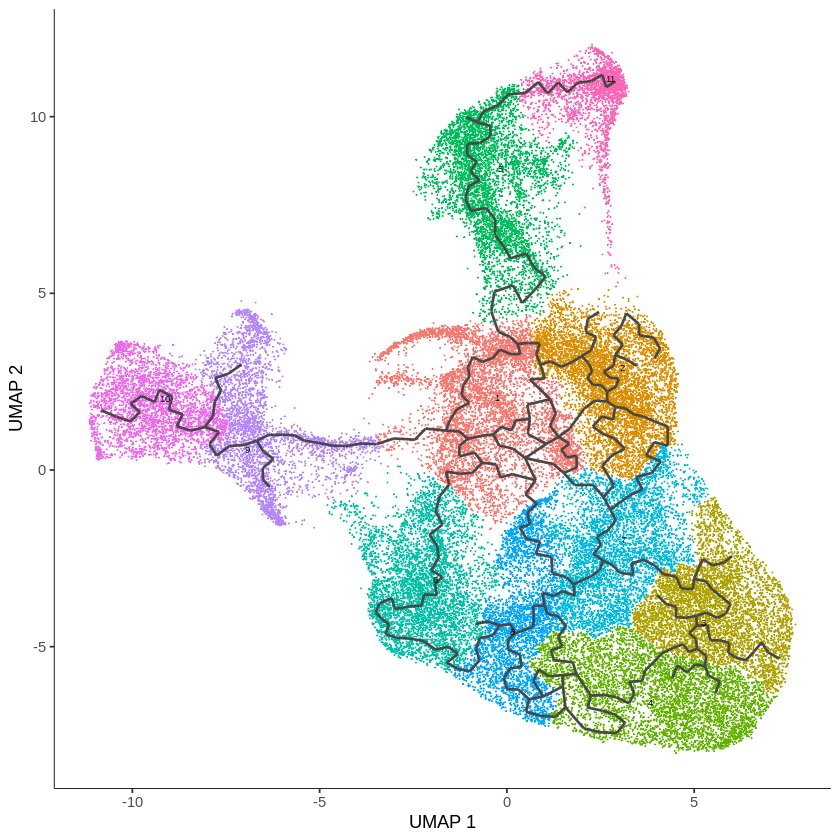

png 
  2

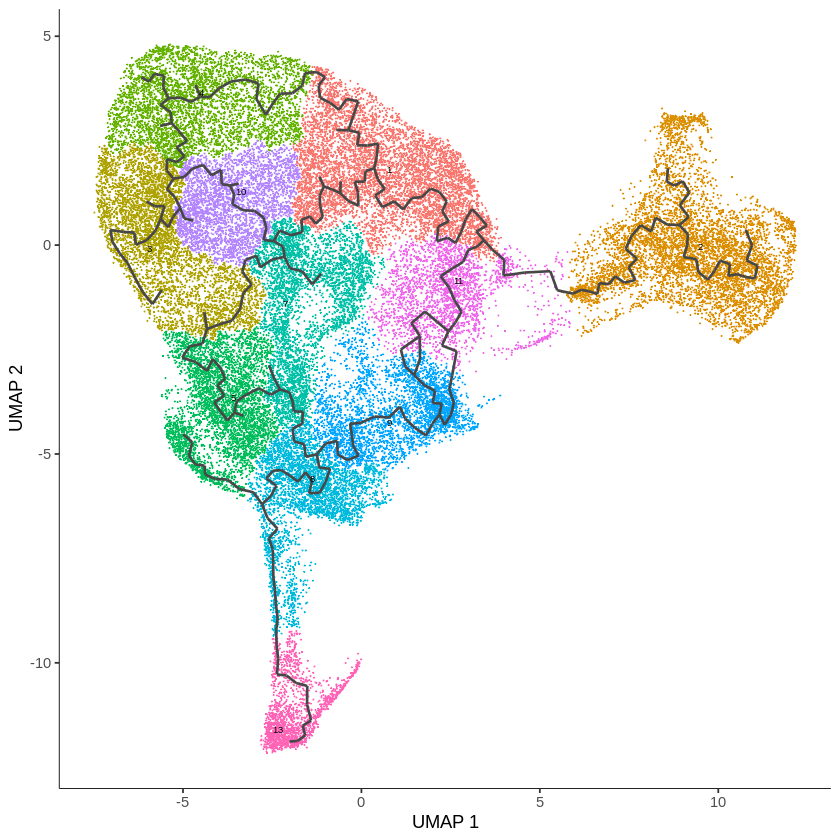

In [17]:
p1 <- plot_cells(cds_ge2, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p2 <- plot_cells(cds_gte2, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p1
p2

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_monocle_pathsVSclusters.pdf", width = size*2, height = size)
grid.arrange(p1, p2, nrow=1, top="Trajectory Analysis: Trajectories VS Clusters")
dev.off()

In [ ]:
## Select root cells
    ##GE_PC19_r0.7: Cluster 10
    ##GTE_PC20_r0.7: Cluster 14

root_cells_ge <- rownames(integrated.sub_ge@meta.data[which(FetchData(integrated.sub_ge, 
                                                                      "integrated_snn_res.0.7") == 10),])
root_cells_gte <- rownames(integrated.sub_gte@meta.data[which(FetchData(integrated.sub_gte, 
                                                                      "integrated_snn_res.0.7") == 14),])

## Order Cells
cds_ge3 <- order_cells(cds_ge2, root_cells = root_cells_ge)
cds_gte3 <- order_cells(cds_gte2, root_cells = root_cells_gte)

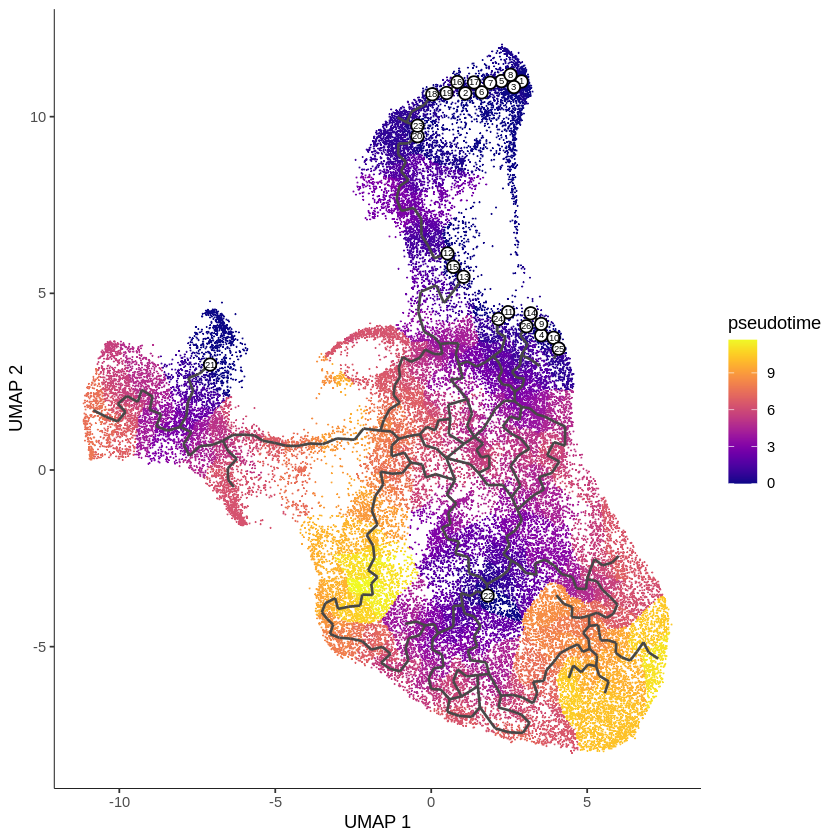

png 
  2

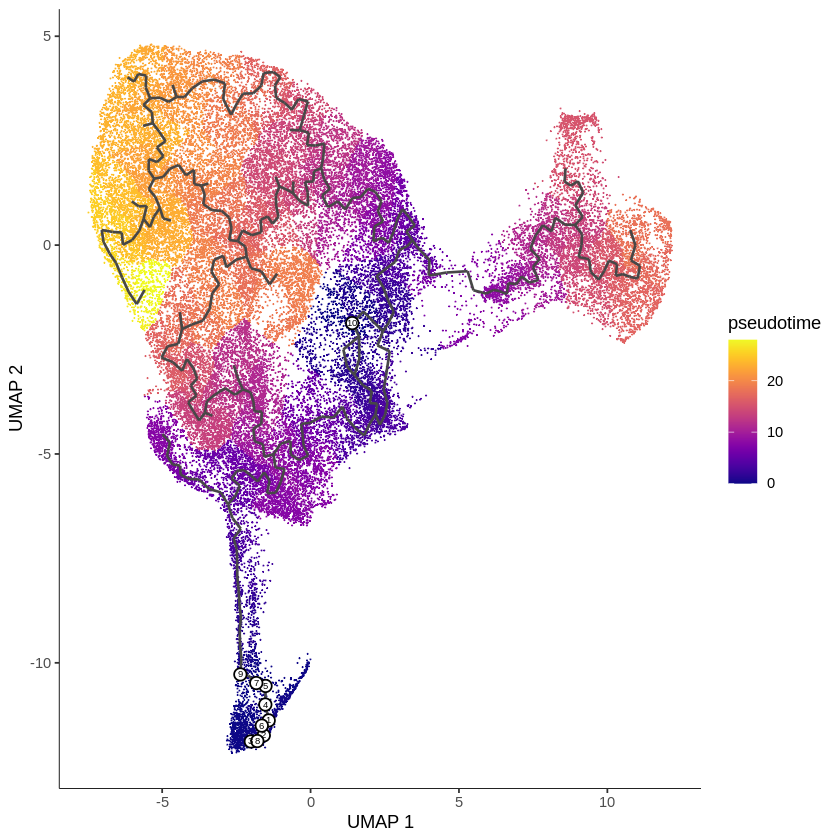

In [26]:
# cds_ge3 <- readRDS("~/scratch/gete-gbm/results/2021-08-04/cds_pseudo_clus10_ge-v1.rds")
# cds_gte3 <- readRDS("~/scratch/gete-gbm/results/2021-08-04/cds_pseudo__clus10_gte-v1.rds")

## Plot Pseudotime Graph
p1 <- plot_cells(cds_ge3, color_cells_by = "pseudotime", 
           label_cell_groups = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p2 <- plot_cells(cds_gte3, color_cells_by = "pseudotime", 
           label_cell_groups = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p1
p2

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_monocle_pseudotime_clus10-14.pdf", width = size*2, height = size)
grid.arrange(p1, p2, nrow=1, top="Trajectory Analysis: Pseudotime on Seurat Clusters10")
dev.off()

In [23]:
saveRDS(cds_ge3, file="~/scratch/gete-gbm/results/2021-08-04/cds_pseudo_clus10_ge-v1.rds")
saveRDS(cds_gte3, file="~/scratch/gete-gbm/results/2021-08-04/cds_pseudo__clus10_gte-v1.rds")

In [28]:
## Select root cells
    ##GE_PC19_r0.2: monocle Cluster 11
    ##GTE_PC20_r0.2: monocle Cluster 13

root_cells_ge <- rownames(integrated.sub_ge@meta.data[which(FetchData(integrated.sub_ge, 
                                                                      "monocle3_clusters") == 11),])
root_cells_gte <- rownames(integrated.sub_gte@meta.data[which(FetchData(integrated.sub_gte, 
                                                                      "monocle3_clusters") == 13),])

## Order Cells in Pseudotime along a trajectory
cds_ge3 <- order_cells(cds_ge2, root_cells = root_cells_ge)
cds_gte3 <- order_cells(cds_gte2, root_cells = root_cells_gte)

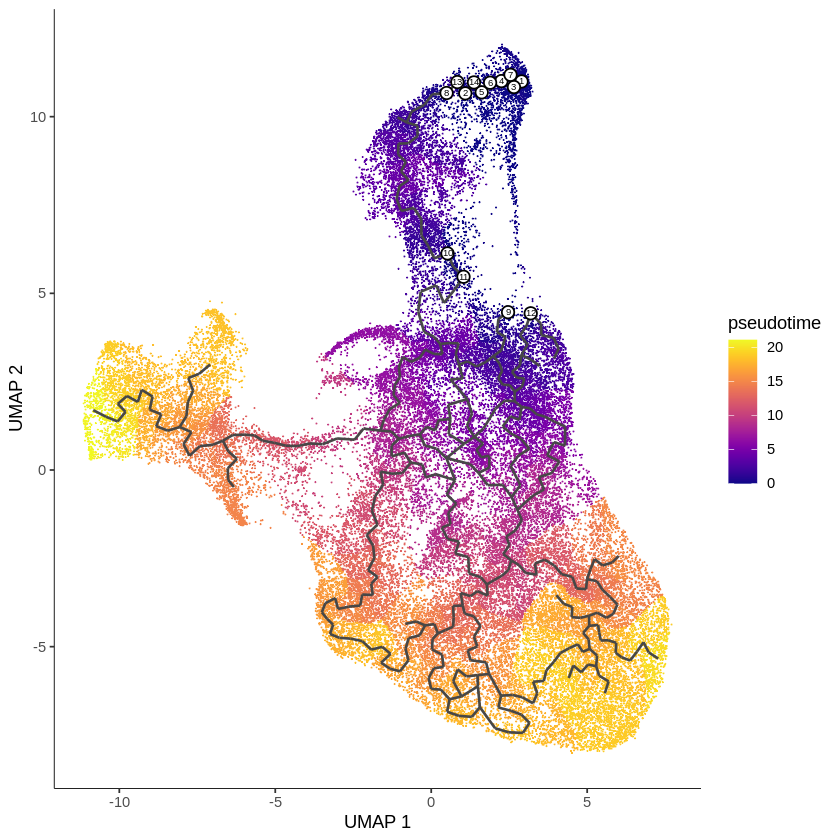

png 
  2

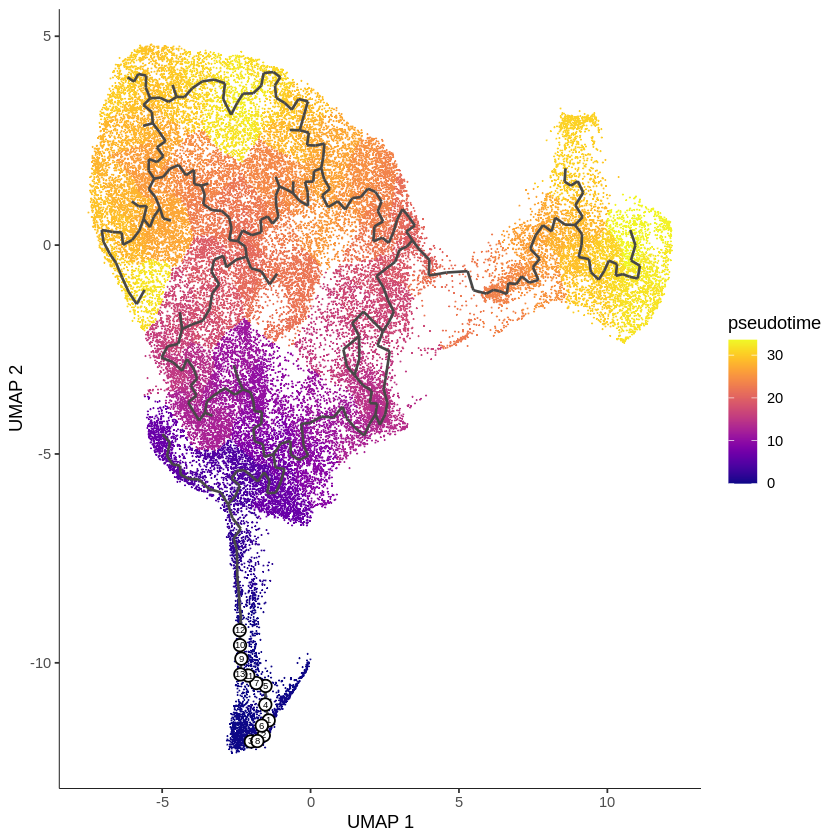

In [29]:
## Plot Pseudotime Graph
p1 <- plot_cells(cds_ge3, color_cells_by = "pseudotime", 
           label_cell_groups = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p2 <- plot_cells(cds_gte3, color_cells_by = "pseudotime", 
           label_cell_groups = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

p1
p2

# Save figures

size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_monocle_pseudotime_mclus11-13.pdf", width = size*2, height = size)
grid.arrange(p1, p2, nrow=1, top="Trajectory Analysis: Pseudotime")
dev.off()

In [30]:
saveRDS(cds_ge3, file="~/scratch/gete-gbm/results/2021-08-04/cds_pseudo_monoclus11_ge-v1.rds")
saveRDS(cds_gte3, file="~/scratch/gete-gbm/results/2021-08-04/cds_pseudo__monoclus13_gte-v1.rds")

## Reduce Resolution of UMAP to combine clusters
2021-08-04:

In [4]:
## Load most recent Seurat objects`gte_gbm.sc.int.umap0.7`_gbm.sc.int.umap0.7 and gte_gbm.sc.int.umap0.7 
load("~/scratch/gete-gbm/results/2021-07-08/ge_gbm.sc.int.umap0.7_mgmt.RData")
load("~/scratch/gete-gbm/results/2021-07-08/gte_gbm.sc.int.umap0.7_mgmt.RData")

In [31]:
res <- c(0.2, 0.3, 0.4, 0.5, 0.6)

# Find Clusters with a vector of resolutions
for (j in 1:length(res)) { ## Compute for each resolution
    ge_gbm.sc.int.umap0.7 <- FindClusters(ge_gbm.sc.int.umap0.7, resolution = res[j])
    gte_gbm.sc.int.umap0.7 <- FindClusters(gte_gbm.sc.int.umap0.7, resolution = res[j])
}

# You can view different resolutions using:
# Idents(object = filt_gte_brain.intergrated) <- "integrated_snn_res.0.8"

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9399
Number of communities: 9
Elapsed time: 26 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1775982

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9343
Number of communities: 10
Elapsed time: 23 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1816023

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9272
Number of communities: 12
Elapsed time: 19 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 49670
Number of edges: 1775982

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9222
Number of communities: 11
Elapsed time: 19 seconds
Modul

In [33]:
p <- vector(mode="list", length=5)


Idents(object = ge_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.2"
Idents(object = gte_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.2"

p[[1]][[1]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[1]][[2]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 by Clusters")

p[[1]][[3]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[1]][[4]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 + Retrotransposons by Clusters")


Idents(object = ge_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.3"
Idents(object = gte_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.3"

p[[2]][[1]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[2]][[2]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 by Clusters")

p[[2]][[3]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[2]][[4]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 + Retrotransposons by Clusters")


Idents(object = ge_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.4"
Idents(object = gte_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.4"

p[[3]][[1]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[3]][[2]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 by Clusters")

p[[3]][[3]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[3]][[4]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 + Retrotransposons by Clusters")

Idents(object = ge_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.5"
Idents(object = gte_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.5"

p[[4]][[1]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[4]][[2]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 by Clusters")

p[[4]][[3]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[4]][[4]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 + Retrotransposons by Clusters")

Idents(object = ge_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.6"
Idents(object = gte_gbm.sc.int.umap0.7) <- "integrated_snn_res.0.6"

p[[5]][[1]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[5]][[2]] <- DimPlot(ge_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 by Clusters")

p[[5]][[3]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", group.by = "sample") + ggtitle("hg38 by Sample Origin")
p[[5]][[4]] <- DimPlot(gte_gbm.sc.int.umap0.7, reduction = "umap", label = TRUE, repel = TRUE) + ggtitle("hg38 + Retrotransposons by Clusters")

In [35]:
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_umaps_PC20_r02.pdf", width = size*2, height = size*2)
grid.arrange(p[[1]][[1]], p[[1]][[2]], 
             p[[1]][[3]], p[[1]][[4]], nrow=2, top = "UMAP PC20 resolution 0.2")
dev.off()

pdf("~/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_umaps_PC20_r03.pdf", width = size*2, height = size*2)
grid.arrange(p[[2]][[1]], p[[2]][[2]], 
             p[[2]][[3]], p[[2]][[4]], nrow=2, top = "UMAP PC20 resolution 0.3")
dev.off()

pdf("~/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_umaps_PC20_r04.pdf", width = size*2, height = size*2)
grid.arrange(p[[3]][[1]], p[[3]][[2]], 
             p[[3]][[3]], p[[3]][[4]], nrow=2, top = "UMAP PC20 resolution 0.4")
dev.off()

pdf("~/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_umaps_PC20_r05.pdf", width = size*2, height = size*2)
grid.arrange(p[[4]][[1]], p[[4]][[2]], 
             p[[4]][[3]], p[[4]][[4]], nrow=2, top = "UMAP PC20 resolution 0.5")
dev.off()

pdf("~/scratch/gete-gbm/results/2021-08-04/r_gbmsc-v1_umaps_PC20_r06.pdf", width = size*2, height = size*2)
grid.arrange(p[[5]][[1]], p[[5]][[2]], 
             p[[5]][[3]], p[[5]][[4]], nrow=2, top = "UMAP PC20 resolution 0.6")
dev.off()


png 
  2

png 
  2

png 
  2

png 
  2

png 
  2

In [36]:
saveRDS(`ge_gbm.sc.int.umap0.7`, file="~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")
saveRDS(`gte_gbm.sc.int.umap0.7`, file="~/scratch/gete-gbm/results/2021-08-04/gte_gbmscIntUmap.rds")

In [ ]:
ge_umaps <- readRDS("~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")
gte_umaps <- readRDS("~/scratch/gete-gbm/results/2021-08-04/gte_gbmscIntUmap.rds")

## Analyze DEGs
2021-08-11:

In [6]:
s_objs <- vector(mode="list", length=2)
s_objs[[1]] <- readRDS("~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")
s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-08-04/gte_gbmscIntUmap.rds")

Resolutions in use: 0.3, 0.5 and 0.7
- integrated_snn_res.0.3
- integrated_snn_res.0.5
- integrated_snn_res.0.7

In [8]:
## See Cluster Markers (DEG) section 12 
# ge_markers <- FindAllMarkers(`ge_gbm.sc.int.umap0.7`, only.pos = TRUE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)
# gte_markers <- FindAllMarkers(`gte_gbm.sc.int.umap0.7`, only.pos = TRUE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)

load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/ge_markers.RData")
load("/home/samkyy/scratch/gete-gbm/results/2021-06-21/gte_markers.RData")

Results of FindAllMarkers()
- p_val: p-value not adjusted for multiple test correction for condition
- avg_logFC: average log2 fold change for condition. Positive values indicate that the gene is more highly expressed in the cluster.
- pct.1: percentage of cells where the gene is detected in the cluster for condition
- pct.2: percentage of cells where the gene is detected on average in the other clusters for condition
- p_val_adj: adjusted p-value for condition, based on bonferroni correction using all genes in the dataset, used to determine significance

In [23]:
dim(ge_markers)
dim(gte_markers)

# Show table with the highest expressed gene from each cluster
top5ge <- ge_markers %>% group_by(cluster) %>% top_n(n = 5, wt = avg_log2FC)
top5gte <- gte_markers %>% group_by(cluster) %>% top_n(n = 5, wt = avg_log2FC)
head(top5ge)
head(top5gte)

[1] 4313    7

[1] 4015    7

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.352343,0.800,0.406,0,0,GFAP
0,2.222319,0.713,0.280,0,0,ID3
0,1.849670,0.570,0.220,0,0,ID1
0,1.804726,0.941,0.621,0,0,CLU
0,1.793133,0.724,0.327,0,0,HOPX
0,2.615079,0.527,0.102,0,1,IGFBP3


p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.571716,0.888,0.402,0,0,GFAP
0,2.407882,0.806,0.275,0,0,ID3
0,1.900885,0.965,0.623,0,0,CLU
0,1.873759,0.810,0.323,0,0,HOPX
0,1.825047,0.720,0.215,0,0,AQP4
0,2.272637,0.873,0.378,0,1,IGFBP5


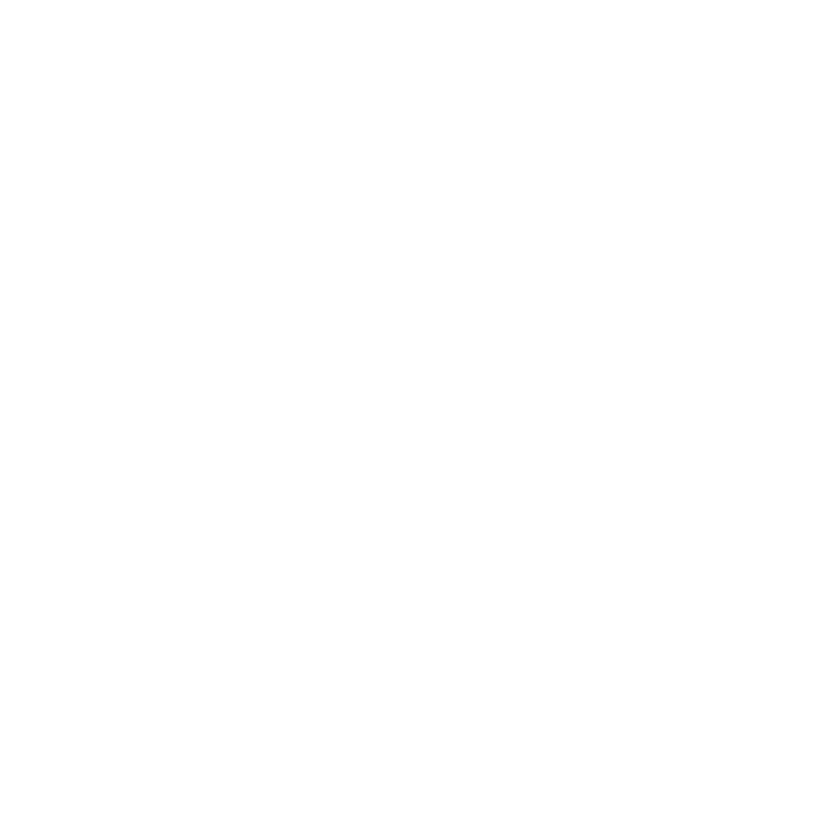

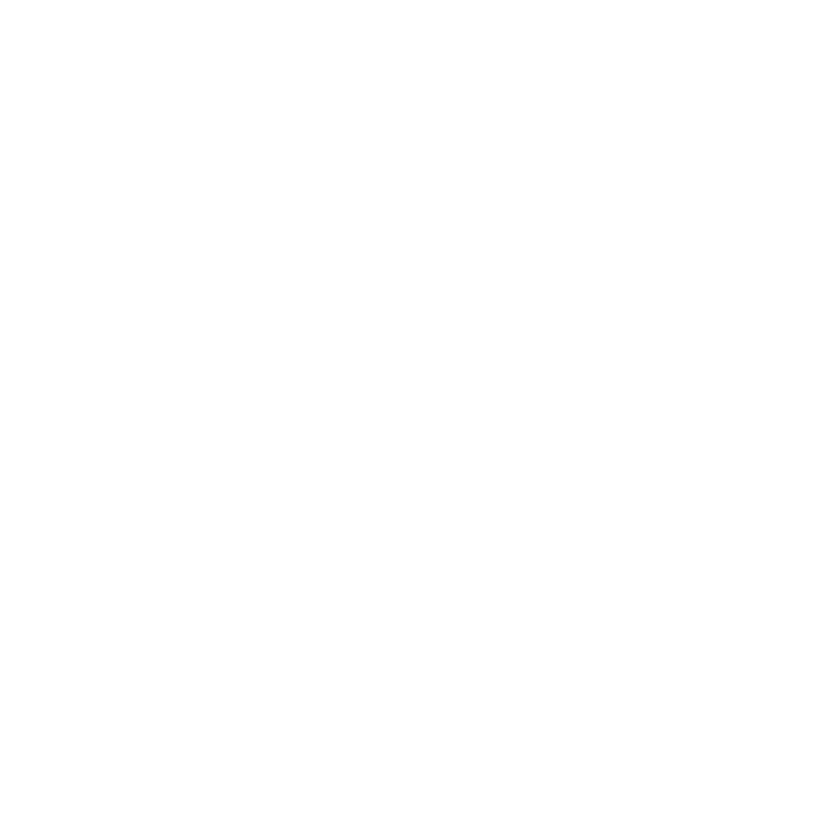

In [16]:
DefaultAssay(s_objs[[1]]) <- "integrated"
DefaultAssay(s_objs[[2]]) <- "integrated"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.7"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.7"

p <- DoHeatmap(s_objs[[1]], features=top5ge$gene, size=3) +
        ggtitle("hg38") + NoLegend()
p2 <- DoHeatmap(s_objs[[2]], features=top5gte$gene, size=3) + 
        ggtitle("hg38 + Retrotransposons") + guides(color = "none") 
p
p2
# Save figures
mkdirToday()
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r07_DEGHeatmaps.pdf", width = size*2.5, height = size*2)
grid.arrange(p, p2, nrow = 1, top="GBM + NSC Samples:\nHeatmap of Differentially Expressed Genes by Cluster (PC20r03)")
dev.off()

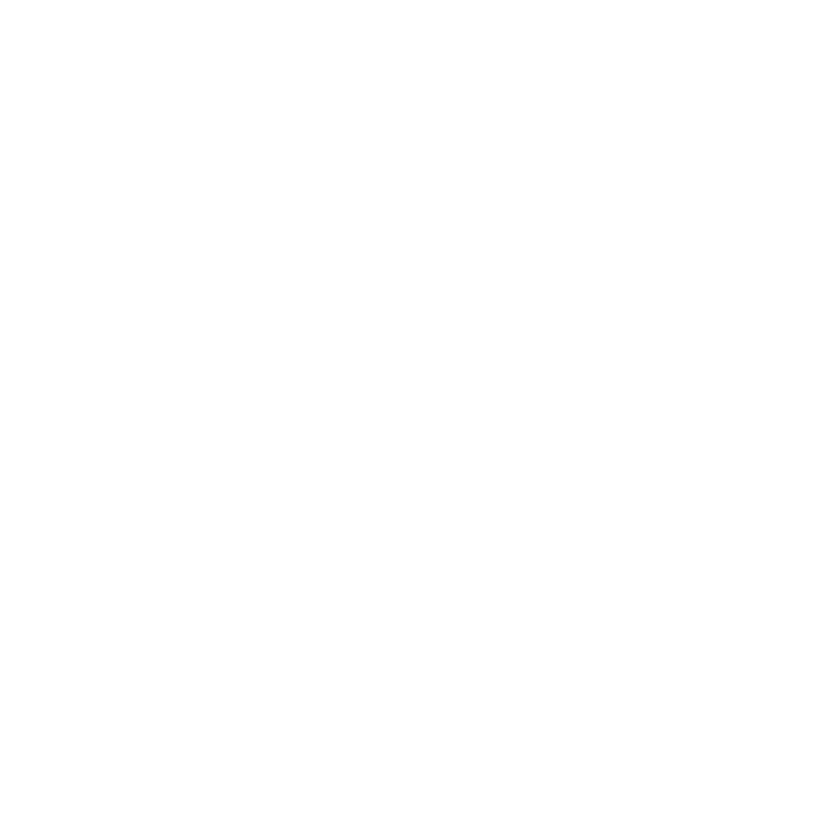

[1] "Current working directory: /scratch/samkyy/gete-gbm/results/2021-08-11"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-08-11' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-08-11"


png 
  2

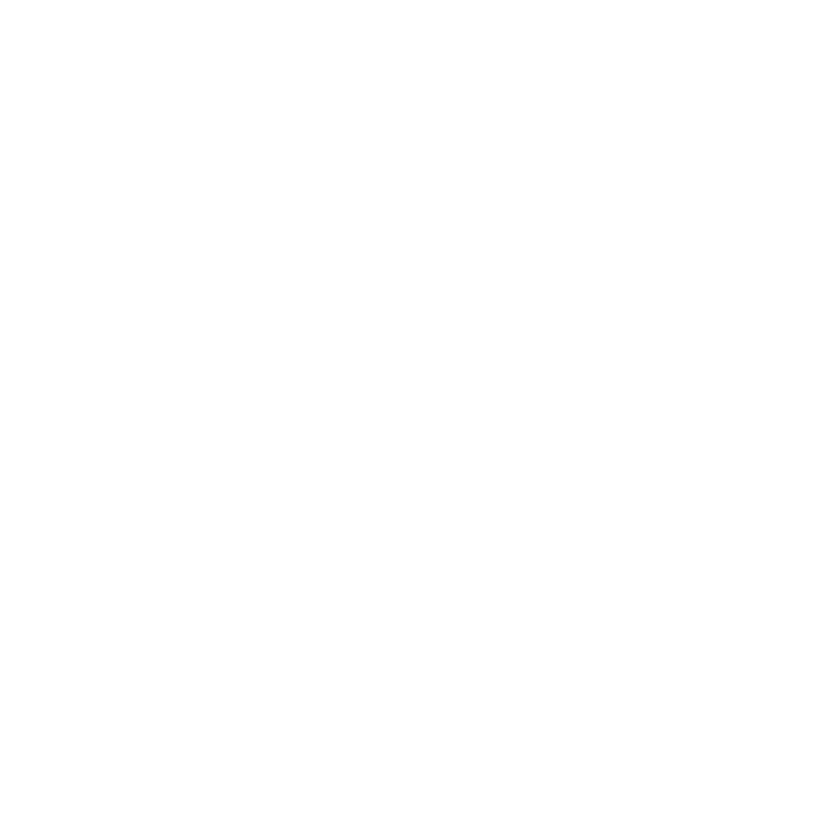

In [28]:
DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.7"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.7"

p <- DoHeatmap(s_objs[[1]], features=top5ge$gene, slot="data", disp.min=-1, disp.max=3, size=2) +
        ggtitle("hg38") + NoLegend()
p2 <- DoHeatmap(s_objs[[2]], features=top5gte$gene, slot="data", disp.min=-1, disp.max=3, size=2) + 
        ggtitle("hg38 + Retrotransposons") + guides(color = "none") 
p
p2
# Save figures
mkdirToday()
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r07_DEGHeatmaps_RNAdata.pdf", width = size*2.5, height = size*2)
grid.arrange(p, p2, nrow = 1, top="GBM + NSC Samples (RNA assay, data slot):\nHeatmap of Differentially Expressed Genes by Cluster (PC20r03)")
dev.off()

In [27]:
DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.7"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.7"

## Check for duplicated genes in top gene markers
which(duplicated(top5ge))
which(duplicated(top5ge))

# Ridge plots - from ggridges. Visualize single cell expression distributions in each cluster
p <- RidgePlot(s_objs[[1]], features = unique(top5ge$gene), ncol = 10)
p2 <- RidgePlot(s_objs[[2]], features = unique(top5gte$gene), ncol = 10)


# Save figures
mkdirToday()
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r07_DEGRidgePlot.pdf", width = size*4, height = size*8)
p
p2
dev.off()

integer(0)

integer(0)

[1] "Current working directory: /scratch/samkyy/gete-gbm/results/2021-08-11"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-08-11' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-08-11"


Picking joint bandwidth of 0.127

Picking joint bandwidth of 0.0975

Picking joint bandwidth of 0.0763

Picking joint bandwidth of 0.211

Picking joint bandwidth of 0.108

Picking joint bandwidth of 0.0501

Picking joint bandwidth of 0.156

Picking joint bandwidth of 0.178

Picking joint bandwidth of 0.104

Picking joint bandwidth of 0.113

Picking joint bandwidth of 0.0866

Picking joint bandwidth of 0.108

Picking joint bandwidth of 0.072

Picking joint bandwidth of 0.0564

Picking joint bandwidth of 0.153

Picking joint bandwidth of 0.0361

Picking joint bandwidth of 0.0275

Picking joint bandwidth of 0.0234

Picking joint bandwidth of 0.0192

Picking joint bandwidth of 0.0219

Picking joint bandwidth of 0.0596

Picking joint bandwidth of 0.184

Picking joint bandwidth of 0.198

Picking joint bandwidth of 0.0802

Picking joint bandwidth of 0.058

Picking joint bandwidth of 0.0142

Picking joint bandwidth of 0.169

Picking joint bandwidth of 0.106

Picking joint bandwidth of 0.132

P

png 
  2

In [7]:
# FindAllMarkers for clusters in PC20 resolution0.3 
DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

ge_markers <- FindAllMarkers(s_objs[[1]], only.pos = FALSE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)
gte_markers <- FindAllMarkers(s_objs[[2]], only.pos = FALSE, min.pct = 0.25, min.diff.pct = 0.25, logfc.threshold = 0.25)

save(ge_markers, file="~/scratch/gete-gbm/results/2021-08-11/ge_markers_PC20r03posneg.RData")
save(gte_markers, file="~/scratch/gete-gbm/results/2021-08-11/gte_markers_PC20r03posneg.RData")

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10



In [16]:
dim(ge_markers)
dim(gte_markers)

# Show table with the highest expressed gene from each cluster
top10ge <- ge_markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)
top10gte <- gte_markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)
head(top10ge)
head(top10gte)

[1] 2948    7

[1] 3220    7

p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,3.249012,0.766,0.227,0,0,ID3
0,3.061921,0.842,0.360,0,0,GFAP
0,2.463407,0.829,0.478,0,0,CRYAB
0,2.438111,0.697,0.165,0,0,AQP4
0,2.416463,0.960,0.587,0,0,CLU
0,2.181183,0.606,0.179,0,0,ID1


p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,3.192926,0.827,0.233,0,0,ID3
0,2.986552,0.891,0.366,0,0,GFAP
0,2.538713,0.866,0.482,0,0,CRYAB
0,2.321580,0.974,0.597,0,0,CLU
0,2.249412,0.751,0.172,0,0,AQP4
0,2.150406,0.939,0.506,0,0,SPARCL1


Warning message in DoHeatmap(s_objs[[1]], features = top10ge$gene, size = 3):
"The following features were omitted as they were not found in the scale.data slot for the integrated assay: CHL1, SEPTIN14, CDK4, CD27, CD79B, IGLC2, CD79A, IGLC1, IGHM, IGKC"
Warning message in DoHeatmap(s_objs[[2]], features = top10gte$gene, size = 3):
"The following features were omitted as they were not found in the scale.data slot for the integrated assay: CLINT1, SEPTIN14, GIHCG, EIF3F, SCAND1, MRPS21, EIF4H, SMARCE1, SELENOS, YWHAZ, CAMLG, DNAJC19, PPP2CA, CDK4, CD27, IGLC2, CD79A, CD79B, IGLC1, IGHM, IGKC"


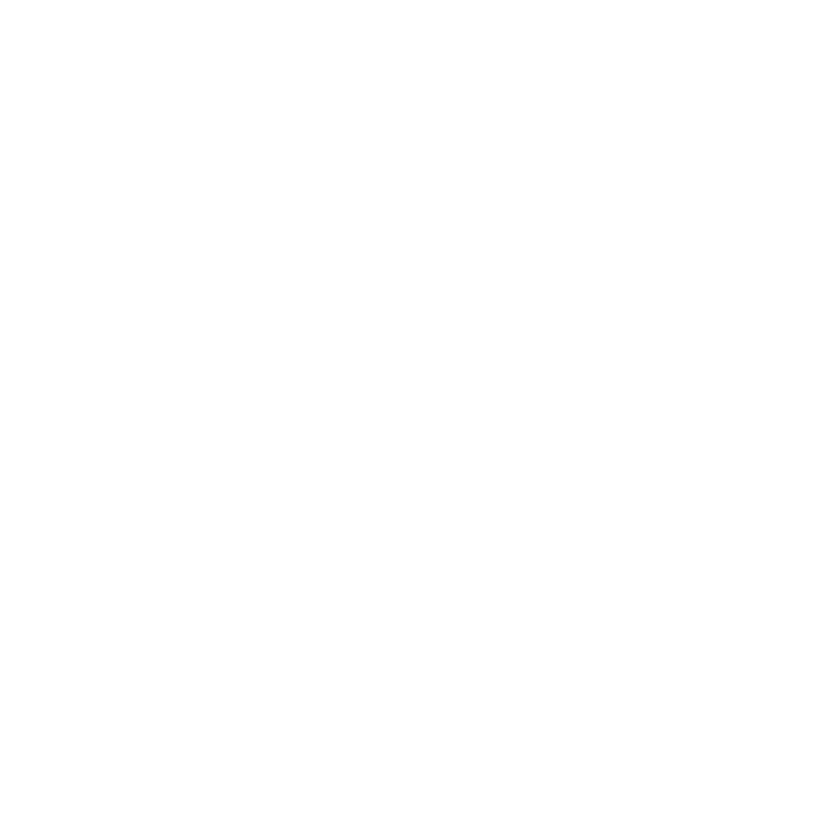

png 
  2

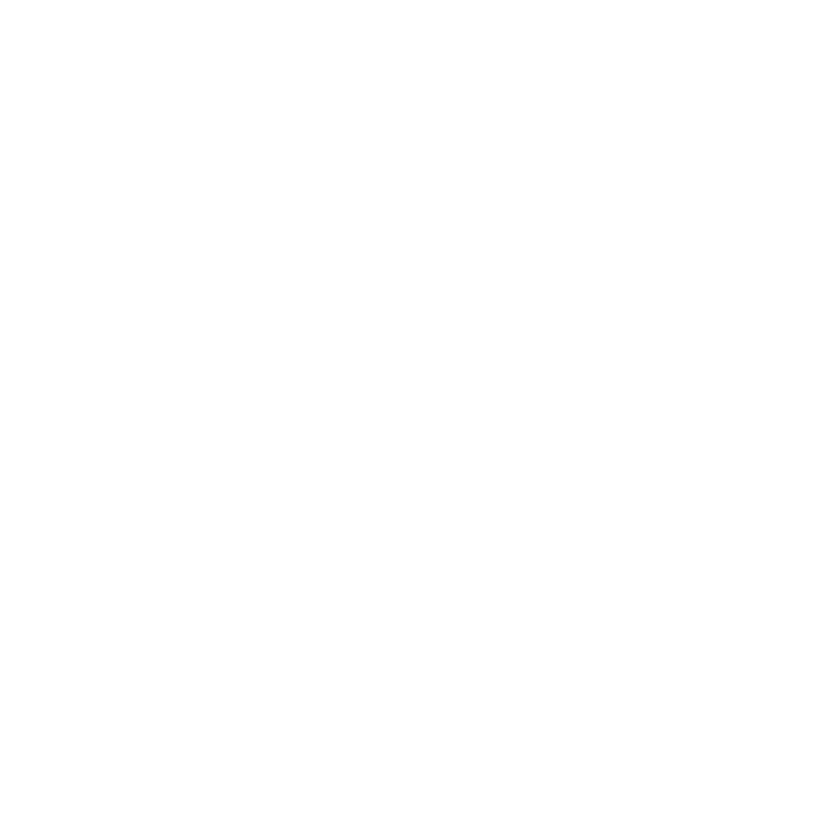

In [17]:
DefaultAssay(s_objs[[1]]) <- "integrated"
DefaultAssay(s_objs[[2]]) <- "integrated"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

p <- DoHeatmap(s_objs[[1]], features=top10ge$gene, size=3) +
        ggtitle("hg38") + NoLegend()
p2 <- DoHeatmap(s_objs[[2]], features=top10gte$gene, size=3) + 
        ggtitle("hg38 + Retrotransposons") + guides(color = "none") 
p
p2
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r03_DEGHeatmaps.pdf", width = size*2.5, height = size*2)
grid.arrange(p, p2, nrow = 1, top="GBM + NSC Samples:\nHeatmap of Differentially Expressed Genes by Cluster (PC20r03)")
dev.off()

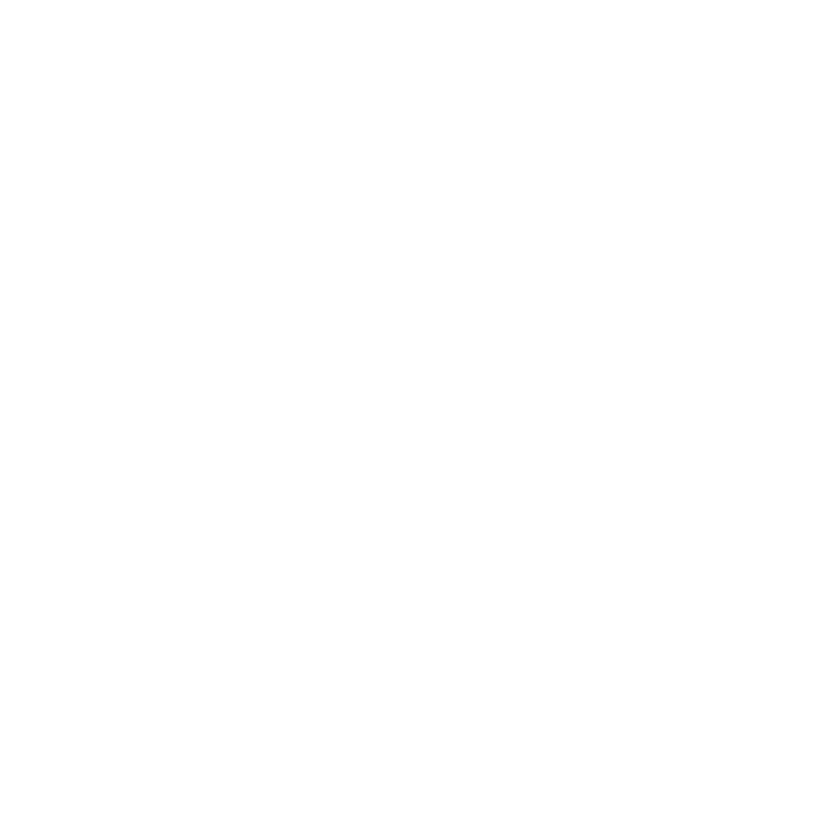

png 
  2

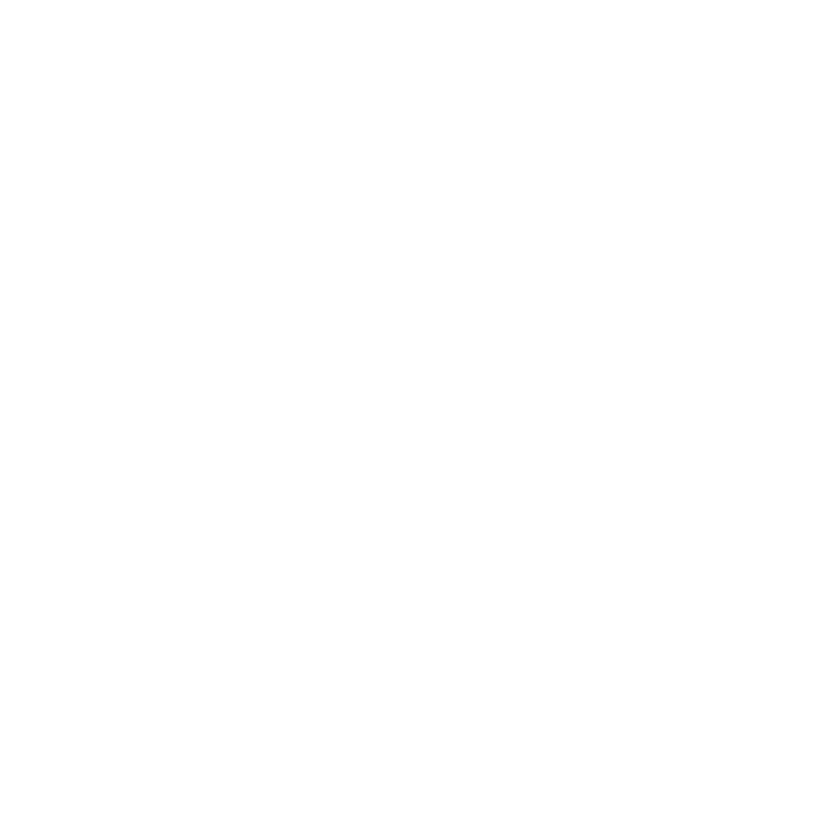

In [25]:
DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

p <- DoHeatmap(s_objs[[1]], features=top10ge$gene, slot="data", disp.min=-1, disp.max=3, size=2) +
        ggtitle("hg38") + NoLegend()
p2 <- DoHeatmap(s_objs[[2]], features=top10gte$gene, slot="data", disp.min=-1, disp.max=3, size=2) + 
        ggtitle("hg38 + Retrotransposons") + guides(color = "none") 
p
p2
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r03_DEGHeatmaps_RNAdata.pdf", width = size*2.5, height = size*2)
grid.arrange(p, p2, nrow = 1, top="GBM + NSC Samples (RNA assay, data slot):\nHeatmap of Differentially Expressed Genes by Cluster (PC20r03)")
dev.off()

In [19]:
DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

## Check for duplicated genes in top gene markers
which(duplicated(top10ge))
which(duplicated(top10ge))

# Ridge plots - from ggridges. Visualize single cell expression distributions in each cluster
p <- RidgePlot(s_objs[[1]], features = unique(top10ge$gene), ncol = 10)
p2 <- RidgePlot(s_objs[[2]], features = unique(top10gte$gene), ncol = 10)


# Save figures
 
size = 7
pdf("~/scratch/gete-gbm/results/2021-08-11/r_gbmsc_PC20r03_DEGRidgePlot.pdf", width = size*4, height = size*8)
p
p2
dev.off()

integer(0)

integer(0)

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-08-12"


Picking joint bandwidth of 0.0855

Picking joint bandwidth of 0.125

Picking joint bandwidth of 0.171

Picking joint bandwidth of 0.0315

Picking joint bandwidth of 0.192

Picking joint bandwidth of 0.0788

Picking joint bandwidth of 0.139

Picking joint bandwidth of 0.0404

Picking joint bandwidth of 0.1

Picking joint bandwidth of 0.11

Picking joint bandwidth of 0.0944

Picking joint bandwidth of 0.0464

Picking joint bandwidth of 0.104

Picking joint bandwidth of 0.0692

Picking joint bandwidth of 0.0615

Picking joint bandwidth of 0.144

Picking joint bandwidth of 0.107

Picking joint bandwidth of 0.0587

Picking joint bandwidth of 0.167

Picking joint bandwidth of 0.16

Picking joint bandwidth of 0.0546

Picking joint bandwidth of 0.0863

Picking joint bandwidth of 0.115

Picking joint bandwidth of 0.159

Picking joint bandwidth of 0.129

Picking joint bandwidth of 0.0445

Picking joint bandwidth of 0.0536

Picking joint bandwidth of 0.0723

Picking joint bandwidth of 0.0798

Pic

png 
  2

In [35]:
setdiff(unique(top10ge$gene), unique(top10gte$gene))
length(setdiff(unique(top10ge$gene), unique(top10gte$gene)))
setdiff(unique(top10gte$gene), unique(top10ge$gene))
length(setdiff(unique(top10gte$gene), unique(top10ge$gene)))

[1] "DLL3"       "OLIG2"      "PDGFRA"     "MCM7"       "NPTX2"     
 [6] "CHI3L1"     "BIRC5"      "CKS2"       "ERMN"       "GAP43"     
[11] "MEG3"       "PMP2"       "POSTN"      "GRIA2"      "CHL1"      
[16] "FABP7"      "PEG10"      "HBB"        "SIRT2"      "BCAS1"     
[21] "GPR17"      "SLC44A1"    "FERMT1"     "PFN2"       "AC104051.2"
[26] "VWF"

[1] 26

[1] "GPM6A"   "C1orf61" "STMN1"   "QDPR"    "PPP2CA"  "DNAJC19" "CAMLG"  
 [8] "YWHAZ"   "SELENOS" "SMARCE1" "EIF4H"   "MRPS21"  "SCAND1"  "EIF3F"  
[15] "UBE2S"   "GIHCG"   "CXCL10"  "CLINT1"  "RGCC"

[1] 19

In [38]:
setdiff(unique(top10ge$gene), unique(top10gte$gene)) %in% top10ge$gene

[1] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE
[16] TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE TRUE

In [36]:
## setdiff(x, y) ## elements that are unique in x

setdiff(unique(ge_markers$gene), unique(gte_markers$gene))
length(setdiff(unique(ge_markers$gene), unique(gte_markers$gene)))
setdiff(unique(gte_markers$gene), unique(ge_markers$gene))
length(setdiff(unique(gte_markers$gene), unique(ge_markers$gene)))

[1] "DLL3"       "FAM89A"     "SMOC1"      "TNR"        "ASCL1"     
  [6] "ARC"        "NEU4"       "PLPPR1"     "CHD7"       "KLRC2"     
 [11] "ASB3"       "FAM181B"    "TCF12"      "AC004540.2" "NNAT"      
 [16] "PODXL2"     "TTC9B"      "CNTN1"      "CEBPB"      "GBE1"      
 [21] "LTB"        "PMAIP1"     "BCL2"       "ARHGAP24"   "ATF5"      
 [26] "CLECL1"     "RASSF6"     "SIT1"       "SPINT2"     "NCF1"      
 [31] "RGS13"      "BCL11A"     "EML6"       "IKZF1"      "TMEM243"   
 [36] "FCRL2"      "GTSF1"      "CD22"       "KLHL6"      "RAC2"      
 [41] "PLBD1"      "IKZF3"      "TCEAL3"     "TIMP2"      "NFE2L2"    
 [46] "PEA15"      "BRI3"       "NME4"       "FSCN1"      "GOLIM4"    
 [51] "IER2"       "NENF"       "GADD45B"    "MT1E"       "CHRNA1"    
 [56] "METTL7B"    "SMYD2"      "ZNF385D"    "CCDC102B"   "DPF3"      
 [61] "KCNE4"      "MXRA7"      "RTN1"       "TSPAN5"     "EFEMP2"    
 [66] "AC092958.1" "CHN1"       "ZYX"        "PLIN3"      "TPD52"     
 [71] "PPP2CB"     "ADAM9"      "RHBDD2"     "GPI"        "PJA2"      
 [76] "SECISBP2L"  "SVIP"       "MID1IP1"    "GNG7"       "HHIP"      
 [81] "SYNJ2"      "SEMA3B"     "PTPRD"      "PAQR8"      "LIMCH1"    
 [86] "ELOVL1"     "FMNL2"      "MBNL2"      "ARHGAP21"   "DOCK5"     
 [91] "SERPINI1"   "CERCAM"     "TMEM63A"    "AC018647.1" "ADAMTS4"   
 [96] "APBB1"      "TMTC4"      "TPPP"       "TMEM151A"   "ZCCHC24"   
[101] "DNAJC6"     "TTYH2"      "BOK"        "DOHH"       "NINJ2"     
[106] "MAN2A1"     "BACE1"      "PLCL1"      "ZDHHC20"    "CNTNAP4"   
[111] "B3GAT1"     "ATP8A1"     "SEMA4D"     "LINC00320"  "TSPAN15"   
[116] "RBP7"       "PCSK6"      "CLMN"       "C1orf198"   "FAM102A"   
[121] "NIPAL3"     "SLCO3A1"    "LGI3"       "ABCA8"      "AK5"       
[126] "TBC1D12"    "ARFGEF3"    "DAAM2"      "PDE1C"      "MVB12B"    
[131] "HCN2"       "FOLH1"      "SH3GL3"     "FGF1"       "SLCO1A2"   
[136] "FAM171A1"   "ZNF536"     "MTMR10"     "FAM13C"     "ARHGAP23"  
[141] "GPD1"       "PADI2"      "YPEL2"      "AC009063.2" "PRRG1"     
[146] "TMC6"       "C21orf91"   "USP54"      "GRM3"       "PRCD"      
[151] "KCNK1"      "AC096564.1" "DLG2"       "ENPP4"      "NKAIN2"    
[156] "TMSB10"     "LDLRAD4"    "CDC42EP1"   "KIAA0930"   "NXPE3"     
[161] "TYRO3"      "ENDOD1"     "SPOCK1"     "PXK"        "NACAD"     
[166] "PRNP"       "PREX1"      "PAQR6"      "RPL36A"     "TLE4"      
[171] "DIXDC1"     "SIK3"       "IGSF8"      "ARL8A"      "RASSF2"    
[176] "MAP7D1"     "RETREG1"    "RNF220"     "HEPACAM"    "DLG1"      
[181] "DPYSL5"     "MXI1"       "GAS7"       "PRKACB"     "LAMP1"     
[186] "ADD3"       "PSEN1"      "MOB3B"      "PRUNE2"     "ELMO1"     
[191] "CERS2"      "FRYL"       "PROX1"      "RYBP"       "UBL3"      
[196] "NCOA7"      "DNAJB2"     "ABHD17A"    "CDK19"      "ZFYVE16"   
[201] "TMEM165"    "MAP4K4"     "PHLDA3"     "CCP110"     "JAM3"      
[206] "RALGDS"     "PTK2"       "PCDH10"     "PSAT1"      "EIF4EBP1"  
[211] "CELF2"      "BTG1"       "STK17A"     "AKAP13"     "BASP1"     
[216] "PPP1R14B"   "ADGRG1"     "MRPS6"      "GNAS"       "C9orf16"   
[221] "OS9"        "COX20"      "XRN2"       "TMEM132B"   "IL1RAP"    
[226] "HAPLN1"     "LRRC4C"     "C1QL1"      "HBB"        "SCN1A"     
[231] "VGF"        "PLAT"       "NCAN"       "TNIK"       "BICD1"     
[236] "SEMA5A"     "HLA-B"      "SLC35F1"    "MMP16"      "COL9A3"    
[241] "DPP6"       "GNG12"      "ADGRL3"     "KCNQ1OT1"   "GPR17"     
[246] "FERMT1"     "FGF12"      "SHD"        "ATCAY"      "TNS3"      
[251] "TNK2"       "PKP4"       "CCER2"      "CRB1"       "GALNT13"   
[256] "AMOTL2"     "ZNF488"     "PCDH7"      "GAL3ST1"    "LINC00689" 
[261] "TMEM163"    "AC006058.1" "PLAAT1"     "RUNDC3A"    "COL11A1"   
[266] "EPHB1"      "P2RX7"      "AC104051.2" "CA10"       "WASF1"     
[271] "ANGPTL2"    "RTKN"       "TAGLN3"     "CYP27B1"    "IMPAD1"    
[276] "PACC1"      "RGMB"       "NKX2-2"     "TNFRSF21"   "SNX22"     
[281] "CDKN2A"     "AGAP2-

[1] 329

[1] "MT1M"           "ZFP36L2"        "GJA1"           "ABCC3"         
  [5] "MLC1"           "FADS2"          "PRRX1"          "CTNND2"        
  [9] "BNIP3L"         "FAM162A"        "IRS2"           "FLNA"          
 [13] "BLVRB"          "LTC4S"          "LTR21A"         "LTR47B2"       
 [17] "PSMA2"          "MLT1K"          "IP6K2"          "AluYk2"        
 [21] "HNRNPD"         "HIST1H1C"       "HIST1H1E"       "HNRNPR"        
 [25] "WDR34"          "MAD2L2"         "TCTEX1D2"       "MAGOHB"        
 [29] "BRCA2"          "MNS1"           "TEX30"          "XRCC2"         
 [33] "ITGB3BP"        "LIG1"           "HAT1"           "PPIH"          
 [37] "ASRGL1"         "RBBP8"          "MCM2"           "MMS22L"        
 [41] "MIS18A"         "PRKDC"          "HMGXB4"         "CHCHD3"        
 [45] "CCDC14"         "COA1"           "SNRPD3"         "RBBP4"         
 [49] "CFL1"           "DYNLL1"         "GSTP1"          "NDUFA4"        
 [53] "OAZ1"           "MYL6"           "UBA52"          "CALM2"         
 [57] "UQCR11"         "SKP1"           "RHOA"           "PPIA"          
 [61] "BTF3"           "POMP"           "RPL21"          "SUMO2"         
 [65] "CHCHD2"         "TPT1"           "GABARAP"        "ARPC5"         
 [69] "NDUFB2"         "RPS5"           "RPL27"          "PSMA7"         
 [73] "RPL17"          "RPSA"           "GPX4"           "SNX3"          
 [77] "MYL12B"         "PFN1"           "UBL5"           "RPS29"         
 [81] "TOMM7"          "YWHAE"          "RPS3"           "NDUFA11"       
 [85] "SRP9"           "AP2S1"          "MORF4L1"        "COX7A2"        
 [89] "HINT1"          "ATP5MC3"        "PARK7"          "RPS13"         
 [93] "RPLP0"          "EEF1G"          "TUBA1B"         "RPL10A"        
 [97] "NEDD8"          "PTGES3"         "UBB"            "PHPT1"         
[101] "COPE"           "ATP5F1E"        "DAD1"           "POLR2L"        
[105] "TBCA"           "RPL5"           "CCNI"           "ATP5PB"        
[109] "COX8A"          "PSMB1"          "TXN"            "SOD1"          
[113] "COPS9"          "SRP14"          "PSMB6"          "RPS6"          
[117] "RBX1"           "PSMA4"          "CYCS"           "SERF2"         
[121] "C4orf3"         "FAU"            "ATP5PF"         "PSMB2"         
[125] "PEBP1"          "CNBP"           "MRPL51"         "SF3B5"         
[129] "SLIRP"          "HMGB1"          "ATP6V1F"        "LAMTOR5"       
[133] "UQCRQ"          "RPL29"          "SLC25A6"        "TMEM230"       
[137] "NDUFB7"         "ELOB"           "PRDX5"          "LAMTOR1"       
[141] "ELOC"           "CLTA"           "SF3B6"          "COX4I1"        
[145] "ARPC3"          "PSMD8"          "EEF1D"          "SH3BGRL3"      
[149] "CHMP2A"         "SUB1"           "TMEM14C"        "UBE2L3"        
[153] "PRDX1"          "CSTB"           "SLC25A5"        "PSMD7"         
[157] "NDUFA13"        "POLR2I"         "ATP6V0B"        "PSMA6"         
[161] "ATP5MPL"        "COX7B"          "C1orf43"        "HNRNPC"        
[165] "NDUFS5"         "PSMA1"          "CAPZB"          "TMEM59"        
[169] "HLA-C"          "NDUFV2"         "TMEM147"        "LSM3"          
[173] "GADD45GIP1"     "ATP5PO"         "EIF3K"          "RAB5C"         
[177] "LAMTOR4"        "GUK1"           "MPC2"           "HSP90AB1"      
[181] "TMBIM6"         "VPS29"          "COX16"          "VDAC2"         
[185] "ATOX1"          "MRFAP1"         "POLR2G"         "SLC25A3"       
[189] "NDUFB4"         "PSMB3"          "GLO1"           "ATP5F1C"       
[193] "YBX1"           "TALDO1"         "SELENOK"        "YWHAB"         
[197] "GTF2A2"         "UBE2E1"         "VBP1"           "PGAM1"         
[201] "SAP18"          "NPM1"           "MRPL20"         "NUCKS1"        
[205] "FIS1"           "PHB"            "EIF4A1"         "C19orf53"      
[209] "TMED2"          "AP2M1"          "SCP2"           "HIKESHI"       
[213] "ATP6V0E1"       "RPL38"          "TMEM14B"        "BLOC1S1"       
[217] 

[1] 738

## Fig: GBM subtype per Sample (GSEA)
2021-08-30:

In [8]:
s_objs <- vector(mode="list", length=2)
s_objs[[1]] <- readRDS("~/scratch/gete-gbm/results/2021-08-04/ge_gbmscIntUmap.rds")
s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-08-04/gte_gbmscIntUmap.rds")

In [9]:
head(s_objs[[1]]@meta.data)
head(s_objs[[2]]@meta.data)

Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

DefaultAssay(s_objs[[1]]) <- "RNA"
DefaultAssay(s_objs[[2]]) <- "RNA"

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<int>,<fct>,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,⋯,0,1,3,TRUE,SF11159,2,2,1,2,3
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,⋯,0,8,4,TRUE,SF11159,5,5,3,3,4
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,⋯,0,0,0,TRUE,SF11159,0,0,0,0,0
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,⋯,0,0,6,TRUE,SF11159,0,0,0,0,6
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,⋯,0,0,0,TRUE,SF11159,0,0,0,0,0
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,⋯,0,0,0,TRUE,SF11159,0,0,0,7,0


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,1,0,TRUE,SF11232,1,1,1,1,0,28.69794
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,5,TRUE,SF11232,4,4,5,5,5,31.89670
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,0,1,TRUE,SF11232,2,0,0,0,1,45.13094
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,0,1,TRUE,SF11232,2,0,0,0,1,49.49516
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,2,TRUE,SF11232,0,2,3,2,2,39.06529
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,4,3,TRUE,SF11232,0,2,2,2,3,24.85069


In [7]:
# Number of Gene (rows) and Cells (cols)
dim(s_objs[[1]])
dim(s_objs[[2]])

[1] 31527 49670

[1] 32501 49670

In [19]:
idents <- "integrated_snn_res.0.3"
sort(unique(s_objs[[1]]@meta.data[,idents]))

[1] 0  1  2  3  4  5  6  7  8  9  10 11
Levels: 0 1 2 3 4 5 6 7 8 9 10 11

In [9]:
# Testing for GSEA:
# scale the data for GSEA analysis. 
# s_objs[[1]] <- ScaleData(object = s_objs[[1]], assay = "RNA", verbose = TRUE)

Centering and scaling data matrix



Re-Perform GSEA analysis again (run `slurm_meanofratios.sh` script in 2021-08-30_gbmscGSEA directory), then summarize results into a .tsv with `extGSEAReport.sh`.

In [47]:
df <- read.table(file = "~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/gseaResults.tsv", 
                 header = TRUE, sep = "\t")
df <- df[,1:(length(df)-2)]
head(df)

,map,cluster,NAME,SIZE,ES,NES,NOM.p.val,FDR.q.val,FWER.p.val,RANK.AT.MAX
,<chr>,<chr>,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,GE,cluster0,WANG_GLIOBLASTOMA_CLASSICAL,46,0.7092707,1.9951993,0.000000000,0.0000000,0.000,6904
2,GE,cluster0,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.6196306,1.8765575,0.000000000,0.0000000,0.000,6532
3,GE,cluster10,WANG_GLIOBLASTOMA_PRONEURAL,46,0.6736971,1.7893908,0.000000000,0.0000000,0.000,5716
4,GE,cluster11,WANG_GLIOBLASTOMA_MESENCHYMAL,50,0.6080386,1.5580397,0.005208333,0.0090000,0.012,7600
5,GE,cluster11,WANG_GLIOBLASTOMA_CLASSICAL,46,0.3847020,0.9846637,0.536201500,0.8111252,0.941,5836
6,GE,cluster11,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.2598128,0.6982191,0.966933850,0.9062502,1.000,6962


In [48]:
# factor columns
df$map <- factor(df$map, levels=c("GE", "GTE"), labels = c("hg38", "hg38+Retrotransposon"))
df$cluster <- factor(df$cluster, levels=paste0("cluster",c(0:11)), labels=as.character(c(0:11)))
df$NAME <- factor(df$NAME, levels=sort(unique(df$NAME)))
head(df)

,map,cluster,NAME,SIZE,ES,NES,NOM.p.val,FDR.q.val,FWER.p.val,RANK.AT.MAX
,<fct>,<fct>,<fct>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
1,hg38,0,WANG_GLIOBLASTOMA_CLASSICAL,46,0.7092707,1.9951993,0.000000000,0.0000000,0.000,6904
2,hg38,0,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.6196306,1.8765575,0.000000000,0.0000000,0.000,6532
3,hg38,10,WANG_GLIOBLASTOMA_PRONEURAL,46,0.6736971,1.7893908,0.000000000,0.0000000,0.000,5716
4,hg38,11,WANG_GLIOBLASTOMA_MESENCHYMAL,50,0.6080386,1.5580397,0.005208333,0.0090000,0.012,7600
5,hg38,11,WANG_GLIOBLASTOMA_CLASSICAL,46,0.3847020,0.9846637,0.536201500,0.8111252,0.941,5836
6,hg38,11,VERHAAK_GLIOBLASTOMA_CLASSICAL,159,0.2598128,0.6982191,0.966933850,0.9062502,1.000,6962


In [14]:
# Barplot of FDR.q.val
p <- df %>% 
    ggplot(aes(x = cluster, y = ES, fill = FDR.q.val)) + geom_bar(stat="identity",color="black") +
    scale_fill_gradient(low="black", high="white") + theme_minimal() +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) + facet_grid(map ~ NAME)

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/GBMSC_gsea_PC20r03-BARplot.pdf", 
    width = size*2, height = size*1)
grid.arrange(p, nrow = 1, top="GSEA Results")
dev.off()

png 
  2

In [15]:
p <- df %>% dplyr::filter(FDR.q.val <= 0.05 ) %>%
    ggplot(aes(x = cluster, y = ES, fill = map)) + geom_col() +
    theme_minimal() + facet_grid(~ NAME) +
    theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/GBMSC_gsea_PC20r03-BARcolbyMap.pdf", 
    width = size*2, height = size*1)
grid.arrange(p, nrow = 1, top="GSEA Results")
dev.off()

png 
  2

In [10]:
## Initial Interpretation of GSEA results
ge_gsea <- c('0'="Classical", ## Verhaak, Wang
             '1'="Classical-Proneural", ## Verhaak, Wang-Proneural (significant p-value with higher ES)
             '2'="Classical-Mesenchymal", ## Verhaak
             '3'="Mesenchymal-Proneural", ## ES score is lower in both but p-value is significant
             '4'="Proneural", ## Wang
             '5'="Mesenchymal", ## Wang
             '6'="Classical", ## Verhaak, Wang
             '7'="Proneural", ## Wang
             '8'="Other", ## Wang-Classical (p-value is not significant), Wang-Proneural is not significant
             '9'="Classical", ## Verhaak, Wang
             '10'="Proneural", ## Wang
             '11'="Mesenchymal" ## Wang 
            )

gte_gsea <- c('0'="Classical", ## Verhaak, Wang
             '1'="Classical-Mesenchymal", ## Verhaak, Wang (Wang-Mesenchymal p.adj<0.05) 
             '2'="Classical-Proneural", ## Verhaak, Wang
             '3'="Proneural", ## Wang
             '4'="Mesenchymal", ## Wang, (Verhaaak-Wang-Classical p.adj>0.05)
             '5'="Proneural", ## Wang
             '6'="Proneural", ## Wang
             '7'="Proneural", ## Wang
             '8'="Proneural", ## Wang
             '9'="Classical-Mesenchymal", ## Verhaak, Wang
             '10'="Mesenchymal" ## Wang
              )

In [11]:
## add metadata to seurat object
s_objs[[1]]$gbm_subtype <- NA
s_objs[[2]]$gbm_subtype <- NA

for (i in 1:length(ge_gsea)) {
    s_objs[[1]]$gbm_subtype[
        which(as.character(s_objs[[1]]$integrated_snn_res.0.3) == names(ge_gsea[i]))]  <- ge_gsea[i]
}
head(s_objs[[1]]@meta.data)

for (i in 1:length(gte_gsea)) {
    s_objs[[2]]$gbm_subtype[
        which(as.character(s_objs[[2]]$integrated_snn_res.0.3) == names(gte_gsea[i]))]  <- gte_gsea[i]
}
head(s_objs[[2]]@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,⋯,1,3,TRUE,SF11159,2,2,1,2,3,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,⋯,8,4,TRUE,SF11159,5,5,3,3,4,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,⋯,0,0,TRUE,SF11159,0,0,0,0,0,Classical
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,⋯,0,6,TRUE,SF11159,0,0,0,0,6,Classical
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,⋯,0,0,TRUE,SF11159,0,0,0,0,0,Classical
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,⋯,0,0,TRUE,SF11159,0,0,0,7,0,Classical


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,0,TRUE,SF11232,1,1,1,1,0,28.69794,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,TRUE,SF11232,4,4,5,5,5,31.89670,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,1,TRUE,SF11232,2,0,0,0,1,45.13094,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,1,TRUE,SF11232,2,0,0,0,1,49.49516,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,TRUE,SF11232,0,2,3,2,2,39.06529,Classical-Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,3,TRUE,SF11232,0,2,2,2,3,24.85069,Classical-Proneural


png 
  2

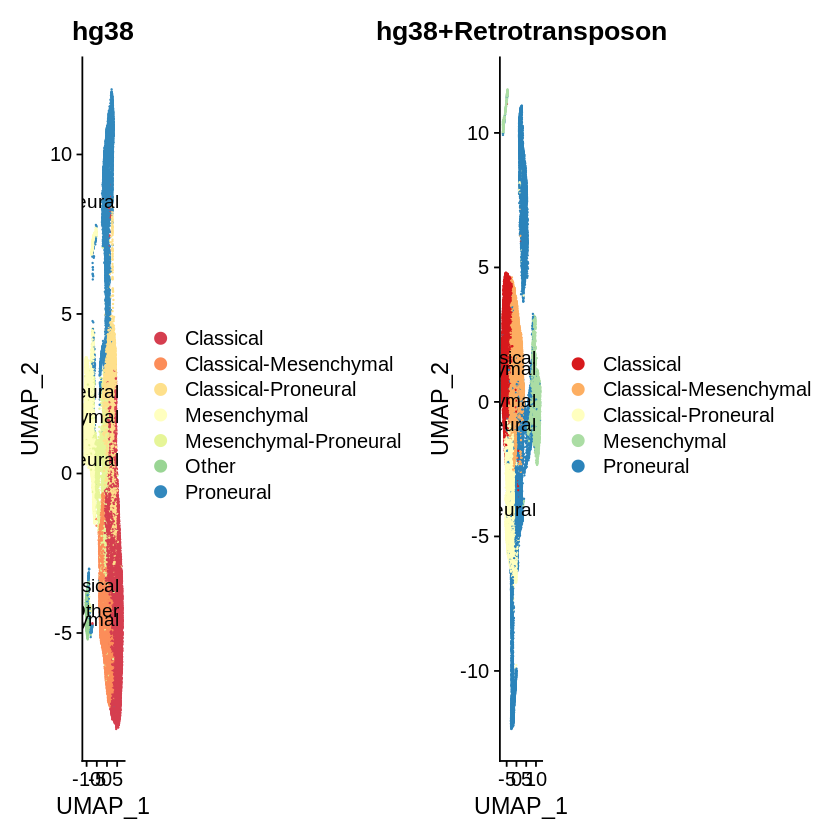

In [27]:
Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"


p <- DimPlot(s_objs[[1]], reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("hg38")
p2 <- DimPlot(s_objs[[2]], reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("hg38+Retrotransposon")
p+p2

p3 <- DimPlot(s_objs[[1]], reduction = "umap", label = TRUE, repel = TRUE)
p4 <- DimPlot(s_objs[[2]], reduction = "umap", label = TRUE, repel = TRUE) 

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/GBMSC_gsea_UMAP-PC20r03.pdf", 
    width = size*2, height = size*1.5)
grid.arrange(p,p2,p3,p4, nrow = 2, top="GSEA Results")
dev.off()

png 
  2

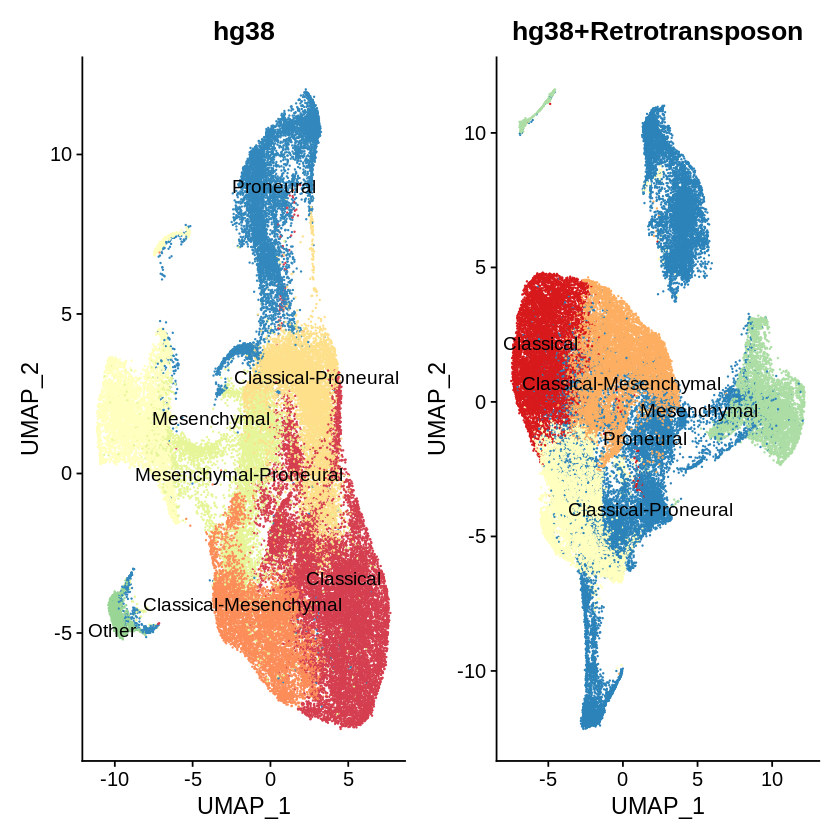

In [26]:
Idents(s_objs[[1]]) <- "integrated_snn_res.0.3"
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"


p <- DimPlot(s_objs[[1]], reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("hg38") & NoLegend()
p2 <- DimPlot(s_objs[[2]], reduction = "umap", group.by = "gbm_subtype", label = TRUE, repel = TRUE) + 
    scale_color_brewer(palette = "Spectral") + ggtitle("hg38+Retrotransposon") & NoLegend()
p+p2

p3 <- DimPlot(s_objs[[1]], reduction = "umap", label = TRUE, repel = TRUE) & NoLegend()
p4 <- DimPlot(s_objs[[2]], reduction = "umap", label = TRUE, repel = TRUE) & NoLegend()

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/GBMSC_gsea_UMAP-PC20r03_nolegends.pdf", 
    width = size*1.5, height = size*1.5)
grid.arrange(p,p2,p3,p4, nrow = 2, top="GSEA Results")
dev.off()

In [17]:
## save seurat_objets
# mkdirToday()
saveRDS(s_objs[[1]], file="~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/ge_gbmscIntUmap-subtypes.rds")
saveRDS(s_objs[[2]], file="~/scratch/gete-gbm/results/GBMSC_GSEA-aug31/gte_gbmscIntUmap-subtypes.rds")

In [35]:
### Summarize Cell Counts of GBM datasets per 
library(dplyr)

ge_meta <- s_objs[[1]]@meta.data %>% 
  group_by(sampleCombined, gbm_subtype) %>% 
  summarise(count = n()) %>% 
  mutate(perc = count/sum(count))

head(ge_meta)

gte_meta <- s_objs[[2]]@meta.data %>% 
  group_by(sampleCombined, gbm_subtype) %>% 
  summarise(count = n()) %>% 
  mutate(perc = count/sum(count))

head(gte_meta)

`summarise()` has grouped output by 'sampleCombined'. You can override using the `.groups` argument.



sampleCombined,gbm_subtype,count,perc
<fct>,<chr>,<int>,<dbl>
SF11159,Classical,1166,0.41259731
SF11159,Classical-Mesenchymal,430,0.15215853
SF11159,Classical-Proneural,420,0.14861996
SF11159,Mesenchymal,350,0.12384996
SF11159,Mesenchymal-Proneural,37,0.01309271
SF11159,Other,271,0.09589526


`summarise()` has grouped output by 'sampleCombined'. You can override using the `.groups` argument.



sampleCombined,gbm_subtype,count,perc
<fct>,<chr>,<int>,<dbl>
SF11159,Classical,566,0.19416810
SF11159,Classical-Mesenchymal,535,0.18353345
SF11159,Classical-Proneural,307,0.10531732
SF11159,Mesenchymal,146,0.05008576
SF11159,Proneural,1361,0.46689537
SF11209,Classical,2101,0.28534565


In [ ]:
### Create the Barplot
p <- ge_meta %>%
    ggplot(aes(x=sampleCombined, y=perc*100, fill=gbm_subtype)) + 
    labs(fill="samples") + labs(x = "", y = "Cells (%)", fill="GBM Subtypes") +
    geom_bar(stat="identity") +
    theme_classic() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("hg38") + theme(plot.title = element_text(hjust=0.5, face="bold"))

p2 <- gte_meta %>%
    ggplot(aes(x=sampleCombined, y=perc*100, fill=gbm_subtype)) + 
    labs(fill="samples") + labs(x = "", y = "Cells (%)", fill="GBM Subtypes") +
    geom_bar(stat="identity") +
    theme_classic() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("hg38 + Retrotransposons") + theme(plot.title = element_text(hjust=0.5, face="bold"))

In [ ]:
# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/GBMSC_GSEA-aug31/r_gbmsc_PC20r03_PercGBMSubtypesPerSample.pdf", width = size*2, height = size)
grid.arrange(p, p2, nrow = 1, top="GBM + Neural Stem cells\nPercentage of cells classified as Verhaak et.al. or Wang et.al. GBM subtypes")
dev.off()

Repeat the Analysis with PC20 resolution 0.7 seurat object to improve the separation.

In [13]:
## load seurat_objets: ge_gbm.sc.int.umap0.7, gte_gbm.sc.int.umap0.7
load("~/scratch/gete-gbm/results/2021-07-27/ge_gbm.sc.int.umap0.7_gsea.RData")
load("~/scratch/gete-gbm/results/2021-07-27/gte_gbm.sc.int.umap0.7_gsea.RData")

In [14]:
head(ge_gbm.sc.int.umap0.7@meta.data)
head(gte_gbm.sc.int.umap0.7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,11916,4509,0.8964581,0.008308157,AAACCTGCAATTCCTT-1,SF11159_2,11916,4509,7,7,GBM1,0,0,1,1,TRUE,SF11159,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,4061,1671,0.8931295,0.068456045,AAACCTGCACAGAGGT-1,SF11159_2,4061,1671,3,3,GBM1,0,0,8,8,TRUE,SF11159,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,4314,2102,0.9140969,0.070931850,AAACCTGGTGTGGCTC-1,SF11159_2,4314,2102,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAACGGGGTCCGAATT-1,1,7251,2943,0.8985577,0.084402151,AAACGGGGTCCGAATT-1,SF11159_2,7251,2943,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAACGGGTCGAATGGG-1,1,1708,1049,0.9345048,0.066159251,AAACGGGTCGAATGGG-1,SF11159_2,1708,1049,0,0,GBM1,0,0,0,0,TRUE,SF11159,Classical
GBM_AAAGATGGTCTCAACA-1,1,5158,2538,0.9170394,0.017642497,AAAGATGGTCTCAACA-1,SF11159_2,5158,2538,14,14,GBM1,0,0,0,0,TRUE,SF11159,Classical


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,GBM_seurat_clusters,neuro.ident,nCount_integrated,nFeature_integrated,integrated_snn_res.0.7,seurat_clusters,MGMTme,sampleCombined,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<fct>,<fct>,<lgl>,<fct>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,3,GBM1,0,0,1,1,TRUE,SF11232,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,4,GBM1,0,0,5,5,TRUE,SF11232,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,0,GBM1,0,0,0,0,TRUE,SF11232,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,0,GBM1,0,0,0,0,TRUE,SF11232,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,0,GBM1,0,0,2,2,TRUE,SF11232,Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,8,GBM1,0,0,4,4,TRUE,SF11232,Proneural


In [15]:
### Summarize Cell Counts of GBM datasets per 
library(dplyr)

ge_meta <- ge_gbm.sc.int.umap0.7@meta.data %>% 
  group_by(sampleCombined, gbm_subtype) %>% 
  summarise(count = n()) %>% 
  mutate(perc = count/sum(count))

head(ge_meta)

gte_meta <- gte_gbm.sc.int.umap0.7@meta.data %>% 
  group_by(sampleCombined, gbm_subtype) %>% 
  summarise(count = n()) %>% 
  mutate(perc = count/sum(count))

head(gte_meta)

`summarise()` has grouped output by 'sampleCombined'. You can override using the `.groups` argument.



sampleCombined,gbm_subtype,count,perc
<fct>,<chr>,<int>,<dbl>
SF11159,Classical,1241,0.4391366
SF11159,Classical-Mesenchymal,376,0.1330502
SF11159,Mesenchymal,350,0.1238500
SF11159,NA,410,0.1450814
SF11159,Proneural,449,0.1588818
SF11209,Classical,1481,0.4660164


`summarise()` has grouped output by 'sampleCombined'. You can override using the `.groups` argument.



sampleCombined,gbm_subtype,count,perc
<fct>,<chr>,<int>,<dbl>
SF11159,Classical,717,0.2459691
SF11159,Classical-Mesenchymal,315,0.1080617
SF11159,Mesenchymal,141,0.0483705
SF11159,NA,487,0.1670669
SF11159,Proneural,1255,0.4305317
SF11209,Classical,2813,0.3820454


In [16]:
### Create the Barplot
p <- ge_meta %>%
    ggplot(aes(x=sampleCombined, y=perc*100, fill=gbm_subtype)) + 
    labs(fill="samples") + labs(x = "", y = "Cells (%)", fill="GBM Subtypes") +
    geom_bar(stat="identity") +
    theme_classic() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("hg38") + theme(plot.title = element_text(hjust=0.5, face="bold"))

p2 <- gte_meta %>%
    ggplot(aes(x=sampleCombined, y=perc*100, fill=gbm_subtype)) + 
    labs(fill="samples") + labs(x = "", y = "Cells (%)", fill="GBM Subtypes") +
    geom_bar(stat="identity") +
    theme_classic() + theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1)) +
    ggtitle("hg38 + Retrotransposons") + theme(plot.title = element_text(hjust=0.5, face="bold"))

In [17]:
# Save figure of cell count
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/GBMSC_GSEA-aug31/r_gbmsc_PC20r07_PercGBMSubtypesPerSample.pdf", width = size*2, height = size)
grid.arrange(p, p2, nrow = 1, top="GBM + Neural Stem cells (PC20 res0.7)\nPercentage of cells classified as Verhaak et.al. or Wang et.al. GBM subtypes")
dev.off()

png 
  2

## Fig % of Retrotransposons
2021-09-03:

In [6]:
## load seurat objects (also another copy in GBMSC_GSEA-aug31)
s_objs <- vector(mode="list", length=2)
s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 

In [7]:
## load list of TE genes
te_genes <- read.table("~/scratch/gete-gbm/data/geneName_TE_v23gtf.txt", 
               sep=",", header = TRUE,
               col.names=c("gene_id", "TE_class"), 
               fill=FALSE, 
               strip.white=TRUE)

te_genes$gene_id <- sub("_", "-", te_genes$gene_id)
rownames(te_genes) <- te_genes$gene_id

dim(te_genes)
head(te_genes,10)

[1] 1180    2

,gene_id,TE_class
,<chr>,<chr>
TAR1,TAR1,Satellite
L1MC5a,L1MC5a,LINE
MER5B,MER5B,DNA
MIR3,MIR3,SINE
L2a,L2a,LINE
L3,L3,LINE
Plat-L3,Plat-L3,LINE
MLT1K,MLT1K,LTR
MIR,MIR,SINE


In [8]:
## TE genes not in Seurat object must be removed 
# matched <- match(unique(te_genes$gene_id), rownames(s_objs[[1]]@assays$RNA@data))
matched <- intersect(unique(te_genes$gene_id), rownames(s_objs[[2]]@assays$RNA@data))
length(matched)
dim(te_genes)
non.matched <- unique(te_genes$gene_id)[!unique(te_genes$gene_id) %in% matched]
non.matched
length(non.matched)
    # all retrotransposons are being expressed

[1] 1160

[1] 1180    2

[1] "L4-B_Mam"      "L4-A_Mam"      "L4-C_Mam"      "UCON88"       
 [5] "UCON57"        "UCON85"        "MER133A"       "UCON41"       
 [9] "UCON59"        "L2-3-AMi"      "UCON71"        "Chompy-7-Croc"
[13] "Chompy-6-Croc" "UCON100"       "HERV-Fc2-int"  "UCON56"       
[17] "UCON87"        "UCON68"        "UCON92"        "HSAT6"

[1] 20

In [45]:
# Compute percentage of retrotransposons
DefaultAssay(s_objs[[2]]) <- "RNA"
s_objs[[2]]$teRatio <- PercentageFeatureSet(object = s_objs[[2]], features = te_genes$gene_id)
head(s_objs[[2]]@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,0,TRUE,SF11232,1,1,1,1,0,28.69794,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,TRUE,SF11232,4,4,5,5,5,31.89670,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,1,TRUE,SF11232,2,0,0,0,1,45.13094,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,1,TRUE,SF11232,2,0,0,0,1,49.49516,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,TRUE,SF11232,0,2,3,2,2,39.06529,Classical-Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,3,TRUE,SF11232,0,2,2,2,3,24.85069,Classical-Proneural


In [46]:
## save seurat object
saveRDS(s_objs[[2]], file="~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds")

In [7]:
Idents(s_objs[[2]]) <- "integrated_snn_res.0.3"

In [8]:
summary(s_objs[[2]]$teRatio)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  2.479  19.926  26.122  27.170  33.319  76.405 

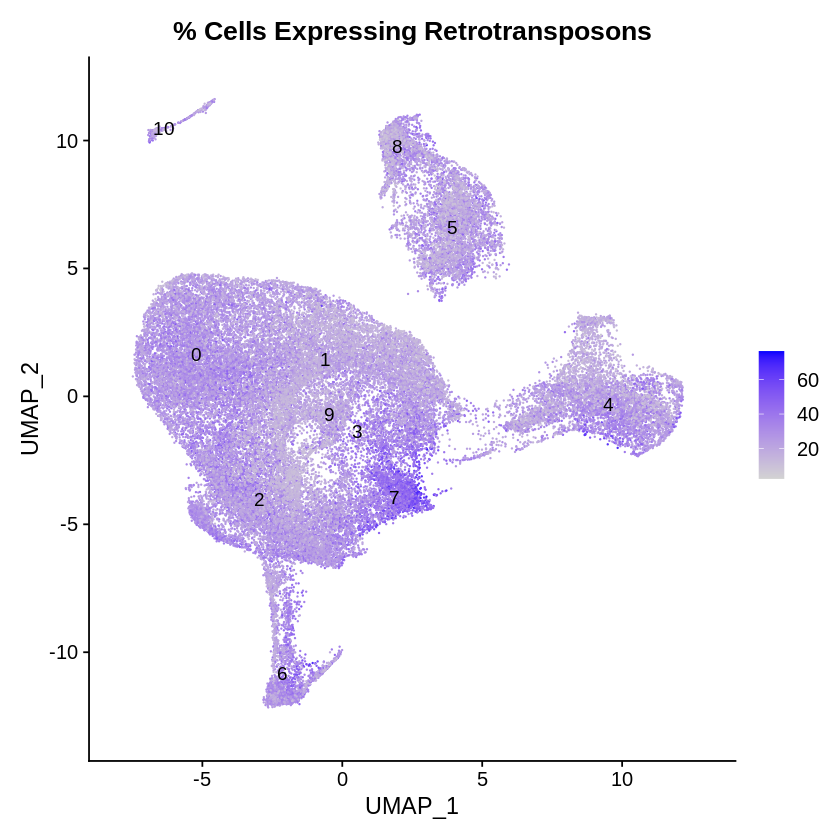

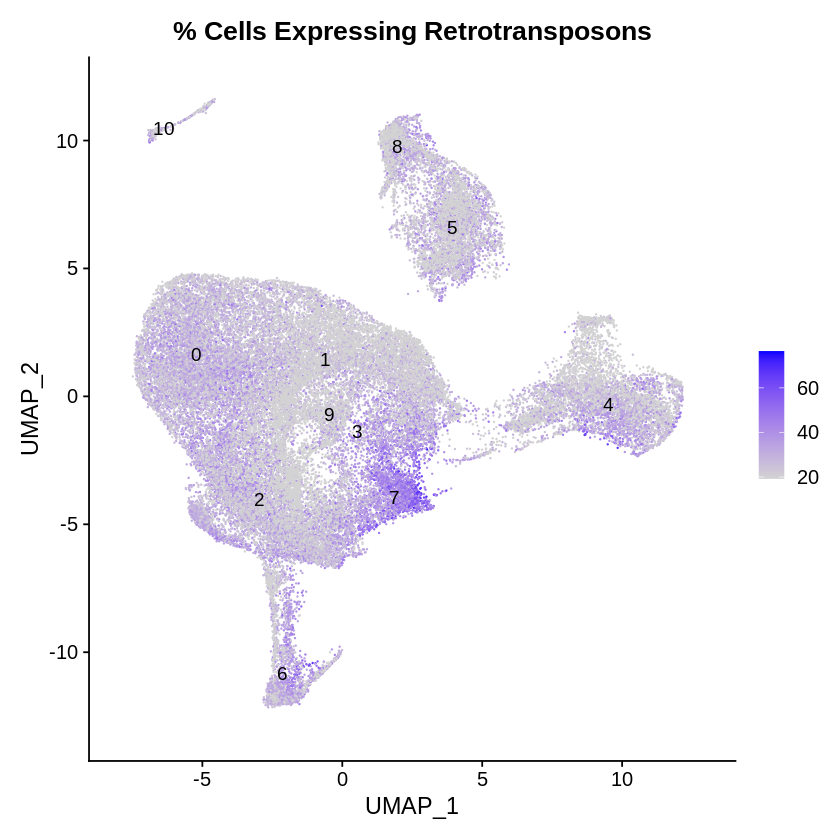

In [87]:
p1 <- FeaturePlot(s_objs[[2]], features = "teRatio", reduction = "umap", label = TRUE) + 
    ggtitle("% Cells Expressing Retrotransposons")
p2 <- FeaturePlot(s_objs[[2]], features = "teRatio", reduction = "umap", min.cutoff=19.26, label = TRUE) + 
    ggtitle("% Cells Expressing Retrotransposons")
p1
p2

In [88]:
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-09-02/r_gbmsc_PC20r03_teRatioFeaturePlots.pdf", width = size, height = size)
grid.arrange(p1)
grid.arrange(p2)
dev.off()

png 
  2

Create Bar Plot (with standard deviations)

In [63]:
## summarize mean teRatio and sd in new plot

df <- s_objs[[2]]@meta.data %>% 
    dplyr::group_by(integrated_snn_res.0.3) %>%
    dplyr::summarize(mean = mean(teRatio), sd = sd(teRatio))
names(df) <- c("cluster", "mean", "sd")
head(df)

cluster,mean,sd
<fct>,<dbl>,<dbl>
0,27.71907,7.163859
1,22.74843,7.617159
2,29.04682,9.173376
3,28.30153,9.564094
4,23.77087,8.801464
5,25.97131,8.870836


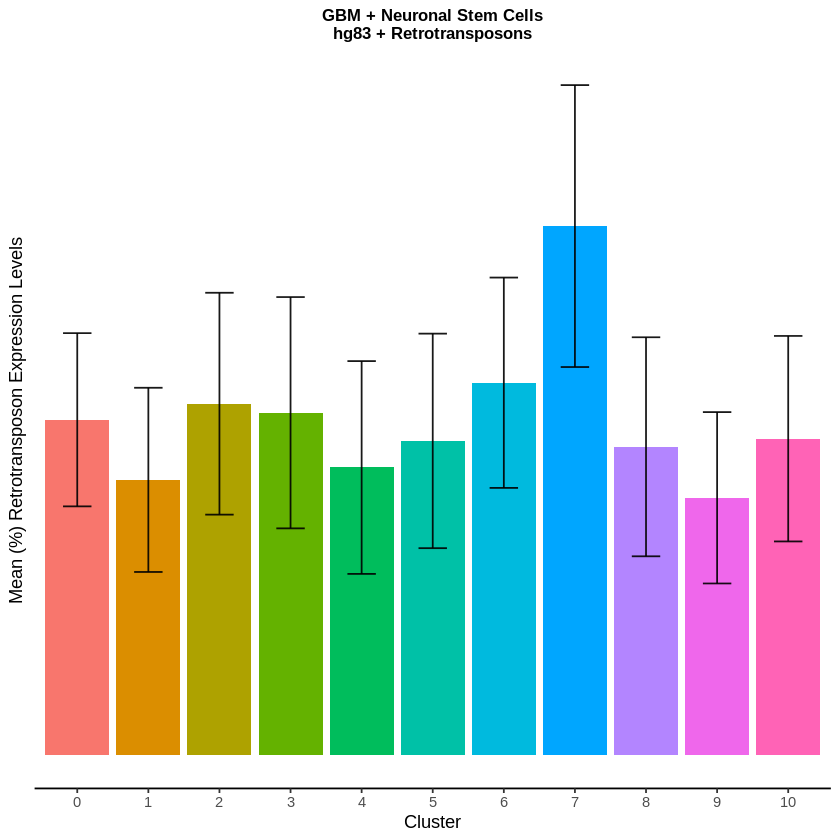

In [64]:
p <- df %>% ggplot(aes(x=cluster, y=mean, fill=cluster)) + geom_bar( stat="identity", width = 0.9) +
        geom_errorbar( aes(x=cluster, ymin=mean-sd, ymax=mean+sd), width=0.4, colour="black", alpha=0.9, size=0.5) + 
        theme_classic() + 
        ggtitle("GBM + Neuronal Stem Cells\nhg83 + Retrotransposons") + labs(y = "Mean (%) Retrotransposon Expression Levels", x = "Cluster") +
        theme(legend.position="none", plot.title = element_text(hjust = 0.5, size = 10, face = "bold"),
             axis.text.y = element_blank(), axis.ticks.y = element_blank(), axis.line.y = element_blank())
p

In [65]:
# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-09-02/r_gbmsc_PC20r03_teRatioBarPlots.pdf", width = size, height = size)
p
dev.off()

png 
  2

An issue I can see with performing comparisons between clusters is the percentage of RT expression across clusters could vary between each cluster because they vary in the number of cells. 

### Statistical Significance of Cluster 7

In [69]:
## select columns

df <- s_objs[[2]]@meta.data %>% 
    dplyr::select(c(integrated_snn_res.0.3, teRatio))
head(df)

,integrated_snn_res.0.3,teRatio
,<fct>,<dbl>
GBM_AAACCTGCAATTCCTT-1,1,28.69794
GBM_AAACCTGCACAGAGGT-1,4,31.89670
GBM_AAACCTGGTGTGGCTC-1,0,45.13094
GBM_AAACGGGGTCCGAATT-1,0,49.49516
GBM_AAACGGGTCGAATGGG-1,2,39.06529
GBM_AAAGATGGTCTCAACA-1,2,24.85069


In [24]:
## Levene's test: Equal Variance Assumption
library(lawstat) # v3.4

levene.test(y = df$teRatio, group = df$`integrated_snn_res.0.3`)
levene.test(y = df$teRatio, group = df$`integrated_snn_res.0.3`, location = "mean")
    # H_0: the groups we are comparing have equal variances.
    # Result: the groups we are comparing have different variances, therefore we should not continue with the ANOVA and Post-hoc analysis.

## ANOVA: Categorical Independent Variable x Continuous Dependent variable
summary(stats::aov(teRatio ~ integrated_snn_res.0.3, data = df))
    # H_0: There are no differences between the There are significant differences between groups

## Multiple Comparison Test between Cluster 7 vs others 


	Modified robust Brown-Forsythe Levene-type test based on the absolute
	deviations from the median

data:  df$teRatio
Test Statistic = 189.23, p-value < 2.2e-16



	Classical Levene's test based on the absolute deviations from the mean
	( none not applied because the location is not set to median )

data:  df$teRatio
Test Statistic = 194.82, p-value < 2.2e-16


                          Df  Sum Sq Mean Sq F value Pr(>F)    
integrated_snn_res.0.3    10  910185   91019    1222 <2e-16 ***
Residuals              49659 3699994      75                   
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

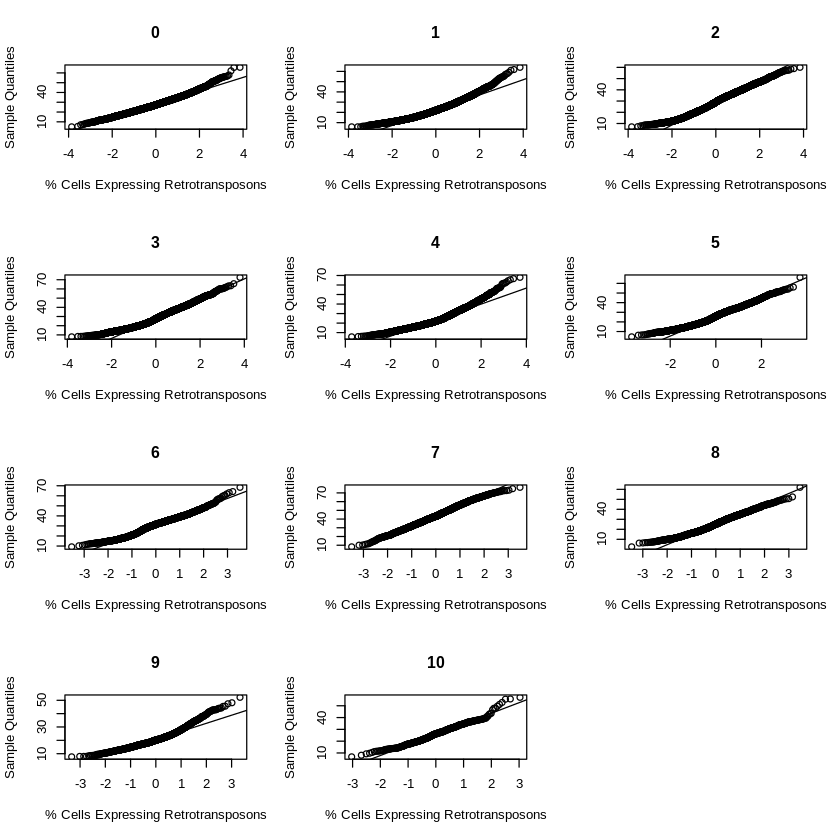

In [32]:
## Step-back - we can't assume normality, so use Kruskal-wallis rank-based test 

## Q-Q plot: Test normal distribution of data
layout <- par(mfrow=c(4, 3))
for (i in levels(df$`integrated_snn_res.0.3`)) {
    tmp <- with(df, teRatio[integrated_snn_res.0.3 == i])
    qqnorm(tmp, xlab = "% Cells Expressing Retrotransposons", main = i)
    qqline(tmp)
}
par(layout)
rm(i, tmp)

# Save figures
size = 7
pdf("~/scratch/gete-gbm/results/2021-09-02/r_gbmsc_PC20r03_teRatioQQ.pdf", width = size, height = size)
for (i in levels(df$`integrated_snn_res.0.3`)) {
    tmp <- with(df, teRatio[integrated_snn_res.0.3 == i])
    qqnorm(tmp, xlab = "% Cells Expressing Retrotransposons", main = i)
    qqline(tmp)
}
par(layout)
dev.off()

ERROR: Error in shapiro.test(df$teRatio): sample size must be between 3 and 5000


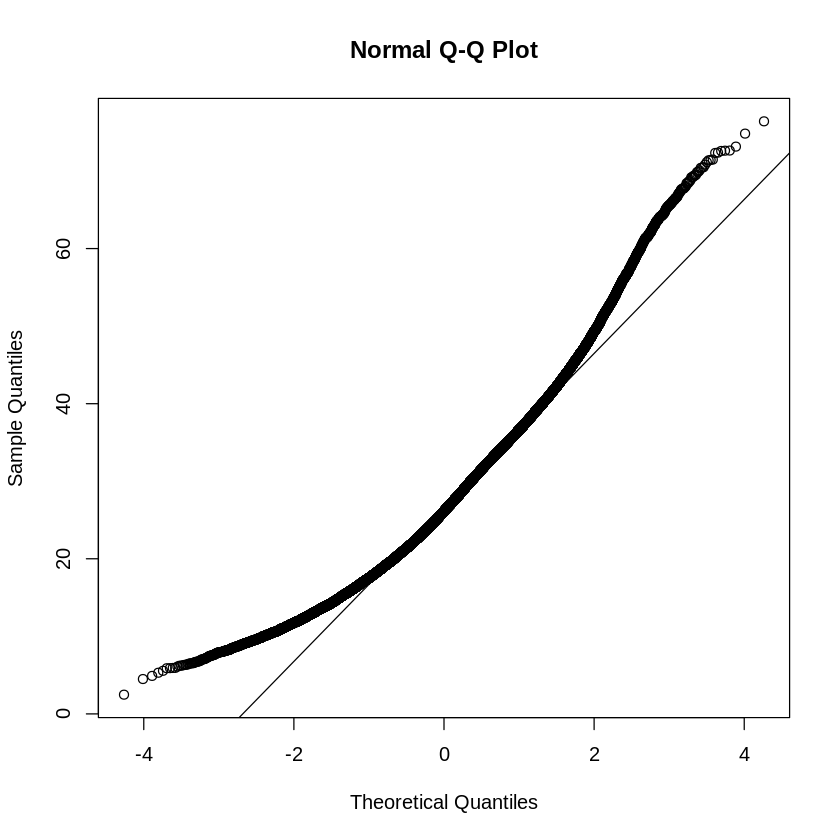

In [54]:
qqnorm(df$teRatio)
qqline(df$teRatio)
shapiro.test(df$teRatio)

The distribution of the raw data shows there is a short tail on the left and a long-tail on the right. 

In [8]:
lm.df <- lm(teRatio ~ integrated_snn_res.0.3, data = df)
anova(lm.df)

,Df,Sum Sq,Mean Sq,F value,Pr(>F)
,<int>,<dbl>,<dbl>,<dbl>,<dbl>
integrated_snn_res.0.3,10,910185.5,91018.54946,1221.594,0
Residuals,49659,3699993.5,74.50802,NA,NA


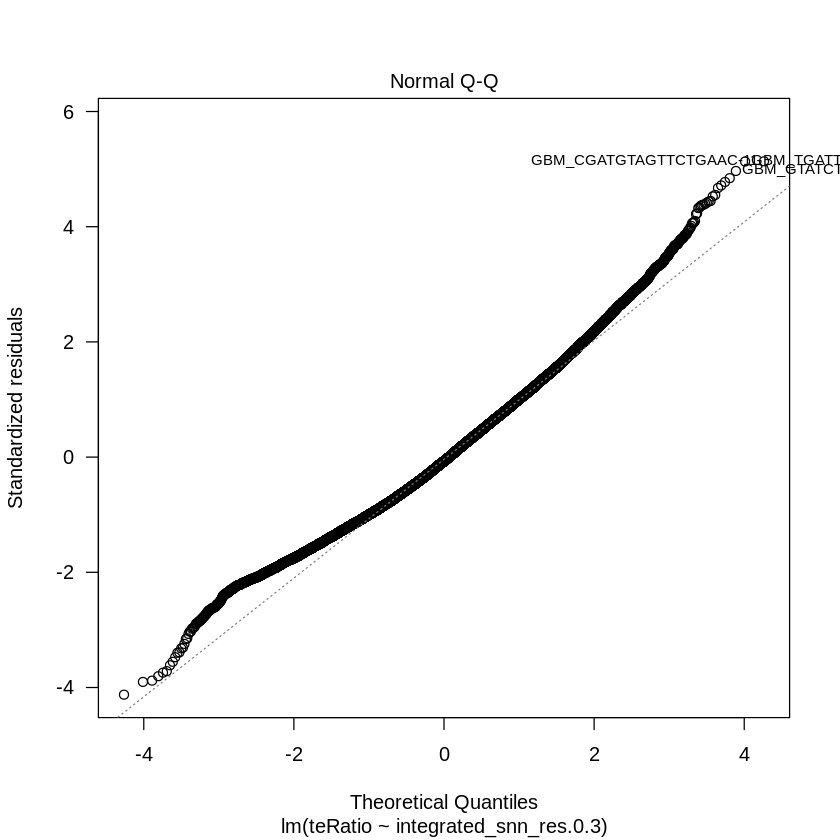

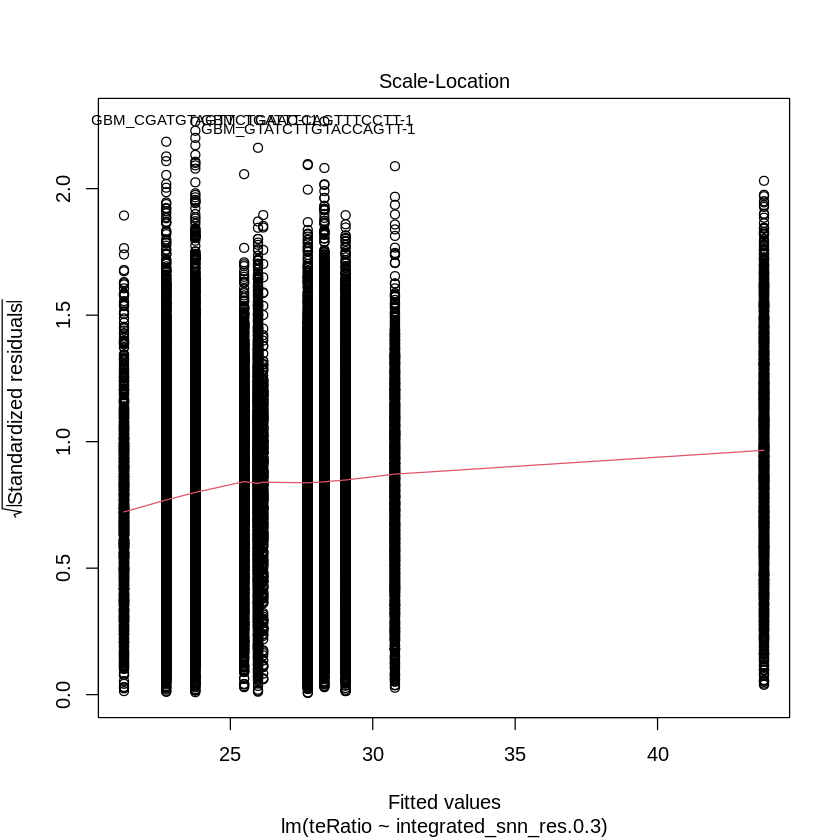

In [11]:
plot(lm.df, which = 2, las = 1)
plot(lm.df, which = 3)

In [17]:
library(moments)
skewness(df$teRatio)
    # slightly skewed, but not extreme
kurtosis(df$teRatio)

skewness(lm.df$residuals)
kurtosis(lm.df$residuals)

[1] 0.6789603

[1] 3.63119

[1] 0.4064439

[1] 3.207078

The skewness is slightly to the the right (positively skewed) and the kurtosis measure is above 0 meaning it leptokurtic. It's not normal in the sense that the tails are too short. The skewness is still acceptable. 

### Attempt a rank transformation

In [21]:
## Try rank transformation, then test for equality of variance
teRatio.ranked <- rank(df$teRatio)

ranked.df <- data.frame(cluster = df$`integrated_snn_res.0.3`, 
                       teRatio.ranked = teRatio.ranked, 
                       teRatio.origin = df$teRatio)
lm.ranked.df <- lm(teRatio.ranked ~ cluster, data = ranked.df)
anova(lm.ranked.df)

,Df,Sum Sq,Mean Sq,F value,Pr(>F)
,<int>,<dbl>,<dbl>,<dbl>,<dbl>
cluster,10,1.553573e+12,155357293479,891.0496,0
Residuals,49659,8.658202e+12,174353128,NA,NA


,cluster,teRatio.ranked,teRatio.origin
,<fct>,<dbl>,<dbl>
1,1,29569,28.69794
2,4,34967,31.89670
3,0,47554,45.13094
4,0,48583,49.49516
5,2,44195,39.06529
6,2,22449,24.85069


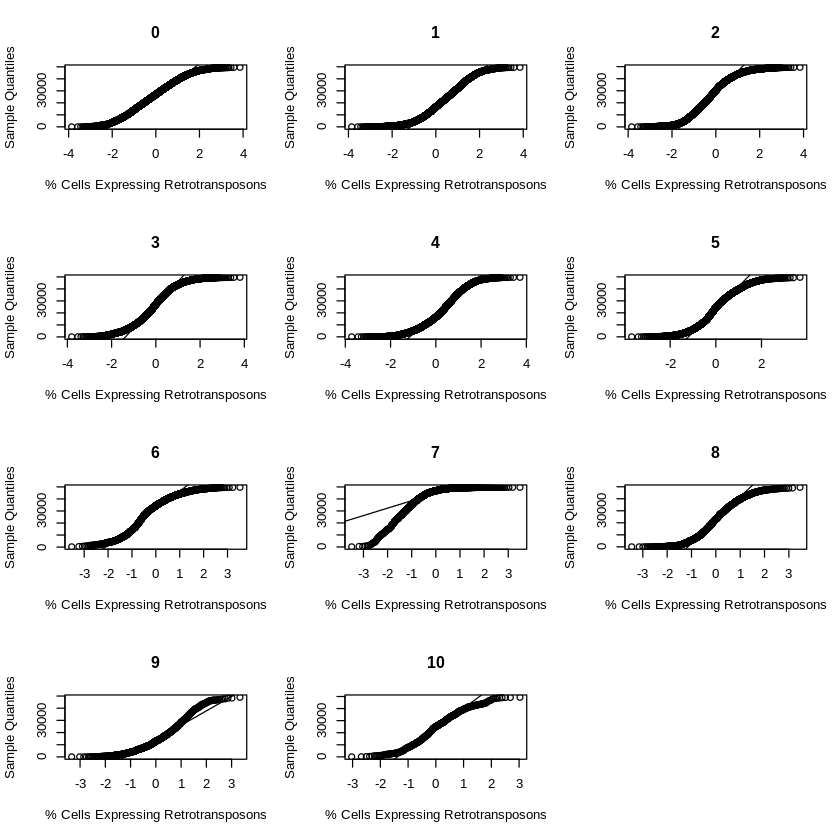

In [25]:
head(ranked.df)

## Q-Q plot: Test normal distribution of data
layout <- par(mfrow=c(4, 3))
for (i in levels(ranked.df$cluster)) {
    tmp <- with(ranked.df, teRatio.ranked[cluster == i])
    qqnorm(tmp, xlab = "% Cells Expressing Retrotransposons", main = i)
    qqline(tmp)
}
par(layout)
rm(i, tmp)

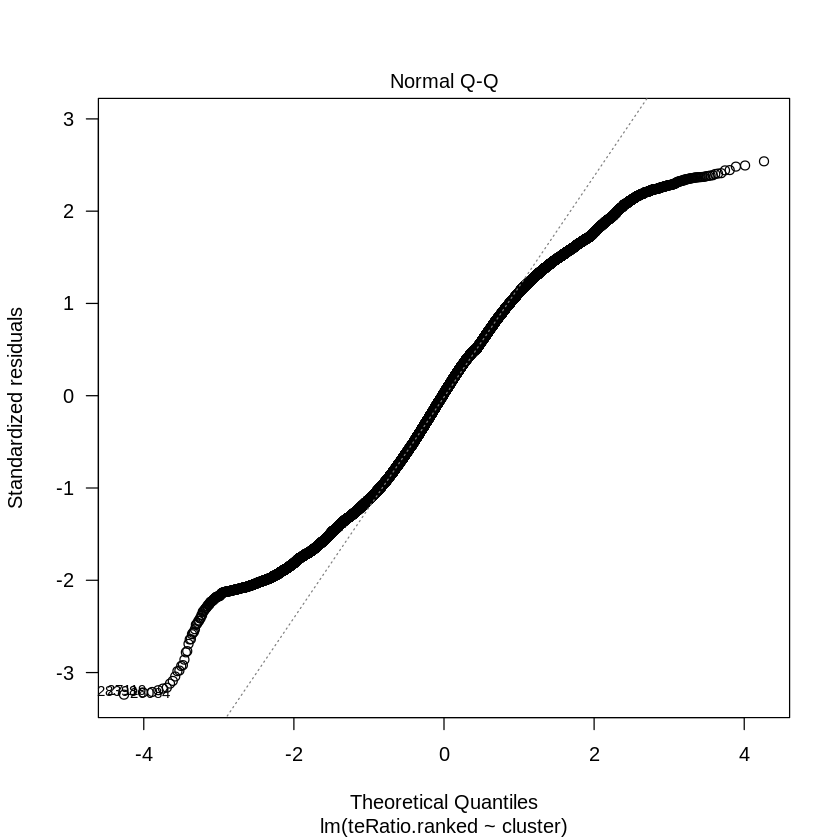

[1] -0.01393873

[1] 2.11202

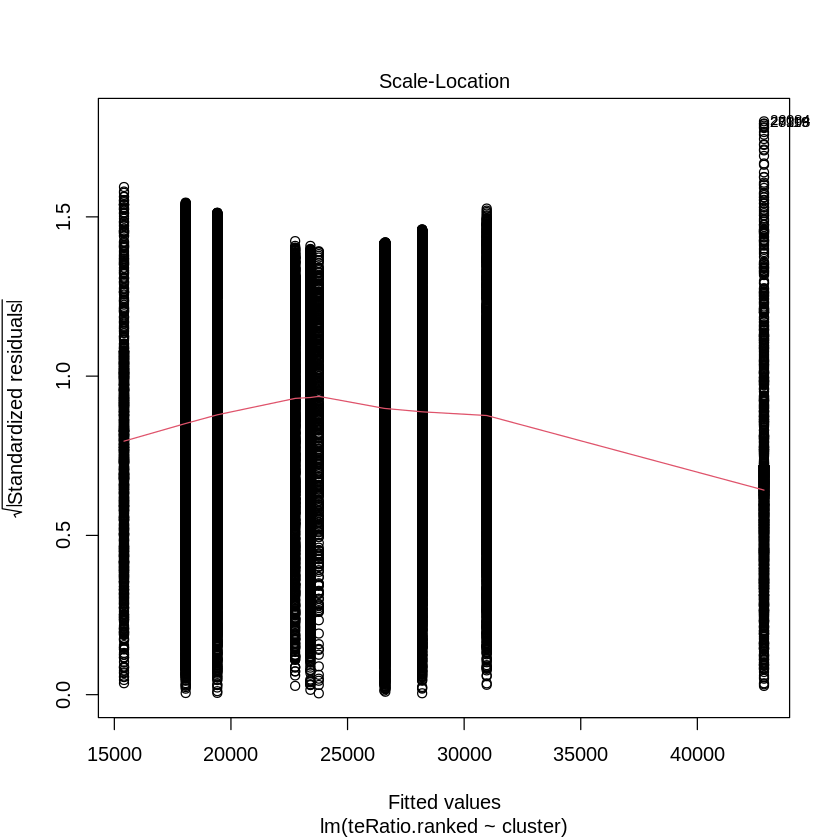

In [22]:
plot(lm.ranked.df, which = 2, las = 1)
plot(lm.ranked.df, which = 3)

skewness(lm.ranked.df$residuals)
kurtosis(lm.ranked.df$residuals)

Rank transformation made the distribution worse.

### Attempt a log transformation

In [39]:
df$teRatio.logged <- log10(df$teRatio)
head(df)

,integrated_snn_res.0.3,teRatio,teRatio.logged
,<fct>,<dbl>,<dbl>
GBM_AAACCTGCAATTCCTT-1,1,28.69794,1.457851
GBM_AAACCTGCACAGAGGT-1,4,31.89670,1.503746
GBM_AAACCTGGTGTGGCTC-1,0,45.13094,1.654474
GBM_AAACGGGGTCCGAATT-1,0,49.49516,1.694563
GBM_AAACGGGTCGAATGGG-1,2,39.06529,1.591791
GBM_AAAGATGGTCTCAACA-1,2,24.85069,1.395338


[1] -0.3066902

[1] 2.956143

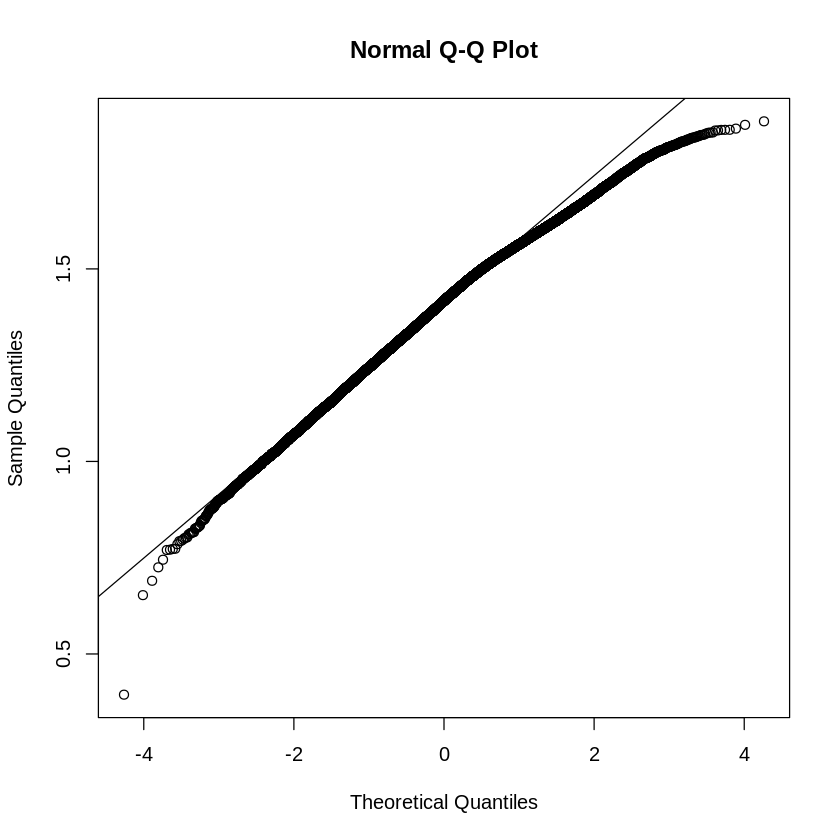

In [50]:
qqnorm(df$teRatio.logged)
qqline(df$teRatio.logged)

skewness(df$teRatio.logged)
kurtosis(df$teRatio.logged)

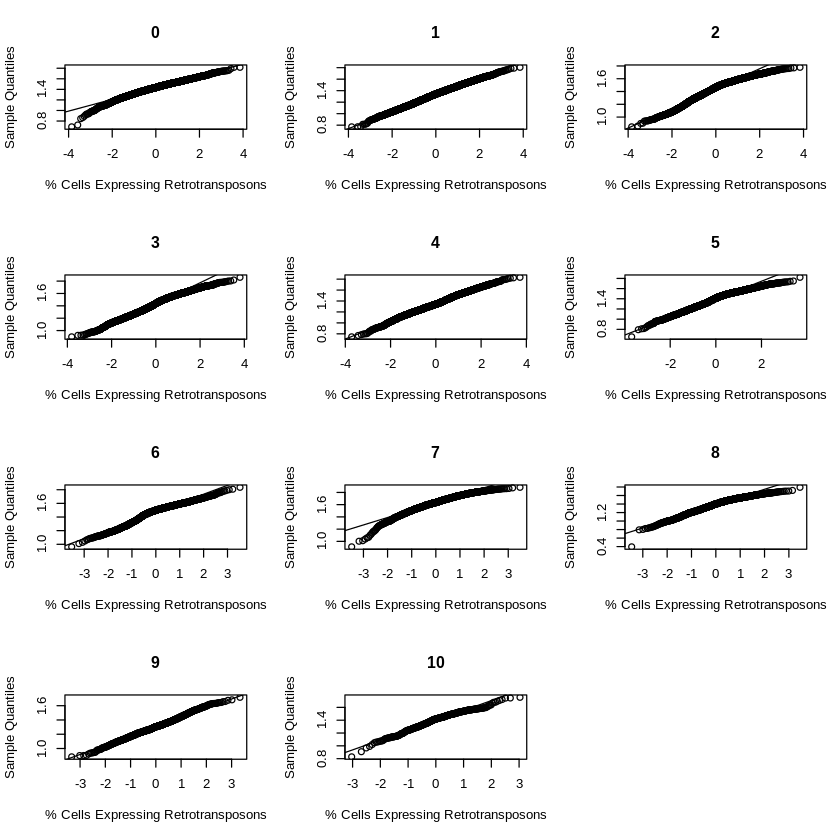

In [41]:
## Q-Q plot: Test normal distribution of data
layout <- par(mfrow=c(4, 3))
for (i in levels(df$`integrated_snn_res.0.3`)) {
    tmp <- with(df, teRatio.logged[integrated_snn_res.0.3 == i])
    qqnorm(tmp, xlab = "% Cells Expressing Retrotransposons", main = i)
    qqline(tmp)
}
par(layout)
rm(i, tmp)

In [39]:
df$teRatio.logged <- log10(df$teRatio)
head(df)

,integrated_snn_res.0.3,teRatio,teRatio.logged
,<fct>,<dbl>,<dbl>
GBM_AAACCTGCAATTCCTT-1,1,28.69794,1.457851
GBM_AAACCTGCACAGAGGT-1,4,31.89670,1.503746
GBM_AAACCTGGTGTGGCTC-1,0,45.13094,1.654474
GBM_AAACGGGGTCCGAATT-1,0,49.49516,1.694563
GBM_AAACGGGTCGAATGGG-1,2,39.06529,1.591791
GBM_AAAGATGGTCTCAACA-1,2,24.85069,1.395338


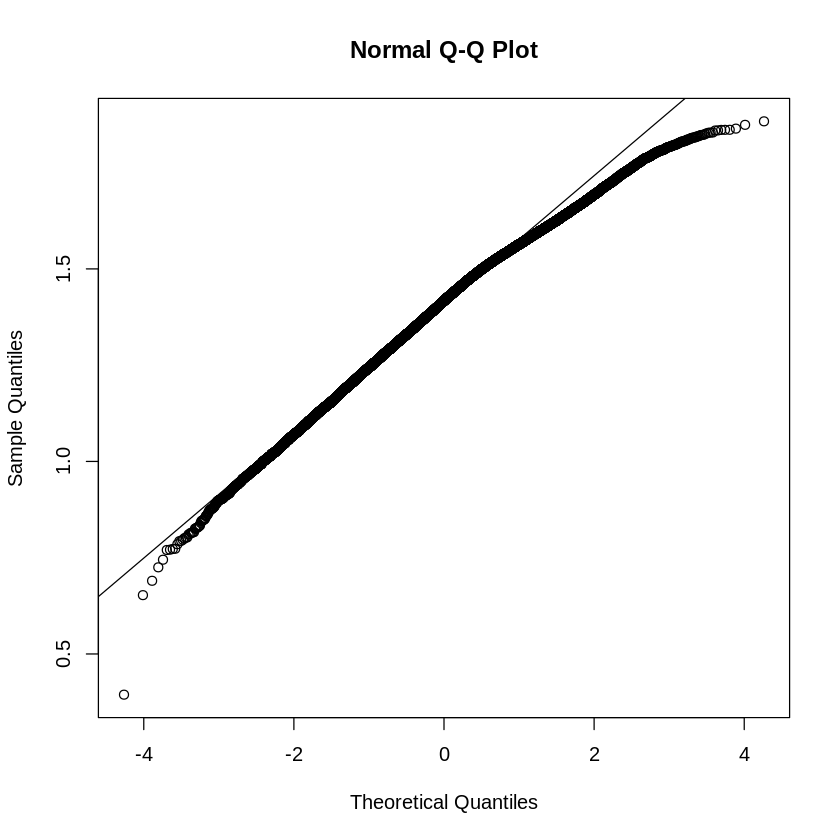

In [40]:
qqnorm(df$teRatio.logged)
qqline(df$teRatio.logged)

In [51]:
## Levene's test: Equal Variance Assumption
library(lawstat) # v3.4

levene.test(y = df$teRatio.logged, group = df$`integrated_snn_res.0.3`)
levene.test(y = df$teRatio.logged, group = df$`integrated_snn_res.0.3`, location = "mean")
    # H_0: the groups we are comparing have equal variances.
    # Result: the groups we are comparing have different variances, therefore we should not continue with the ANOVA and Post-hoc analysis.

## ANOVA: Categorical Independent Variable x Continuous Dependent variable
summary(stats::aov(teRatio.logged ~ integrated_snn_res.0.3, data = df))
    # H_0: There are no differences between the There are significant differences between groups

## Multiple Comparison Test between Cluster 7 vs others 


	Modified robust Brown-Forsythe Levene-type test based on the absolute
	deviations from the median

data:  df$teRatio.logged
Test Statistic = 126.43, p-value < 2.2e-16



	Classical Levene's test based on the absolute deviations from the mean
	( none not applied because the location is not set to median )

data:  df$teRatio.logged
Test Statistic = 136.47, p-value < 2.2e-16


                          Df Sum Sq Mean Sq F value Pr(>F)    
integrated_snn_res.0.3    10  200.1  20.012   947.9 <2e-16 ***
Residuals              49659 1048.4   0.021                   
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

### Attempt Square transformation

In [70]:
df$teRatio.sqrt <- sqrt(df$teRatio)
head(df)

,integrated_snn_res.0.3,teRatio,teRatio.sqrt
,<fct>,<dbl>,<dbl>
GBM_AAACCTGCAATTCCTT-1,1,28.69794,5.357046
GBM_AAACCTGCACAGAGGT-1,4,31.89670,5.647716
GBM_AAACCTGGTGTGGCTC-1,0,45.13094,6.717957
GBM_AAACGGGGTCCGAATT-1,0,49.49516,7.035280
GBM_AAACGGGTCGAATGGG-1,2,39.06529,6.250223
GBM_AAAGATGGTCTCAACA-1,2,24.85069,4.985047


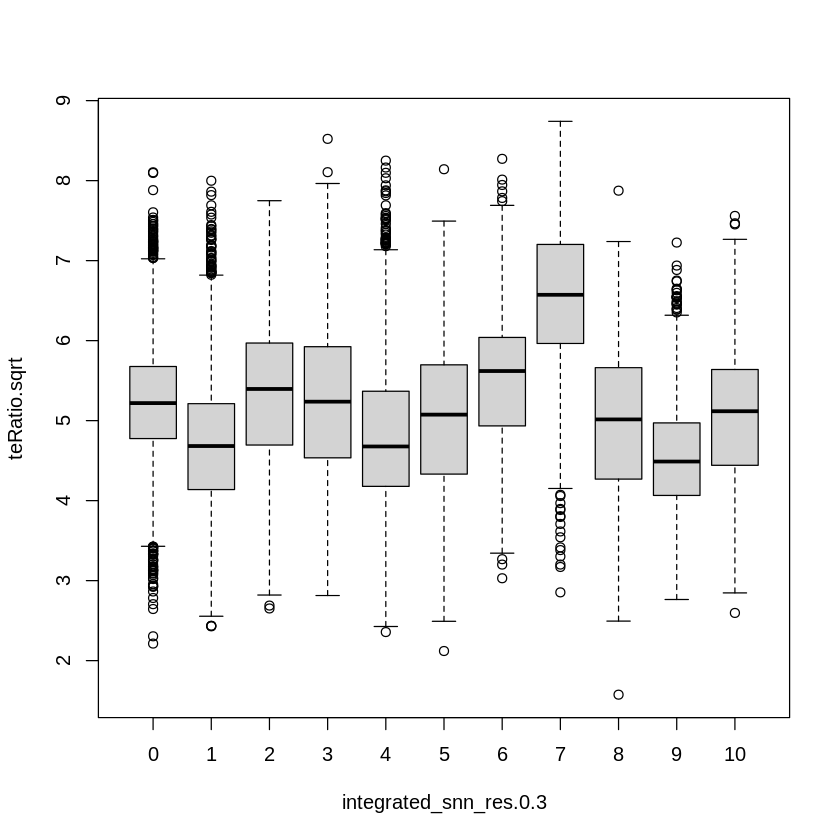

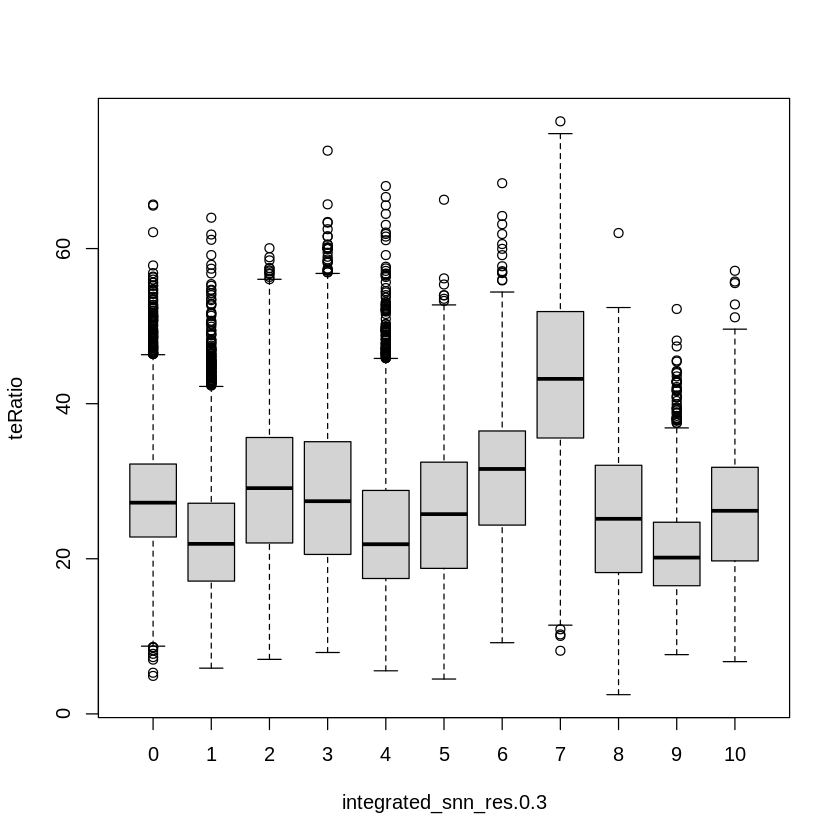

In [78]:
plot(teRatio.sqrt ~ integrated_snn_res.0.3, data=df)
plot(teRatio ~ integrated_snn_res.0.3, data=df)

[1] 0.1853528

[1] 2.863087

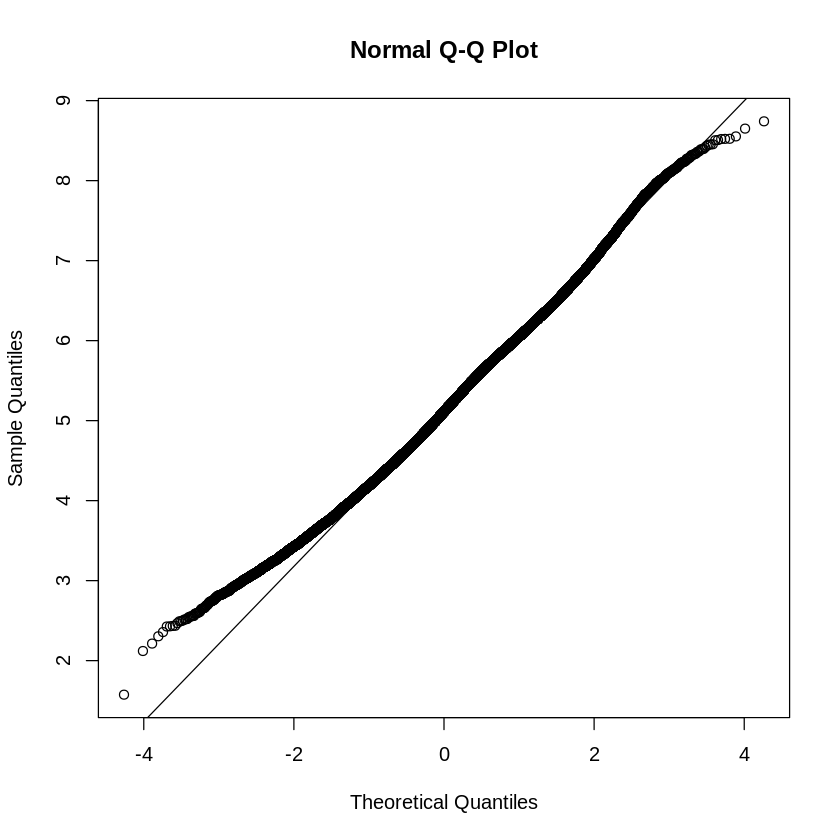

In [49]:
qqnorm(df$teRatio.sqrt)
qqline(df$teRatio.sqrt)

skewness(df$teRatio.sqrt)
kurtosis(df$teRatio.sqrt)

Skewness for cluster  0   -0.0274832051500583 
Kurtosis for cluster  0   3.29849899251335 
Skewness for cluster  1   0.279366142201457 
Kurtosis for cluster  1   2.96229395854138 
Skewness for cluster  2   -0.266287162477838 
Kurtosis for cluster  2   2.53099869542243 
Skewness for cluster  3   0.112226154978474 
Kurtosis for cluster  3   2.42636734692514 
Skewness for cluster  4   0.445303519762645 
Kurtosis for cluster  4   3.11299424350914 
Skewness for cluster  5   -0.0630414132635393 
Kurtosis for cluster  5   2.40108981307069 
Skewness for cluster  6   -0.292981849750329 
Kurtosis for cluster  6   2.74466084932306 
Skewness for cluster  7   -0.388032299201094 
Kurtosis for cluster  7   3.13564662487503 
Skewness for cluster  8   -0.172653938157477 
Kurtosis for cluster  8   2.49452395525051 
Skewness for cluster  9   0.518458716080293 
Kurtosis for cluster  9   3.24922374384078 
Skewness for cluster  10   -0.0276501187736822 
Kurtosis for cluster  10   2.86527606020712 


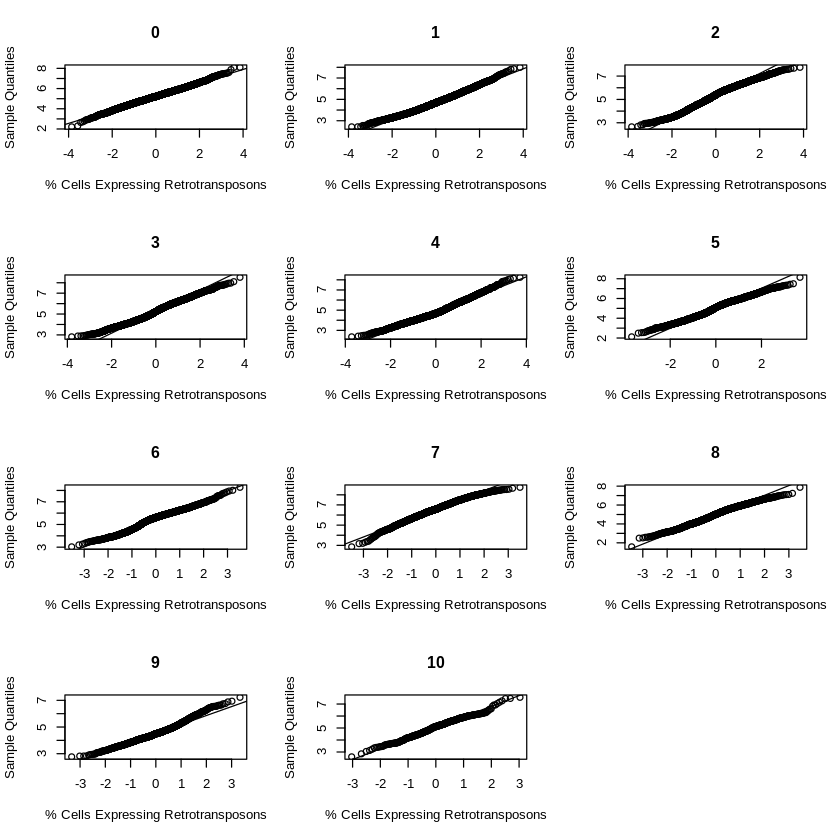

In [48]:
## Q-Q plot: Test normal distribution of data
layout <- par(mfrow=c(4, 3))
for (i in levels(df$`integrated_snn_res.0.3`)) {
    tmp <- with(df, teRatio.sqrt[integrated_snn_res.0.3 == i])
    qqnorm(tmp, xlab = "% Cells Expressing Retrotransposons", main = i)
    qqline(tmp)
    
    cat(c("Skewness for cluster ", i, " ", skewness(tmp)), "\n")
    cat(c("Kurtosis for cluster ", i, " ", kurtosis(tmp)), "\n")
}
par(layout)
rm(i, tmp)

In [52]:
## Levene's test: Equal Variance Assumption
library(lawstat) # v3.4

levene.test(y = df$teRatio.sqrt, group = df$`integrated_snn_res.0.3`)
levene.test(y = df$teRatio.sqrt, group = df$`integrated_snn_res.0.3`, location = "mean")
    # H_0: the groups we are comparing have equal variances.
    # Result: the groups we are comparing have different variances, therefore we should not continue with the ANOVA and Post-hoc analysis.

## ANOVA: Categorical Independent Variable x Continuous Dependent variable
summary(stats::aov(teRatio.sqrt ~ integrated_snn_res.0.3, data = df))
    # H_0: There are no differences between the There are significant differences between groups

## Multiple Comparison Test between Cluster 7 vs others 


	Modified robust Brown-Forsythe Levene-type test based on the absolute
	deviations from the median

data:  df$teRatio.sqrt
Test Statistic = 121.18, p-value < 2.2e-16



	Classical Levene's test based on the absolute deviations from the mean
	( none not applied because the location is not set to median )

data:  df$teRatio.sqrt
Test Statistic = 125.61, p-value < 2.2e-16


                          Df Sum Sq Mean Sq F value Pr(>F)    
integrated_snn_res.0.3    10   7484   748.4    1084 <2e-16 ***
Residuals              49659  34285     0.7                   
---
Signif. codes:  0 '***' 0.001 '**' 0.01 '*' 0.05 '.' 0.1 ' ' 1

The levene test rejects the null hypothesis that the groups have the equal variances, so we need to use non-parametric tests. 

### Non-Parametric Tests

Although data was more normal via sqrt transformation, the variances between groups were still not equal.

In [71]:
## Welch's ANOVA (for single factorial datasets) and don't assume homoscedasticity or normality

oneway.test(teRatio.sqrt ~ integrated_snn_res.0.3, data = df, var.equal = FALSE)


	One-way analysis of means (not assuming equal variances)

data:  teRatio.sqrt and integrated_snn_res.0.3
F = 1014.4, num df = 10.0, denom df = 7594.6, p-value < 2.2e-16


In [72]:
## Non-parametric test 
kruskal.test(df$teRatio.sqrt ~ df$`integrated_snn_res.0.3`)


	Kruskal-Wallis rank sum test

data:  df$teRatio.sqrt by df$integrated_snn_res.0.3
Kruskal-Wallis chi-squared = 7556.4, df = 10, p-value < 2.2e-16


In [56]:
## There are differences between the groups, so we should proceed with multiple-testing and correction

Compare cluster 7 with the other clusters in pairqise tests corrected using FDR of Benjamin & Hochberg (BH/ FDR). to lower number of false discoveries (if I wanted to lower the number of false positives (Type I error) I would use Tukey/ Bonferroni instead). 

In [80]:
## post-hoc tests between groups using Dunn test
    ## good for groups with unequal number of samples

library(FSA)
df.dunn.bh <- dunnTest(teRatio.sqrt ~ integrated_snn_res.0.3, data=df, method="bh")
df.dunn.bf <- dunnTest(teRatio.sqrt ~ integrated_snn_res.0.3, data=df, method="bonferroni")

In [85]:
df.dunn.bh
df.dunn.bf

Dunn (1964) Kruskal-Wallis multiple comparison

  p-values adjusted with the Benjamini-Hochberg method.




   Comparison           Z       P.unadj         P.adj
1       0 - 1  39.2692426  0.000000e+00  0.000000e+00
2      0 - 10   3.9521160  7.746317e-05  8.520949e-05
3      1 - 10  -7.8999236  2.790743e-15  3.569556e-15
4       0 - 2  -7.1430405  9.128872e-13  1.141109e-12
5       1 - 2 -45.5695088  0.000000e+00  0.000000e+00
6      10 - 2  -6.1270532  8.952154e-10  1.070366e-09
7       0 - 3   0.2043457  8.380833e-01  8.380833e-01
8       1 - 3 -36.9009666 4.459011e-298 2.043713e-297
9      10 - 3  -3.8661110  1.105846e-04  1.192579e-04
10      2 - 3   6.9596048  3.412287e-12  4.170573e-12
11      0 - 4  28.3572235 6.818144e-177 2.205870e-176
12      1 - 4  -5.3052770  1.125020e-07  1.262778e-07
13     10 - 4   5.9283536  3.059871e-09  3.580700e-09
14      2 - 4  34.0508325 3.945245e-254 1.669142e-253
15      3 - 4  27.0044301 1.311055e-160 3.795160e-160
16      0 - 5  12.1501076  5.729012e-34  9.267519e-34
17      1 - 5 -20.1255523  4.408325e-90  1.010241e-89
18     10 - 5   0.4876732  6

Dunn (1964) Kruskal-Wallis multiple comparison

  p-values adjusted with the Bonferroni method.




   Comparison           Z       P.unadj         P.adj
1       0 - 1  39.2692426  0.000000e+00  0.000000e+00
2      0 - 10   3.9521160  7.746317e-05  4.260474e-03
3      1 - 10  -7.8999236  2.790743e-15  1.534909e-13
4       0 - 2  -7.1430405  9.128872e-13  5.020880e-11
5       1 - 2 -45.5695088  0.000000e+00  0.000000e+00
6      10 - 2  -6.1270532  8.952154e-10  4.923685e-08
7       0 - 3   0.2043457  8.380833e-01  1.000000e+00
8       1 - 3 -36.9009666 4.459011e-298 2.452456e-296
9      10 - 3  -3.8661110  1.105846e-04  6.082153e-03
10      2 - 3   6.9596048  3.412287e-12  1.876758e-10
11      0 - 4  28.3572235 6.818144e-177 3.749979e-175
12      1 - 4  -5.3052770  1.125020e-07  6.187613e-06
13     10 - 4   5.9283536  3.059871e-09  1.682929e-07
14      2 - 4  34.0508325 3.945245e-254 2.169884e-252
15      3 - 4  27.0044301 1.311055e-160 7.210805e-159
16      0 - 5  12.1501076  5.729012e-34  3.150957e-32
17      1 - 5 -20.1255523  4.408325e-90  2.424579e-88
18     10 - 5   0.4876732  6

## Cluster 7
2021-09-22:

In [6]:
## load seurat objects (also another copy in GBMSC_GSEA-aug31)
# s_objs <- vector(mode="list", length=2)
# s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 
gbmsc.gte <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 

In [10]:
## Obtain list of Retrotransposon genes
library(rtracklayer)
gtf.file <- "~/projects/def-ytanaka/common/te-gbm_proj/GRCh38_Ensembl_rmsk_TE_v23.gtf"
gtf.gr <- rtracklayer::import(gtf.file) # creates a GRanges object
gtf.df <- as.data.frame(gtf.gr)
genes <- unique(gtf.df[ ,c("gene_id", "class_id", "family_id")])

In [13]:
## save retrotransposon genes in a text file
library(data.table)
fwrite(genes, file="~/scratch/gete-gbm/data/geneName_TE_v23-1gtf.txt", sep=",")

In [15]:
rm(gtf.file, gtf.gr, gtf.df, genes)

In [16]:
## load list of TE genes
te_genes <- read.table("~/scratch/gete-gbm/data/geneName_TE_v23-1gtf.txt", 
               sep=",", header = TRUE,
               col.names=c("gene_id", "TE_class", "TE_family"), 
               fill=FALSE, 
               strip.white=TRUE)

te_genes$gene_id <- sub("_", "-", te_genes$gene_id) # in seurat object, `_` were replaced with `-`.
rownames(te_genes) <- te_genes$gene_id

dim(te_genes)
head(te_genes,10)

[1] 1180    3

,gene_id,TE_class,TE_family
,<chr>,<chr>,<chr>
TAR1,TAR1,Satellite,telo
L1MC5a,L1MC5a,LINE,L1
MER5B,MER5B,DNA,hAT-Charlie
MIR3,MIR3,SINE,MIR
L2a,L2a,LINE,L2
L3,L3,LINE,CR1
Plat-L3,Plat-L3,LINE,CR1
MLT1K,MLT1K,LTR,ERVL-MaLR
MIR,MIR,SINE,MIR


In [17]:
## TE genes not in Seurat object must be removed 
# matched <- match(unique(te_genes$gene_id), rownames(s_objs[[1]]@assays$RNA@data))
matched <- intersect(unique(te_genes$gene_id), rownames(gbmsc.gte@assays$RNA@data))
length(matched)
dim(te_genes)
non.matched <- unique(te_genes$gene_id)[!unique(te_genes$gene_id) %in% matched]
non.matched
length(non.matched)
    # 20 Retrotransposons are unmatched. 

[1] 1160

[1] 1180    3

[1] "L4-B_Mam"      "L4-A_Mam"      "L4-C_Mam"      "UCON88"       
 [5] "UCON57"        "UCON85"        "MER133A"       "UCON41"       
 [9] "UCON59"        "L2-3-AMi"      "UCON71"        "Chompy-7-Croc"
[13] "Chompy-6-Croc" "UCON100"       "HERV-Fc2-int"  "UCON56"       
[17] "UCON87"        "UCON68"        "UCON92"        "HSAT6"

[1] 20

### Barplot: # Cells from different samples
2021-09-22: Within cluster 7 how many cells are from NCS vs GBM datasets? (bar plot)

In [25]:
head(gbmsc.gte@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,0,TRUE,SF11232,1,1,1,1,0,28.69794,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,TRUE,SF11232,4,4,5,5,5,31.89670,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,1,TRUE,SF11232,2,0,0,0,1,45.13094,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,1,TRUE,SF11232,2,0,0,0,1,49.49516,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,TRUE,SF11232,0,2,3,2,2,39.06529,Classical-Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,3,TRUE,SF11232,0,2,2,2,3,24.85069,Classical-Proneural


In [118]:
## extract df with cluster 7 cells in a column and the samples they are from. 
DefaultAssay(gbmsc.gte)

c7.df <- gbmsc.gte@meta.data %>% 
            dplyr::filter(integrated_snn_res.0.3 == '7') %>%
            dplyr::select(c(mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))

head(c7.df)
tail(c7.df)

meta <- gbmsc.gte@meta.data %>%
            dplyr::select(c(integrated_snn_res.0.3, mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))
colnames(meta) <- c(colnames(meta)[1], "cluster", colnames(meta)[3:length(colnames(meta))])
head(meta)

[1] "RNA"

sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,0.0128440367,SF11232_1,SF11232,72.58716,Proneural
GBM,0.0572341662,SF11232_1,SF11232,62.65253,Proneural
GBM,0.0705906149,SF11232_1,SF11232,28.53964,Proneural
GBM,0.0538210624,SF11232_1,SF11232,58.43430,Proneural
GBM,0.0005367687,SF11232_1,SF11232,51.95921,Proneural
GBM,0.0044782803,SF11232_1,SF11232,68.42812,Proneural


sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
SC,0.007888041,SRR10353962,SRR10353962,48.19338,Proneural
SC,0.103167808,SRR10353962,SRR10353962,45.71918,Proneural
SC,0.042398778,SRR10353962,SRR10353962,36.74561,Proneural
SC,0.105613945,SRR10353962,SRR10353962,26.94181,Proneural
SC,0.112010796,SRR10353962,SRR10353962,43.72470,Proneural
SC,0.044380125,SRR10353962,SRR10353962,39.50796,Proneural


sampleType,cluster,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<fct>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,1,0.005923887,SF11232_1,SF11232,28.69794,Classical-Mesenchymal
GBM,4,0.046620828,SF11232_1,SF11232,31.89670,Mesenchymal
GBM,0,0.038901602,SF11232_1,SF11232,45.13094,Classical
GBM,0,0.042615417,SF11232_1,SF11232,49.49516,Classical
GBM,2,0.040313949,SF11232_1,SF11232,39.06529,Classical-Proneural
GBM,2,0.013255645,SF11232_1,SF11232,24.85069,Classical-Proneural


`summarise()` has grouped output by 'sampleType', 'cluster'. You can override using the `.groups` argument.



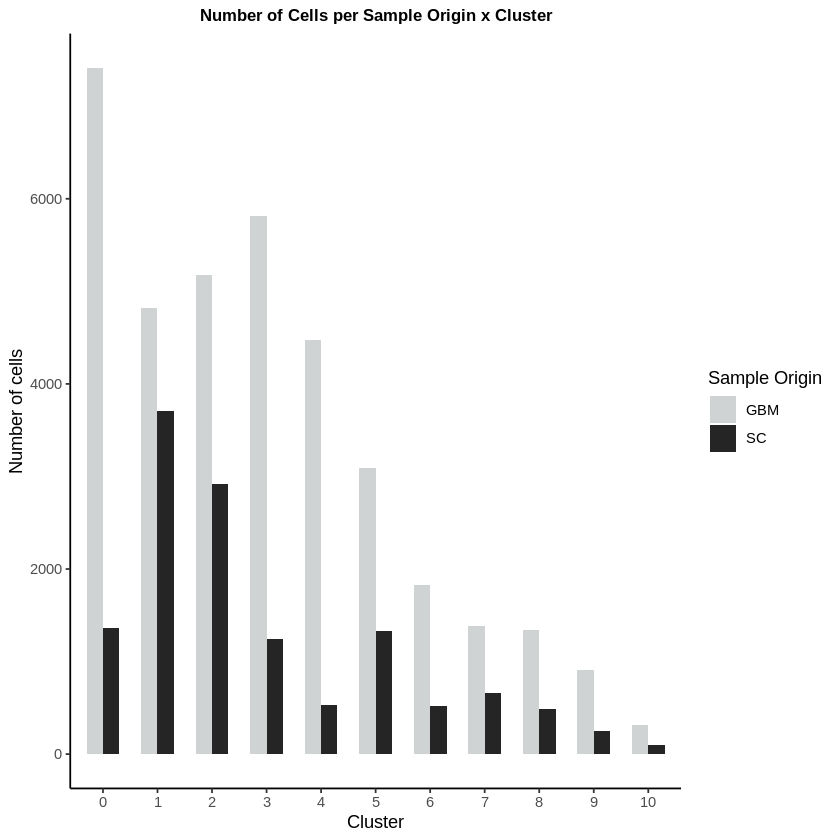

In [66]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- meta %>% group_by(sampleType, cluster, gbm_subtype) %>% summarize(nCells = length(sampleType)) %>%
    ggplot(aes(x=cluster, y=nCells, fill=sampleType)) + geom_bar( stat="identity", width = 0.6, position="dodge") + 
        theme_classic() + scale_fill_manual(values = c(lightgray, darkgray)) +
        ggtitle("Number of Cells per Sample Origin x Cluster") + labs(y = "Number of cells", x = "Cluster") +
        theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        guides(fill=guide_legend(title="Sample Origin"))
p

`summarise()` has grouped output by 'sampleType', 'cluster'. You can override using the `.groups` argument.



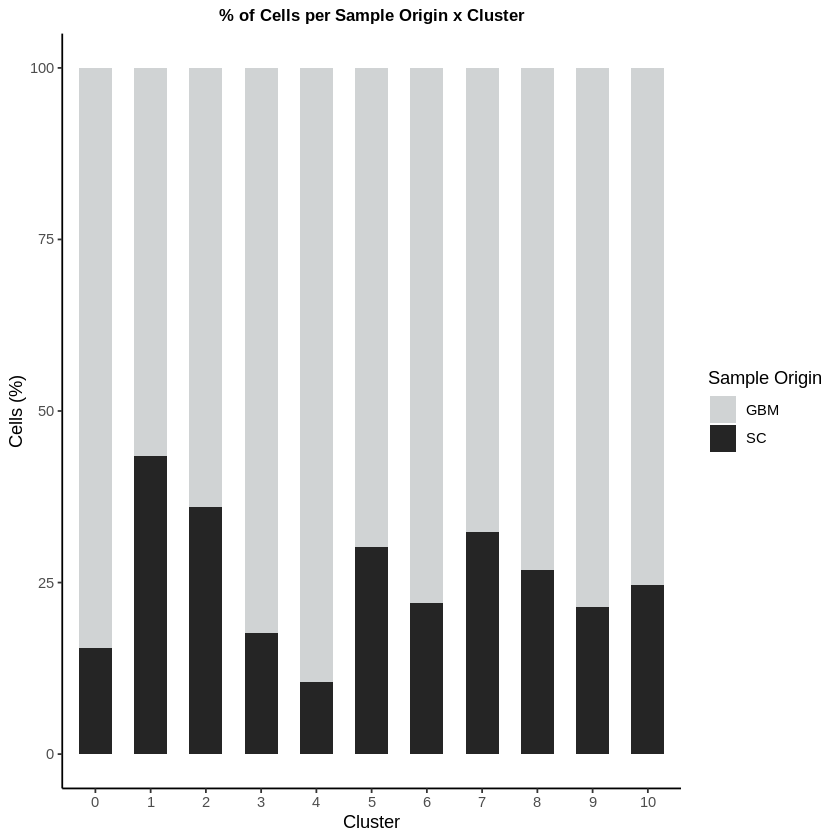

In [65]:
# create bar plot

#### GBM vs NCS ####
p1 <- meta %>% 
        group_by(sampleType, cluster, gbm_subtype) %>% 
        summarize(nCells = length(sampleType)) %>%
        ungroup %>%
        group_by(cluster) %>% 
        mutate(per = 100 * nCells/sum(nCells)) %>%
    ggplot(aes(x=cluster, y=per, fill=sampleType)) + geom_bar( stat="identity", width = 0.6) +
        theme_classic() + scale_fill_manual(values = c(lightgray, darkgray)) +
        ggtitle("% of Cells per Sample Origin x Cluster") + labs(y = "Cells (%)", x = "Cluster") +
        theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        guides(fill=guide_legend(title="Sample Origin"))
p1

In [68]:
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-09-02/r_GBMSC_sampleCompositionALL.pdf", width = size*2, height = size)
grid.arrange(p, p1, nrow =1, top="GBM + NCS: PC20r0.3")
dev.off()

png 
  2

Create pie chart for number of cells from each sample origin in cluster 7 specifically

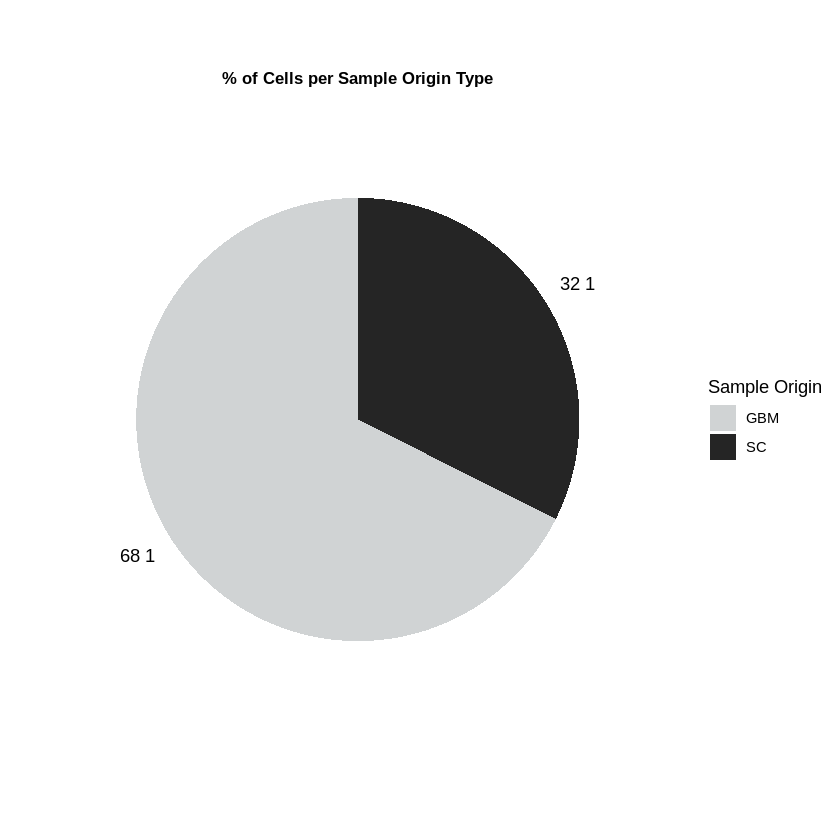

In [123]:
p <- c7.df %>% 
        group_by(sampleType) %>% 
        summarize(nCells = length(sampleType)) %>%
        mutate(per = 100 * nCells/sum(nCells)) %>%
    ggplot(aes(x = "", y = per, fill=sampleType))+ geom_bar(stat = "identity", width = 1.5) + coord_polar("y") +
        geom_text(aes(label = paste(round(per), 1), "%"),
                  position = position_stack(vjust = 0.5)) +
        theme_minimal() + scale_fill_manual(values = c(lightgray, darkgray)) +
        theme(axis.text.x=element_blank()) + 
        ggtitle("% of Cells per Sample Origin Type") + labs(y = "", x = "") +
        theme(axis.text = element_blank(),
              axis.ticks = element_blank(),
              panel.grid  = element_blank(),
              plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        guides(fill=guide_legend(title="Sample Origin"))
p

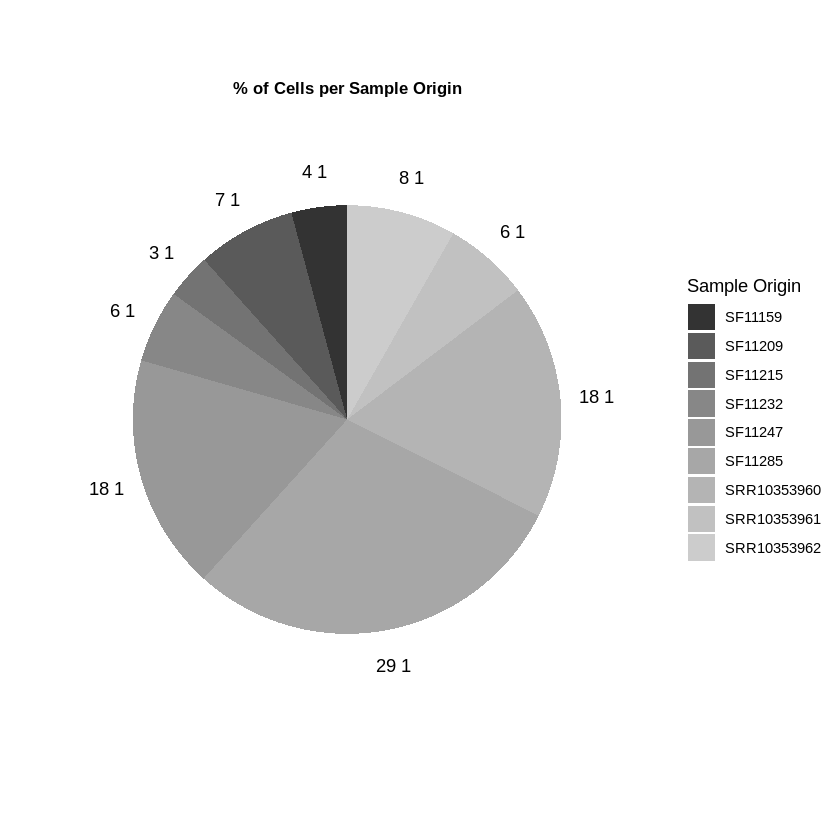

In [122]:
p1 <- c7.df %>% 
        group_by(sampleCombined) %>% 
        summarize(nCells = length(sampleCombined)) %>%
        mutate(per = 100 * nCells/sum(nCells)) %>%
    ggplot(aes(x = "", y = per, fill=sampleCombined))+ geom_bar(stat = "identity", width = 1.5) + coord_polar("y") +
        geom_text(aes(label = paste(round(per), 1), "%"),
                  position = position_stack(vjust = 0.5)) +
        theme_minimal() + scale_fill_grey() +
        theme(axis.text.x=element_blank()) + 
        ggtitle("% of Cells per Sample Origin") + labs(y = "", x = "") +
        theme(axis.text = element_blank(),
              axis.ticks = element_blank(),
              panel.grid  = element_blank(),
              plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        guides(fill=guide_legend(title="Sample Origin"))
p1

In [124]:
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-09-02/r_GBMSC_sampleCompositionC7.pdf", width = size*2, height = size)
grid.arrange(p, p1, nrow =1, top="GBM + NCS: PC20r0.3")
dev.off()

png 
  2

### DEG on Cluster 7
2021-09-22: 

- DEGs between Cluster 7 and other clusters
- Subset Cluster 7 into new seurat object
- DEGs between Cluster 7 GBM cell samples, and Cluster 7 NCS cell smaples
    - Identify overexpressed TEs
    - Identify the families these TEs come from
    
2021-10-14:  Redoing DEG, because it was accidentally overwritten. 

In [6]:
## load seurat objects (also another copy in GBMSC_GSEA-aug31)
# s_objs <- vector(mode="list", length=2)
# s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 
gbmsc.gte <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 

In [7]:
## check that idents are in integrated_snn_res.0.3

head(Idents(gbmsc.gte))
head(gbmsc.gte@meta.data)

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      4                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      2                      2 
Levels: 0 1 2 3 4 5 6 7 8 9 10

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,0,TRUE,SF11232,1,1,1,1,0,28.69794,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,TRUE,SF11232,4,4,5,5,5,31.89670,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,1,TRUE,SF11232,2,0,0,0,1,45.13094,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,1,TRUE,SF11232,2,0,0,0,1,49.49516,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,TRUE,SF11232,0,2,3,2,2,39.06529,Classical-Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,3,TRUE,SF11232,0,2,2,2,3,24.85069,Classical-Proneural


In [8]:
## Comparing a single cluster to all other cells 
## Using default min.pct, min.diff.pct, and logfcthreshold parameters (may take longer)

c7.markers <- FindMarkers(gbmsc.gte, ident.1 = 7, only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)

In [9]:
c7.markers$p_adj_FDR <- p.adjust(c7.markers$p_val, method = "BH")

In [10]:
c7.markers$`nlog10p.adj` <- -log10(c7.markers$p_val_adj)
c7.markers$`nlog10p.FDR` <- -log10(c7.markers$p_adj_FDR)

In [152]:
# saveRDS(c7.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-09-02/cluster7.markers.rds")

In [7]:
# c7.markers <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-09-02/cluster7.markers.rds")

In [11]:
## Redoing DEG, so that I could consider the non-TE genes as well which were accidentally written over the first time I performed this analysis. 
mkdirToday()
saveRDS(c7.markers, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.markers.rds")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results"
[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-10-14"


In [19]:
c7.markers <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.markers.rds")

In [20]:
# Show table with the highest expressed gene from each cluster
dim(c7.markers)[1] # 809 top 

c7.markers %>% top_n(n = 10, wt = avg_log2FC)
c7.markers %>% top_n(n = -10, wt = avg_log2FC)

[1] 1726

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AluY,0.000000e+00,0.7939315,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf
AluYm1,0.000000e+00,0.7656475,0.981,0.985,0.000000e+00,0.000000e+00,Inf,Inf
AluYa5,3.039379e-301,0.7805611,0.965,0.964,9.878287e-297,1.498848e-299,296.0053,298.8242
L1PA16,2.114817e-299,0.7728816,0.961,0.950,6.873367e-295,1.013937e-297,294.1628,296.9940
L1M4c,4.714399e-259,0.9321703,0.998,0.999,1.532227e-254,1.402940e-257,253.8147,256.8530
AluYj4,8.680418e-240,0.7775470,0.891,0.896,2.821223e-235,1.849679e-238,234.5496,237.7329
MALAT1,1.561483e-198,0.8311810,1.000,1.000,5.074974e-194,1.833414e-197,193.2946,196.7367
L1HS,2.025886e-176,0.8624805,0.829,0.829,6.584331e-172,1.626362e-175,171.1815,174.7888
MT-CYB,5.152818e-147,0.8048301,0.949,0.947,1.674717e-142,2.548356e-146,141.7761,145.5937


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
FTH1,0.000000e+00,-1.863316,0.843,0.929,0.000000e+00,0.000000e+00,Inf,Inf
TMSB4X,0.000000e+00,-1.801392,0.906,0.995,0.000000e+00,0.000000e+00,Inf,Inf
FTL,1.009900e-278,-1.877836,0.835,0.978,3.282275e-274,3.631431e-277,273.48383,276.43992
LGALS1,1.340953e-258,-1.751841,0.355,0.707,4.358230e-254,3.922854e-257,253.36069,256.40640
VIM,3.856785e-227,-1.686125,0.497,0.781,1.253494e-222,6.656810e-226,221.90188,225.17673
SEC61G,5.933003e-174,-2.098339,0.490,0.821,1.928285e-169,4.612776e-173,168.71483,172.33604
SPP1,1.452837e-97,-3.012246,0.189,0.433,4.721866e-93,2.992359e-97,92.32589,96.52399
C1QA,3.920178e-57,-1.833733,0.068,0.211,1.274097e-52,4.918426e-57,51.89480,56.30817
C1QB,1.766205e-51,-2.112224,0.083,0.223,5.740343e-47,2.137777e-51,46.24106,50.67004


In [14]:
## load list of TE genes
te_genes <- read.table("~/scratch/gete-gbm/data/geneName_TE_v23-1gtf.txt", 
               sep=",", header = TRUE,
               col.names=c("gene_id", "TE_class", "TE_family"), 
               fill=FALSE, 
               strip.white=TRUE)

te_genes$gene_id <- sub("_", "-", te_genes$gene_id) # in seurat object, `_` were replaced with `-`.
rownames(te_genes) <- te_genes$gene_id

dim(te_genes)
head(te_genes,10)

[1] 1180    3

,gene_id,TE_class,TE_family
,<chr>,<chr>,<chr>
TAR1,TAR1,Satellite,telo
L1MC5a,L1MC5a,LINE,L1
MER5B,MER5B,DNA,hAT-Charlie
MIR3,MIR3,SINE,MIR
L2a,L2a,LINE,L2
L3,L3,LINE,CR1
Plat-L3,Plat-L3,LINE,CR1
MLT1K,MLT1K,LTR,ERVL-MaLR
MIR,MIR,SINE,MIR


In [21]:
## TE genes not in Seurat object must be removed 

# matched <- match(unique(te_genes$gene_id), rownames(s_objs[[1]]@assays$RNA@data))
# matched_TEs <- intersect(te_genes$gene_id, rownames(c7.markers))

c7.markers <- c7.markers %>% tibble::rownames_to_column(var = "gene_id")

matched_TEs <- intersect(te_genes$gene_id, c7.markers$gene_id)
length(matched_TEs)
head(matched_TEs, 20)
tail(matched_TEs, 20)

[1] 208

[1] "L1MC5a" "MER5B"  "MIR3"   "L2a"    "L3"     "MIR"    "L2b"    "L2c"   
 [9] "AluSp"  "MIRb"   "L1MB3"  "MLT1A"  "MIRc"   "AluJo"  "L1MB5"  "L1PA6" 
[17] "L1P1"   "AluJr"  "AluSx"  "AluSz6"

[1] "SVA-E"       "L1MCb"       "AluYe6"      "AluYd8"      "MER21-int"  
 [6] "SVA-C"       "SVA-A"       "LTR47B2"     "L1HS"        "GSATII"     
[11] "Tigger18a"   "L1M2a"       "MER4-int"    "L1PBa"       "L1M3c"      
[16] "LTR17"       "L1M3e"       "HERVS71-int" "AluYb9"      "(GAATG)n"

Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

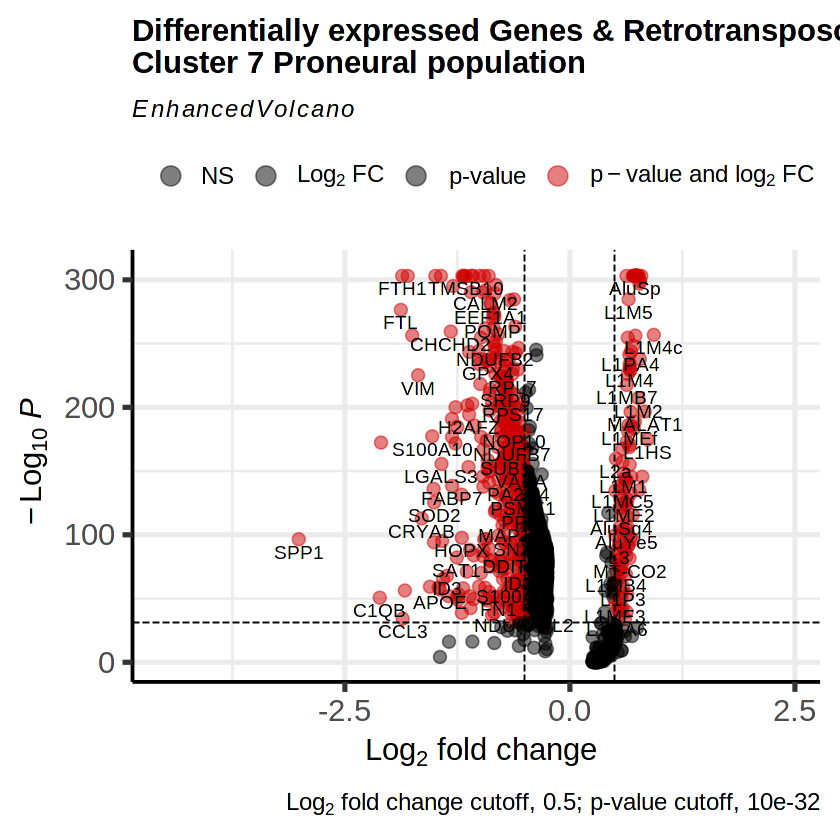

In [22]:
## Volcano plot of all differentially expressed genes
library(EnhancedVolcano)

p <- EnhancedVolcano(c7.markers,
                    lab = c7.markers$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p

# Save figures
size = 7
# pdf("/home/samkyy/scratch/gete-gbm/results/2021-09-02/r_GBMSC_DEGs-C7.pdf", width = size, height = size)
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEGs-C7.pdf", width = size, height = size)
p
dev.off()

Number of TEs significantly overexpressed (avg_log2fc >= 1 means twice as much expression) or underexpressed (avg+log2fc <= -1). 

### Fig Volcano plot of DE TEs
2021-09-23, 2021-09-24:
2021-10-14: Redid the figure to reflect numbers in the new DEG analysis. 

In [24]:
## How many of the 208 TEs are overexpressed? with a significant p-value?
c7.filt <- c7.markers %>% 
#         tibble::rownames_to_column(var = "gene_id") %>% # dplyr::add_rownames() is deprecated in dplyr v1.0.0
        dplyr::filter(gene_id %in% matched_TEs)

dim(c7.filt)

head(c7.filt)
tail(c7.filt)

[1] 208   9

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AluSp,0,0.7223646,1,1,0,0,Inf,Inf
2,AluJo,0,0.7370293,1,1,0,0,Inf,Inf
3,AluJr,0,0.7329050,1,1,0,0,Inf,Inf
4,AluSx,0,0.7427912,1,1,0,0,Inf,Inf
5,AluSz6,0,0.7136329,1,1,0,0,Inf,Inf
6,AluSc,0,0.7481383,1,1,0,0,Inf,Inf


,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
203,ERVL-E-int,0.7179143,0.3025827,0.320,0.385,1,0.7225190,0,0.14115073
204,L1M3c,0.7241054,0.2633618,0.190,0.220,1,0.7283251,0,0.13767473
205,THE1C,0.8037908,0.2679714,0.311,0.382,1,0.8061261,0,0.09359704
206,Tigger4b,0.8125164,0.2775324,0.327,0.408,1,0.8144038,0,0.08916023
207,MSTB1,0.8350186,0.2762312,0.247,0.289,1,0.8359873,0,0.07780032
208,SVA-A,0.8751002,0.2903319,0.335,0.409,1,0.8751002,0,0.05794221


In [25]:
## left join c7.markers with the gtf class and family information. 
dim(te_genes)
dim(te_genes[matched_TEs,])
matchTE.df <- te_genes[matched_TEs,]
head(matchTE.df)

dim(c7.filt)

c7.filt.join <- left_join(c7.filt, matchTE.df, by="gene_id")
head(c7.filt.join)
dim(c7.filt.join)

[1] 1180    3

[1] 208   3

,gene_id,TE_class,TE_family
,<chr>,<chr>,<chr>
L1MC5a,L1MC5a,LINE,L1
MER5B,MER5B,DNA,hAT-Charlie
MIR3,MIR3,SINE,MIR
L2a,L2a,LINE,L2
L3,L3,LINE,CR1
MIR,MIR,SINE,MIR


[1] 208   9

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,AluSp,0,0.7223646,1,1,0,0,Inf,Inf,SINE,Alu
2,AluJo,0,0.7370293,1,1,0,0,Inf,Inf,SINE,Alu
3,AluJr,0,0.7329050,1,1,0,0,Inf,Inf,SINE,Alu
4,AluSx,0,0.7427912,1,1,0,0,Inf,Inf,SINE,Alu
5,AluSz6,0,0.7136329,1,1,0,0,Inf,Inf,SINE,Alu
6,AluSc,0,0.7481383,1,1,0,0,Inf,Inf,SINE,Alu


[1] 208  11

In [24]:
# saveRDS(c7.filt.join, file="/home/samkyy/scratch/gete-gbm/results/2021-09-02/cluster7.markers.rds")

In [6]:
## load cluster 7 DEG dataframe
# c7.filt.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-09-02/cluster7.markers.rds")

In [26]:
saveRDS(c7.filt.join, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-TEmarkers.rds")

In [27]:
## load cluster 7 DEG dataframe
c7.filt.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-TEmarkers.rds")

In [28]:
## Volcano plot of top 10 differentially expressed TEs
library(EnhancedVolcano)

Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

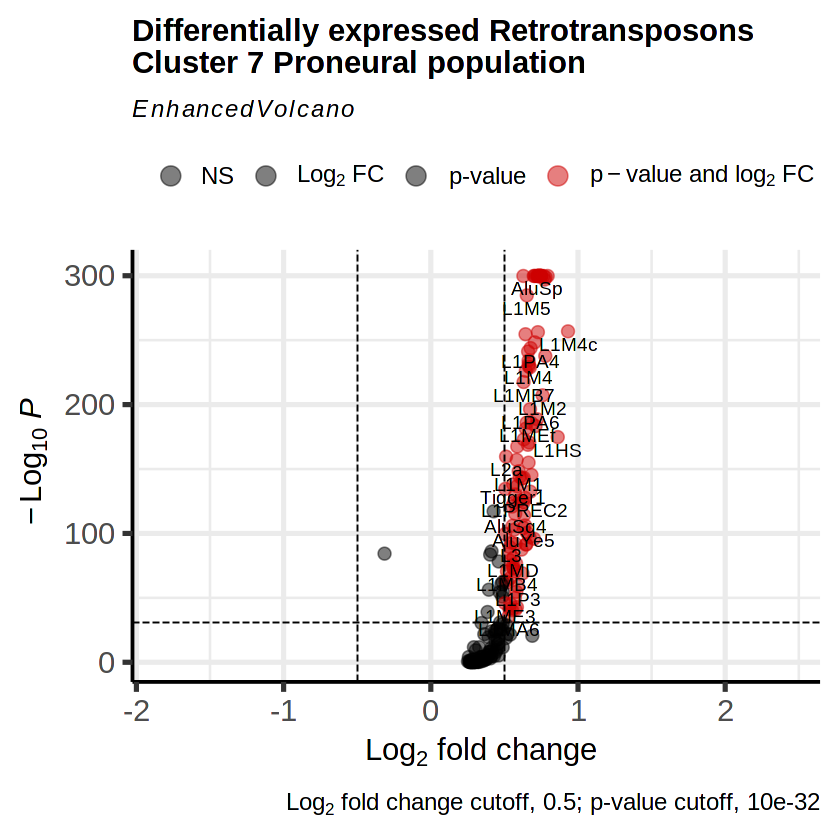

In [29]:
p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p 

# Save figures
size = 7
# pdf("/home/samkyy/scratch/gete-gbm/results/2021-09-02/r_GBMSC_DEG-TE-C7.pdf", width = size, height = size)
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7.pdf", width = size, height = size)
p
dev.off()

In [41]:
options(ggrepel.max.overlaps=100)
lab_markers <- c7.filt.join %>% top_n(n = -1, wt = avg_log2FC)
lab_markers <- rbind(lab_markers, c7.filt.join %>% top_n(n = 15, wt = avg_log2FC))

Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

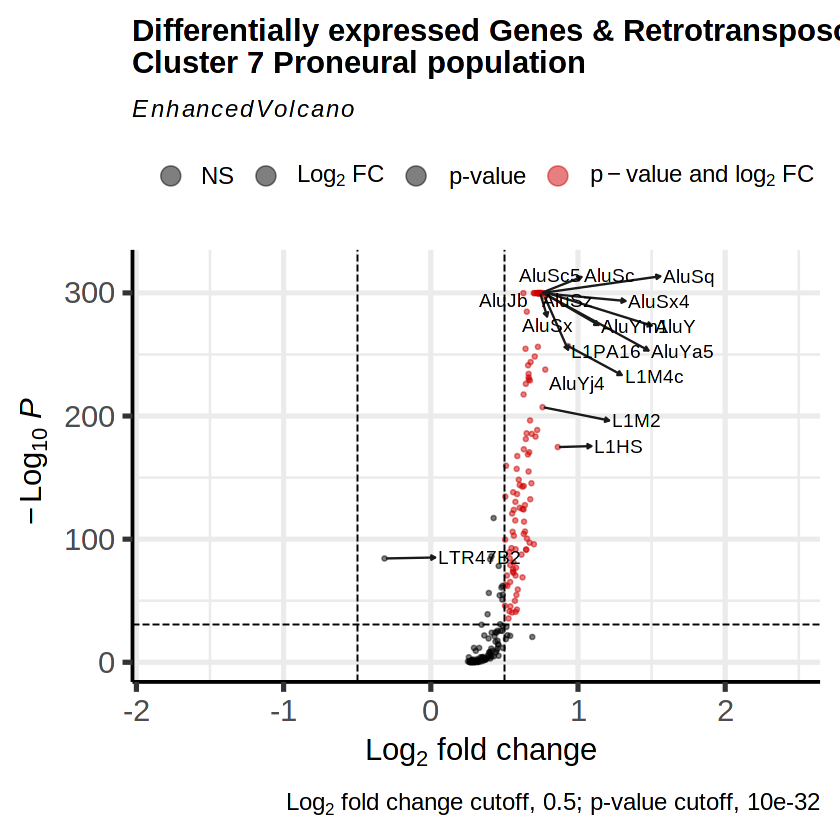

In [44]:
## Label top expressed genes

p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    ylim = c(0, -log10(10e-320)),
                    selectLab = unique(lab_markers$gene_id),
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, lengthConnectors = unit(0.01, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_labs.pdf", width = size, height = size)
p
dev.off()

### VolcanoPlot: Label TEs by Family (ignore)

In [47]:
lab_markers <- c7.filt.join %>% top_n(n = -1, wt = avg_log2FC)
lab_markers <- rbind(lab_markers, c7.filt.join %>% top_n(n = 30, wt = avg_log2FC))
lab_markers <- rbind(lab_markers, c7.filt.join %>% top_n(n=30, wt = nlog10p.FDR))

In [48]:
unique(lab_markers$TE_class)
unique(lab_markers$TE_class)
unique(lab_markers$TE_family)

unique(te_genes$TE_class)

[1] "LTR"  "SINE" "LINE"

[1] "LTR"  "SINE" "LINE"

[1] "ERVL" "Alu"  "L1"

[1] "Satellite"  "LINE"       "DNA"        "SINE"       "LTR"       
 [6] "LTR?"       "DNA?"       "Retroposon" "Unknown"    "RC"        
[11] "RNA"        "RC?"        "SINE?"

In [49]:
ltr_te <- lab_markers %>% dplyr::filter(TE_class == 'LTR')
ltr_te <- unique(ltr_te$gene_id)
ltr_te

sine_te <- lab_markers %>% dplyr::filter(TE_class == 'SINE')
sine_te <- unique(sine_te$gene_id)
sine_te

line_te <- lab_markers %>% dplyr::filter(TE_class == 'LINE')
line_te <- unique(line_te$gene_id)
line_te

[1] "LTR47B2"

[1] "AluSp"  "AluJo"  "AluJr"  "AluSx"  "AluSz6" "AluSc"  "AluSz"  "AluSc5"
 [9] "AluY"   "AluSg4" "AluSx3" "AluSq"  "AluJb"  "AluSq2" "AluSg"  "AluSx1"
[17] "AluSc8" "AluSx4" "AluYm1" "AluYa5" "AluYj4" "AluYf1" "AluYb8" "AluYk4"
[25] "AluJr4" "AluSg7"

[1] "L1PA16" "L1M4c"  "L1PB1"  "L1PA2"  "L1M2"   "L1HS"   "L1M5"   "L1PA7" 
 [9] "L1PA4"  "HAL1"

Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


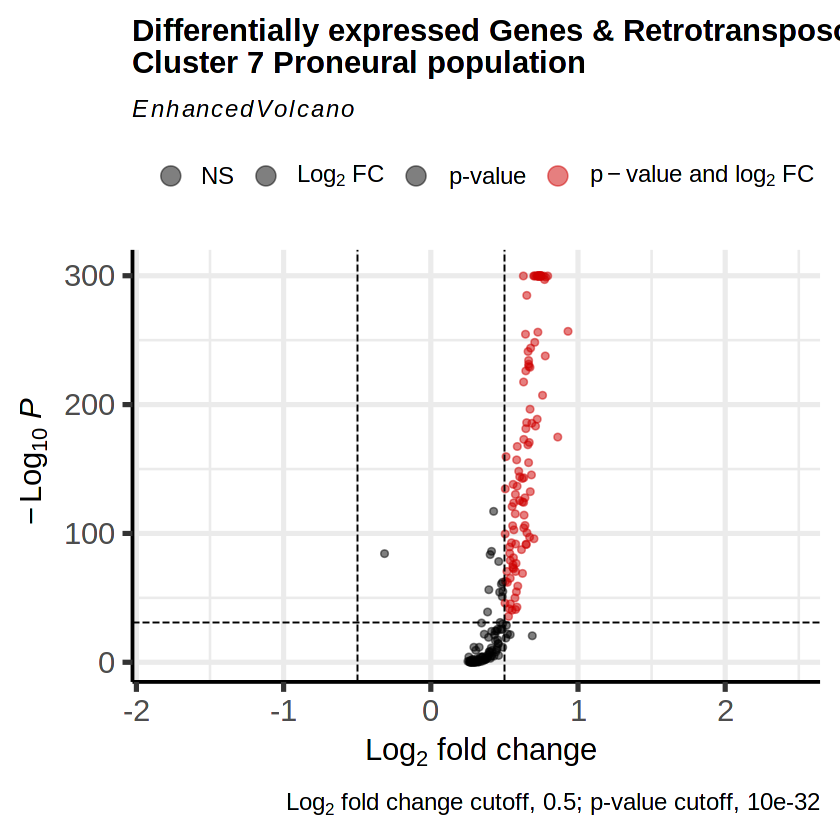

In [54]:
## Label top expressed genes

p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
#                     selectLab = unique(lab_markers$gene_id),
                    selectLab = "",
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    # LTRs
#                       encircle = line_te,
#                       encircleCol = 'blue',
#                       encircleSize = 1,
#                       encircleFill = 'skyblue',
#                       encircleAlpha = 0.8,
                    # SINEs
                      shade = sine_te,
                      shadeAlpha = 2.5,
                      shadeFill = 'black',
                      shadeSize = 3.0,
                      shadeBins = 3,
                    # LINEs
#                       shade = line_te$gene_id,
#                       shadeAlpha = 0.5,
#                       shadeFill = 'lightpurple',
#                       shadeSize = 1,
#                       shadeBins = 5,
                    pointSize = 1.5, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
#                     boxedLabels = TRUE, drawConnectors = TRUE, lengthConnectors = unit(0.01, 'npc'), 
               )

p
# Save figures
# size = 7
# pdf("/home/samkyy/scratch/gete-gbm/results/2021-09-02/test.pdf", width = size*1.7, height = size*1.7)
# p
# dev.off()

### Barplot: TEs by family & Class
2021-10-14:

In [ ]:
##calculate percentage of TE families 

In [118]:
## extract df with cluster 7 cells in a column and the samples they are from. 
DefaultAssay(gbmsc.gte)

c7.df <- gbmsc.gte@meta.data %>% 
            dplyr::filter(integrated_snn_res.0.3 == '7') %>%
            dplyr::select(c(mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))

head(c7.df)
tail(c7.df)

meta <- gbmsc.gte@meta.data %>%
            dplyr::select(c(integrated_snn_res.0.3, mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))
colnames(meta) <- c(colnames(meta)[1], "cluster", colnames(meta)[3:length(colnames(meta))])
head(meta)

[1] "RNA"

sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,0.0128440367,SF11232_1,SF11232,72.58716,Proneural
GBM,0.0572341662,SF11232_1,SF11232,62.65253,Proneural
GBM,0.0705906149,SF11232_1,SF11232,28.53964,Proneural
GBM,0.0538210624,SF11232_1,SF11232,58.43430,Proneural
GBM,0.0005367687,SF11232_1,SF11232,51.95921,Proneural
GBM,0.0044782803,SF11232_1,SF11232,68.42812,Proneural


sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
SC,0.007888041,SRR10353962,SRR10353962,48.19338,Proneural
SC,0.103167808,SRR10353962,SRR10353962,45.71918,Proneural
SC,0.042398778,SRR10353962,SRR10353962,36.74561,Proneural
SC,0.105613945,SRR10353962,SRR10353962,26.94181,Proneural
SC,0.112010796,SRR10353962,SRR10353962,43.72470,Proneural
SC,0.044380125,SRR10353962,SRR10353962,39.50796,Proneural


sampleType,cluster,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<fct>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,1,0.005923887,SF11232_1,SF11232,28.69794,Classical-Mesenchymal
GBM,4,0.046620828,SF11232_1,SF11232,31.89670,Mesenchymal
GBM,0,0.038901602,SF11232_1,SF11232,45.13094,Classical
GBM,0,0.042615417,SF11232_1,SF11232,49.49516,Classical
GBM,2,0.040313949,SF11232_1,SF11232,39.06529,Classical-Proneural
GBM,2,0.013255645,SF11232_1,SF11232,24.85069,Classical-Proneural


png 
  2

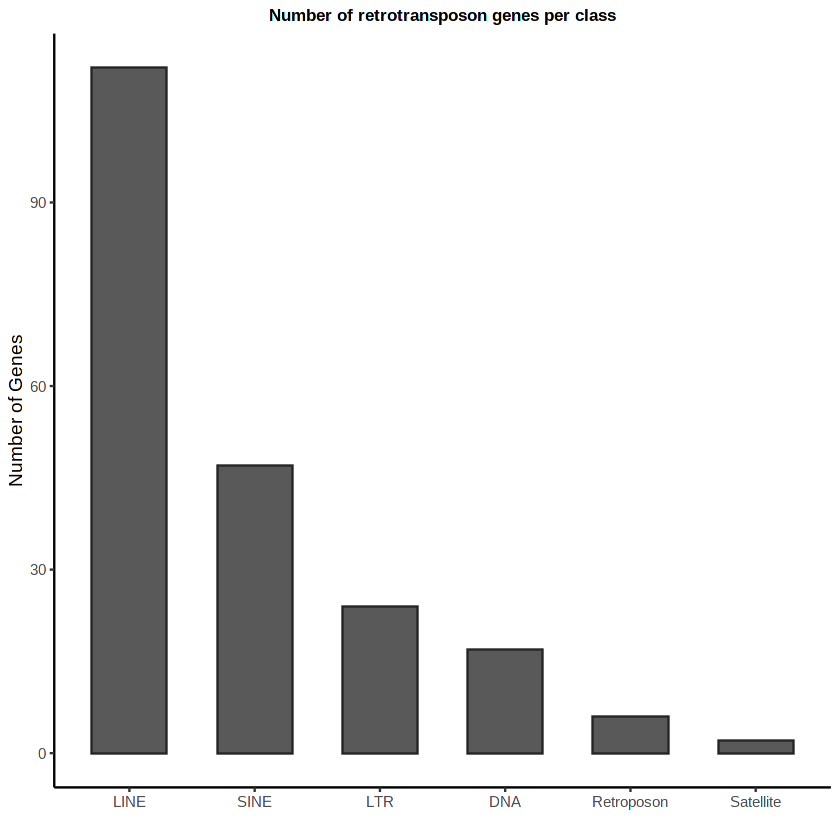

In [59]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_class) %>% summarize(nGenes = length(gene_id)) %>%
    ggplot(aes(x=reorder(TE_class,(-nGenes)), y=nGenes)) + geom_bar( stat="identity", width = 0.6, position="dodge", color=darkgray) + 
        ggtitle("Number of retrotransposon genes per class") + labs(y = "Number of Genes", x = "") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold"))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyclass.pdf", width = size, height = size)
p
dev.off()

png 
  2

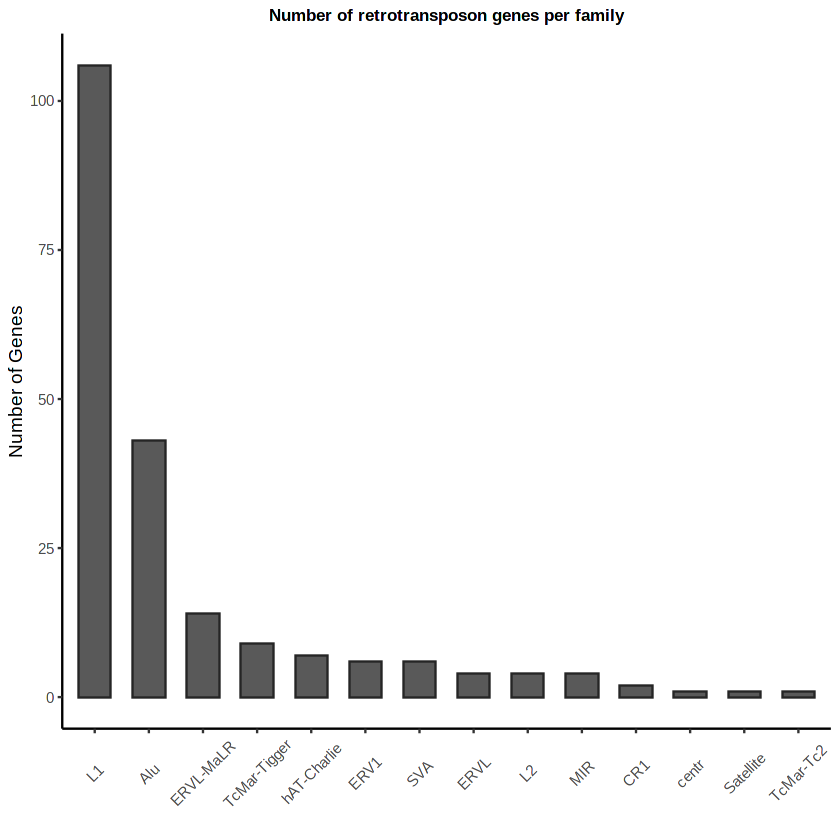

In [62]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_family) %>% summarize(nGenes = length(gene_id)) %>%
    ggplot(aes(x=reorder(TE_family,(-nGenes)), y=nGenes)) + geom_bar( stat="identity", width = 0.6, position="dodge", color=darkgray) + 
        ggtitle("Number of retrotransposon genes per family") + labs(y = "Number of Genes", x = "") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        theme(axis.text.x = element_text(angle = 45, vjust = 0.5, hjust=0.5))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyfamily.pdf", width = size, height = size)
p
dev.off()

In [ ]:
# fill by genes that are significantly overexpressed?

`summarise()` has grouped output by 'TE_class'. You can override using the `.groups` argument.



png 
  2

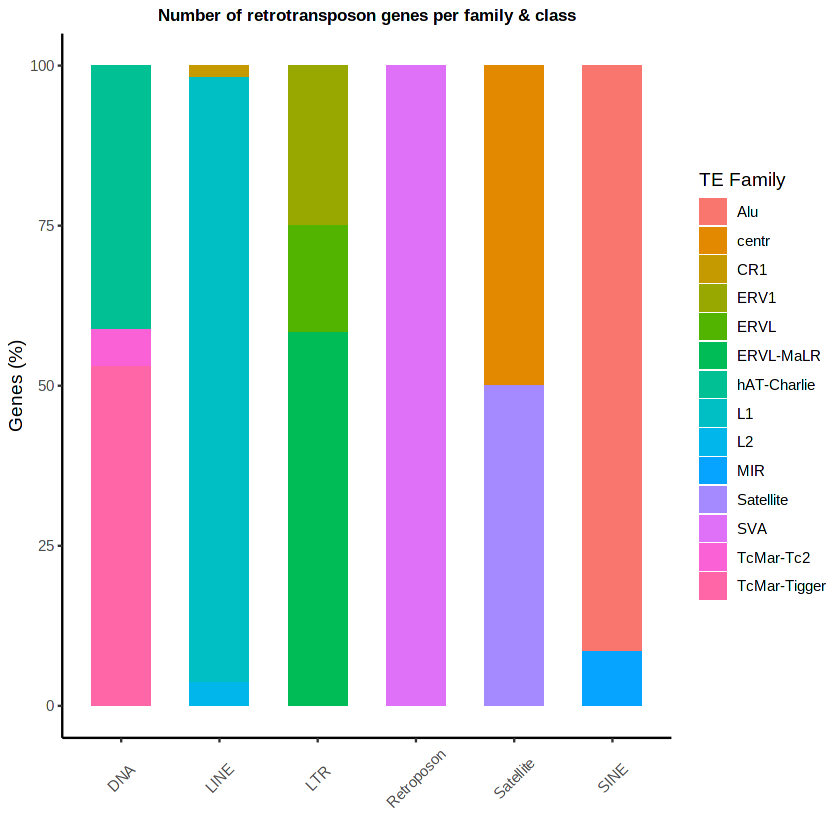

In [106]:
# create bar plot
lightgray <- "#D0D3D4"
darkgray <- "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_class, TE_family) %>% 
        summarize(nGenes = length(gene_id)) %>% mutate(perc = nGenes/sum(nGenes)) %>%
    ggplot(aes(x=TE_class, y=perc*100, fill=TE_family)) + 
        geom_bar( stat="identity", width = 0.6) + 
        ggtitle("Number of retrotransposon genes per family & class") + labs(y = "Genes (%)", x = "", fill="TE Family") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        theme(axis.text.x = element_text(angle = 45, vjust = 0.5, hjust=0.5))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyclassfamily.pdf", width = size, height = size)
p
dev.off()

### Genes Unique to Hominids
2021-10-14:
- SAVs, L1HS, Alu elements

In [27]:
## load cluster 7 DEG dataframe
c7.filt.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-TEmarkers.rds")

In [171]:
c7.filt.join[grep("^SVA", c7.filt.join$gene_id),]

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
85,SVA-D,2.122076e-88,0.6160778,0.831,0.866,6.896959e-84,3.681109e-88,83.1613423,87.43402135,Retroposon,SVA
134,SVA-F,2.505028e-21,0.6893391,0.571,0.631,8.141590e-17,2.734774e-21,16.0892908,20.56307857,Retroposon,SVA
143,SVA-E,2.060884e-12,0.4884095,0.422,0.432,6.698078e-08,2.217634e-12,7.1740498,11.65411012,Retroposon,SVA
156,SVA-C,1.359824e-05,0.4131995,0.434,0.499,4.419564e-01,1.439912e-05,0.3546206,4.84166411,Retroposon,SVA
160,SVA-B,7.338298e-05,0.3375863,0.513,0.608,1.000000e+00,7.732541e-05,0.0000000,4.11167776,Retroposon,SVA
208,SVA-A,8.751002e-01,0.2903319,0.335,0.409,1.000000e+00,8.751002e-01,0.0000000,0.05794221,Retroposon,SVA


Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

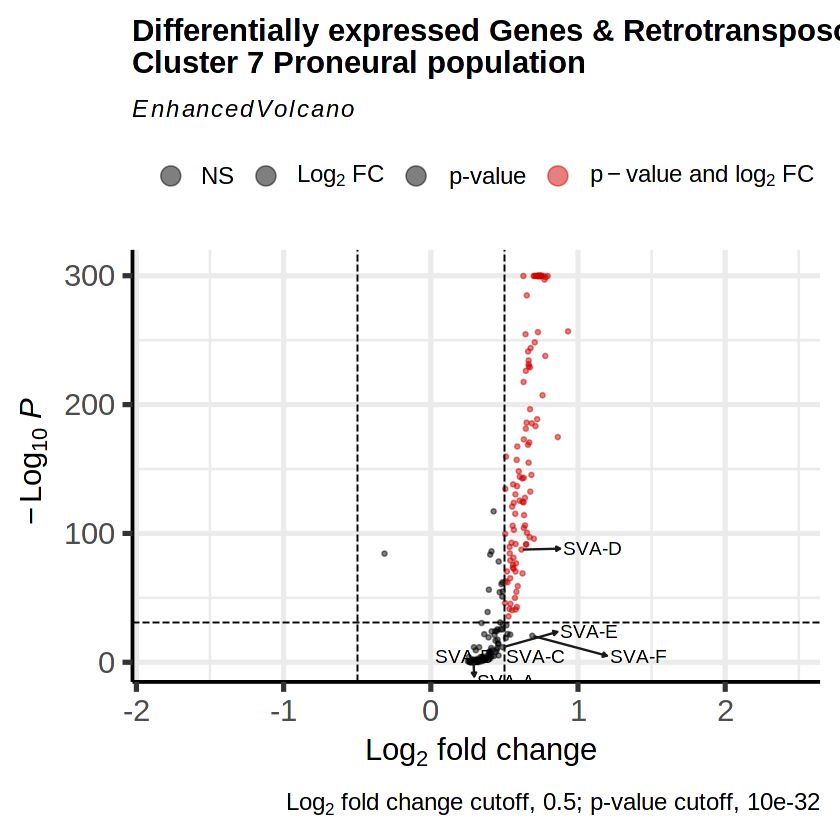

In [183]:
lab_markers <- c7.filt.join[grep("^SVA", c7.filt.join$gene_id),"gene_id"]

p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = lab_markers,
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, lengthConnectors = unit(0.01, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_SVA.pdf", width = size*1.5, height = size*1.5)
p
dev.off()

In [172]:
c7.filt.join[grep("^L1HS", c7.filt.join$gene_id),]

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
45,L1HS,2.025886e-176,0.8624805,0.829,0.829,6.584331e-172,1.626362e-175,171.1815,174.7888,LINE,L1


Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

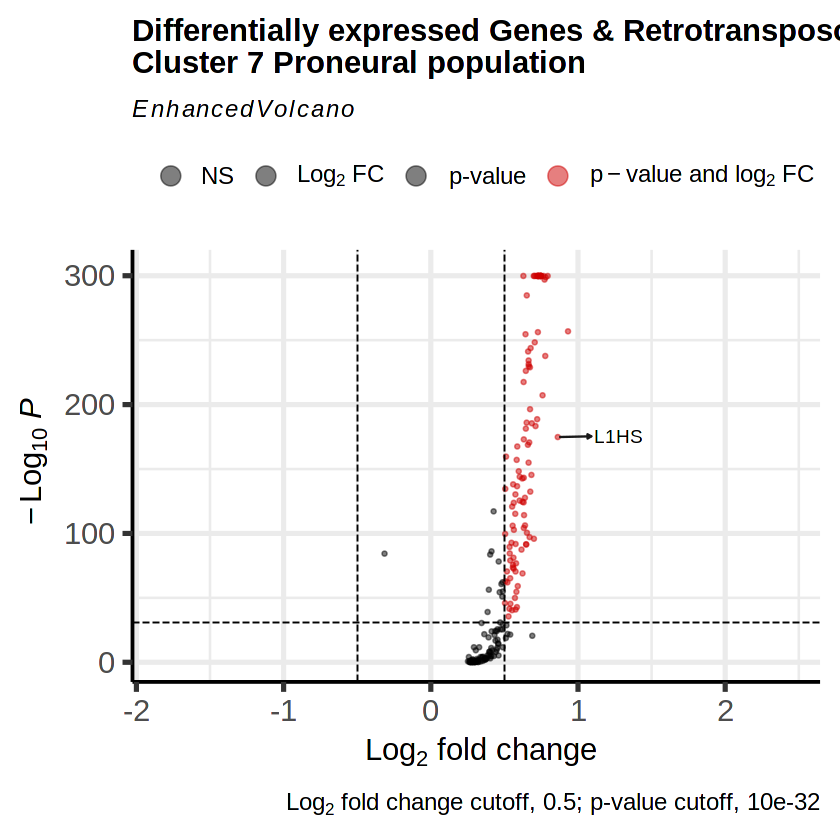

In [184]:
lab_markers <- c7.filt.join[grep("^L1HS", c7.filt.join$gene_id),]

p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = lab_markers,
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, lengthConnectors = unit(0.01, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_L1HS.pdf", width = size*1.5, height = size*1.5)
p
dev.off()

In [180]:
c7.filt.join[grep("^Alu", c7.filt.join$gene_id),]
c7.filt.join[grep("^Alu", c7.filt.join$gene_id),] %>% dplyr::filter(p_val_adj <= 10e-32)

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,AluSp,0.000000e+00,0.7223646,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
2,AluJo,0.000000e+00,0.7370293,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
3,AluJr,0.000000e+00,0.7329050,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
4,AluSx,0.000000e+00,0.7427912,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
5,AluSz6,0.000000e+00,0.7136329,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
6,AluSc,0.000000e+00,0.7481383,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
7,AluSz,0.000000e+00,0.7468936,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
8,AluSc5,0.000000e+00,0.7472792,0.989,0.989,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
9,AluY,0.000000e+00,0.7939315,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu


gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
AluSp,0.000000e+00,0.7223646,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluJo,0.000000e+00,0.7370293,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluJr,0.000000e+00,0.7329050,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluSx,0.000000e+00,0.7427912,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluSz6,0.000000e+00,0.7136329,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluSc,0.000000e+00,0.7481383,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluSz,0.000000e+00,0.7468936,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluSc5,0.000000e+00,0.7472792,0.989,0.989,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu
AluY,0.000000e+00,0.7939315,1.000,1.000,0.000000e+00,0.000000e+00,Inf,Inf,SINE,Alu


Warning message:
"One or more p-values is 0. Converting to 10^-1 * current lowest non-zero p-value..."


png 
  2

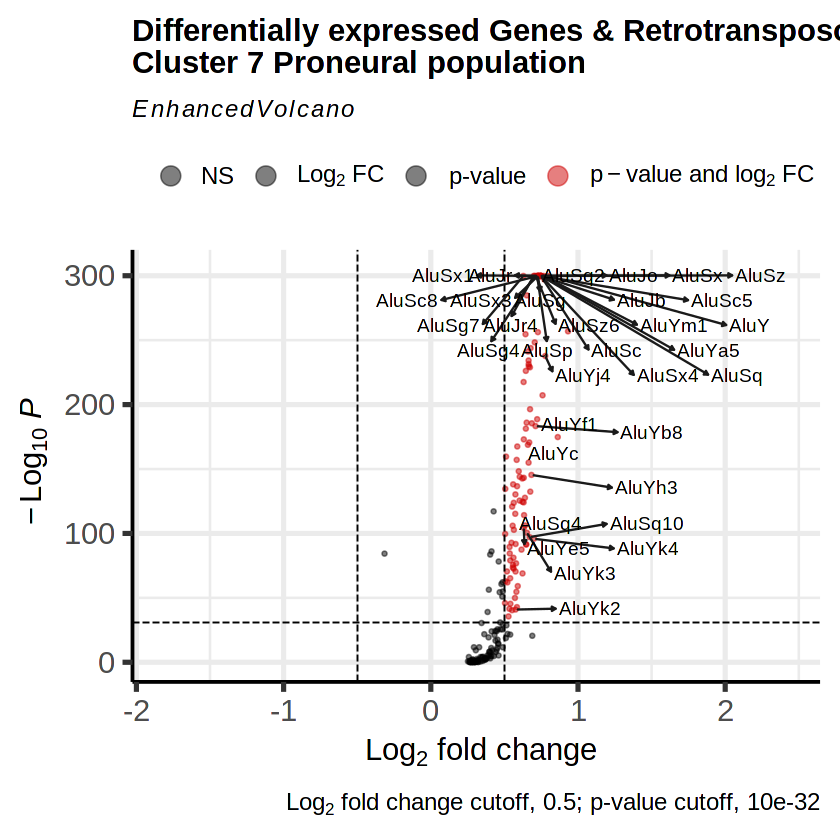

In [186]:
lab_markers <- c7.filt.join[grep("^Alu", c7.filt.join$gene_id),] %>% dplyr::filter(p_val_adj <= 10e-32)

p <- EnhancedVolcano(c7.filt.join,
                    lab = c7.filt.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = lab_markers$gene_id,
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, lengthConnectors = unit(0.01, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_Alu.pdf", width = size*1.5, height = size*1.5)
p
dev.off()

## Fig: ZNF DEGs (Cluster7)
2021-10-14:

In [63]:
#load data
c7.markers <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.markers.rds")

In [65]:
c7.markers <- c7.markers %>% tibble::rownames_to_column(var = "gene_id")
head(c7.markers)

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,TMSB10,0,-1.1576966,0.836,0.973,0,0,Inf,Inf
2,ACTB,0,-1.1784577,0.845,0.971,0,0,Inf,Inf
3,NDUFA4,0,-1.0795162,0.638,0.936,0,0,Inf,Inf
4,LDHA,0,-1.4326403,0.320,0.754,0,0,Inf,Inf
5,FTH1,0,-1.8633158,0.843,0.929,0,0,Inf,Inf
6,CFL1,0,-0.9017693,0.616,0.931,0,0,Inf,Inf


In [74]:
znf <- read.table("/project/6058542/samkyy/resources/HGNC/znf_HGNCgroup.txt", sep = "\t", header = TRUE)
znf$Group <- "Zinc Fingers"
dim(znf)
head(znf)

[1] 15  7

,HGNC.ID..gene.,Approved.symbol,Approved.name,Previous.symbols,Aliases,Chromosome,Group
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,HGNC:28724,APLF,aprataxin and PNKP like factor,C2orf13,"MGC47799,Xip1,ZCCHH1",2p13.3,Zinc Fingers
2,HGNC:1117,BSN,bassoon presynaptic cytomatrix protein,ZNF231,,3p21.31,Zinc Fingers
3,HGNC:33879,DNLZ,DNL-type zinc finger,C9orf151,"RP11-413M3.2,ZIM17,bA413M3.2,TIMM15,HEP",9q34.3,Zinc Fingers
4,HGNC:25404,FLYWCH1,FLYWCH-type zinc finger 1,,DKFZp761A132,16p13.3,Zinc Fingers
5,HGNC:6600,LIG3,DNA ligase 3,LIG2,LIG3alpha,17q12,Zinc Fingers
6,HGNC:26021,LYAR,Ly1 antibody reactive,,"ZC2HC2,ZLYAR",4p16.3,Zinc Fingers


In [75]:
znf_sub <- read.table("/project/6058542/samkyy/resources/HGNC/znf_HGNCsubgroups.txt", sep = "\t", header = TRUE)
dim(znf_sub)
head(znf_sub)

[1] 1591    7

,HGNC.ID..gene.,Approved.symbol,Approved.name,Previous.symbols,Aliases,Chromosome,Group
,<chr>,<chr>,<chr>,<chr>,<lgl>,<chr>,<chr>
1,HGNC:20250,AJUBA,ajuba LIM protein,JUB,NA,14q11.2,Ajuba family
2,HGNC:6612,LIMD1,LIM domain containing 1,,NA,3p21.31,Ajuba family
3,HGNC:20964,WTIP,WT1 interacting protein,,NA,19q13.11,Ajuba family
4,HGNC:3467,ESR1,estrogen receptor 1,ESR,NA,6q25.1-q25.2,Estrogen receptors
5,HGNC:3468,ESR2,estrogen receptor 2,,NA,14q23.2-q23.3,Estrogen receptors
6,HGNC:3471,ESRRA,estrogen related receptor alpha,ESRL1,NA,11q13.1,Estrogen related receptors


In [90]:
znf.all <- rbind(znf, znf_sub)
names(znf.all) <- c("HGNC", "gene_id", "approved.name", "prev.symbols", "aliases", "Chr", "Group")
dim(znf.all)
head(znf.all)

[1] 1606    7

,HGNC,gene_id,approved.name,prev.symbols,aliases,Chr,Group
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,HGNC:28724,APLF,aprataxin and PNKP like factor,C2orf13,"MGC47799,Xip1,ZCCHH1",2p13.3,Zinc Fingers
2,HGNC:1117,BSN,bassoon presynaptic cytomatrix protein,ZNF231,,3p21.31,Zinc Fingers
3,HGNC:33879,DNLZ,DNL-type zinc finger,C9orf151,"RP11-413M3.2,ZIM17,bA413M3.2,TIMM15,HEP",9q34.3,Zinc Fingers
4,HGNC:25404,FLYWCH1,FLYWCH-type zinc finger 1,,DKFZp761A132,16p13.3,Zinc Fingers
5,HGNC:6600,LIG3,DNA ligase 3,LIG2,LIG3alpha,17q12,Zinc Fingers
6,HGNC:26021,LYAR,Ly1 antibody reactive,,"ZC2HC2,ZLYAR",4p16.3,Zinc Fingers


In [87]:
write.table(znf.all, file = "/project/6058542/samkyy/resources/HGNC/znf_HGNCall.txt", 
            sep = "\t", row.names = FALSE)

In [102]:
znf.all[grep("^ZNF55", znf.all$gene_id), ]

,HGNC,gene_id,approved.name,prev.symbols,aliases,Chr,Group
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1136,HGNC:28643,ZNF550,zinc finger protein 550,,NA,19q13.43,Zinc fingers C2H2-type
1137,HGNC:25108,ZNF551,zinc finger protein 551,,NA,19q13.43,Zinc fingers C2H2-type
1138,HGNC:26135,ZNF552,zinc finger protein 552,,NA,19q13.43,Zinc fingers C2H2-type
1139,HGNC:26629,ZNF554,zinc finger protein 554,,NA,19p13.3,Zinc fingers C2H2-type
1140,HGNC:28382,ZNF555,zinc finger protein 555,,NA,19p13.3,Zinc fingers C2H2-type
1141,HGNC:25669,ZNF556,zinc finger protein 556,,NA,19p13.3,Zinc fingers C2H2-type
1142,HGNC:28632,ZNF557,zinc finger protein 557,,NA,19p13.2,Zinc fingers C2H2-type
1143,HGNC:26422,ZNF558,zinc finger protein 558,,NA,19p13.2,Zinc fingers C2H2-type
1144,HGNC:28197,ZNF559,zinc finger protein 559,,NA,19p13.2,Zinc fingers C2H2-type


We are looking to see if ZNF558 is differentially expressed in the retrotransposon-enriched cluster. Based on the following paper : @Johansson2021_CisactingStructural

In [91]:
matched_znf <- intersect(znf.all$gene_id, c7.markers$gene_id)
length(matched_znf)
matched_znf

[1] 42

[1] "CRIP2"   "CSRP1"   "CSRP2"   "FHL1"    "LIMS1"   "LMO4"    "PDLIM2" 
 [8] "PDLIM4"  "PHF5A"   "ANAPC11" "MDM4"    "NSMCE1"  "RNF5"    "RNF7"   
[15] "RNF13"   "RNF19A"  "RBX1"    "RNF114"  "RNF130"  "CNBP"    "RNF181" 
[22] "ZFAND2A" "ZFAND6"  "ZC3H15"  "ZFP36"   "ZFP36L1" "ZFP36L2" "ZCCHC17"
[29] "ZCRB1"   "SF1"     "CXXC5"   "GTF3A"   "KLF6"    "ZNF22"   "ZNF428" 
[36] "ZDHHC4"  "ZNHIT1"  "ZMAT2"   "FUS"     "SQSTM1"  "TRIP6"   "ZYX"

In [79]:
matched_znf <- intersect(znf.all$prev.symbols, c7.markers$gene_id)
length(matched_znf)
matched_znf

[1] 0

character(0)

In [97]:
## left join c7.znf with znf information. 
c7.znf <- c7.markers %>% dplyr::filter(gene_id %in% matched_znf)
dim(c7.znf)

c7.znf.join <- left_join(c7.znf, znf.all, by="gene_id")
dim(c7.znf.join)
head(c7.znf.join)

[1] 42  9

[1] 44 15

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,HGNC,approved.name,prev.symbols,aliases,Chr,Group
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,ANAPC11,1.697022e-209,-0.7293648,0.340,0.751,5.515490e-205,2.400868e-208,204.2584,207.6196,HGNC:14452,anaphase promoting complex subunit 11,,NA,17q25.3,Ring finger proteins
2,RBX1,4.815298e-185,-0.6281904,0.321,0.720,1.565020e-180,4.617336e-184,179.8055,183.3356,HGNC:9928,ring-box 1,,NA,22q13.2,Ring finger proteins
3,CNBP,4.630337e-181,-0.6584171,0.266,0.656,1.504906e-176,3.995981e-180,175.8225,179.3984,HGNC:13164,CCHC-type zinc finger nucleic acid binding protein,"DM2,ZNF9",NA,3q21.3,Ring finger proteins
4,CNBP,4.630337e-181,-0.6584171,0.266,0.656,1.504906e-176,3.995981e-180,175.8225,179.3984,HGNC:13164,CCHC-type zinc finger nucleic acid binding protein,"DM2,ZNF9",NA,3q21.3,Zinc fingers CCHC-type
5,RNF7,1.877630e-169,-0.5433301,0.192,0.566,6.102484e-165,1.361676e-168,164.2145,167.8659,HGNC:10070,ring finger protein 7,,NA,3q23,Ring finger proteins
6,CSRP2,1.036191e-151,-0.9001280,0.112,0.425,3.367725e-147,5.695752e-151,146.4727,150.2444,HGNC:2470,cysteine and glycine rich protein 2,,NA,12q21.2,LIM domain containing


In [98]:
saveRDS(c7.znf.join, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-ZNFmarkers.rds")

In [27]:
## load cluster 7 DEG dataframe
c7.znf.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-ZNFmarkers.rds")

In [28]:
## Volcano plot of top 10 differentially expressed TEs
library(EnhancedVolcano)

png 
  2

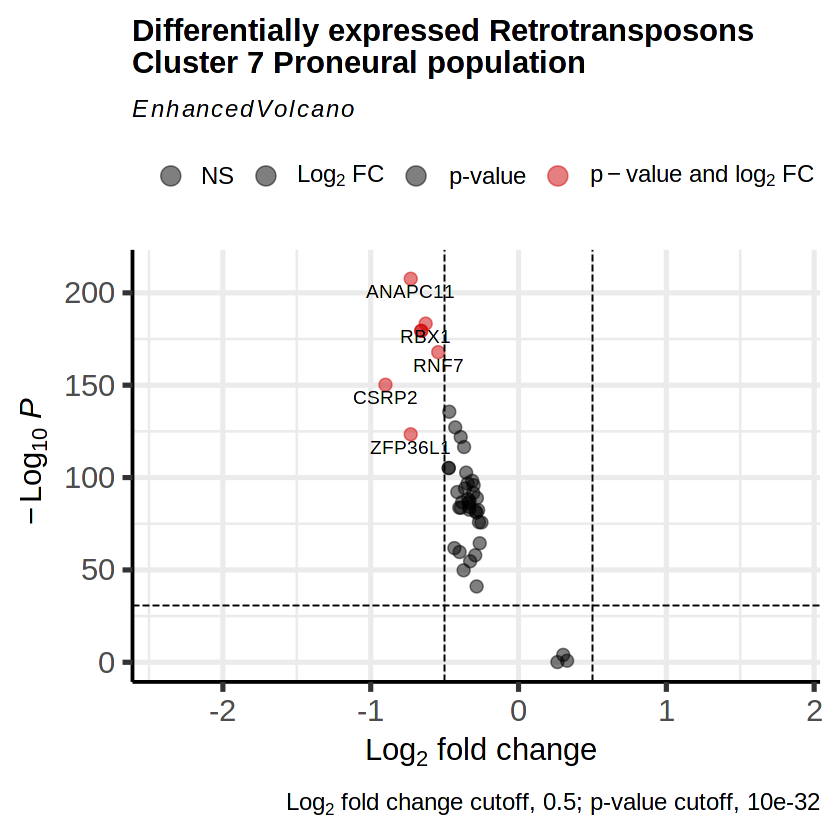

In [99]:
p <- EnhancedVolcano(c7.znf.join,
                    lab = c7.znf.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Retrotransposons\nCluster 7 Proneural population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p 

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-ZNF-C7.pdf", width = size, height = size)
p
dev.off()

### Barplot of ZNF families
2021-10-14:

In [202]:
## load cluster 7 DEG dataframe
c7.znf.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-ZNFmarkers.rds")

png 
  2

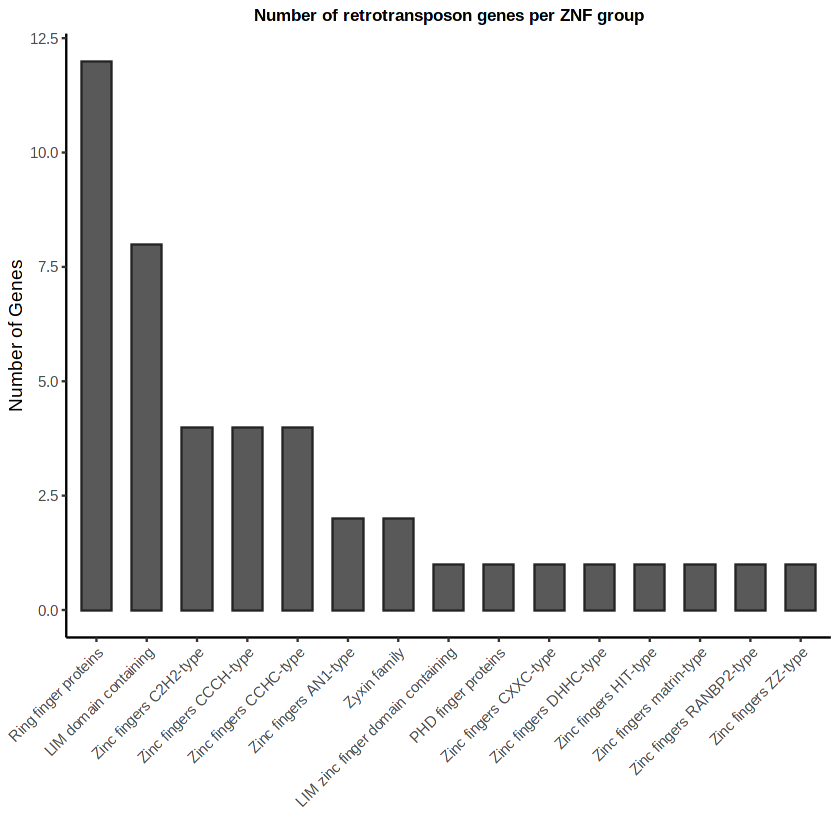

In [211]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- c7.znf.join %>% group_by(Group) %>% summarize(nGenes = length(gene_id)) %>%
    ggplot(aes(x=reorder(Group,(-nGenes)), y=nGenes)) + geom_bar( stat="identity", width = 0.6, position="dodge", color=darkgray) + 
        ggtitle("Number of retrotransposon genes per ZNF group") + labs(y = "Number of Genes", x = "") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        theme(axis.text.x = element_text(angle = 45, vjust = 1, hjust=1))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-ZNF-C7_barbygroup.pdf", width = size, height = size)
p
dev.off()

## Cluster 7: GBM vs NSC DEG
2021-10-14:

In [ ]:
#load seurat object containing only cluster 7 cells

In [107]:
## load seurat objects (also another copy in GBMSC_GSEA-aug31)
# s_objs <- vector(mode="list", length=2)
# s_objs[[2]] <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 
gbmsc.gte <- readRDS("~/scratch/gete-gbm/results/2021-09-02/gte_gbmscIntUmap-subtypes.rds") 

In [108]:
## check that idents are in integrated_snn_res.0.3

head(Idents(gbmsc.gte))
head(gbmsc.gte@meta.data)

GBM_AAACCTGCAATTCCTT-1 GBM_AAACCTGCACAGAGGT-1 GBM_AAACCTGGTGTGGCTC-1 
                     1                      4                      0 
GBM_AAACGGGGTCCGAATT-1 GBM_AAACGGGTCGAATGGG-1 GBM_AAAGATGGTCTCAACA-1 
                     0                      2                      2 
Levels: 0 1 2 3 4 5 6 7 8 9 10

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_AAACCTGCAATTCCTT-1,1,16712,4840,0.8725599,0.005923887,AAACCTGCAATTCCTT-1,SF11232_1,16712,4840,3,⋯,0,TRUE,SF11232,1,1,1,1,0,28.69794,Classical-Mesenchymal
GBM_AAACCTGCACAGAGGT-1,1,5963,1850,0.8653694,0.046620828,AAACCTGCACAGAGGT-1,SF11232_1,5963,1850,4,⋯,5,TRUE,SF11232,4,4,5,5,5,31.89670,Mesenchymal
GBM_AAACCTGGTGTGGCTC-1,1,7866,2355,0.8655554,0.038901602,AAACCTGGTGTGGCTC-1,SF11232_1,7866,2355,0,⋯,1,TRUE,SF11232,2,0,0,0,1,45.13094,Classical
GBM_AAACGGGGTCCGAATT-1,1,14361,3262,0.8451595,0.042615417,AAACGGGGTCCGAATT-1,SF11232_1,14361,3262,0,⋯,1,TRUE,SF11232,2,0,0,0,1,49.49516,Classical
GBM_AAACGGGTCGAATGGG-1,1,2803,1201,0.8932366,0.040313949,AAACGGGTCGAATGGG-1,SF11232_1,2803,1201,0,⋯,2,TRUE,SF11232,0,2,3,2,2,39.06529,Classical-Proneural
GBM_AAAGATGGTCTCAACA-1,1,6865,2756,0.8966905,0.013255645,AAAGATGGTCTCAACA-1,SF11232_1,6865,2756,8,⋯,3,TRUE,SF11232,0,2,2,2,3,24.85069,Classical-Proneural


In [109]:
## subset cluster7 into new seurat object
c7 <- subset(gbmsc.gte, subset = integrated_snn_res.0.3 == 7)
head(c7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,seurat_clusters,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<fct>,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>
GBM_ACGATACTCCGCGCAA-1,1,2725,769,0.8400636,0.0128440367,ACGATACTCCGCGCAA-1,SF11232_1,2725,769,14,⋯,9,TRUE,SF11232,6,7,7,7,9,72.58716,Proneural
GBM_ACGATGTCAGTGGGAT-1,1,6884,1703,0.8419355,0.0572341662,ACGATGTCAGTGGGAT-1,SF11232_1,6884,1703,14,⋯,9,TRUE,SF11232,6,7,7,7,9,62.65253,Proneural
GBM_CATATTCCACCAGGCT-1,1,9888,2995,0.8701633,0.0705906149,CATATTCCACCAGGCT-1,SF11232_1,9888,2995,2,⋯,9,TRUE,SF11232,6,7,7,7,9,28.53964,Proneural
GBM_CATCAGACAATAGCGG-1,1,4292,996,0.8253620,0.0538210624,CATCAGACAATAGCGG-1,SF11232_1,4292,996,14,⋯,9,TRUE,SF11232,1,7,7,7,9,58.43430,Proneural
GBM_CATTCGCGTGTTCTTT-1,1,1863,767,0.8821430,0.0005367687,CATTCGCGTGTTCTTT-1,SF11232_1,1863,767,14,⋯,9,TRUE,SF11232,6,7,7,7,9,51.95921,Proneural
GBM_CCTTACGAGATAGTCA-1,1,2233,684,0.8465662,0.0044782803,CCTTACGAGATAGTCA-1,SF11232_1,2233,684,14,⋯,9,TRUE,SF11232,6,7,7,7,9,68.42812,Proneural


In [120]:
## add metadata separating GBM from NSC samples
c7$sampleType <- NA

c7$sampleType[grep("^SF", c7$sample)] <- "GBM"
c7$sampleType[grep("^SRR", c7$sample)] <- "NSC"

In [122]:
head(c7@meta.data)
tail(c7@meta.data)

,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype,sampleType
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>,<chr>
GBM_ACGATACTCCGCGCAA-1,1,2725,769,0.8400636,0.0128440367,ACGATACTCCGCGCAA-1,SF11232_1,2725,769,14,⋯,TRUE,SF11232,6,7,7,7,9,72.58716,Proneural,GBM
GBM_ACGATGTCAGTGGGAT-1,1,6884,1703,0.8419355,0.0572341662,ACGATGTCAGTGGGAT-1,SF11232_1,6884,1703,14,⋯,TRUE,SF11232,6,7,7,7,9,62.65253,Proneural,GBM
GBM_CATATTCCACCAGGCT-1,1,9888,2995,0.8701633,0.0705906149,CATATTCCACCAGGCT-1,SF11232_1,9888,2995,2,⋯,TRUE,SF11232,6,7,7,7,9,28.53964,Proneural,GBM
GBM_CATCAGACAATAGCGG-1,1,4292,996,0.8253620,0.0538210624,CATCAGACAATAGCGG-1,SF11232_1,4292,996,14,⋯,TRUE,SF11232,1,7,7,7,9,58.43430,Proneural,GBM
GBM_CATTCGCGTGTTCTTT-1,1,1863,767,0.8821430,0.0005367687,CATTCGCGTGTTCTTT-1,SF11232_1,1863,767,14,⋯,TRUE,SF11232,6,7,7,7,9,51.95921,Proneural,GBM
GBM_CCTTACGAGATAGTCA-1,1,2233,684,0.8465662,0.0044782803,CCTTACGAGATAGTCA-1,SF11232_1,2233,684,14,⋯,TRUE,SF11232,6,7,7,7,9,68.42812,Proneural,GBM


,orig.ident,nUMI,nGene,log10GenesPerUMI,mitoRatio,cells,sample,nCount_RNA,nFeature_RNA,GBM_integrated_snn_res.0.8,⋯,MGMTme,sampleCombined,integrated_snn_res.0.2,integrated_snn_res.0.3,integrated_snn_res.0.4,integrated_snn_res.0.5,integrated_snn_res.0.6,teRatio,gbm_subtype,sampleType
,<chr>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<fct>,<dbl>,<int>,<chr>,⋯,<lgl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<dbl>,<chr>,<chr>
SC_TTGAACGCAGACAAGC-3,3,3930,1248,0.8614013,0.007888041,TTGAACGCAGACAAGC-3,SRR10353962,3930,1248,NA,⋯,NA,SRR10353962,6,7,7,7,9,48.19338,Proneural,NSC
SC_TTGACTTCAAAGGCGT-3,3,2336,715,0.8473591,0.103167808,TTGACTTCAAAGGCGT-3,SRR10353962,2336,715,NA,⋯,NA,SRR10353962,6,7,7,7,9,45.71918,Proneural,NSC
SC_TTGCCGTAGAGTGACC-3,3,2618,621,0.8171786,0.042398778,TTGCCGTAGAGTGACC-3,SRR10353962,2618,621,NA,⋯,NA,SRR10353962,6,7,7,7,9,36.74561,Proneural,NSC
SC_TTGCCGTGTATTACCG-3,3,3901,1178,0.8551921,0.105613945,TTGCCGTGTATTACCG-3,SRR10353962,3901,1178,NA,⋯,NA,SRR10353962,6,7,7,7,9,26.94181,Proneural,NSC
SC_TTTACTGCACACTGCG-3,3,5928,1505,0.8421982,0.112010796,TTTACTGCACACTGCG-3,SRR10353962,5928,1505,NA,⋯,NA,SRR10353962,6,7,7,7,9,43.72470,Proneural,NSC
SC_TTTATGCCAAGCCCAC-3,3,4146,1122,0.8430916,0.044380125,TTTATGCCAAGCCCAC-3,SRR10353962,4146,1122,NA,⋯,NA,SRR10353962,6,7,7,7,9,39.50796,Proneural,NSC


In [127]:
## set ident as sampleType
DefaultAssay(c7)
Idents(c7) <- "sampleType"
head(Idents(c7))
tail(Idents(c7))

[1] "RNA"

GBM_ACGATACTCCGCGCAA-1 GBM_ACGATGTCAGTGGGAT-1 GBM_CATATTCCACCAGGCT-1 
                   GBM                    GBM                    GBM 
GBM_CATCAGACAATAGCGG-1 GBM_CATTCGCGTGTTCTTT-1 GBM_CCTTACGAGATAGTCA-1 
                   GBM                    GBM                    GBM 
Levels: GBM NSC

SC_TTGAACGCAGACAAGC-3 SC_TTGACTTCAAAGGCGT-3 SC_TTGCCGTAGAGTGACC-3 
                  NSC                   NSC                   NSC 
SC_TTGCCGTGTATTACCG-3 SC_TTTACTGCACACTGCG-3 SC_TTTATGCCAAGCCCAC-3 
                  NSC                   NSC                   NSC 
Levels: GBM NSC

In [129]:
## Comparing a single cluster to all other cells 
## Using default min.pct, min.diff.pct, and logfcthreshold parameters (may take longer)

c7.GBMmarkers <- FindMarkers(c7, ident.1 = "GBM", ident.2 = "NSC", 
                             only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)
c7.NCSmarkers <- FindMarkers(c7, ident.1 = "NSC", ident.2 = "GBM", 
                             only.pos = FALSE, min.pct = 0.1, min.diff.pct = -Inf, logfcthreshold = 0.25)

In [131]:
c7.GBMmarkers$p_adj_FDR <- p.adjust(c7.GBMmarkers$p_val, method = "BH")
c7.NCSmarkers$p_adj_FDR <- p.adjust(c7.NCSmarkers$p_val, method = "BH")

In [132]:
c7.GBMmarkers$`nlog10p.adj` <- -log10(c7.GBMmarkers$p_val_adj)
c7.GBMmarkers$`nlog10p.FDR` <- -log10(c7.GBMmarkers$p_adj_FDR)

c7.NCSmarkers$`nlog10p.adj` <- -log10(c7.NCSmarkers$p_val_adj)
c7.NCSmarkers$`nlog10p.FDR` <- -log10(c7.NCSmarkers$p_adj_FDR)

In [133]:
## Redoing DEG, so that I could consider the non-TE genes as well which were accidentally written over the first time I performed this analysis. 
mkdirToday()
saveRDS(c7.GBMmarkers, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.GBMmarkers.rds")
saveRDS(c7.NCSmarkers, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.NCSmarkers.rds")

[1] "Current working directory: /scratch/samkyy/gete-gbm/results/2021-10-14"


Warning message in dir.create(file.path(maindir, subdir)):
"'/home/samkyy/scratch/gete-gbm/results/2021-10-14' already exists"


[1] "New working directory: /scratch/samkyy/gete-gbm/results/2021-10-14"


### VolcanoPlot: All DEGs
2021-10-14:

In [142]:
c7.GBM <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.GBMmarkers.rds")
c7.NSC <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.NCSmarkers.rds")

In [143]:
# Show table with the highest expressed gene from each cluster
dim(c7.GBM)[1] # 1381 top 
dim(c7.NSC)[1] # 1381 top 


c7.GBM %>% top_n(n = 10, wt = avg_log2FC)
c7.NSC %>% top_n(n = -10, wt = avg_log2FC)

[1] 1381

[1] 1381

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,nlog10p.adj,p_adj_FDR,nlog10p.FDR
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RPS27,1.442337e-98,2.436382,0.871,0.631,4.687739e-94,93.32904,1.244917e-96,95.90486
RPS12,1.539251e-79,2.109646,0.839,0.586,5.002721e-75,74.30079,7.591808e-78,77.11965
IGKC,2.013688e-46,3.216752,0.258,0.000,6.544689e-42,41.18411,2.551288e-45,44.59324
HBB,1.650963e-44,2.871535,0.248,0.000,5.365793e-40,39.27037,1.899983e-43,42.72125
IGHM,6.335818e-44,2.232285,0.245,0.000,2.059204e-39,38.68630,7.171938e-43,42.14436
IGLC1,1.281739e-42,1.962753,0.239,0.000,4.165781e-38,37.38030,1.361602e-41,40.86595
RPL17,1.194446e-30,2.086880,0.734,0.643,3.882070e-26,25.41094,7.497865e-30,29.12506
CLINT1,1.385926e-28,2.034740,0.261,0.059,4.504397e-24,23.34636,7.812095e-28,27.10723
RPS26,2.056360e-28,1.936274,0.596,0.461,6.683376e-24,23.17500,1.145094e-27,26.94116


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
RPS27,1.442337e-98,-2.436382,0.631,0.871,4.687739e-94,1.244917e-96,93.32904,95.90486
RPS12,1.539251e-79,-2.109646,0.586,0.839,5.002721e-75,7.591808e-78,74.30079,77.11965
IGKC,2.013688e-46,-3.216752,0.000,0.258,6.544689e-42,2.551288e-45,41.18411,44.59324
HBB,1.650963e-44,-2.871535,0.000,0.248,5.365793e-40,1.899983e-43,39.27037,42.72125
IGHM,6.335818e-44,-2.232285,0.000,0.245,2.059204e-39,7.171938e-43,38.68630,42.14436
IGLC1,1.281739e-42,-1.962753,0.000,0.239,4.165781e-38,1.361602e-41,37.38030,40.86595
RPL17,1.194446e-30,-2.086880,0.643,0.734,3.882070e-26,7.497865e-30,25.41094,29.12506
CLINT1,1.385926e-28,-2.034740,0.059,0.261,4.504397e-24,7.812095e-28,23.34636,27.10723
RPS26,2.056360e-28,-1.936274,0.461,0.596,6.683376e-24,1.145094e-27,23.17500,26.94116


In [144]:
c7.GBM <- c7.GBM %>% tibble::rownames_to_column(var = "gene_id")
c7.NSC <- c7.NSC %>% tibble::rownames_to_column(var = "gene_id")

In [145]:
## any uniquely expressed genes from each table?

matched_DEG <- intersect(c7.GBM$gene_id, c7.NSC$gene_id)
length(matched_DEG)

[1] 1381

png 
  2

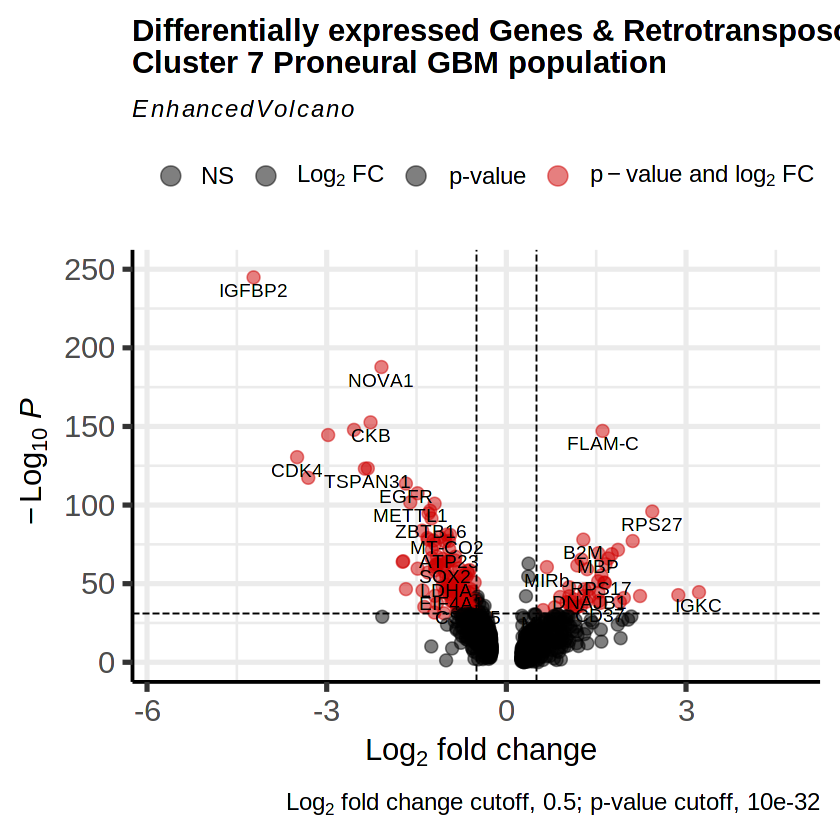

In [148]:
## Volcano plot of all differentially expressed genes
library(EnhancedVolcano)

p <- EnhancedVolcano(c7.GBM,
                    lab = c7.GBM$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural GBM population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEGs-C7GBM.pdf", width = size, height = size)
p
dev.off()

png 
  2

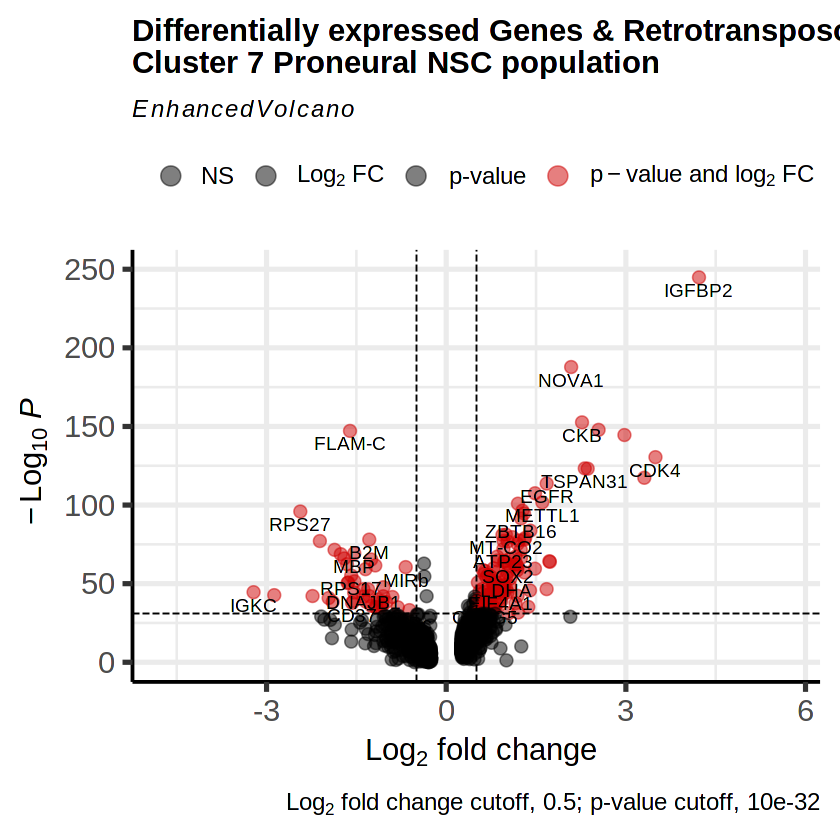

In [149]:
## Volcano plot of all differentially expressed genes
library(EnhancedVolcano)

p <- EnhancedVolcano(c7.NSC,
                    lab = c7.NSC$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural NSC population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEGs-C7NSC.pdf", width = size, height = size)
p
dev.off()

### Volcano Plot: TEs
2021-10-14:

In [142]:
c7.GBM <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.GBMmarkers.rds")
c7.NSC <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7.NCSmarkers.rds")

In [137]:
## load list of TE genes
te_genes <- read.table("~/scratch/gete-gbm/data/geneName_TE_v23-1gtf.txt", 
               sep=",", header = TRUE,
               col.names=c("gene_id", "TE_class", "TE_family"), 
               fill=FALSE, 
               strip.white=TRUE)

te_genes$gene_id <- sub("_", "-", te_genes$gene_id) # in seurat object, `_` were replaced with `-`.
rownames(te_genes) <- te_genes$gene_id

dim(te_genes)
head(te_genes,10)

[1] 1180    3

,gene_id,TE_class,TE_family
,<chr>,<chr>,<chr>
TAR1,TAR1,Satellite,telo
L1MC5a,L1MC5a,LINE,L1
MER5B,MER5B,DNA,hAT-Charlie
MIR3,MIR3,SINE,MIR
L2a,L2a,LINE,L2
L3,L3,LINE,CR1
Plat-L3,Plat-L3,LINE,CR1
MLT1K,MLT1K,LTR,ERVL-MaLR
MIR,MIR,SINE,MIR


In [147]:
## Number of differentially expressed TEs

GBM_TEs <- intersect(te_genes$gene_id, c7.GBM$gene_id)
length(GBM_TEs)
head(GBM_TEs, 20)
tail(GBM_TEs, 20)

NSC_TEs <- intersect(te_genes$gene_id, c7.NSC$gene_id)
length(NSC_TEs)
head(NSC_TEs, 20)
tail(NSC_TEs, 20)

[1] 151

[1] "L1MC5a" "MER5B"  "MIR3"   "L2a"    "L3"     "MLT1K"  "MIR"    "L2b"   
 [9] "L2c"    "MER33"  "MIRb"   "L1MB3"  "MIRc"   "AluJo"  "L1MB5"  "AluJr" 
[17] "AluSz6" "L1MA8"  "L1M5"   "L1MA9"

[1] "MER4C"          "MamGypLTR3a"    "Tigger4"        "7SK"           
 [5] "HERVIP10FH-int" "LTR47B2"        "HSMAR1"         "MER101-int"    
 [9] "GSATII"         "Tigger18a"      "MLT1F-int"      "L1M2a"         
[13] "Tigger20a"      "LTR17"          "L1M3e"          "HERVS71-int"   
[17] "HERVK11-int"    "L1MEg1"         "AluYb9"         "(GAATG)n"

[1] 151

[1] "L1MC5a" "MER5B"  "MIR3"   "L2a"    "L3"     "MLT1K"  "MIR"    "L2b"   
 [9] "L2c"    "MER33"  "MIRb"   "L1MB3"  "MIRc"   "AluJo"  "L1MB5"  "AluJr" 
[17] "AluSz6" "L1MA8"  "L1M5"   "L1MA9"

[1] "MER4C"          "MamGypLTR3a"    "Tigger4"        "7SK"           
 [5] "HERVIP10FH-int" "LTR47B2"        "HSMAR1"         "MER101-int"    
 [9] "GSATII"         "Tigger18a"      "MLT1F-int"      "L1M2a"         
[13] "Tigger20a"      "LTR17"          "L1M3e"          "HERVS71-int"   
[17] "HERVK11-int"    "L1MEg1"         "AluYb9"         "(GAATG)n"

In [150]:
## How many of the 208 TEs are overexpressed? with a significant p-value?
c7.GBM.filt <- c7.GBM %>% dplyr::filter(gene_id %in% GBM_TEs)
c7.NSC.filt <- c7.NSC %>% dplyr::filter(gene_id %in% NSC_TEs)

dim(c7.GBM.filt)
dim(c7.NSC.filt)

head(c7.filt)
tail(c7.filt)

[1] 151   9

[1] 151   9

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AluSp,0,0.7223646,1,1,0,0,Inf,Inf
2,AluJo,0,0.7370293,1,1,0,0,Inf,Inf
3,AluJr,0,0.7329050,1,1,0,0,Inf,Inf
4,AluSx,0,0.7427912,1,1,0,0,Inf,Inf
5,AluSz6,0,0.7136329,1,1,0,0,Inf,Inf
6,AluSc,0,0.7481383,1,1,0,0,Inf,Inf


,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
203,ERVL-E-int,0.7179143,0.3025827,0.320,0.385,1,0.7225190,0,0.14115073
204,L1M3c,0.7241054,0.2633618,0.190,0.220,1,0.7283251,0,0.13767473
205,THE1C,0.8037908,0.2679714,0.311,0.382,1,0.8061261,0,0.09359704
206,Tigger4b,0.8125164,0.2775324,0.327,0.408,1,0.8144038,0,0.08916023
207,MSTB1,0.8350186,0.2762312,0.247,0.289,1,0.8359873,0,0.07780032
208,SVA-A,0.8751002,0.2903319,0.335,0.409,1,0.8751002,0,0.05794221


In [152]:
## left join c7.markers with the gtf class and family information. 
dim(te_genes)
dim(te_genes[GBM_TEs,])
matchTE.df <- te_genes[GBM_TEs,]
head(matchTE.df)

c7.GBM.join <- left_join(c7.GBM.filt, matchTE.df, by="gene_id")
dim(c7.GBM.join)
head(c7.GBM.join)

c7.NSC.join <- left_join(c7.NSC.filt, matchTE.df, by="gene_id")
dim(c7.NSC.join)
head(c7.NSC.join)

[1] 1180    3

[1] 151   3

,gene_id,TE_class,TE_family
,<chr>,<chr>,<chr>
L1MC5a,L1MC5a,LINE,L1
MER5B,MER5B,DNA,hAT-Charlie
MIR3,MIR3,SINE,MIR
L2a,L2a,LINE,L2
L3,L3,LINE,CR1
MLT1K,MLT1K,LTR,ERVL-MaLR


[1] 151  11

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,nlog10p.adj,p_adj_FDR,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,FLAM-C,2.479654e-150,1.6063072,0.921,0.717,8.059123e-146,145.09371,6.848804e-148,147.16439,SINE,Alu
2,FAM,1.269006e-67,1.2524644,0.684,0.351,4.124396e-63,62.38464,4.274383e-66,65.36913,SINE,Alu
3,AluJb,5.848222e-65,0.3707980,1.000,1.000,1.900731e-60,59.72108,1.718382e-63,62.76488,SINE,Alu
4,MIRb,1.139513e-62,0.6765167,0.989,0.994,3.703532e-58,57.43138,2.810121e-61,60.55127,SINE,MIR
5,AluJo,1.305059e-56,0.3653367,1.000,1.000,4.241573e-52,51.37247,2.612010e-55,54.58303,SINE,Alu
6,FLAM-A,1.147564e-49,1.0492064,0.679,0.440,3.729697e-45,44.42833,1.741522e-48,47.75907,SINE,Alu


[1] 151  11

,gene_id,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,p_adj_FDR,nlog10p.adj,nlog10p.FDR,TE_class,TE_family
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
1,FLAM-C,2.479654e-150,-1.6063072,0.717,0.921,8.059123e-146,6.848804e-148,145.09371,147.16439,SINE,Alu
2,FAM,1.269006e-67,-1.2524644,0.351,0.684,4.124396e-63,4.274383e-66,62.38464,65.36913,SINE,Alu
3,AluJb,5.848222e-65,-0.3707980,1.000,1.000,1.900731e-60,1.718382e-63,59.72108,62.76488,SINE,Alu
4,MIRb,1.139513e-62,-0.6765167,0.994,0.989,3.703532e-58,2.810121e-61,57.43138,60.55127,SINE,MIR
5,AluJo,1.305059e-56,-0.3653367,1.000,1.000,4.241573e-52,2.612010e-55,51.37247,54.58303,SINE,Alu
6,FLAM-A,1.147564e-49,-1.0492064,0.440,0.679,3.729697e-45,1.741522e-48,44.42833,47.75907,SINE,Alu


In [153]:
saveRDS(c7.GBM.join, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-GBMTEmarkers.rds")
saveRDS(c7.NSC.join, file="/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-NSCTEmarkers.rds")

In [154]:
## load cluster 7 DEG dataframe
c7.GBM.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-GBMTEmarkers.rds")
c7.NSC.join <- readRDS("/home/samkyy/scratch/gete-gbm/results/2021-10-14/cluster7-NSCTEmarkers.rds")

In [28]:
## Volcano plot of top 10 differentially expressed TEs
library(EnhancedVolcano)

png 
  2

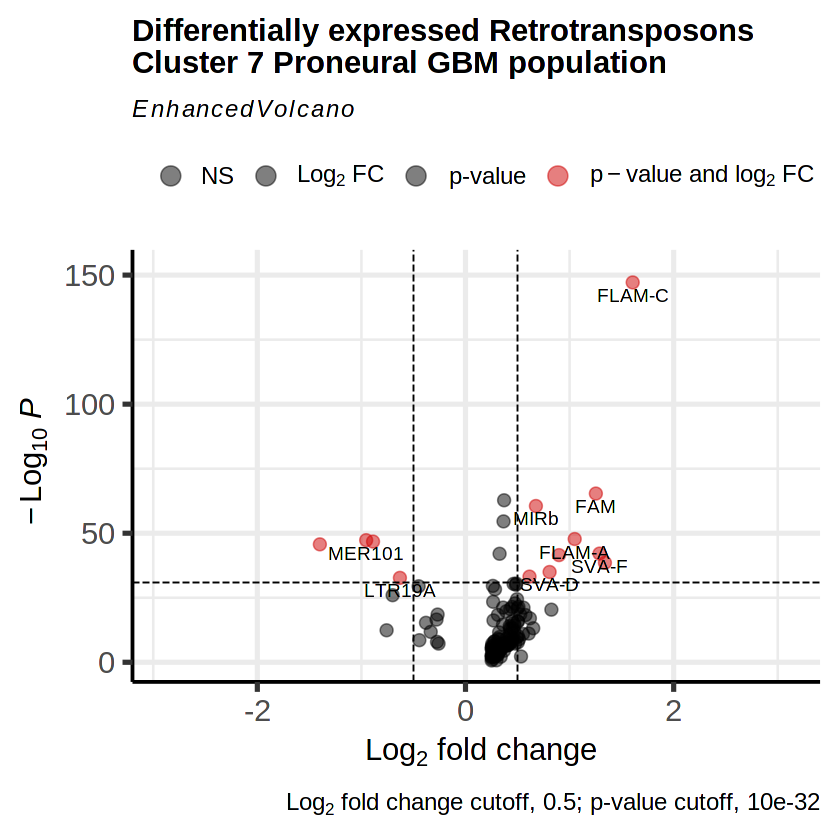

In [156]:
p <- EnhancedVolcano(c7.GBM.join,
                    lab = c7.GBM.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
                    title = 'Differentially expressed Retrotransposons\nCluster 7 Proneural GBM population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 3.0, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
               )
p 

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7GBM.pdf", width = size, height = size)
p
dev.off()

In [164]:
options(ggrepel.max.overlaps=100)
lab_markers <- c7.GBM.join %>% top_n(n = -3, wt = avg_log2FC)
lab_markers <- rbind(lab_markers, c7.GBM.join %>% top_n(n = 5, wt = avg_log2FC))

png 
  2

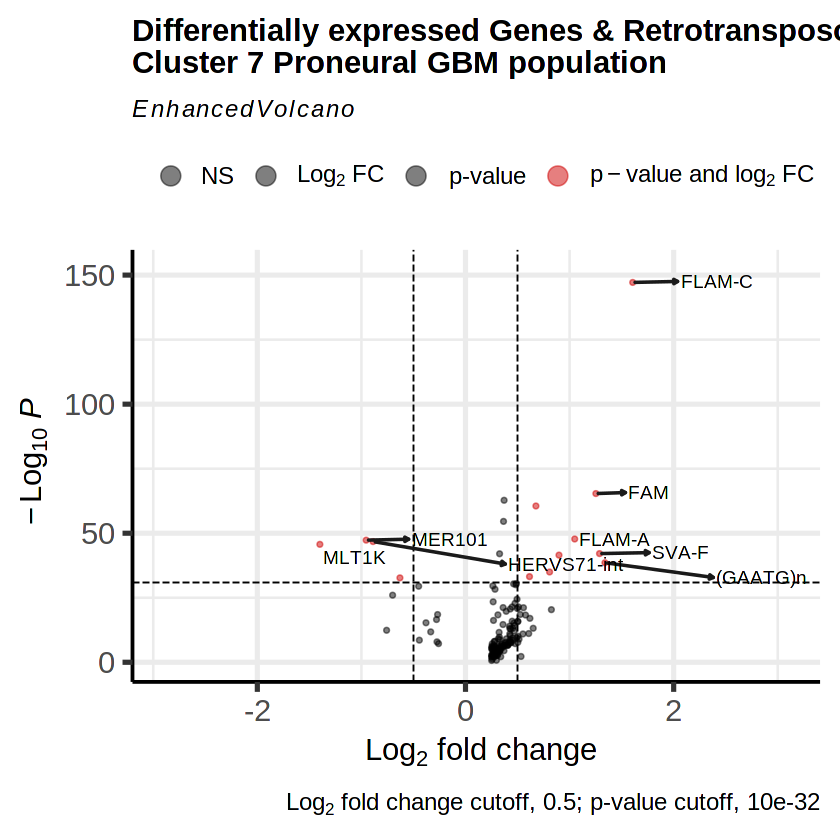

In [168]:
## Label top expressed genes

p <- EnhancedVolcano(c7.GBM.join,
                    lab = c7.GBM.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = unique(lab_markers$gene_id),
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural GBM population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 1, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, widthConnectors = 0.75
#                      lengthConnectors = unit(0.005, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7GBM.pdf", width = size, height = size)
p
dev.off()

In [196]:
options(ggrepel.max.overlaps=100)
lab_markers <- c7.NSC.join %>% top_n(n = -5, wt = avg_log2FC)
lab_markers <- rbind(lab_markers, c7.NSC.join %>% top_n(n = 3, wt = avg_log2FC))

png 
  2

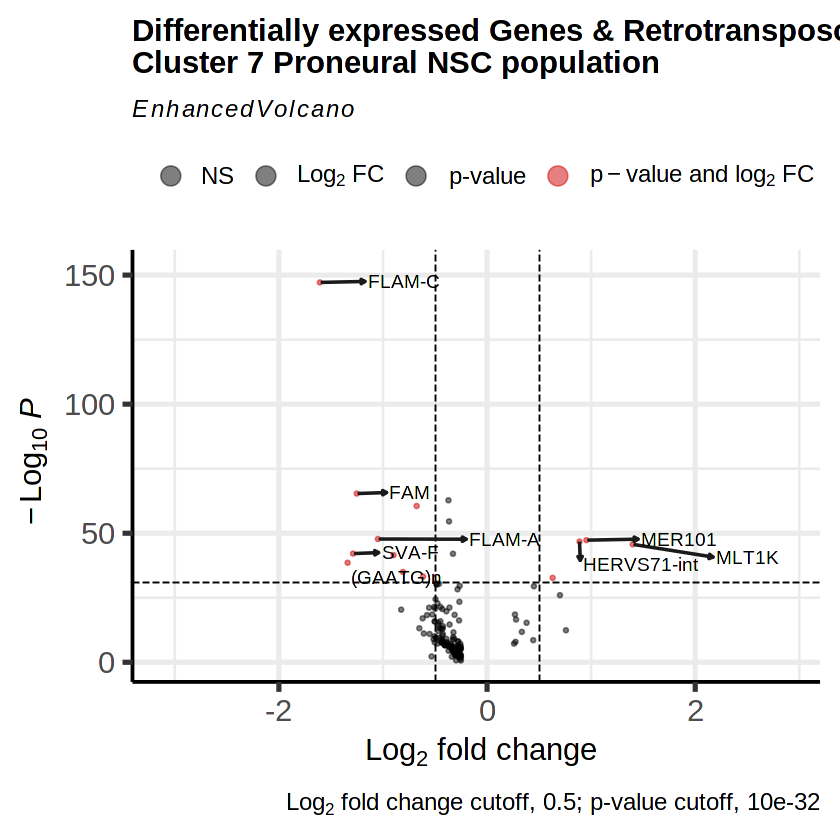

In [197]:
## Label top expressed genes

p <- EnhancedVolcano(c7.NSC.join,
                    lab = c7.NSC.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = unique(lab_markers$gene_id),
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural NSC population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, widthConnectors = 0.75
#                      lengthConnectors = unit(0.005, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7NSC.pdf", width = size, height = size)
p
dev.off()

In [198]:
options(ggrepel.max.overlaps=100)
lab_markers <- c7.GBM.join %>% dplyr::filter(p_adj_FDR <= 10e-32)

png 
  2

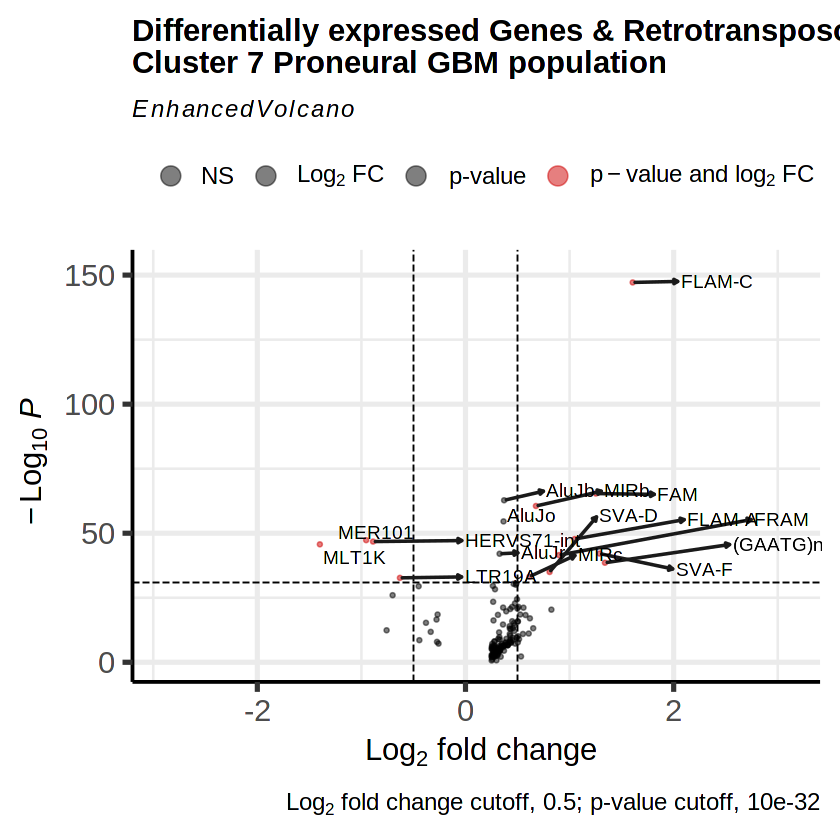

In [199]:
## Label top expressed genes

p <- EnhancedVolcano(c7.GBM.join,
                    lab = c7.GBM.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = unique(lab_markers$gene_id),
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural GBM population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, widthConnectors = 0.75
#                      lengthConnectors = unit(0.005, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7GBM_sig.pdf", width = size*1.5, height = size*1.5)
p
dev.off()

In [200]:
options(ggrepel.max.overlaps=100)
lab_markers <- c7.NSC.join %>% dplyr::filter(p_adj_FDR <= 10e-32)

png 
  2

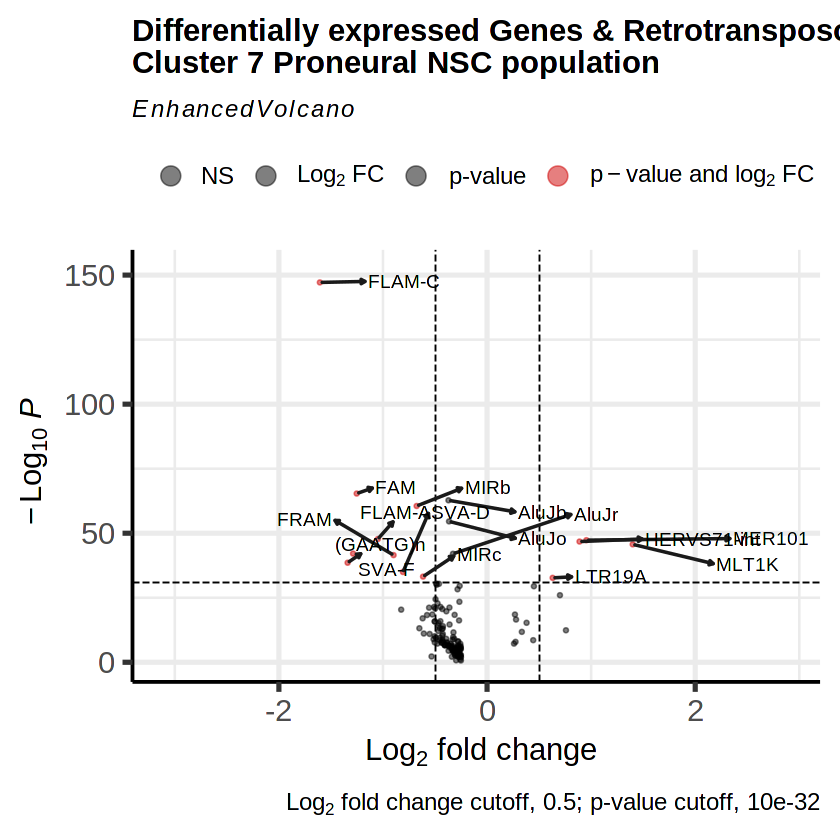

In [201]:
## Label top expressed genes

p <- EnhancedVolcano(c7.NSC.join,
                    lab = c7.NSC.join$gene_id,
                    x = 'avg_log2FC',
                    y = 'p_adj_FDR',
#                     ylim = c(0, -log10(10e-320)),
                    selectLab = unique(lab_markers$gene_id),
                    title = 'Differentially expressed Genes & Retrotransposons\nCluster 7 Proneural NSC population',
                    pCutoff = 10e-32,   # p-value cut-off (more strict than default 10e-06)
                    FCcutoff = 0.5,     # log2FC cut-off (less strict than the default 2)
                    pointSize = 0.8, labSize = 4.0, col=c('black', 'black', 'black', 'red3'),
                    colAlpha = 0.5,       # opacity (0-100%)
                    caption = bquote(~Log[2]~ "fold change cutoff, 0.5; p-value cutoff, 10e-32"),
                    boxedLabels = FALSE, drawConnectors = TRUE, widthConnectors = 0.75
#                      lengthConnectors = unit(0.005, 'npc'), 
               )

p
# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7NSC_sig.pdf", width = size*1.5, height = size*1.5)
p
dev.off()

### Barplot: TEs 
2021-10-14:

In [ ]:
##calculate percentage of TE families 

In [118]:
## extract df with cluster 7 cells in a column and the samples they are from. 
DefaultAssay(gbmsc.gte)

c7.df <- gbmsc.gte@meta.data %>% 
            dplyr::filter(integrated_snn_res.0.3 == '7') %>%
            dplyr::select(c(mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))

head(c7.df)
tail(c7.df)

meta <- gbmsc.gte@meta.data %>%
            dplyr::select(c(integrated_snn_res.0.3, mitoRatio, sample, sampleCombined, teRatio, gbm_subtype)) %>%
            dplyr::add_rownames("cells") %>% separate(cells, c("sampleType",NA, NA))
colnames(meta) <- c(colnames(meta)[1], "cluster", colnames(meta)[3:length(colnames(meta))])
head(meta)

[1] "RNA"

sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,0.0128440367,SF11232_1,SF11232,72.58716,Proneural
GBM,0.0572341662,SF11232_1,SF11232,62.65253,Proneural
GBM,0.0705906149,SF11232_1,SF11232,28.53964,Proneural
GBM,0.0538210624,SF11232_1,SF11232,58.43430,Proneural
GBM,0.0005367687,SF11232_1,SF11232,51.95921,Proneural
GBM,0.0044782803,SF11232_1,SF11232,68.42812,Proneural


sampleType,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
SC,0.007888041,SRR10353962,SRR10353962,48.19338,Proneural
SC,0.103167808,SRR10353962,SRR10353962,45.71918,Proneural
SC,0.042398778,SRR10353962,SRR10353962,36.74561,Proneural
SC,0.105613945,SRR10353962,SRR10353962,26.94181,Proneural
SC,0.112010796,SRR10353962,SRR10353962,43.72470,Proneural
SC,0.044380125,SRR10353962,SRR10353962,39.50796,Proneural


sampleType,cluster,mitoRatio,sample,sampleCombined,teRatio,gbm_subtype
<chr>,<fct>,<dbl>,<fct>,<fct>,<dbl>,<chr>
GBM,1,0.005923887,SF11232_1,SF11232,28.69794,Classical-Mesenchymal
GBM,4,0.046620828,SF11232_1,SF11232,31.89670,Mesenchymal
GBM,0,0.038901602,SF11232_1,SF11232,45.13094,Classical
GBM,0,0.042615417,SF11232_1,SF11232,49.49516,Classical
GBM,2,0.040313949,SF11232_1,SF11232,39.06529,Classical-Proneural
GBM,2,0.013255645,SF11232_1,SF11232,24.85069,Classical-Proneural


png 
  2

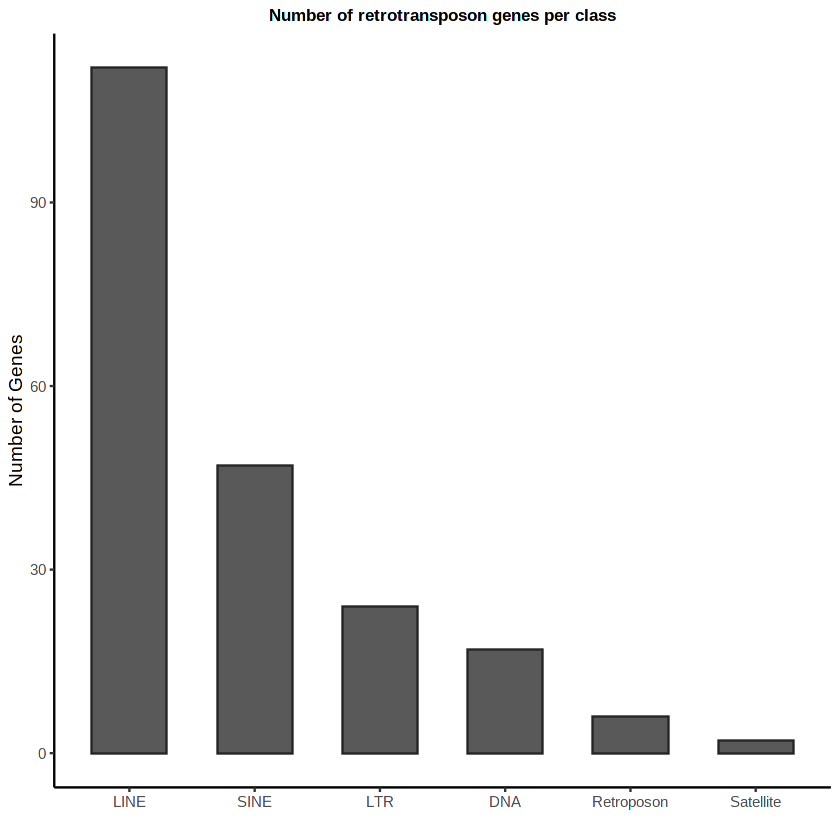

In [59]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_class) %>% summarize(nGenes = length(gene_id)) %>%
    ggplot(aes(x=reorder(TE_class,(-nGenes)), y=nGenes)) + geom_bar( stat="identity", width = 0.6, position="dodge", color=darkgray) + 
        ggtitle("Number of retrotransposon genes per class") + labs(y = "Number of Genes", x = "") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold"))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyclass.pdf", width = size, height = size)
p
dev.off()

png 
  2

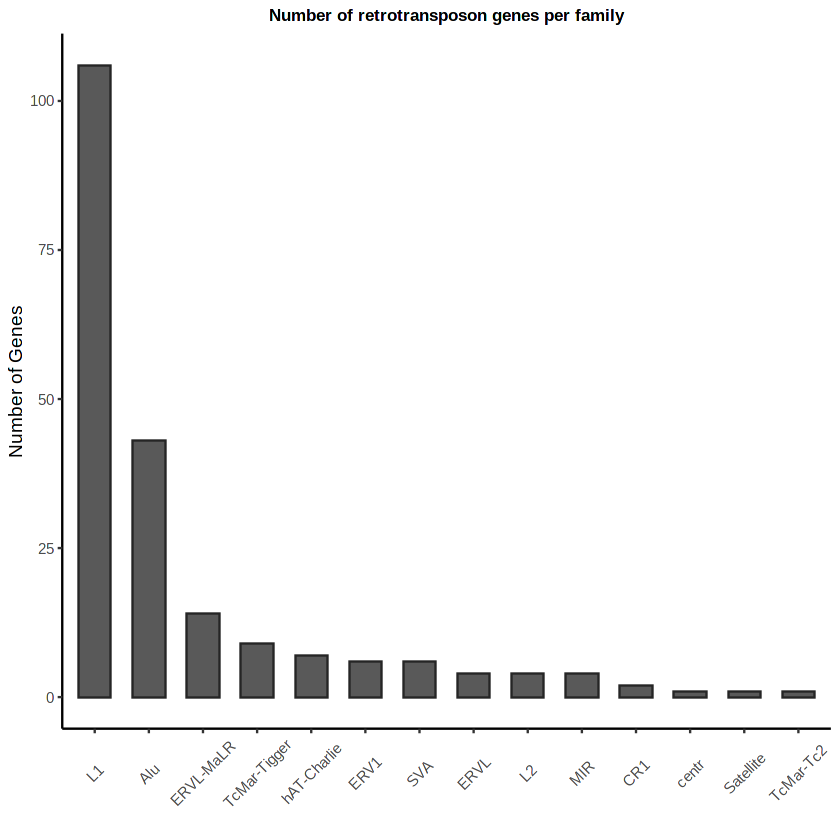

In [62]:
# create bar plot
lightgray = "#D0D3D4"
darkgray = "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_family) %>% summarize(nGenes = length(gene_id)) %>%
    ggplot(aes(x=reorder(TE_family,(-nGenes)), y=nGenes)) + geom_bar( stat="identity", width = 0.6, position="dodge", color=darkgray) + 
        ggtitle("Number of retrotransposon genes per family") + labs(y = "Number of Genes", x = "") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        theme(axis.text.x = element_text(angle = 45, vjust = 0.5, hjust=0.5))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyfamily.pdf", width = size, height = size)
p
dev.off()

In [ ]:
# fill by genes that are significantly overexpressed?

`summarise()` has grouped output by 'TE_class'. You can override using the `.groups` argument.



png 
  2

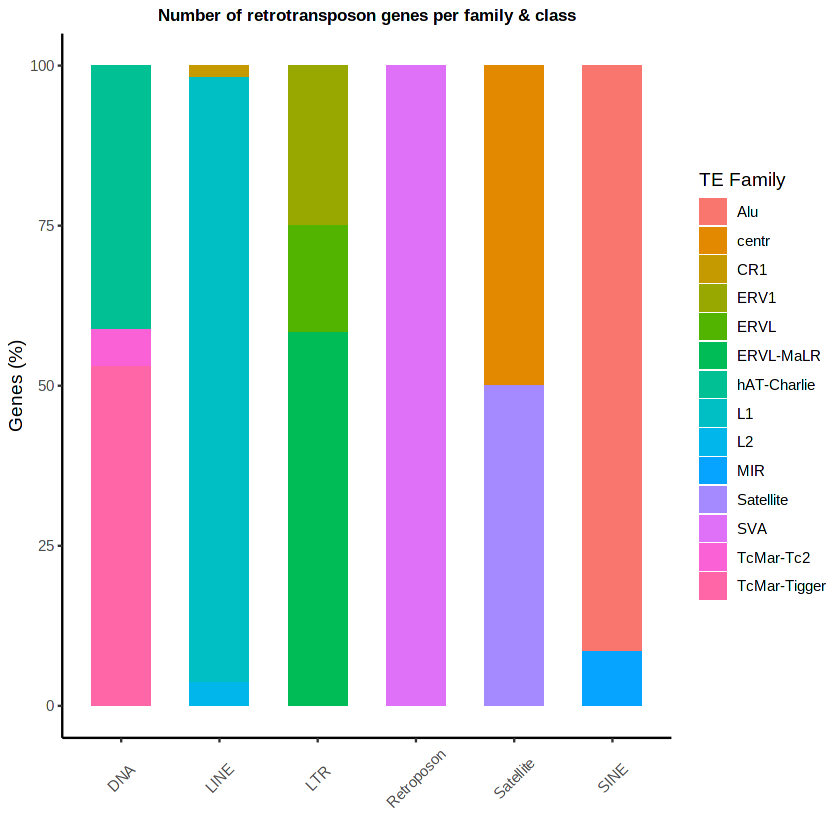

In [106]:
# create bar plot
lightgray <- "#D0D3D4"
darkgray <- "#252525"

#### GBM vs NCS ####
p <- c7.filt.join %>% group_by(TE_class, TE_family) %>% 
        summarize(nGenes = length(gene_id)) %>% mutate(perc = nGenes/sum(nGenes)) %>%
    ggplot(aes(x=TE_class, y=perc*100, fill=TE_family)) + 
        geom_bar( stat="identity", width = 0.6) + 
        ggtitle("Number of retrotransposon genes per family & class") + labs(y = "Genes (%)", x = "", fill="TE Family") +
        theme_classic() + theme(plot.title = element_text(hjust = 0.5, size = 10, face = "bold")) +
        theme(axis.text.x = element_text(angle = 45, vjust = 0.5, hjust=0.5))
p

# Save figures
size = 7
pdf("/home/samkyy/scratch/gete-gbm/results/2021-10-14/r_GBMSC_DEG-TE-C7_barbyclassfamily.pdf", width = size, height = size)
p
dev.off()

See: `neuroblastoma_te.ipynb notebook`

## End of Notebook

In [ ]:
save.image("/scratch/samkyy/gete-gbm/results/2021-06-10/seurat_neuroblastoma.RData")

In [23]:
sessionInfo()

R version 4.0.2 (2020-06-22)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: CentOS Linux 7 (Core)

Matrix products: default
BLAS/LAPACK: /cvmfs/soft.computecanada.ca/easybuild/software/2020/Core/imkl/2020.1.217/compilers_and_libraries_2020.1.217/linux/mkl/lib/intel64_lin/libmkl_gf_lp64.so

locale:
 [1] LC_CTYPE=en_CA.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_CA.UTF-8        LC_COLLATE=en_CA.UTF-8    
 [5] LC_MONETARY=en_CA.UTF-8    LC_MESSAGES=en_CA.UTF-8   
 [7] LC_PAPER=en_CA.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_CA.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
 [1] grid      stats4    parallel  stats     graphics  grDevices utils    
 [8] datasets  methods   base     

other attached packages:
 [1] lawstat_3.4             ggforce_0.3.3           RColorBrewer_1.1-2     
 [4] GO.db_3.12.1            org.Hs.eg.db_3.12.0     GOstats_2.56.0         
 [7] graph_1.68.0        